## Germany & neighbors drought scenario with 130 €/t CO2 price. Transmission Expansion is allowed

In [2]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [3]:
country = 'DE'
buses = '20'
le = '1.5'

In [4]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_168h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_168h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [5]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [6]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [7]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [8]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [9]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [10]:
#solve network
n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.5_solved_168h.nc"
#n = import_nc_file(dir, filename)
contingency = 'drought'
n.name = f'base_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.23it/s]
INFO:linopy.io: Writing time: 0.93s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d5qrzauw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d5qrzauw.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 59557 rows, 27795 columns, 114186 nonzeros


INFO:gurobipy:obj: 59557 rows, 27795 columns, 114186 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59557 rows, 27795 columns and 114186 nonzeros


INFO:gurobipy:Optimize a model with 59557 rows, 27795 columns and 114186 nonzeros


Model fingerprint: 0x3297338d


INFO:gurobipy:Model fingerprint: 0x3297338d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38159 rows and 7171 columns


INFO:gurobipy:Presolve removed 38159 rows and 7171 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 21398 rows, 20624 columns, 69811 nonzeros


INFO:gurobipy:Presolved: 21398 rows, 20624 columns, 69811 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.878e+05


INFO:gurobipy: AA' NZ     : 1.878e+05


 Factor NZ  : 9.045e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 9.045e+05 (roughly 24 MB of memory)


 Factor Ops : 1.620e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.620e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.48566401e+12 -1.39879001e+14  5.78e+06 2.57e+05  5.44e+10     0s


INFO:gurobipy:   0   8.48566401e+12 -1.39879001e+14  5.78e+06 2.57e+05  5.44e+10     0s


   1   8.09719501e+12 -1.15571491e+14  3.06e+06 1.85e+05  4.47e+10     1s


INFO:gurobipy:   1   8.09719501e+12 -1.15571491e+14  3.06e+06 1.85e+05  4.47e+10     1s


   2   5.16273028e+12 -6.44913974e+13  1.39e+06 3.78e+04  1.67e+10     1s


INFO:gurobipy:   2   5.16273028e+12 -6.44913974e+13  1.39e+06 3.78e+04  1.67e+10     1s


   3   3.76840784e+12 -3.52162012e+13  3.69e+05 4.78e+03  4.19e+09     1s


INFO:gurobipy:   3   3.76840784e+12 -3.52162012e+13  3.69e+05 4.78e+03  4.19e+09     1s


   4   3.05697183e+12 -1.87355305e+13  1.19e+05 4.88e+02  1.42e+09     1s


INFO:gurobipy:   4   3.05697183e+12 -1.87355305e+13  1.19e+05 4.88e+02  1.42e+09     1s


   5   2.16051600e+12 -1.16554987e+13  4.22e+04 2.13e+02  6.66e+08     1s


INFO:gurobipy:   5   2.16051600e+12 -1.16554987e+13  4.22e+04 2.13e+02  6.66e+08     1s


   6   8.84736821e+11 -3.75805142e+12  1.96e+03 2.61e+01  1.29e+08     1s


INFO:gurobipy:   6   8.84736821e+11 -3.75805142e+12  1.96e+03 2.61e+01  1.29e+08     1s


   7   3.94404858e+11 -9.89467765e+11  3.34e+02 5.19e+00  3.28e+07     1s


INFO:gurobipy:   7   3.94404858e+11 -9.89467765e+11  3.34e+02 5.19e+00  3.28e+07     1s


   8   2.06737382e+11 -3.51017061e+11  1.18e+02 1.79e+00  1.27e+07     1s


INFO:gurobipy:   8   2.06737382e+11 -3.51017061e+11  1.18e+02 1.79e+00  1.27e+07     1s


   9   1.42730895e+11 -1.35909478e+11  6.27e+01 8.32e-01  6.26e+06     1s


INFO:gurobipy:   9   1.42730895e+11 -1.35909478e+11  6.27e+01 8.32e-01  6.26e+06     1s


  10   1.08698328e+11 -3.69469246e+10  3.78e+01 3.84e-01  3.25e+06     1s


INFO:gurobipy:  10   1.08698328e+11 -3.69469246e+10  3.78e+01 3.84e-01  3.25e+06     1s


  11   8.24228464e+10  1.06896223e+10  2.05e+01 1.57e-01  1.59e+06     1s


INFO:gurobipy:  11   8.24228464e+10  1.06896223e+10  2.05e+01 1.57e-01  1.59e+06     1s


  12   6.82181606e+10  2.70032669e+10  1.22e+01 7.89e-02  9.11e+05     1s


INFO:gurobipy:  12   6.82181606e+10  2.70032669e+10  1.22e+01 7.89e-02  9.11e+05     1s


  13   6.07268641e+10  3.25655663e+10  8.12e+00 5.31e-02  6.21e+05     1s


INFO:gurobipy:  13   6.07268641e+10  3.25655663e+10  8.12e+00 5.31e-02  6.21e+05     1s


  14   5.90852394e+10  3.76052492e+10  7.13e+00 3.23e-02  4.74e+05     1s


INFO:gurobipy:  14   5.90852394e+10  3.76052492e+10  7.13e+00 3.23e-02  4.74e+05     1s


  15   5.45105660e+10  3.99340945e+10  4.75e+00 2.17e-02  3.21e+05     1s


INFO:gurobipy:  15   5.45105660e+10  3.99340945e+10  4.75e+00 2.17e-02  3.21e+05     1s


  16   5.23549738e+10  4.12151929e+10  3.63e+00 1.57e-02  2.45e+05     1s


INFO:gurobipy:  16   5.23549738e+10  4.12151929e+10  3.63e+00 1.57e-02  2.45e+05     1s


  17   5.05898952e+10  4.23411250e+10  2.73e+00 1.03e-02  1.82e+05     1s


INFO:gurobipy:  17   5.05898952e+10  4.23411250e+10  2.73e+00 1.03e-02  1.82e+05     1s


  18   4.84252170e+10  4.31711487e+10  1.66e+00 6.90e-03  1.16e+05     1s


INFO:gurobipy:  18   4.84252170e+10  4.31711487e+10  1.66e+00 6.90e-03  1.16e+05     1s


  19   4.72532456e+10  4.36349435e+10  1.07e+00 4.88e-03  7.96e+04     1s


INFO:gurobipy:  19   4.72532456e+10  4.36349435e+10  1.07e+00 4.88e-03  7.96e+04     1s


  20   4.62260007e+10  4.40314744e+10  5.92e-01 3.25e-03  4.83e+04     1s


INFO:gurobipy:  20   4.62260007e+10  4.40314744e+10  5.92e-01 3.25e-03  4.83e+04     1s


  21   4.56448373e+10  4.43819447e+10  3.29e-01 1.92e-03  2.78e+04     1s


INFO:gurobipy:  21   4.56448373e+10  4.43819447e+10  3.29e-01 1.92e-03  2.78e+04     1s


  22   4.54083961e+10  4.45718424e+10  2.18e-01 1.16e-03  1.84e+04     1s


INFO:gurobipy:  22   4.54083961e+10  4.45718424e+10  2.18e-01 1.16e-03  1.84e+04     1s


  23   4.52041744e+10  4.47657406e+10  1.28e-01 4.04e-04  9.65e+03     1s


INFO:gurobipy:  23   4.52041744e+10  4.47657406e+10  1.28e-01 4.04e-04  9.65e+03     1s


  24   4.50074054e+10  4.48386700e+10  4.72e-02 1.24e-04  3.71e+03     1s


INFO:gurobipy:  24   4.50074054e+10  4.48386700e+10  4.72e-02 1.24e-04  3.71e+03     1s


  25   4.49231197e+10  4.48635714e+10  1.46e-02 4.76e-05  1.31e+03     1s


INFO:gurobipy:  25   4.49231197e+10  4.48635714e+10  1.46e-02 4.76e-05  1.31e+03     1s


  26   4.49009514e+10  4.48747020e+10  6.46e-03 1.68e-05  5.77e+02     1s


INFO:gurobipy:  26   4.49009514e+10  4.48747020e+10  6.46e-03 1.68e-05  5.77e+02     1s


  27   4.48862073e+10  4.48797747e+10  1.42e-03 3.63e-06  1.41e+02     1s


INFO:gurobipy:  27   4.48862073e+10  4.48797747e+10  1.42e-03 3.63e-06  1.41e+02     1s


  28   4.48828889e+10  4.48805709e+10  4.13e-04 1.77e-06  5.10e+01     1s


INFO:gurobipy:  28   4.48828889e+10  4.48805709e+10  4.13e-04 1.77e-06  5.10e+01     1s


  29   4.48817891e+10  4.48811492e+10  1.00e-04 4.96e-07  1.41e+01     1s


INFO:gurobipy:  29   4.48817891e+10  4.48811492e+10  1.00e-04 4.96e-07  1.41e+01     1s


  30   4.48815075e+10  4.48813577e+10  2.75e-05 9.20e-08  3.29e+00     1s


INFO:gurobipy:  30   4.48815075e+10  4.48813577e+10  2.75e-05 9.20e-08  3.29e+00     1s


  31   4.48814316e+10  4.48813980e+10  8.38e-06 1.25e-08  7.38e-01     1s


INFO:gurobipy:  31   4.48814316e+10  4.48813980e+10  8.38e-06 1.25e-08  7.38e-01     1s


  32   4.48814096e+10  4.48814048e+10  6.35e-06 2.63e-09  1.05e-01     2s


INFO:gurobipy:  32   4.48814096e+10  4.48814048e+10  6.35e-06 2.63e-09  1.05e-01     2s


  33   4.48814071e+10  4.48814070e+10  2.50e-06 1.07e-10  1.84e-03     2s


INFO:gurobipy:  33   4.48814071e+10  4.48814070e+10  2.50e-06 1.07e-10  1.84e-03     2s


  34   4.48814070e+10  4.48814070e+10  1.57e-07 1.57e-10  3.54e-07     2s


INFO:gurobipy:  34   4.48814070e+10  4.48814070e+10  1.57e-07 1.57e-10  3.54e-07     2s


  35   4.48814070e+10  4.48814070e+10  3.20e-10 3.19e-10  6.15e-09     2s


INFO:gurobipy:  35   4.48814070e+10  4.48814070e+10  3.20e-10 3.19e-10  6.15e-09     2s


INFO:gurobipy:


Barrier solved model in 35 iterations and 1.63 seconds (0.64 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 1.63 seconds (0.64 work units)


Optimal objective 4.48814070e+10


INFO:gurobipy:Optimal objective 4.48814070e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10965 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:   10965 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     230 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     230 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6156414e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6156414e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5721    4.4881407e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    5721    4.4881407e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 5721 iterations and 1.95 seconds (0.89 work units)


INFO:gurobipy:Solved in 5721 iterations and 1.95 seconds (0.89 work units)


Optimal objective  4.488140701e+10


INFO:gurobipy:Optimal objective  4.488140701e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59557 duals
Objective: 4.49e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [11]:
file = f"{country}_{buses}_{le}_base_solved_168h.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.5_base_solved_168h.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses


<xarray.Dataset> Size: 270kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0,
                                           global_constraints_i: 1,
                                           links_i: 28, links_t_p0_i: 15,
                                           links_t_p1_i: 15,
                                           storage_units_i: 65,
                                           ...
                                           carriers_i: 21, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 120B '14814' ...
  * links_t_p1_i                          (links_t_p1_i) object 120B '14814' ...
    ...                                    ...
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/103)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_drought
    network_objective:           44881407007.17796
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [12]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [13]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


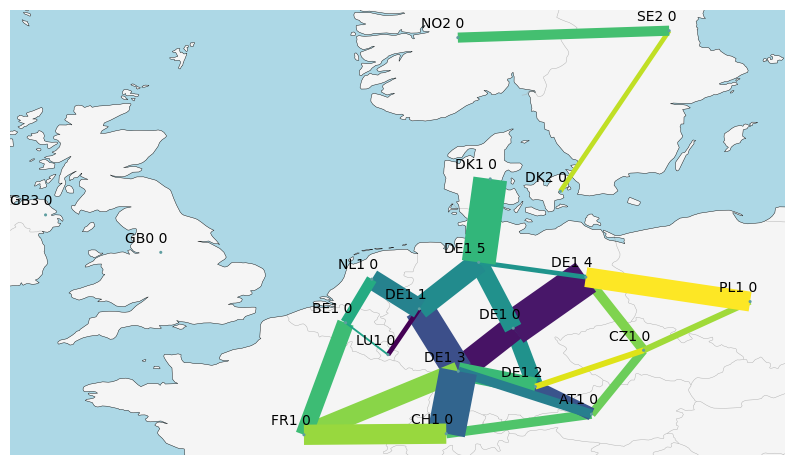

In [14]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [15]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


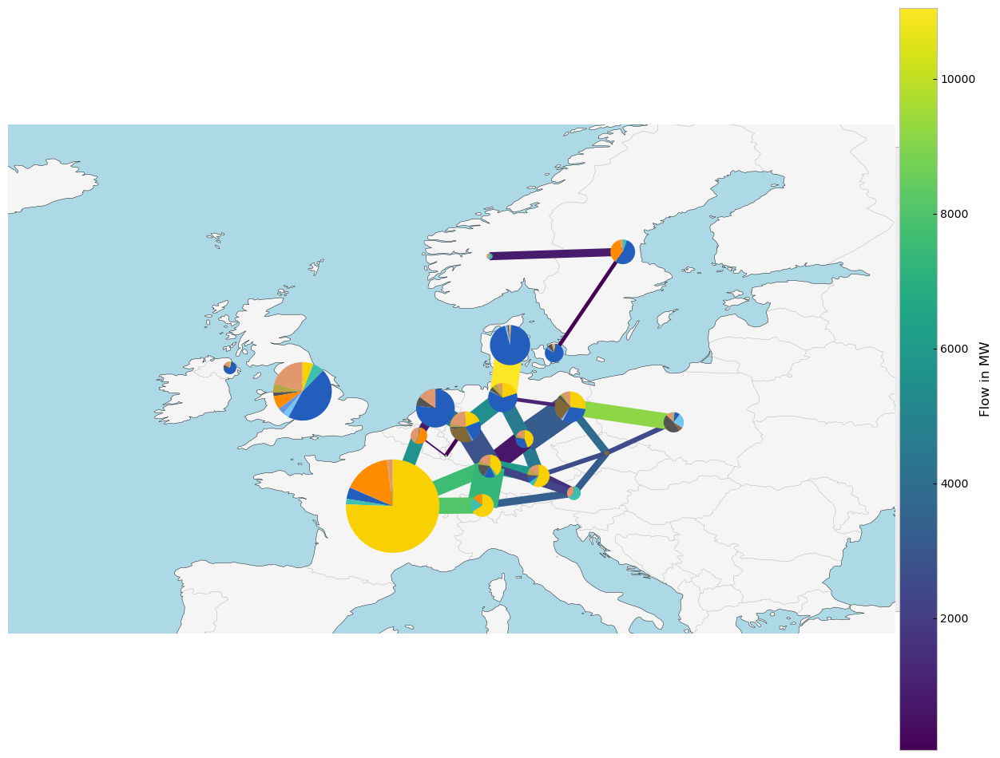

In [16]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [17]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


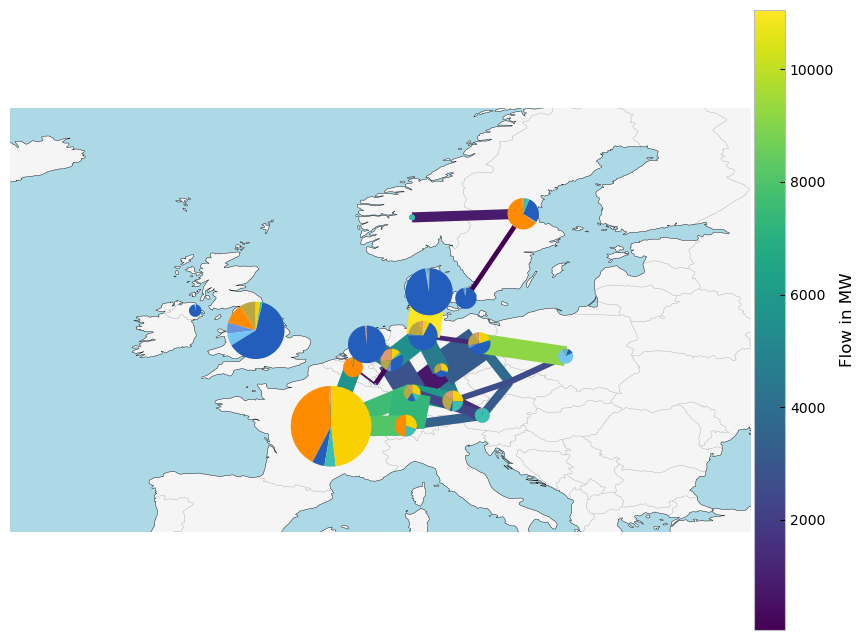

In [18]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

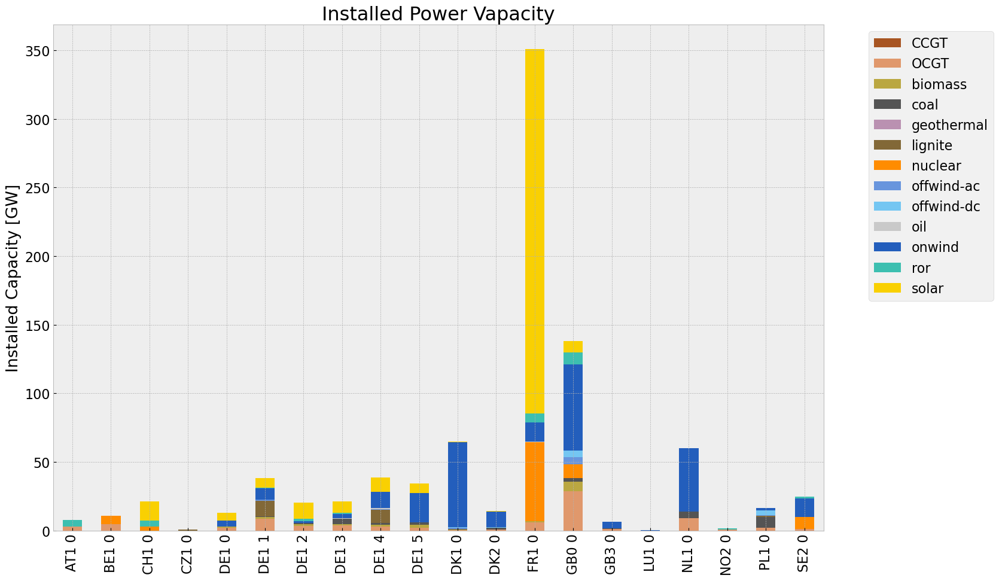

In [19]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

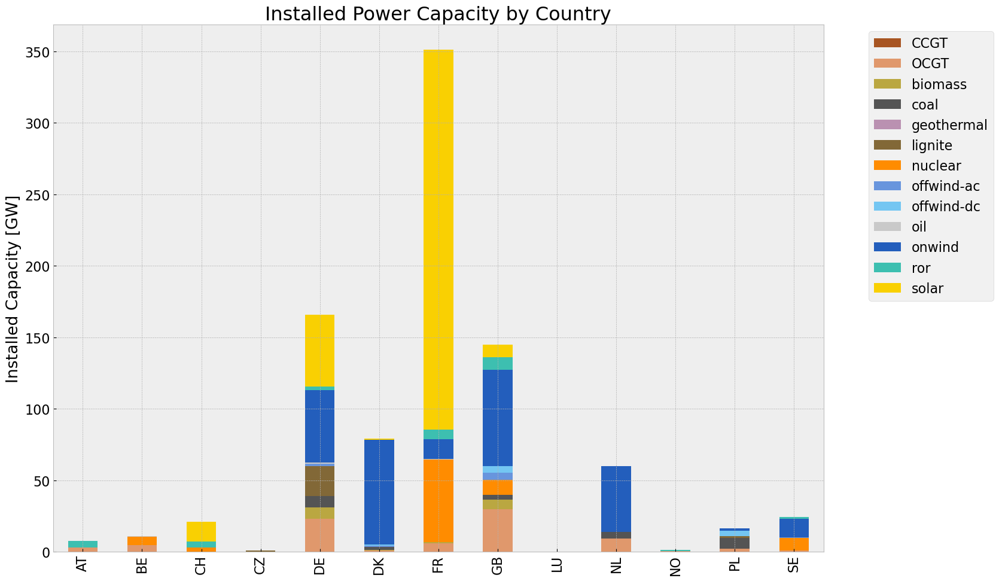

In [20]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

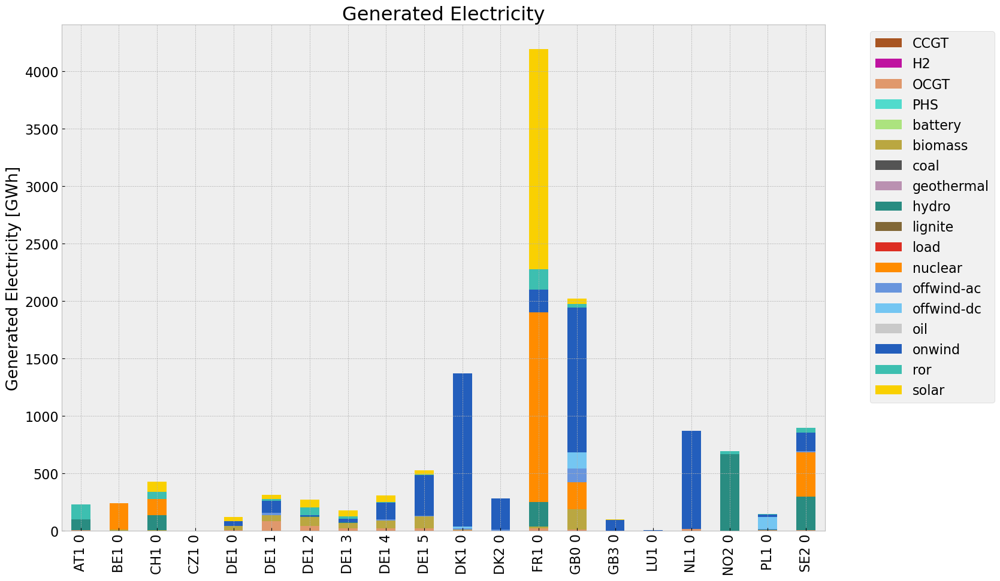

In [21]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

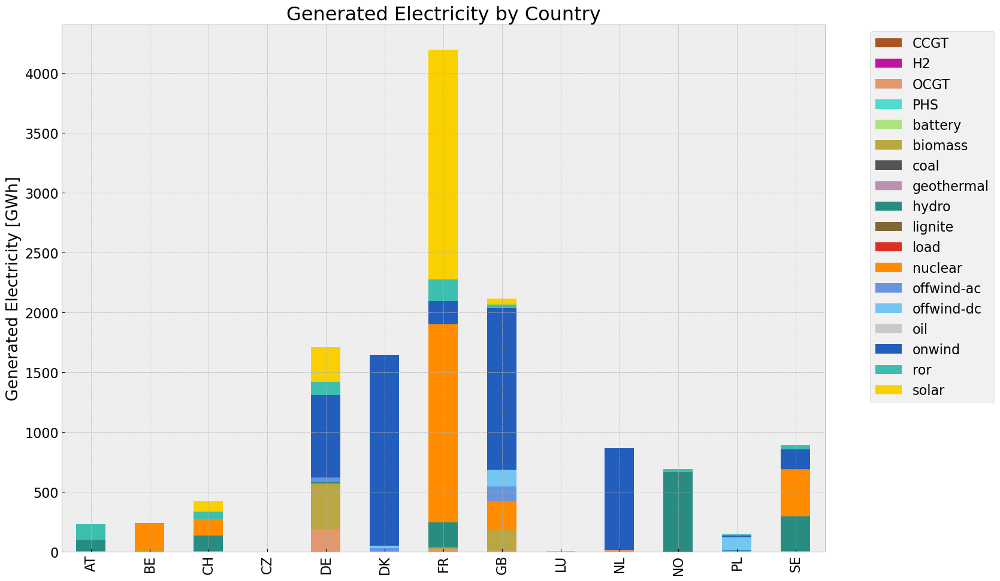

In [22]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [23]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [24]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [25]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [26]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [27]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [28]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [29]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

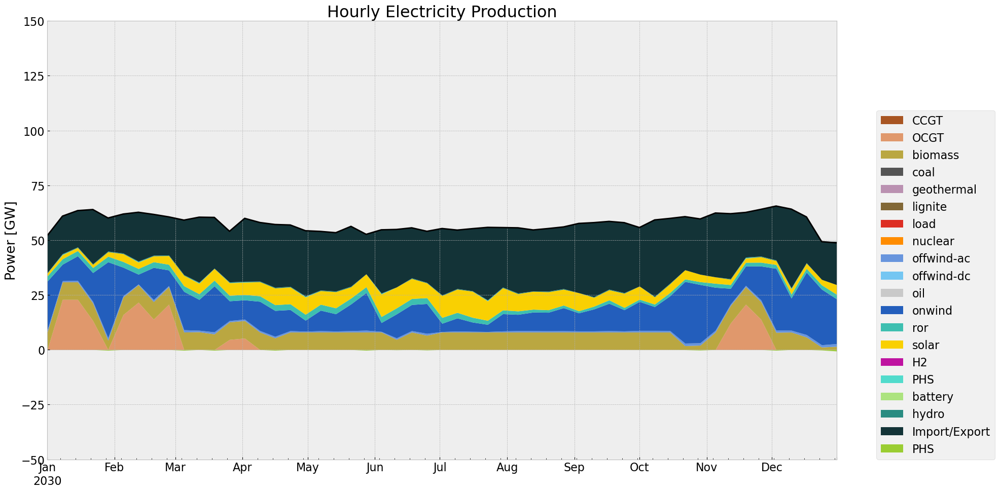

In [30]:
# winter
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

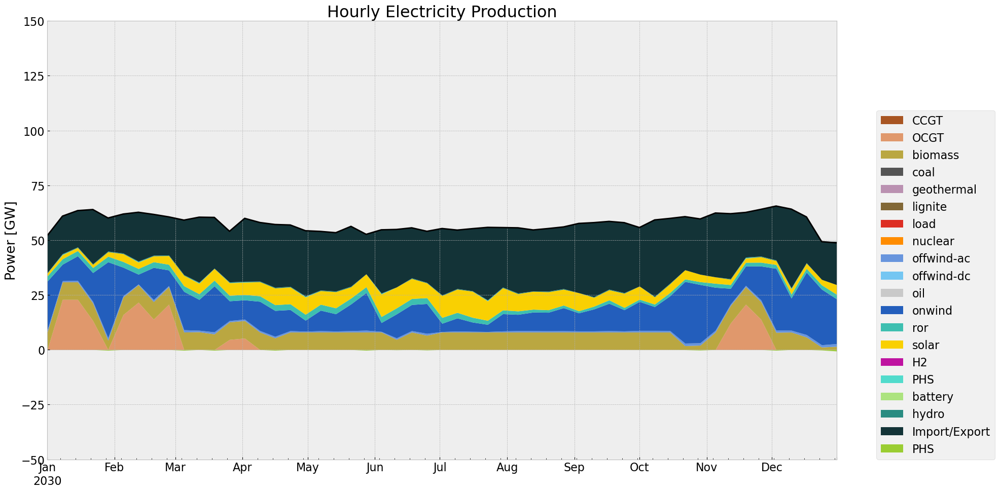

In [31]:
#summer
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

In [32]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq

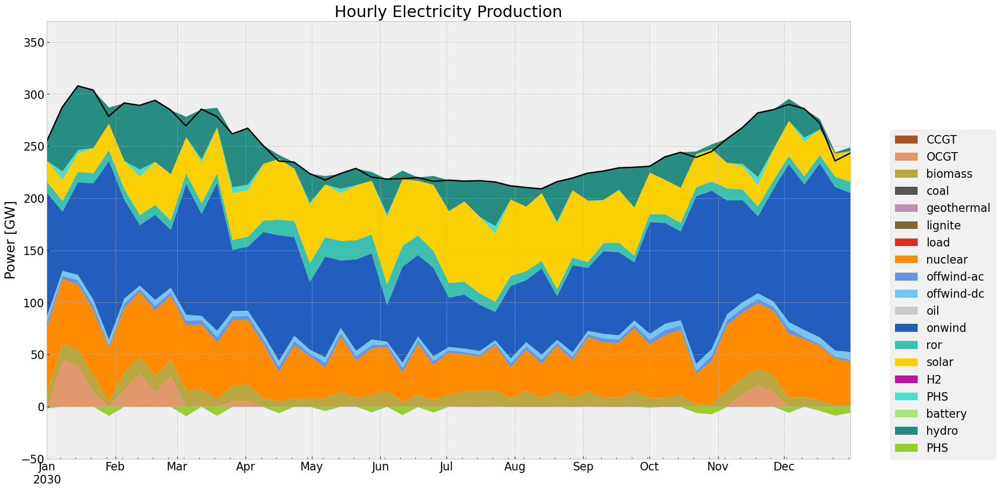

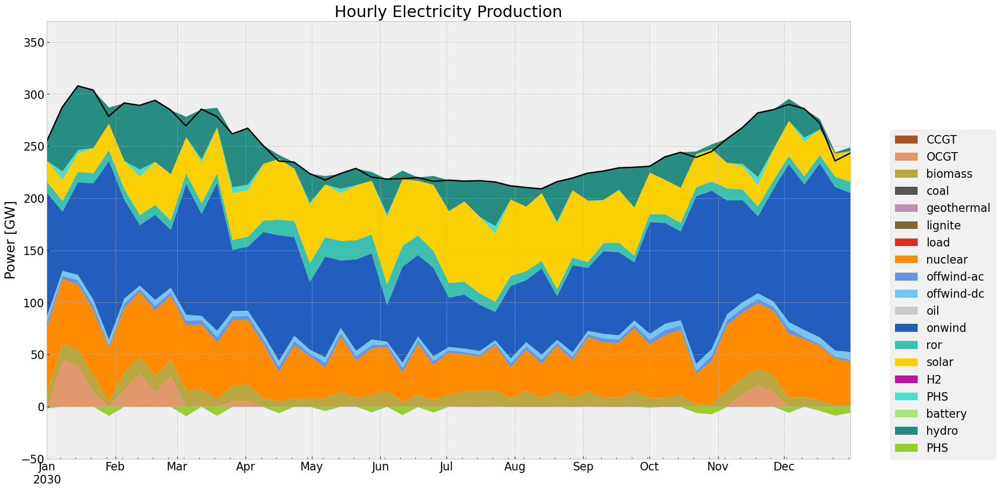

In [33]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)

## Storage

In [34]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

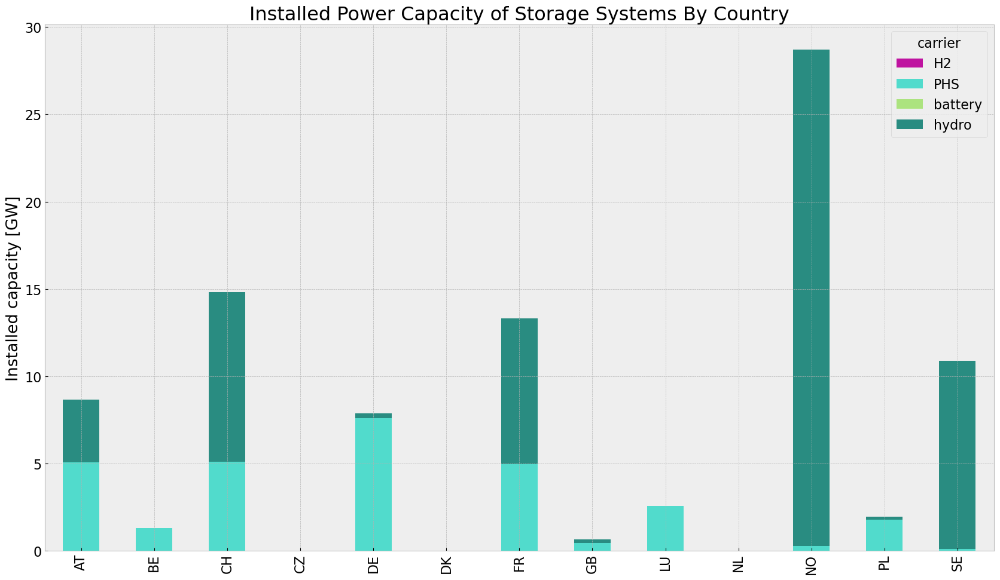

In [35]:
store_base = inst_store_table(n)

In [36]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='168H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


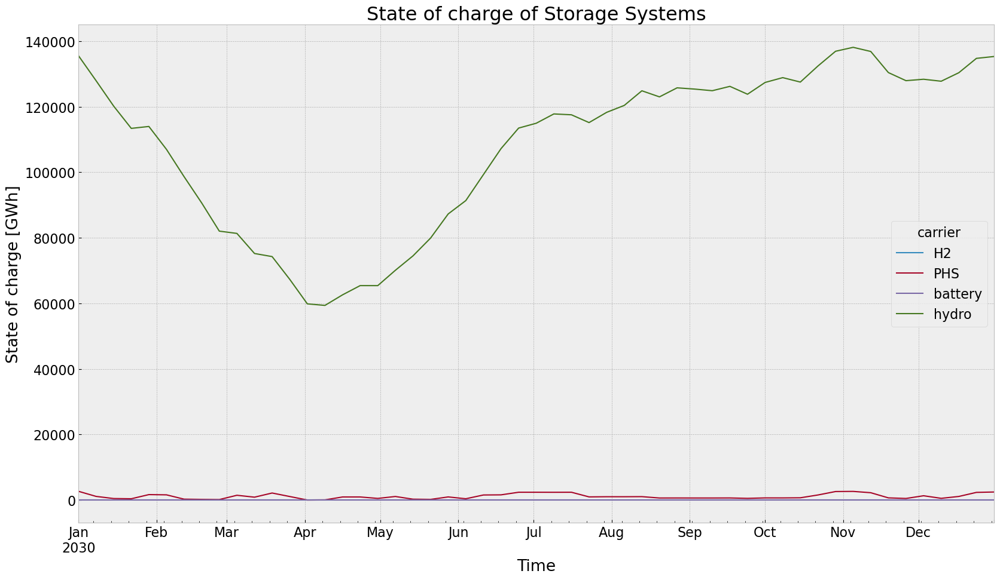

In [37]:
state_of_charge_plot(n, '2030-01-01', '2030-12-31')

## Electricity Price

In [38]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [39]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


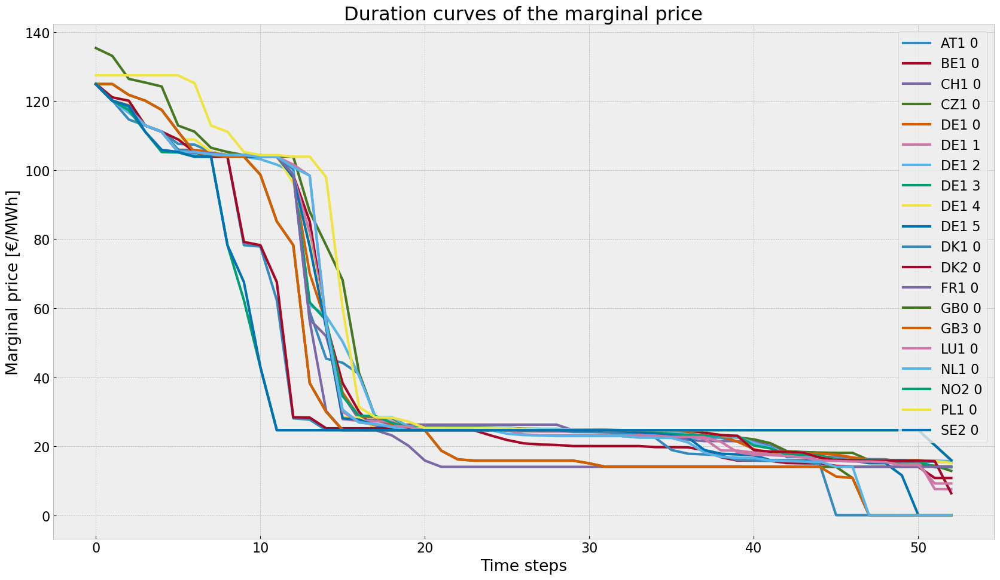

In [40]:
price_dur_curve_plot(n)

In [41]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


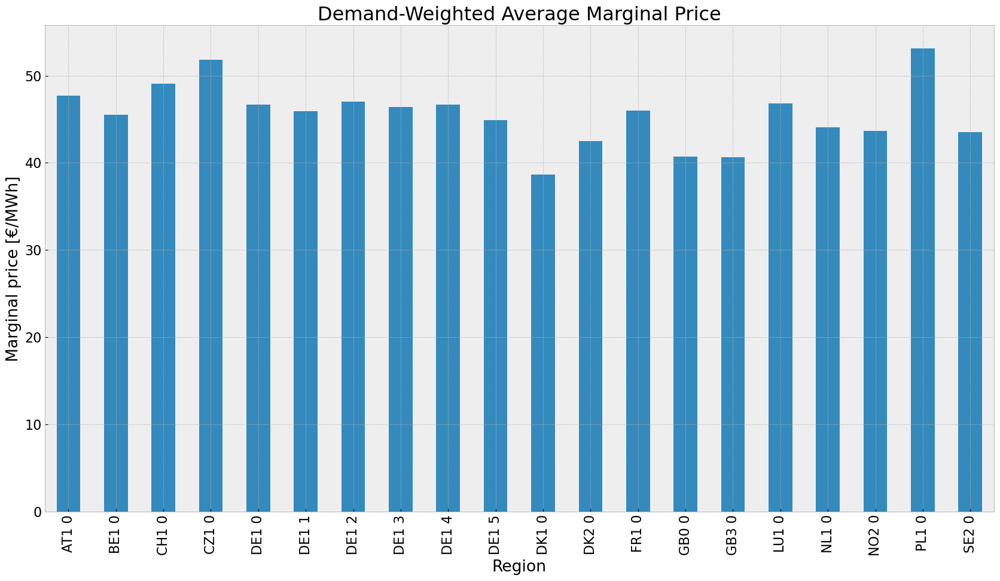

In [42]:
price_regions_table(n)

In [43]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


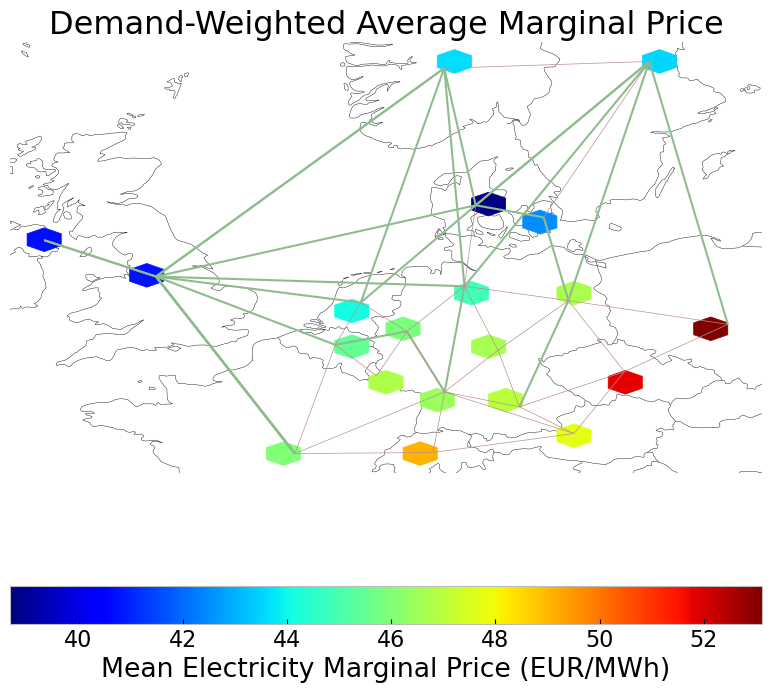

In [44]:
price_regions(n)

## Emission

In [45]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,2.470968e+05,0.451621,0.1980,108332.389629
biomass,5.975395e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329908,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,0.000000e+00,0.337285,0.4069,0.000000
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.637041e+06,0.326600,0.0000,0.000000
offwind-ac,1.967836e+05,1.000000,0.0000,0.000000


# Drought Scenario



In [46]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def droughtscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)

    #implement drought
    #storage hydro cut
    n_new.storage_units_t.inflow.loc[cut_start:cut_end] *= reductionto

    #ror and nuclear cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('ror') or column.endswith('nuclear') :
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu

    return n_new

n1 = droughtscenario(n, cut_start, duration, reductionto)
n1.name = f'inv_{contingency}'          

## 1. Model: perfect foresight with allowed additional investment

In [47]:
country = 'DE'

### Allow investment

In [48]:
def allow_inv(n1,n,country):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, row in n1.generators.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus']:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True
        else:
            n1.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, row in n1.storage_units.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus']:
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt'] 
            n1.storage_units.at[index, 'p_nom_extendable'] = True
        else:
            n1.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, row in n1.lines.iterrows():
        if row['carrier'] == 'AC' and (country in row['bus0'] or country in row['bus1']):
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = True 
        else:
            n1.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = False 
    
    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, row in n1.links.iterrows():
        if row['carrier'] == 'DC' and (country in row['bus0'] or country in row['bus1']):
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = True 
        else:
            n1.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = False
            

allow_inv(n1,n, country)

In [49]:
n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 93.74it/s]
INFO:linopy.io: Writing time: 0.92s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h20_dis2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h20_dis2.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0x4e085b04


INFO:gurobipy:Model fingerprint: 0x4e085b04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e-01, 1e+10]


INFO:gurobipy:  Bounds range     [7e-01, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50362 rows and 12722 columns


INFO:gurobipy:Presolve removed 50362 rows and 12722 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 37


INFO:gurobipy: Dense cols : 37


 AA' NZ     : 6.961e+04


INFO:gurobipy: AA' NZ     : 6.961e+04


 Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


 Factor Ops : 4.736e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.736e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.02752467e+13 -1.66654763e+14  1.05e+06 3.13e+05  5.50e+10     0s


INFO:gurobipy:   0   3.02752467e+13 -1.66654763e+14  1.05e+06 3.13e+05  5.50e+10     0s


   1   2.12192054e+13 -9.66381906e+13  6.72e+05 1.12e+05  3.06e+10     0s


INFO:gurobipy:   1   2.12192054e+13 -9.66381906e+13  6.72e+05 1.12e+05  3.06e+10     0s


   2   9.21381223e+12 -5.40662631e+13  2.17e+05 2.50e+04  1.01e+10     0s


INFO:gurobipy:   2   9.21381223e+12 -5.40662631e+13  2.17e+05 2.50e+04  1.01e+10     0s


   3   2.34174199e+12 -2.09082909e+13  1.76e+04 1.60e+03  1.27e+09     0s


INFO:gurobipy:   3   2.34174199e+12 -2.09082909e+13  1.76e+04 1.60e+03  1.27e+09     0s


   4   6.71069199e+11 -5.02005036e+12  1.19e+03 2.39e+02  2.05e+08     0s


INFO:gurobipy:   4   6.71069199e+11 -5.02005036e+12  1.19e+03 2.39e+02  2.05e+08     0s


   5   3.66800396e+11 -1.18588397e+12  4.48e+02 5.34e+01  5.36e+07     0s


INFO:gurobipy:   5   3.66800396e+11 -1.18588397e+12  4.48e+02 5.34e+01  5.36e+07     0s


   6   2.50306784e+11 -8.65157813e+11  2.43e+02 3.84e+01  3.73e+07     0s


INFO:gurobipy:   6   2.50306784e+11 -8.65157813e+11  2.43e+02 3.84e+01  3.73e+07     0s


   7   1.44644719e+11 -2.29023566e+11  1.01e+02 9.37e+00  1.22e+07     0s


INFO:gurobipy:   7   1.44644719e+11 -2.29023566e+11  1.01e+02 9.37e+00  1.22e+07     0s


   8   7.12167897e+10 -1.13387255e+11  3.07e+01 4.80e+00  5.91e+06     0s


INFO:gurobipy:   8   7.12167897e+10 -1.13387255e+11  3.07e+01 4.80e+00  5.91e+06     0s


   9   4.70520838e+10 -4.94701092e+10  1.33e+01 2.32e+00  3.07e+06     1s


INFO:gurobipy:   9   4.70520838e+10 -4.94701092e+10  1.33e+01 2.32e+00  3.07e+06     1s


  10   4.29463550e+10 -2.31497180e+10  1.09e+01 1.31e+00  2.10e+06     1s


INFO:gurobipy:  10   4.29463550e+10 -2.31497180e+10  1.09e+01 1.31e+00  2.10e+06     1s


  11   3.48683691e+10  4.08679320e+09  6.62e+00 4.74e-01  9.74e+05     1s


INFO:gurobipy:  11   3.48683691e+10  4.08679320e+09  6.62e+00 4.74e-01  9.74e+05     1s


  12   2.55287955e+10  1.08970774e+10  2.40e+00 2.49e-01  4.62e+05     1s


INFO:gurobipy:  12   2.55287955e+10  1.08970774e+10  2.40e+00 2.49e-01  4.62e+05     1s


  13   2.37396720e+10  1.46593800e+10  1.65e+00 1.38e-01  2.87e+05     1s


INFO:gurobipy:  13   2.37396720e+10  1.46593800e+10  1.65e+00 1.38e-01  2.87e+05     1s


  14   2.20121525e+10  1.77146043e+10  9.64e-01 4.99e-02  1.36e+05     1s


INFO:gurobipy:  14   2.20121525e+10  1.77146043e+10  9.64e-01 4.99e-02  1.36e+05     1s


  15   2.05531927e+10  1.86095201e+10  4.04e-01 2.16e-02  6.13e+04     1s


INFO:gurobipy:  15   2.05531927e+10  1.86095201e+10  4.04e-01 2.16e-02  6.13e+04     1s


  16   1.99940755e+10  1.90515753e+10  1.95e-01 9.52e-03  2.97e+04     1s


INFO:gurobipy:  16   1.99940755e+10  1.90515753e+10  1.95e-01 9.52e-03  2.97e+04     1s


  17   1.98139908e+10  1.91414101e+10  1.29e-01 7.11e-03  2.12e+04     1s


INFO:gurobipy:  17   1.98139908e+10  1.91414101e+10  1.29e-01 7.11e-03  2.12e+04     1s


  18   1.96469122e+10  1.92777442e+10  7.03e-02 3.67e-03  1.16e+04     1s


INFO:gurobipy:  18   1.96469122e+10  1.92777442e+10  7.03e-02 3.67e-03  1.16e+04     1s


  19   1.95591460e+10  1.93741823e+10  4.03e-02 1.33e-03  5.83e+03     1s


INFO:gurobipy:  19   1.95591460e+10  1.93741823e+10  4.03e-02 1.33e-03  5.83e+03     1s


  20   1.94910112e+10  1.94094055e+10  1.75e-02 5.49e-04  2.57e+03     1s


INFO:gurobipy:  20   1.94910112e+10  1.94094055e+10  1.75e-02 5.49e-04  2.57e+03     1s


  21   1.94609466e+10  1.94270785e+10  7.67e-03 1.72e-04  1.07e+03     1s


INFO:gurobipy:  21   1.94609466e+10  1.94270785e+10  7.67e-03 1.72e-04  1.07e+03     1s


  22   1.94488929e+10  1.94326399e+10  3.89e-03 5.99e-05  5.12e+02     1s


INFO:gurobipy:  22   1.94488929e+10  1.94326399e+10  3.89e-03 5.99e-05  5.12e+02     1s


  23   1.94435683e+10  1.94343293e+10  2.19e-03 3.05e-05  2.91e+02     1s


INFO:gurobipy:  23   1.94435683e+10  1.94343293e+10  2.19e-03 3.05e-05  2.91e+02     1s


  24   1.94403707e+10  1.94352748e+10  1.20e-03 1.55e-05  1.61e+02     1s


INFO:gurobipy:  24   1.94403707e+10  1.94352748e+10  1.20e-03 1.55e-05  1.61e+02     1s


  25   1.94375905e+10  1.94358294e+10  3.58e-04 7.17e-06  5.55e+01     1s


INFO:gurobipy:  25   1.94375905e+10  1.94358294e+10  3.58e-04 7.17e-06  5.55e+01     1s


  26   1.94370755e+10  1.94362426e+10  2.12e-04 1.33e-06  2.63e+01     1s


INFO:gurobipy:  26   1.94370755e+10  1.94362426e+10  2.12e-04 1.33e-06  2.63e+01     1s


  27   1.94365548e+10  1.94363210e+10  1.91e-04 3.87e-07  7.37e+00     1s


INFO:gurobipy:  27   1.94365548e+10  1.94363210e+10  1.91e-04 3.87e-07  7.37e+00     1s


  28   1.94364598e+10  1.94363425e+10  9.49e-05 1.82e-07  3.70e+00     1s


INFO:gurobipy:  28   1.94364598e+10  1.94363425e+10  9.49e-05 1.82e-07  3.70e+00     1s


  29   1.94364027e+10  1.94363542e+10  3.88e-05 6.15e-08  1.53e+00     1s


INFO:gurobipy:  29   1.94364027e+10  1.94363542e+10  3.88e-05 6.15e-08  1.53e+00     1s


  30   1.94363723e+10  1.94363597e+10  1.08e-05 8.42e-09  3.97e-01     1s


INFO:gurobipy:  30   1.94363723e+10  1.94363597e+10  1.08e-05 8.42e-09  3.97e-01     1s


  31   1.94363617e+10  1.94363612e+10  7.84e-07 4.69e-10  1.65e-02     1s


INFO:gurobipy:  31   1.94363617e+10  1.94363612e+10  7.84e-07 4.69e-10  1.65e-02     1s


  32   1.94363614e+10  1.94363614e+10  2.36e-05 7.54e-11  1.44e-04     1s


INFO:gurobipy:  32   1.94363614e+10  1.94363614e+10  2.36e-05 7.54e-11  1.44e-04     1s


  33   1.94363614e+10  1.94363614e+10  5.25e-07 8.73e-11  3.10e-06     1s


INFO:gurobipy:  33   1.94363614e+10  1.94363614e+10  5.25e-07 8.73e-11  3.10e-06     1s


  34   1.94363614e+10  1.94363614e+10  6.21e-08 2.67e-10  3.35e-07     1s


INFO:gurobipy:  34   1.94363614e+10  1.94363614e+10  6.21e-08 2.67e-10  3.35e-07     1s


  35   1.94363614e+10  1.94363614e+10  5.40e-10 2.67e-10  5.94e-09     1s


INFO:gurobipy:  35   1.94363614e+10  1.94363614e+10  5.40e-10 2.67e-10  5.94e-09     1s


INFO:gurobipy:


Barrier solved model in 35 iterations and 0.98 seconds (0.32 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 0.98 seconds (0.32 work units)


Optimal objective 1.94363614e+10


INFO:gurobipy:Optimal objective 1.94363614e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3161 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    3161 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     135 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     135 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1363099e-09      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1363099e-09      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1802    1.9436361e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1802    1.9436361e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1802 iterations and 1.12 seconds (0.37 work units)


INFO:gurobipy:Solved in 1802 iterations and 1.12 seconds (0.37 work units)


Optimal objective  1.943636137e+10


INFO:gurobipy:Optimal objective  1.943636137e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.94e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [50]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_drought.nc has links, storage_units, loads, generators, carriers, lines, buses


<xarray.Dataset> Size: 276kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p0_i: 18, links_t_p1_i: 18,
                                           storage_units_i: 65,
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 25,
                                           ...
                                           carriers_i: 21, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 144B '14801' ...
  * links_t_p1_i                          (links_t_p1_i) object 144B '14801' ...
  * storage_units_i                       (storage_units_i) object 520B 'AT1 ...
    ...                                    ...
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/100)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_drought
    network_objective:           19436361370.79426
    network_objective_constant:  10801412755.028429
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [51]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

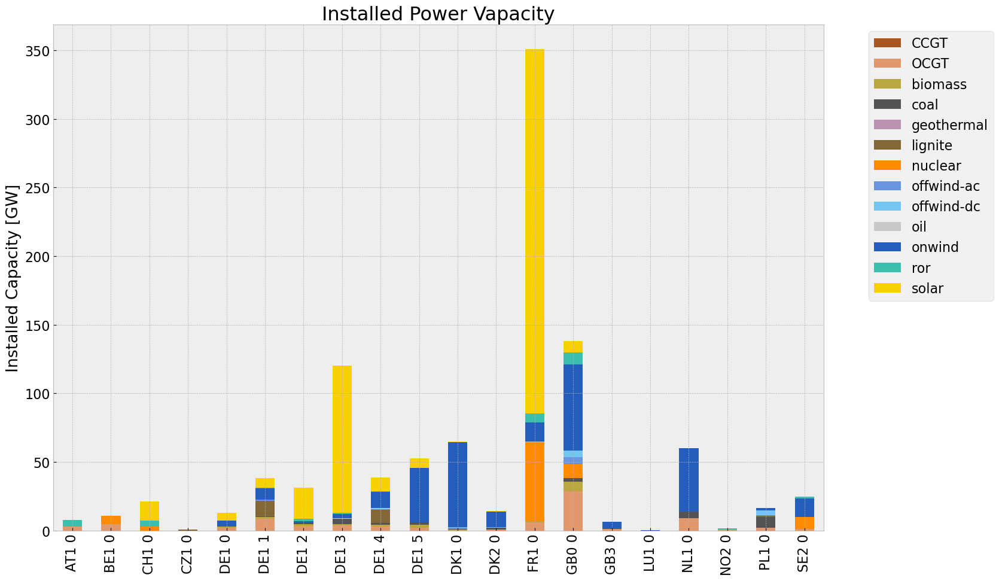

<Figure size 640x480 with 0 Axes>

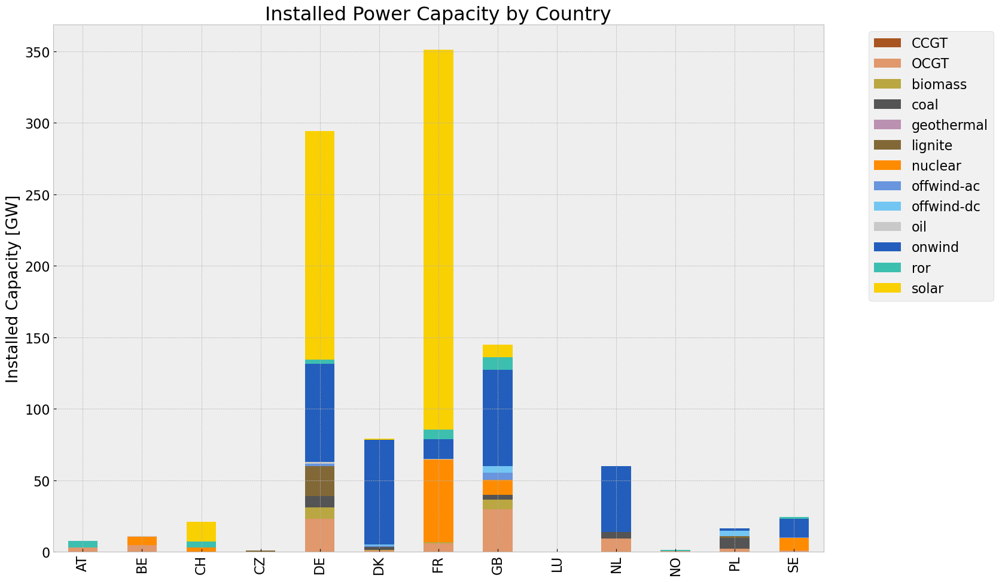

In [52]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

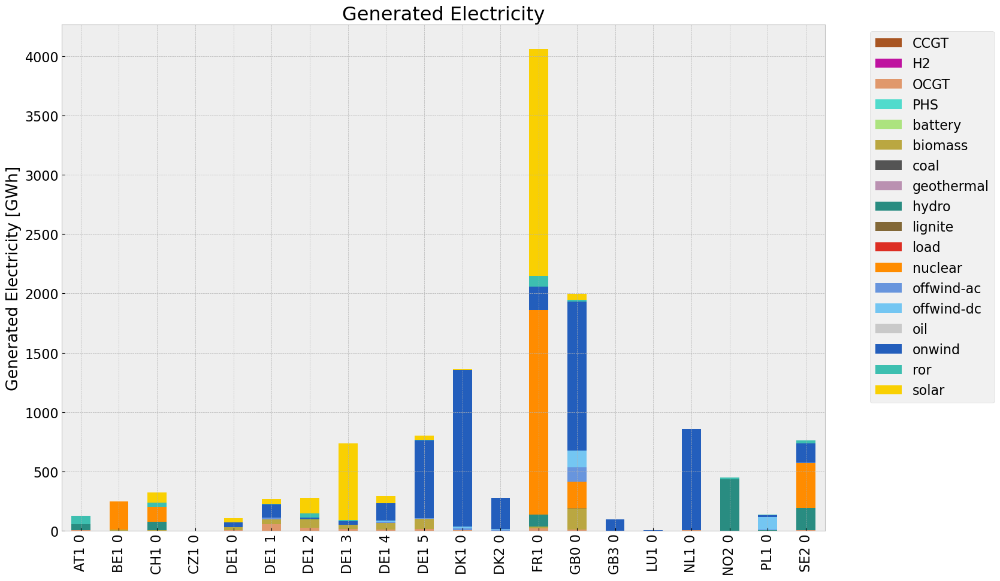

<Figure size 640x480 with 0 Axes>

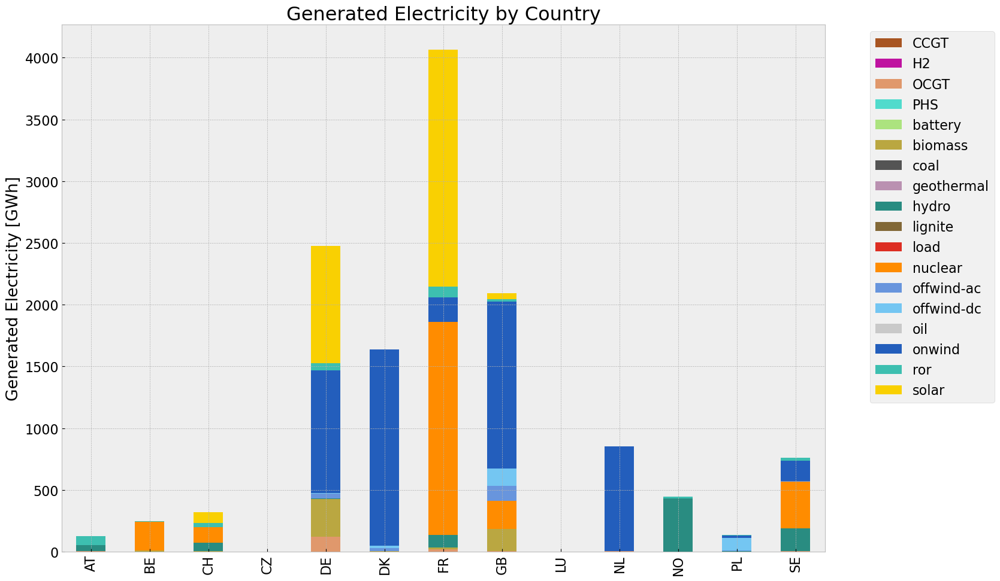

In [53]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

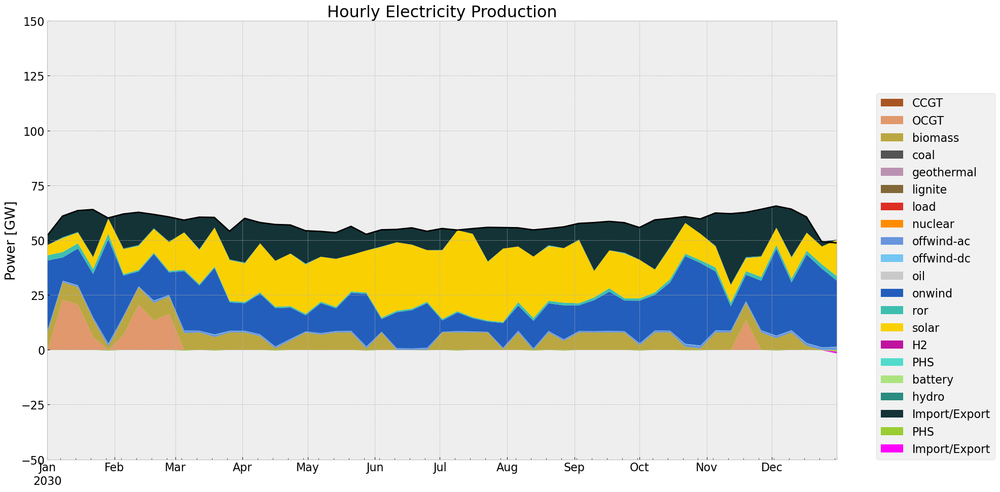

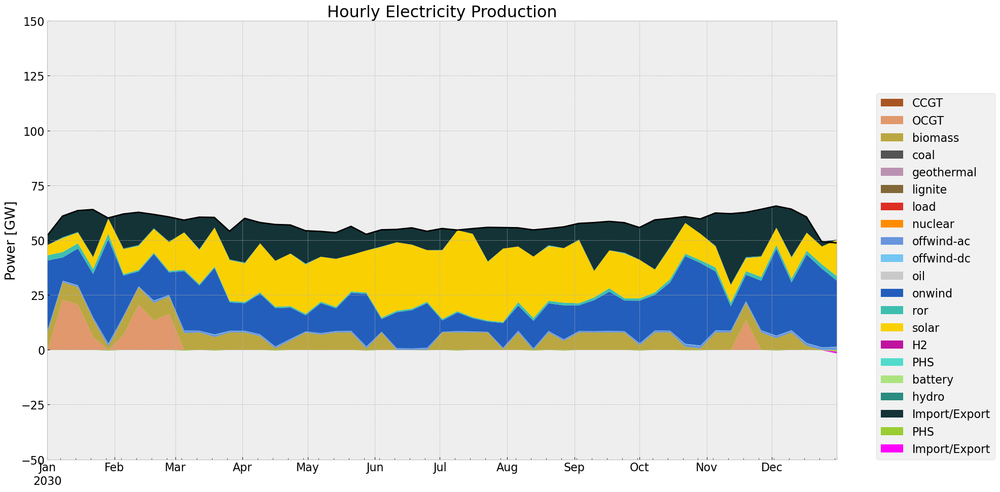

In [54]:
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq

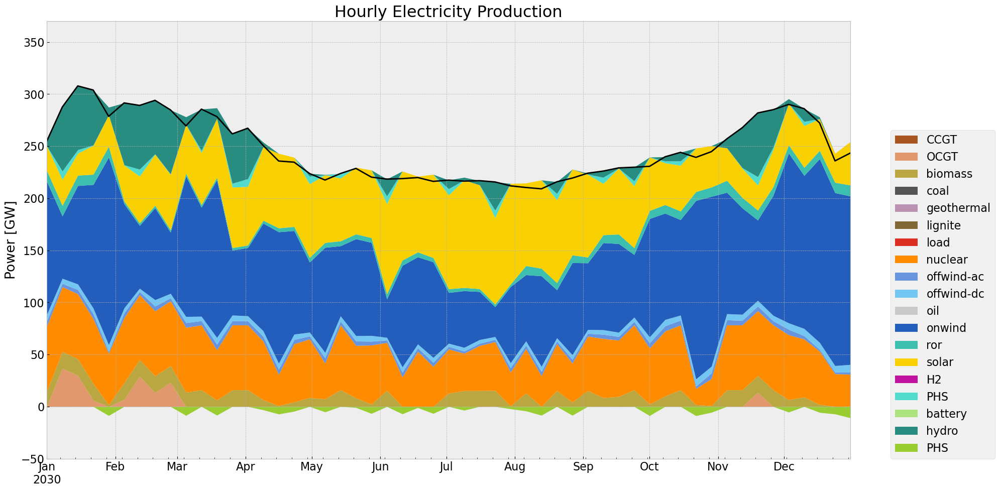

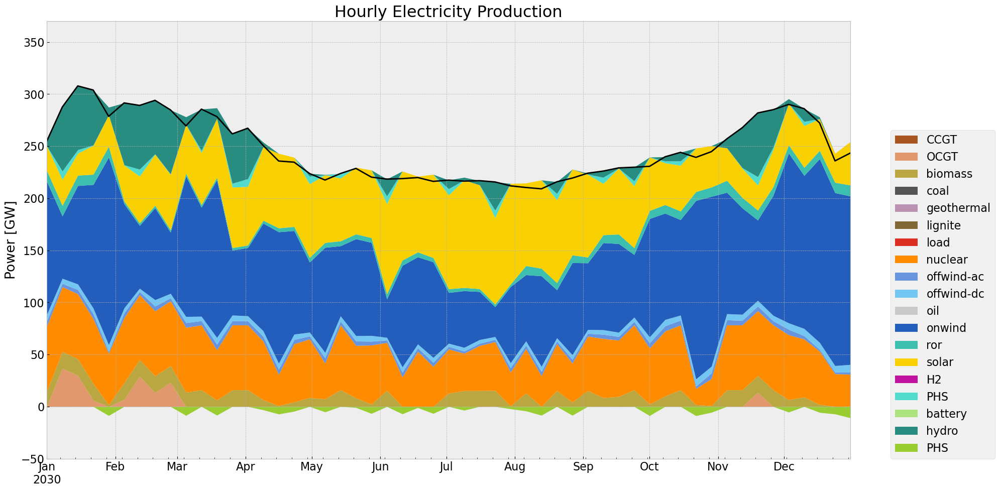

In [55]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)

### Storage

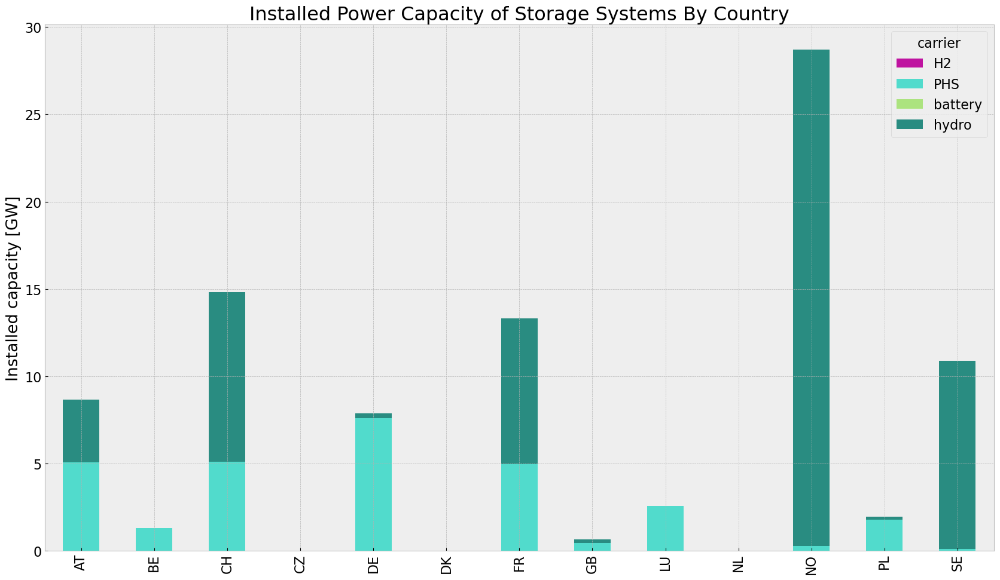

In [56]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


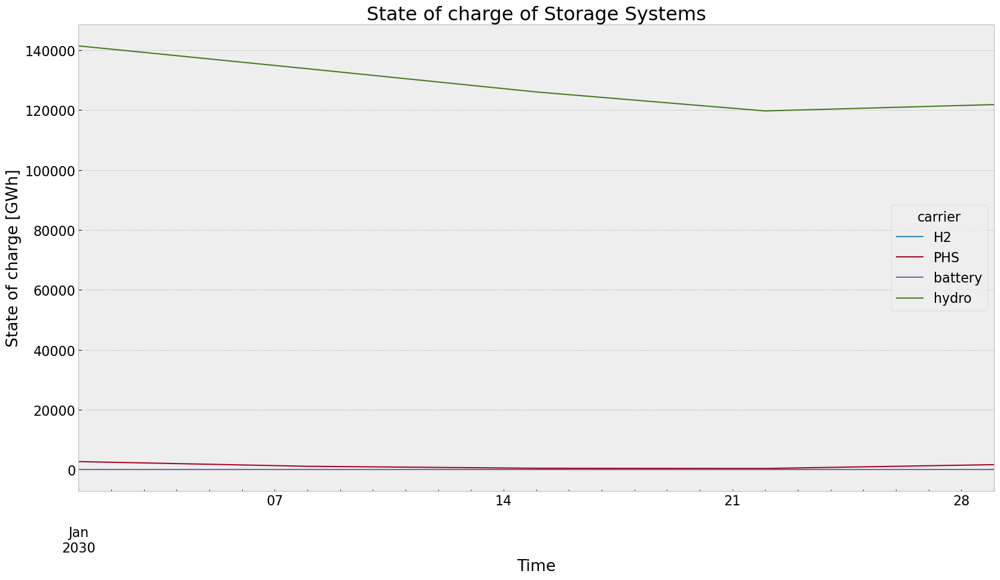

In [57]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


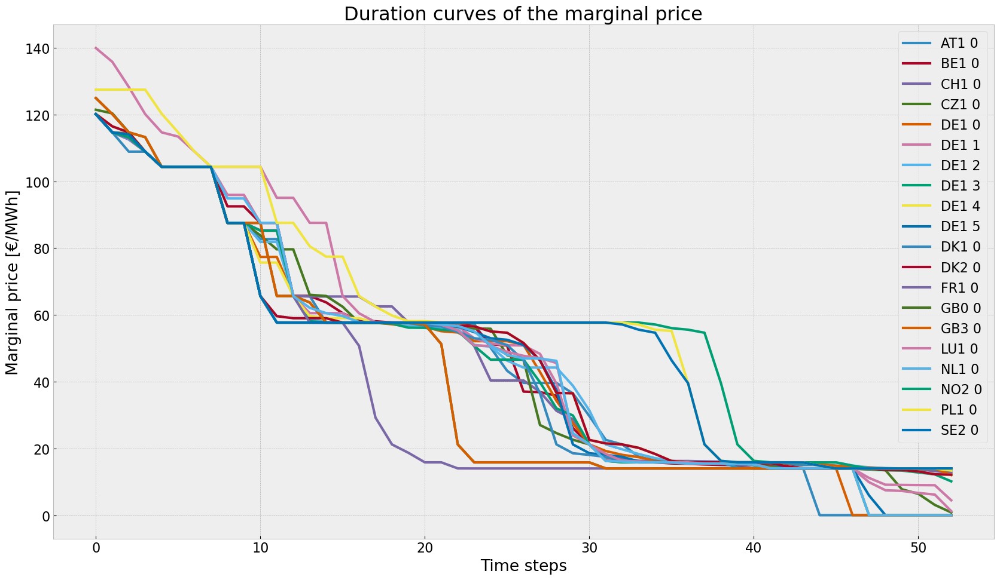

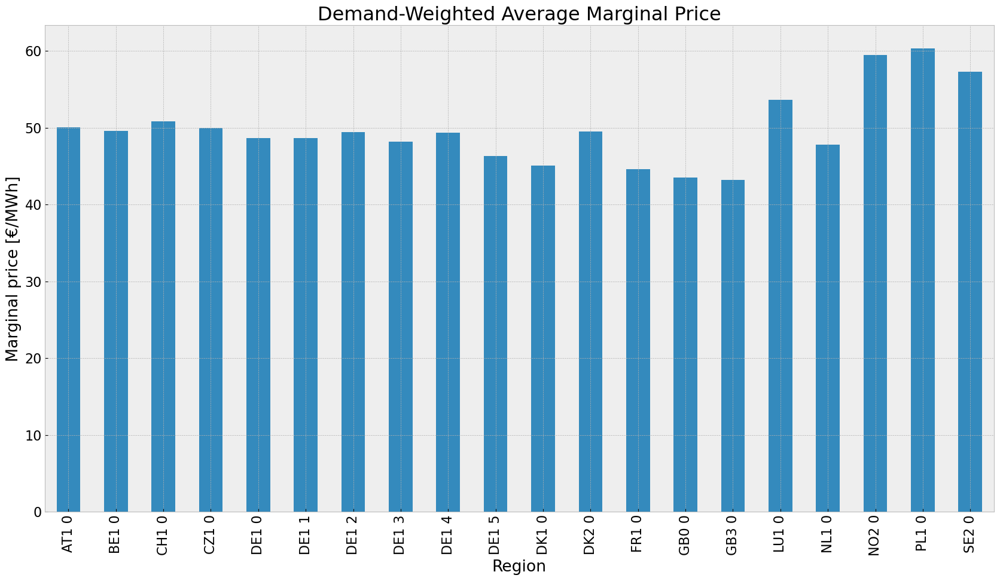

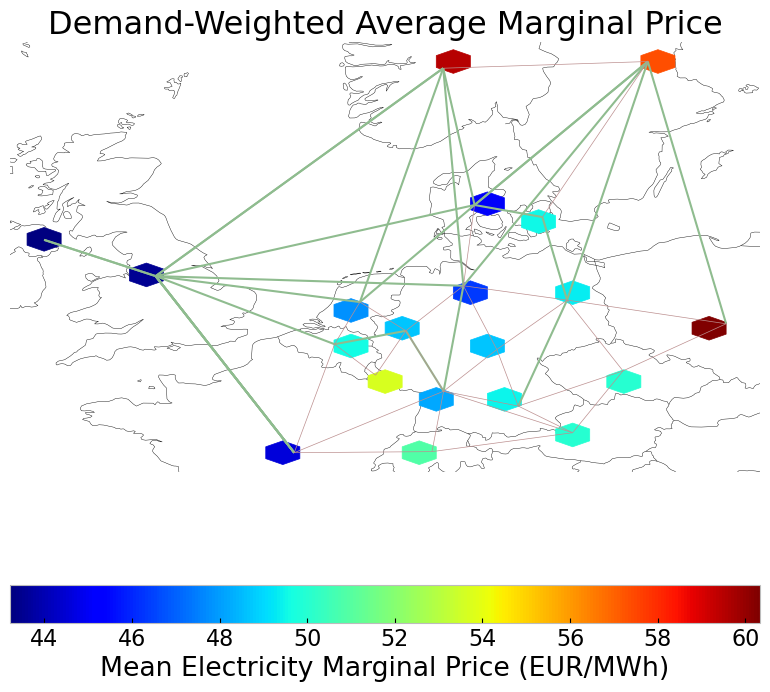

In [58]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [59]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,1.589184e+05,0.451621,0.1980,69673.135984
biomass,5.176279e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329908,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,0.000000e+00,0.337285,0.4069,0.000000
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.692028e+06,0.326600,0.0000,0.000000
offwind-ac,1.967836e+05,1.000000,0.0000,0.000000


## 2. Noinv

In [60]:
n2 = droughtscenario(n, cut_start, duration, reductionto)

### No Investment

In [61]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)


In [62]:
#BAse RH
n_roll = n.copy()
no_inv(n_roll,n)
n_roll.storage_units['cylic_state_of_charge'] = False
n_roll.storage_units['cylic_state_of_charge_per_period'] = False


horizon = 4
optimize.optimize_with_rolling_horizon(n_roll, horizon=int(horizon), overlap=0, solver_name='gurobi')
#filename = f"base_{contingency}_roll.nc"
#n_roll = import_nc_file(directory, filename)
n_roll.name = f'base_{contingency}_roll'


INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-452t_tfn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-452t_tfn.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xc83492e6


INFO:gurobipy:Model fingerprint: 0xc83492e6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1122 columns


INFO:gurobipy:Presolve removed 4248 rows and 1122 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 962 columns, 1582 nonzeros


INFO:gurobipy:Presolved: 224 rows, 962 columns, 1582 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5767799e+07   1.112692e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5767799e+07   1.112692e+06   0.000000e+00      0s


     333    5.2655288e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     333    5.2655288e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 333 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 333 iterations and 0.05 seconds (0.01 work units)


Optimal objective  5.265528775e+09


INFO:gurobipy:Optimal objective  5.265528775e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fknlbey6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fknlbey6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x5caea1a1


INFO:gurobipy:Model fingerprint: 0x5caea1a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1122 columns


INFO:gurobipy:Presolve removed 4249 rows and 1122 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 962 columns, 1581 nonzeros


INFO:gurobipy:Presolved: 223 rows, 962 columns, 1581 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5741887e+07   1.102520e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5741887e+07   1.102520e+06   0.000000e+00      0s


     335    4.3807431e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     335    4.3807431e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 335 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 335 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.380743054e+09


INFO:gurobipy:Optimal objective  4.380743054e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7gz7ck19.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7gz7ck19.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xfab126be


INFO:gurobipy:Model fingerprint: 0xfab126be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1121 columns


INFO:gurobipy:Presolve removed 4248 rows and 1121 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 963 columns, 1583 nonzeros


INFO:gurobipy:Presolved: 224 rows, 963 columns, 1583 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3343276e+07   1.115639e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.3343276e+07   1.115639e+06   0.000000e+00      0s


     345    2.8211874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     345    2.8211874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 345 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 345 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.821187377e+09


INFO:gurobipy:Optimal objective  2.821187377e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pgs1unl4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pgs1unl4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xcc1e8c75


INFO:gurobipy:Model fingerprint: 0xcc1e8c75


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1119 columns


INFO:gurobipy:Presolve removed 4249 rows and 1119 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 223 rows, 965 columns, 1584 nonzeros


INFO:gurobipy:Presolved: 223 rows, 965 columns, 1584 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9988678e+04   1.127325e+06   0.000000e+00      0s


INFO:gurobipy:       0   -4.9988678e+04   1.127325e+06   0.000000e+00      0s


     375    2.0898375e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     375    2.0898375e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 375 iterations and 0.11 seconds (0.01 work units)


INFO:gurobipy:Solved in 375 iterations and 0.11 seconds (0.01 work units)


Optimal objective  2.089837531e+09


INFO:gurobipy:Optimal objective  2.089837531e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ct5nniyk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ct5nniyk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xdd0bebac


INFO:gurobipy:Model fingerprint: 0xdd0bebac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4249 rows and 1116 columns


INFO:gurobipy:Presolve removed 4249 rows and 1116 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 968 columns, 1587 nonzeros


INFO:gurobipy:Presolved: 223 rows, 968 columns, 1587 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7804016e+05   1.142855e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.7804016e+05   1.142855e+06   0.000000e+00      0s


     396    3.6745637e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     396    3.6745637e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 396 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 396 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.674563700e+08


INFO:gurobipy:Optimal objective  3.674563700e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_nrufdw0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_nrufdw0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x17ca0378


INFO:gurobipy:Model fingerprint: 0x17ca0378


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1120 columns


INFO:gurobipy:Presolve removed 4249 rows and 1120 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 964 columns, 1583 nonzeros


INFO:gurobipy:Presolved: 223 rows, 964 columns, 1583 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5501607e+07   1.138606e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5501607e+07   1.138606e+06   0.000000e+00      0s


     330    1.2277237e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     330    1.2277237e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 330 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 330 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.227723709e+08


INFO:gurobipy:Optimal objective  1.227723709e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9k94fxu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9k94fxu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xbf040120


INFO:gurobipy:Model fingerprint: 0xbf040120


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4249 rows and 1117 columns


INFO:gurobipy:Presolve removed 4249 rows and 1117 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 223 rows, 967 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 223 rows, 967 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5437219e+07   1.139039e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5437219e+07   1.139039e+06   0.000000e+00      0s


     426    2.3597184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     426    2.3597184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 426 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 426 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.359718428e+08


INFO:gurobipy:Optimal objective  2.359718428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2qza2sin.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2qza2sin.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xdd38fd1e


INFO:gurobipy:Model fingerprint: 0xdd38fd1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1122 columns


INFO:gurobipy:Presolve removed 4249 rows and 1122 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 962 columns, 1581 nonzeros


INFO:gurobipy:Presolved: 223 rows, 962 columns, 1581 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3401526e+05   1.131754e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.3401526e+05   1.131754e+06   0.000000e+00      0s


     427    4.9163806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     427    4.9163806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 427 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 427 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.916380649e+08


INFO:gurobipy:Optimal objective  4.916380649e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7vfal5hj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7vfal5hj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xea413cbd


INFO:gurobipy:Model fingerprint: 0xea413cbd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1117 columns


INFO:gurobipy:Presolve removed 4249 rows and 1117 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 223 rows, 967 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 223 rows, 967 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6241924e+05   1.127688e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.6241924e+05   1.127688e+06   0.000000e+00      0s


     446    4.4814206e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     446    4.4814206e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 446 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 446 iterations and 0.07 seconds (0.01 work units)


Optimal objective  4.481420563e+08


INFO:gurobipy:Optimal objective  4.481420563e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b9mn65nt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b9mn65nt.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x8b9a2c33


INFO:gurobipy:Model fingerprint: 0x8b9a2c33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4250 rows and 1111 columns


INFO:gurobipy:Presolve removed 4250 rows and 1111 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 973 columns, 1591 nonzeros


INFO:gurobipy:Presolved: 222 rows, 973 columns, 1591 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.5434087e+05   1.117963e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.5434087e+05   1.117963e+06   0.000000e+00      0s


     459    5.9225330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     459    5.9225330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 459 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 459 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.922533020e+08


INFO:gurobipy:Optimal objective  5.922533020e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h41m4i2_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h41m4i2_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x47a917d2


INFO:gurobipy:Model fingerprint: 0x47a917d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1124 columns


INFO:gurobipy:Presolve removed 4248 rows and 1124 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 960 columns, 1580 nonzeros


INFO:gurobipy:Presolved: 224 rows, 960 columns, 1580 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5487342e+05   1.109280e+06   0.000000e+00      0s


INFO:gurobipy:       0   -2.5487342e+05   1.109280e+06   0.000000e+00      0s


     440    3.6392302e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     440    3.6392302e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 440 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 440 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.639230235e+08


INFO:gurobipy:Optimal objective  3.639230235e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7f2e5ab_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7f2e5ab_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xdcd4e4c7


INFO:gurobipy:Model fingerprint: 0xdcd4e4c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4249 rows and 1109 columns


INFO:gurobipy:Presolve removed 4249 rows and 1109 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 975 columns, 1594 nonzeros


INFO:gurobipy:Presolved: 223 rows, 975 columns, 1594 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.3674611e+04   1.090772e+06   0.000000e+00      0s


INFO:gurobipy:       0   -9.3674611e+04   1.090772e+06   0.000000e+00      0s


     390    2.6622187e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     390    2.6622187e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 390 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 390 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.662218676e+09


INFO:gurobipy:Optimal objective  2.662218676e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-34lgr3o7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-34lgr3o7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x53e30667


INFO:gurobipy:Model fingerprint: 0x53e30667


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1157 columns


INFO:gurobipy:Presolve removed 4248 rows and 1157 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 927 columns, 1547 nonzeros


INFO:gurobipy:Presolved: 224 rows, 927 columns, 1547 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.6412810e+04   1.122020e+06   0.000000e+00      0s


INFO:gurobipy:       0   -6.6412810e+04   1.122020e+06   0.000000e+00      0s


     445    4.5135805e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     445    4.5135805e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 445 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 445 iterations and 0.06 seconds (0.01 work units)


Optimal objective  4.513580527e+08


INFO:gurobipy:Optimal objective  4.513580527e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wi3dd7lz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wi3dd7lz.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1702 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1702 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


Model fingerprint: 0x78f3a2a1


INFO:gurobipy:Model fingerprint: 0x78f3a2a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1087 rows and 349 columns


INFO:gurobipy:Presolve removed 1087 rows and 349 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 31 rows, 172 columns, 262 nonzeros


INFO:gurobipy:Presolved: 31 rows, 172 columns, 262 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2844390e+03   2.599194e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2844390e+03   2.599194e+05   0.000000e+00      0s


      31    6.7572934e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      31    6.7572934e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 31 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 31 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.757293423e+06


INFO:gurobipy:Optimal objective  6.757293423e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 6.76e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


In [63]:
n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 59.82it/s]
INFO:linopy.io: Writing time: 0.8s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tfl5aqm9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tfl5aqm9.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x8908dbb5


INFO:gurobipy:Model fingerprint: 0x8908dbb5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e-01, 2e+04]


INFO:gurobipy:  Bounds range     [7e-01, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56296 rows and 14865 columns


INFO:gurobipy:Presolve removed 56296 rows and 14865 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2958 rows, 12748 columns, 20953 nonzeros


INFO:gurobipy:Presolved: 2958 rows, 12748 columns, 20953 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.629e+03


INFO:gurobipy: AA' NZ     : 8.629e+03


 Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


 Factor Ops : 6.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.519e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06408614e+13 -3.23623715e+13  7.13e+05 1.46e-11  9.41e+09     0s


INFO:gurobipy:   0   2.06408614e+13 -3.23623715e+13  7.13e+05 1.46e-11  9.41e+09     0s


   1   2.51970070e+12 -1.01808636e+13  7.45e+04 8.73e-11  1.19e+09     0s


INFO:gurobipy:   1   2.51970070e+12 -1.01808636e+13  7.45e+04 8.73e-11  1.19e+09     0s


   2   4.40758857e+11 -2.97388773e+12  6.97e+03 8.73e-11  1.82e+08     0s


INFO:gurobipy:   2   4.40758857e+11 -2.97388773e+12  6.97e+03 8.73e-11  1.82e+08     0s


   3   1.02435144e+11 -4.93448385e+11  3.41e+02 6.98e-10  2.46e+07     0s


INFO:gurobipy:   3   1.02435144e+11 -4.93448385e+11  3.41e+02 6.98e-10  2.46e+07     0s


   4   5.81395750e+10 -1.01924860e+11  4.19e+01 1.53e-10  6.34e+06     0s


INFO:gurobipy:   4   5.81395750e+10 -1.01924860e+11  4.19e+01 1.53e-10  6.34e+06     0s


   5   4.54263563e+10 -3.19304681e+10  1.89e+01 6.18e-11  3.05e+06     0s


INFO:gurobipy:   5   4.54263563e+10 -3.19304681e+10  1.89e+01 6.18e-11  3.05e+06     0s


   6   3.60053801e+10 -2.04352177e+09  8.18e+00 5.82e-11  1.50e+06     0s


INFO:gurobipy:   6   3.60053801e+10 -2.04352177e+09  8.18e+00 5.82e-11  1.50e+06     0s


   7   3.16187183e+10  1.21471729e+10  4.77e+00 5.82e-11  7.65e+05     0s


INFO:gurobipy:   7   3.16187183e+10  1.21471729e+10  4.77e+00 5.82e-11  7.65e+05     0s


   8   2.61181971e+10  1.92122195e+10  7.15e-01 5.82e-11  2.71e+05     0s


INFO:gurobipy:   8   2.61181971e+10  1.92122195e+10  7.15e-01 5.82e-11  2.71e+05     0s


   9   2.53231056e+10  2.15965579e+10  4.03e-01 5.82e-11  1.46e+05     0s


INFO:gurobipy:   9   2.53231056e+10  2.15965579e+10  4.03e-01 5.82e-11  1.46e+05     0s


  10   2.47228868e+10  2.29685554e+10  1.85e-01 5.82e-11  6.88e+04     0s


INFO:gurobipy:  10   2.47228868e+10  2.29685554e+10  1.85e-01 5.82e-11  6.88e+04     0s


  11   2.45173803e+10  2.36656100e+10  1.15e-01 5.82e-11  3.34e+04     0s


INFO:gurobipy:  11   2.45173803e+10  2.36656100e+10  1.15e-01 5.82e-11  3.34e+04     0s


  12   2.42852175e+10  2.38776059e+10  3.85e-02 5.82e-11  1.60e+04     0s


INFO:gurobipy:  12   2.42852175e+10  2.38776059e+10  3.85e-02 5.82e-11  1.60e+04     0s


  13   2.42031286e+10  2.40897780e+10  1.32e-02 5.82e-11  4.45e+03     0s


INFO:gurobipy:  13   2.42031286e+10  2.40897780e+10  1.32e-02 5.82e-11  4.45e+03     0s


  14   2.41719045e+10  2.41287239e+10  4.67e-03 5.82e-11  1.69e+03     0s


INFO:gurobipy:  14   2.41719045e+10  2.41287239e+10  4.67e-03 5.82e-11  1.69e+03     0s


  15   2.41650358e+10  2.41423657e+10  2.83e-03 5.82e-11  8.89e+02     0s


INFO:gurobipy:  15   2.41650358e+10  2.41423657e+10  2.83e-03 5.82e-11  8.89e+02     0s


  16   2.41580339e+10  2.41487932e+10  1.03e-03 5.82e-11  3.62e+02     0s


INFO:gurobipy:  16   2.41580339e+10  2.41487932e+10  1.03e-03 5.82e-11  3.62e+02     0s


  17   2.41555926e+10  2.41516232e+10  4.17e-04 5.82e-11  1.56e+02     0s


INFO:gurobipy:  17   2.41555926e+10  2.41516232e+10  4.17e-04 5.82e-11  1.56e+02     0s


  18   2.41541295e+10  2.41529696e+10  6.23e-05 8.73e-11  4.55e+01     0s


INFO:gurobipy:  18   2.41541295e+10  2.41529696e+10  6.23e-05 8.73e-11  4.55e+01     0s


  19   2.41539510e+10  2.41536118e+10  2.60e-05 5.82e-11  1.33e+01     0s


INFO:gurobipy:  19   2.41539510e+10  2.41536118e+10  2.60e-05 5.82e-11  1.33e+01     0s


  20   2.41538864e+10  2.41537572e+10  1.33e-05 5.82e-11  5.07e+00     0s


INFO:gurobipy:  20   2.41538864e+10  2.41537572e+10  1.33e-05 5.82e-11  5.07e+00     0s


  21   2.41538210e+10  2.41538076e+10  3.49e-07 5.82e-11  5.28e-01     0s


INFO:gurobipy:  21   2.41538210e+10  2.41538076e+10  3.49e-07 5.82e-11  5.28e-01     0s


  22   2.41538180e+10  2.41538165e+10  1.26e-08 5.82e-11  5.70e-02     0s


INFO:gurobipy:  22   2.41538180e+10  2.41538165e+10  1.26e-08 5.82e-11  5.70e-02     0s


  23   2.41538178e+10  2.41538175e+10  3.15e-09 5.82e-11  1.11e-02     0s


INFO:gurobipy:  23   2.41538178e+10  2.41538175e+10  3.15e-09 5.82e-11  1.11e-02     0s


  24   2.41538178e+10  2.41538178e+10  2.45e-07 8.73e-11  7.36e-04     0s


INFO:gurobipy:  24   2.41538178e+10  2.41538178e+10  2.45e-07 8.73e-11  7.36e-04     0s


  25   2.41538178e+10  2.41538178e+10  3.49e-08 8.73e-11  5.69e-06     0s


INFO:gurobipy:  25   2.41538178e+10  2.41538178e+10  3.49e-08 8.73e-11  5.69e-06     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.35 seconds (0.12 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.35 seconds (0.12 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 2


INFO:gurobipy:Extra simplex iterations after uncrush: 2


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4672    2.4153818e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4672    2.4153818e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4672 iterations and 0.43 seconds (0.15 work units)


INFO:gurobipy:Solved in 4672 iterations and 0.43 seconds (0.15 work units)


Optimal objective  2.415381781e+10


INFO:gurobipy:Optimal objective  2.415381781e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.42e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export model for later use

In [64]:
file = f"{country}_{buses}_{le}_base_roll_solved_168h.nc"
output_path = os.path.join(dir, file)
n_roll.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.5_base_roll_solved_168h.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses


<xarray.Dataset> Size: 277kB
Dimensions:                                         (snapshots: 53,
                                                     investment_periods: 0,
                                                     global_constraints_i: 1,
                                                     links_i: 28,
                                                     links_t_p0_i: 15,
                                                     links_t_p1_i: 15,
                                                     ...
                                                     lines_t_p1_i: 27,
                                                     lines_t_loss_i: 27,
                                                     buses_i: 20,
                                                     buses_t_p_i: 20,
                                                     buses_t_v_ang_i: 18,
                                                     buses_t_marginal_price_i: 20)
Coordinates: (12/28)
  * snapshots                                       (snapshots) int64 424B 0 ...
  * investment_periods                              (investment_periods) int64 0B ...
  * global_constraints_i                            (global_constraints_i) object 8B ...
  * links_i                                         (links_i) object 224B '14...
  * links_t_p0_i                                    (links_t_p0_i) object 120B ...
  * links_t_p1_i                                    (links_t_p1_i) object 120B ...
    ...                                              ...
  * lines_t_p1_i                                    (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                  (lines_t_loss_i) object 216B ...
  * buses_i                                         (buses_i) object 160B 'AT...
  * buses_t_p_i                                     (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                 (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                        (buses_t_marginal_price_i) object 160B ...
Data variables: (12/105)
    snapshots_snapshot                              (snapshots) datetime64[ns] 424B ...
    snapshots_objective                             (snapshots) float64 424B ...
    snapshots_generators                            (snapshots) float64 424B ...
    snapshots_stores                                (snapshots) float64 424B ...
    investment_periods_objective                    (investment_periods) float64 0B ...
    investment_periods_years                        (investment_periods) float64 0B ...
    ...                                              ...
    buses_country                                   (buses_i) object 160B 'AT...
    buses_control                                   (buses_i) object 160B 'Sl...
    buses_generator                                 (buses_i) object 160B 'AT...
    buses_t_p                                       (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                                   (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                          (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            base_drought_roll
    network_objective:       6757293.422799904
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [65]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_drought.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses


<xarray.Dataset> Size: 269kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0,
                                           global_constraints_i: 1,
                                           links_i: 28, links_t_p0_i: 15,
                                           links_t_p1_i: 15,
                                           storage_units_i: 65,
                                           ...
                                           carriers_i: 21, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 120B '14814' ...
  * links_t_p1_i                          (links_t_p1_i) object 120B '14814' ...
    ...                                    ...
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/101)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_drought
    network_objective:       24153817808.314026
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [66]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Base Rolling Horizon

In [67]:
tot_cos_base_roll=n_roll.objective/1e9 #billion €
system_cost_base_roll = system_cost(n_roll) #million €/a
marg_price_region_base_roll = n_roll.buses_t.marginal_price.mean()
stat_base_roll = n_roll.statistics()

<Figure size 640x480 with 0 Axes>

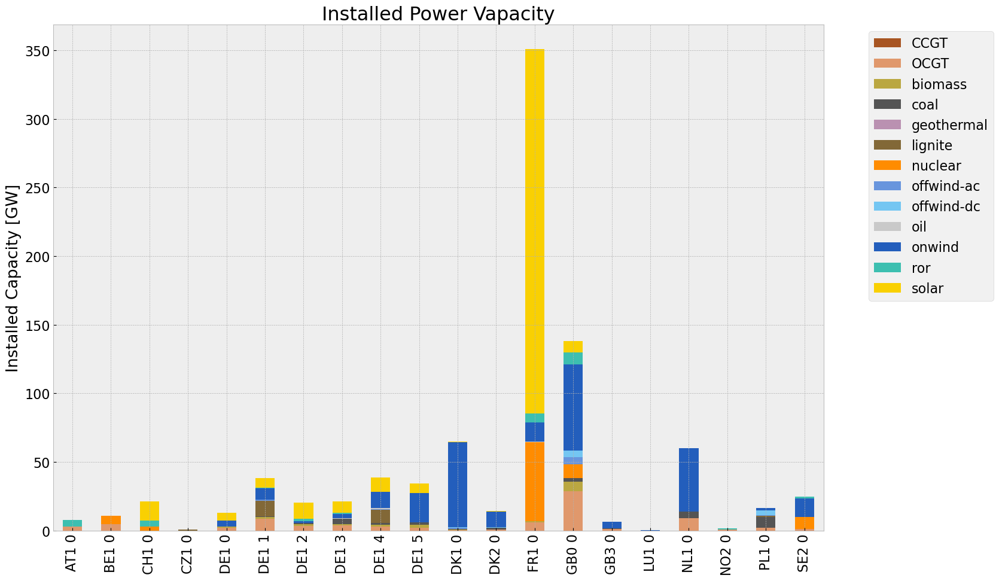

<Figure size 640x480 with 0 Axes>

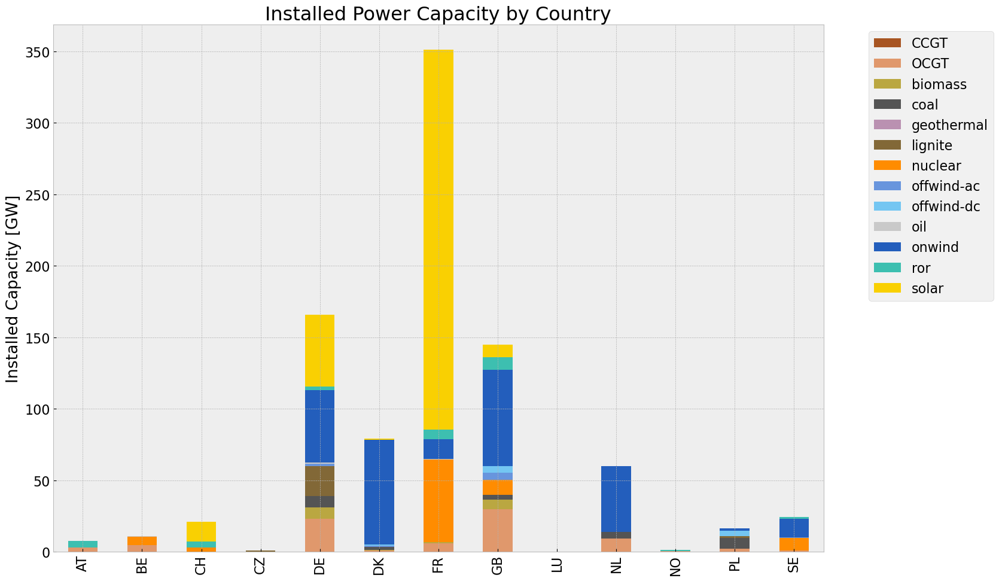

<Figure size 640x480 with 0 Axes>

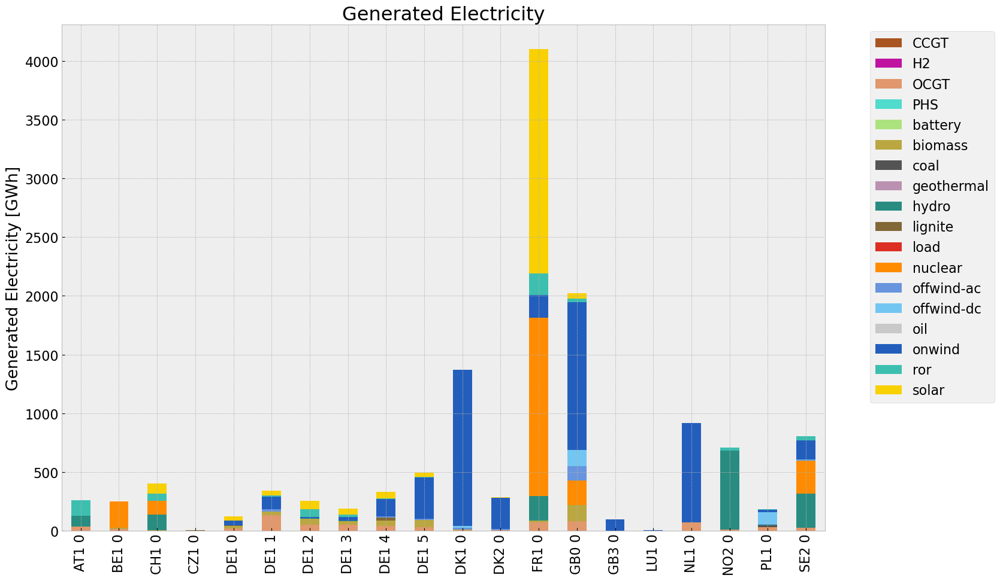

<Figure size 640x480 with 0 Axes>

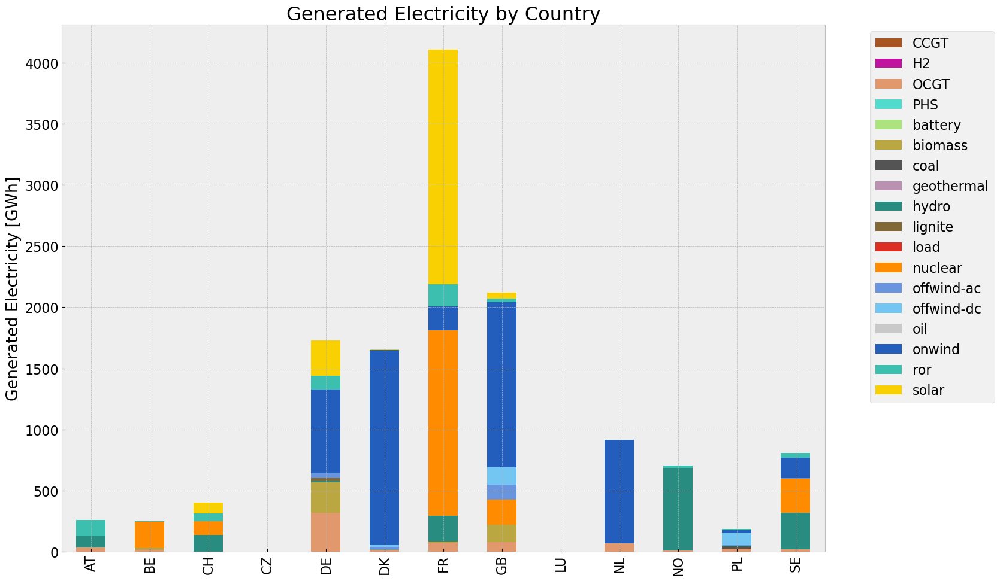

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,6.616121e+05,0.451621,0.1980,290064.564637
biomass,4.124516e+05,0.468000,0.0000,0.000000
coal,1.760208e+04,0.329908,0.3361,17932.445300
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.607613e+04,0.337285,0.4069,31458.222342
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.339853e+06,0.326600,0.0000,0.000000
offwind-ac,1.967836e+05,1.000000,0.0000,0.000000


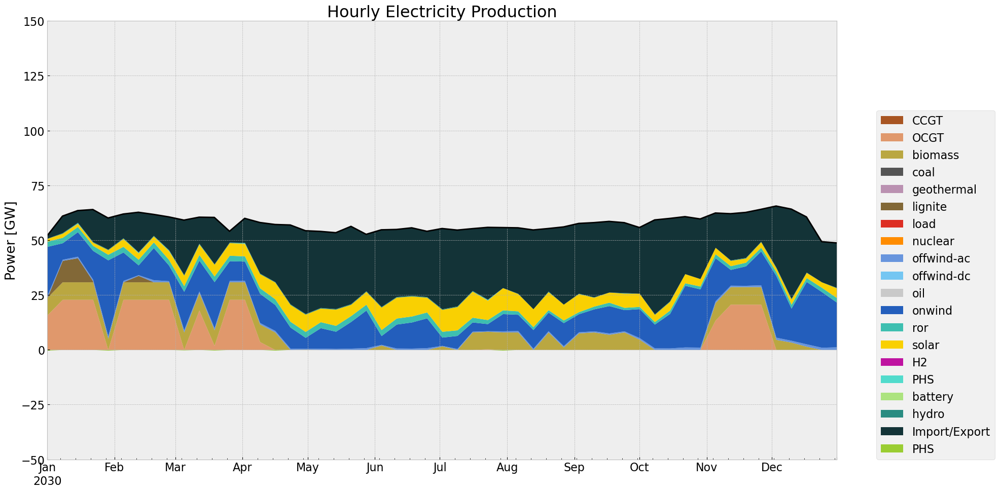

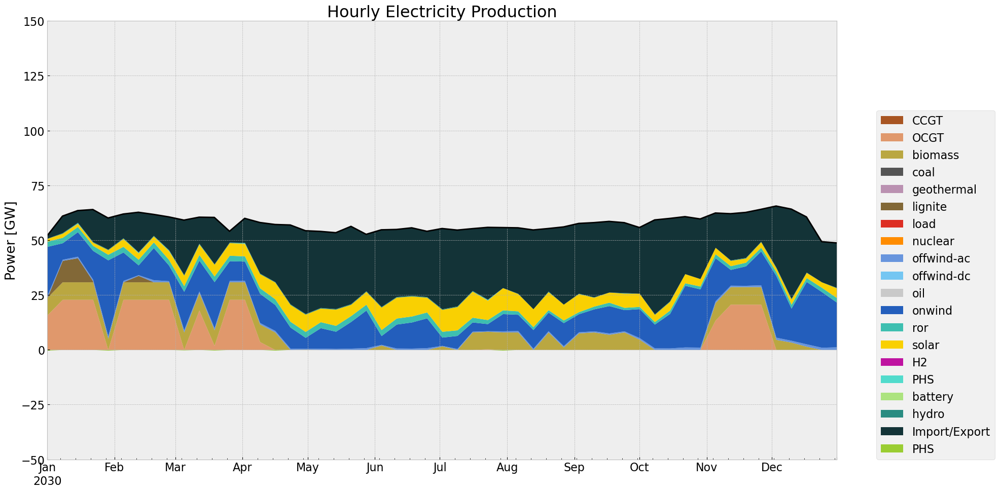

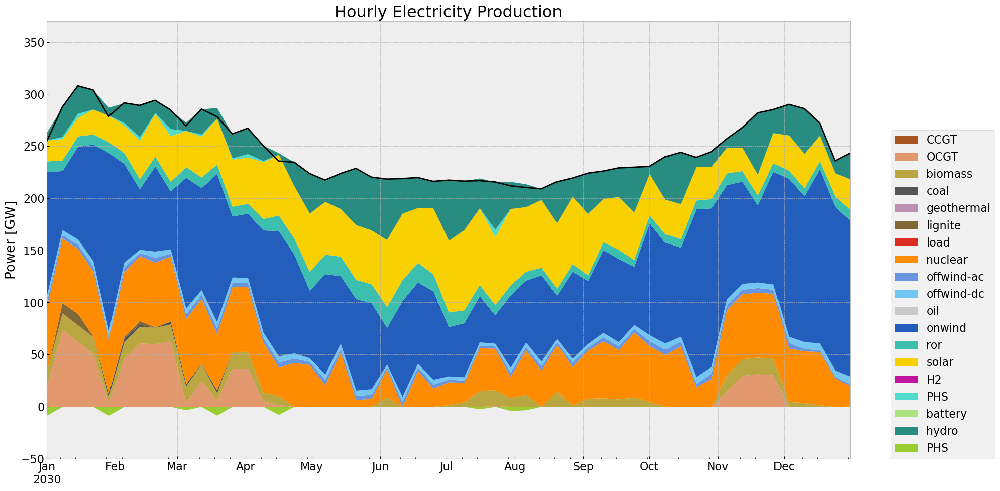

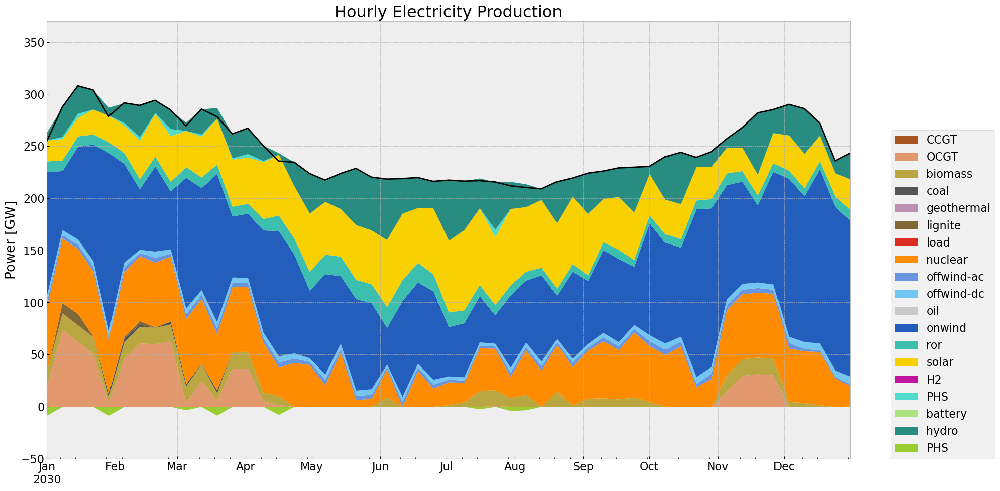

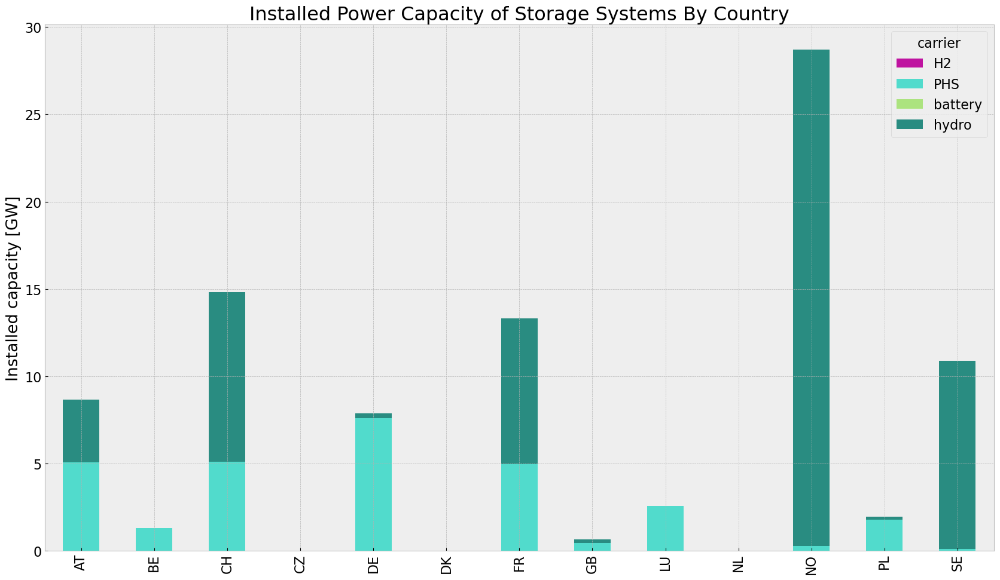

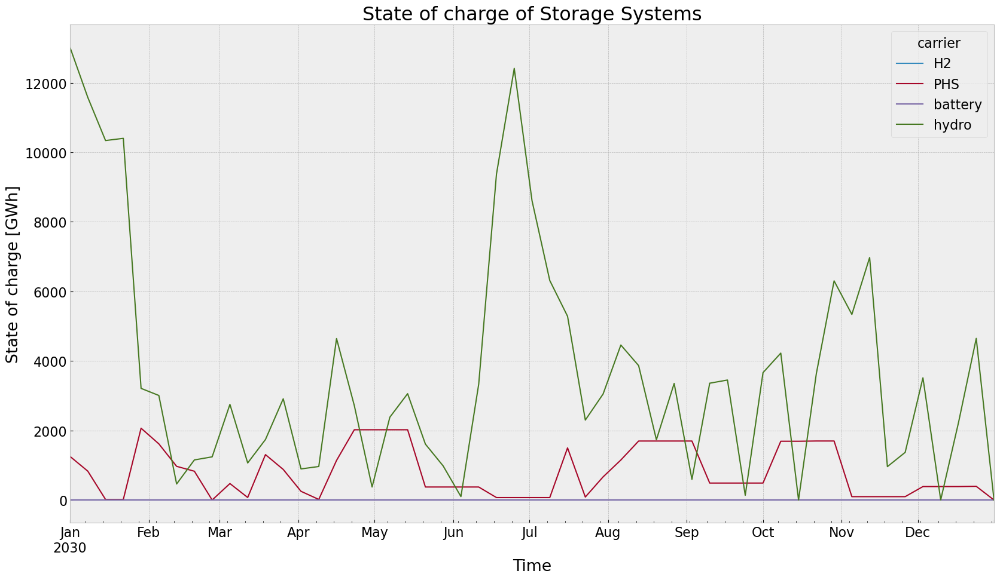

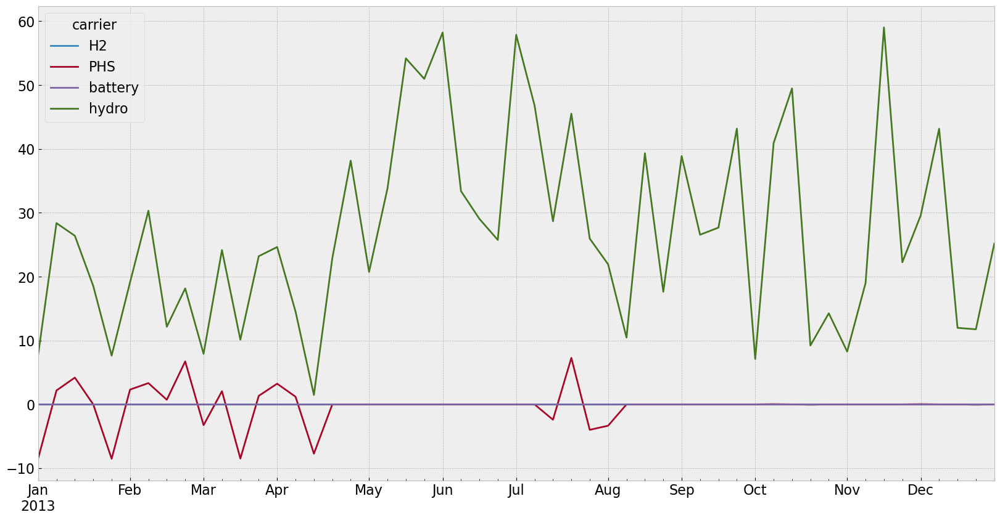

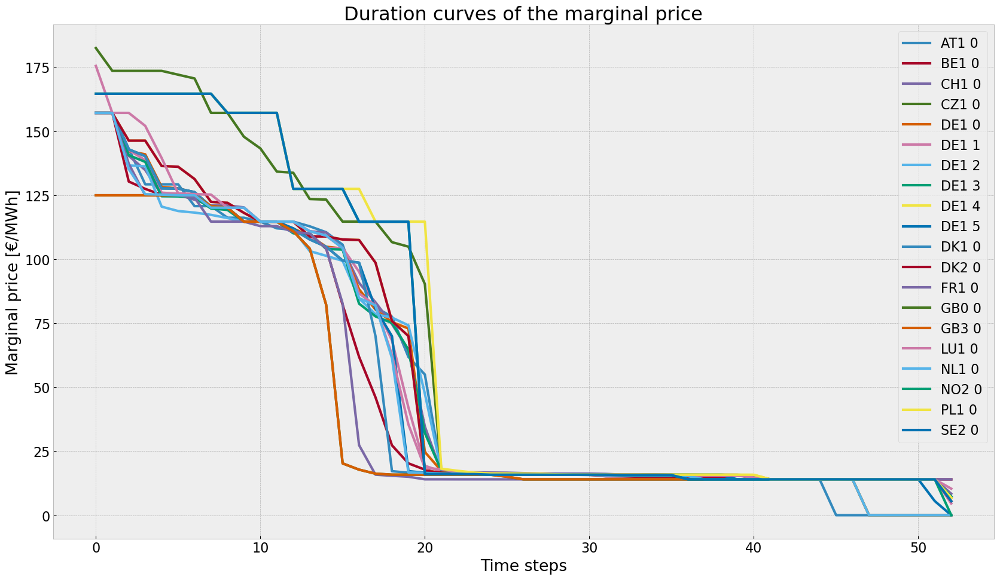

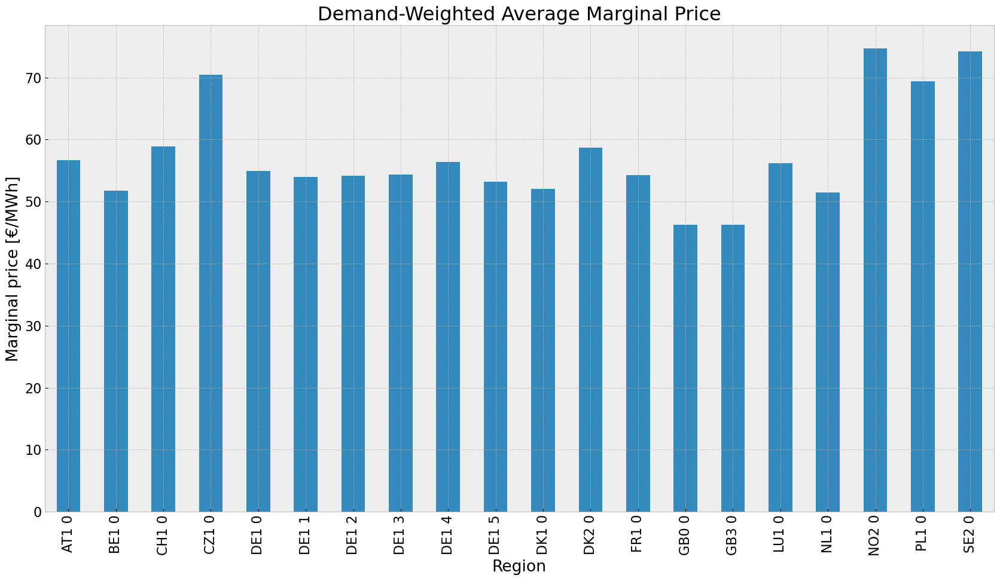

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


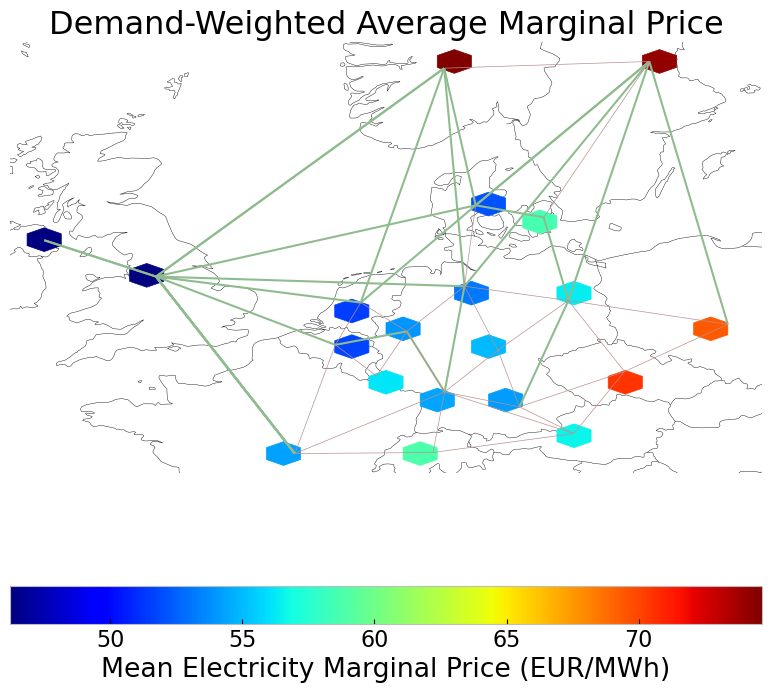

In [68]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_base_roll = inst_cap_table(n_roll, color_cap)
cap_base_roll_country = inst_cap_table_country(n_roll, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_base_roll  = gen_power_table(n_roll)
gen_base_roll_country = gen_power_table_country(n_roll)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_base_roll = inst_store_table(n_roll)

#State of Charge Storage unit
state_of_charge_plot(n_roll, '2030-01-01 00:00', '2030-12-31 21:00')
n_roll.storage_units_t.p.groupby(n_roll.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n_roll)

#avg electricity price
price_regions_table(n_roll)
price_regions(n_roll)

#Emission
em_base_roll =em_table(n_roll)
em_base_roll

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

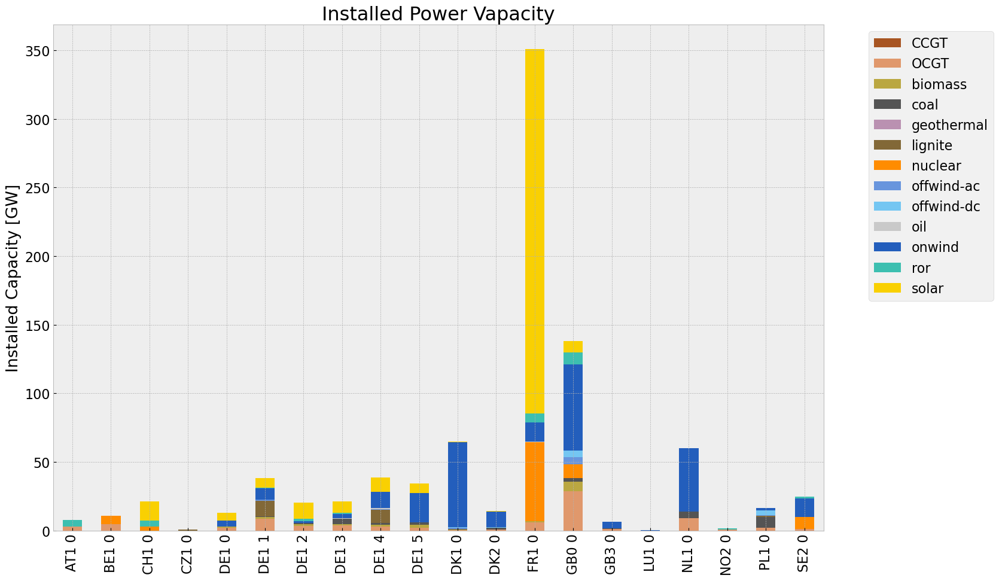

<Figure size 640x480 with 0 Axes>

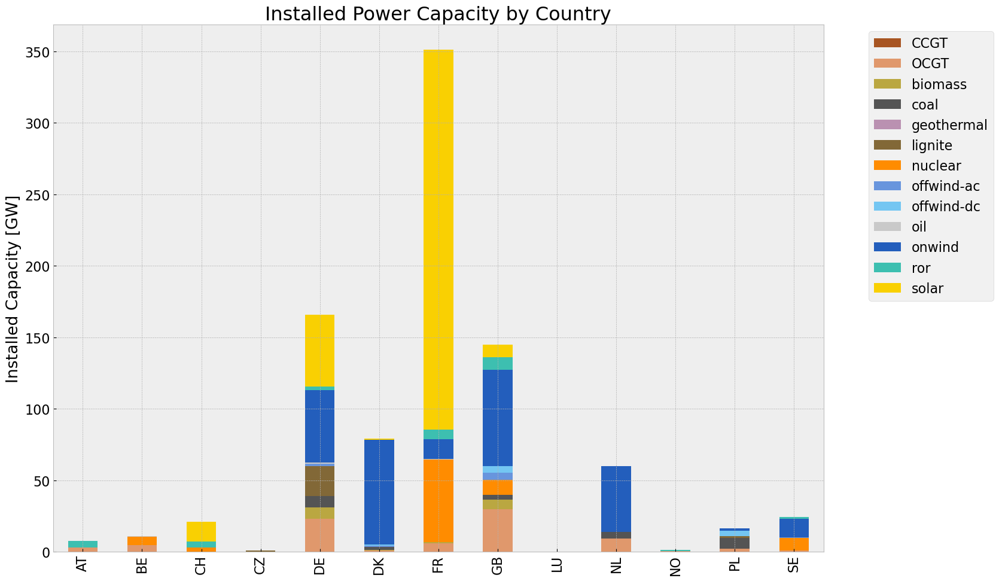

In [69]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

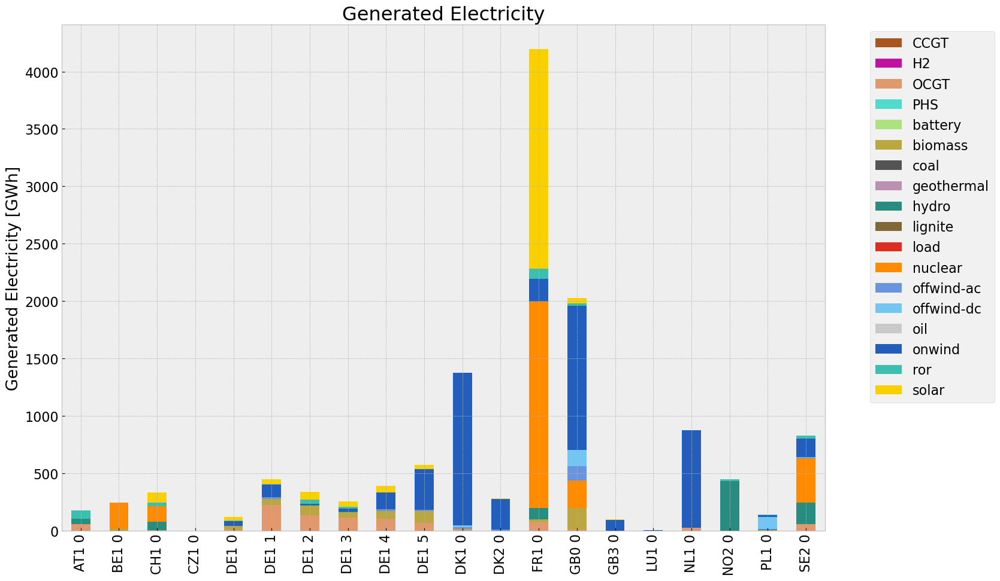

<Figure size 640x480 with 0 Axes>

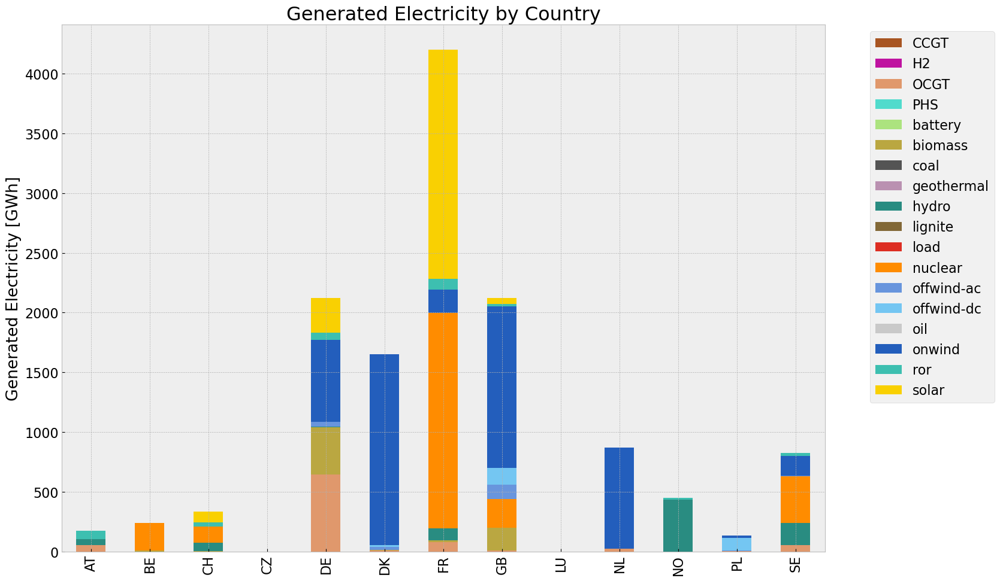

In [70]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2267199707.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2267199707.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum(

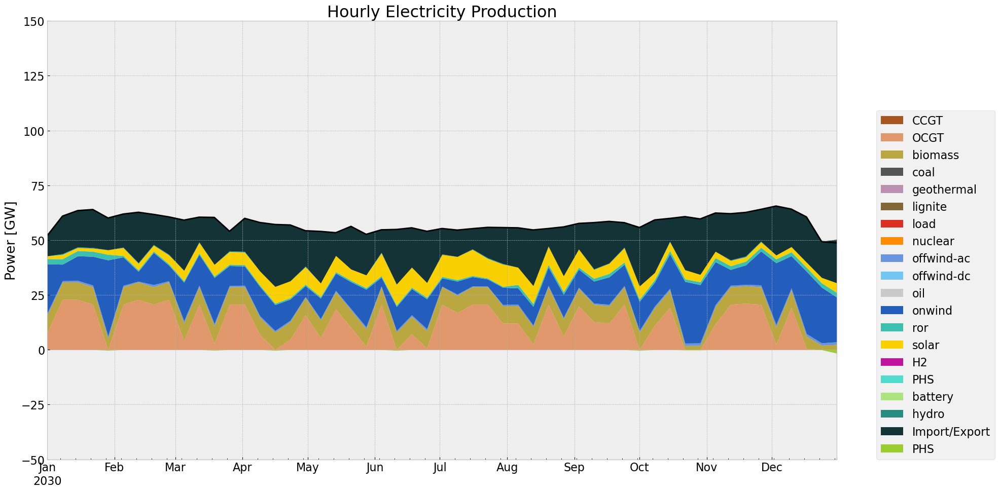

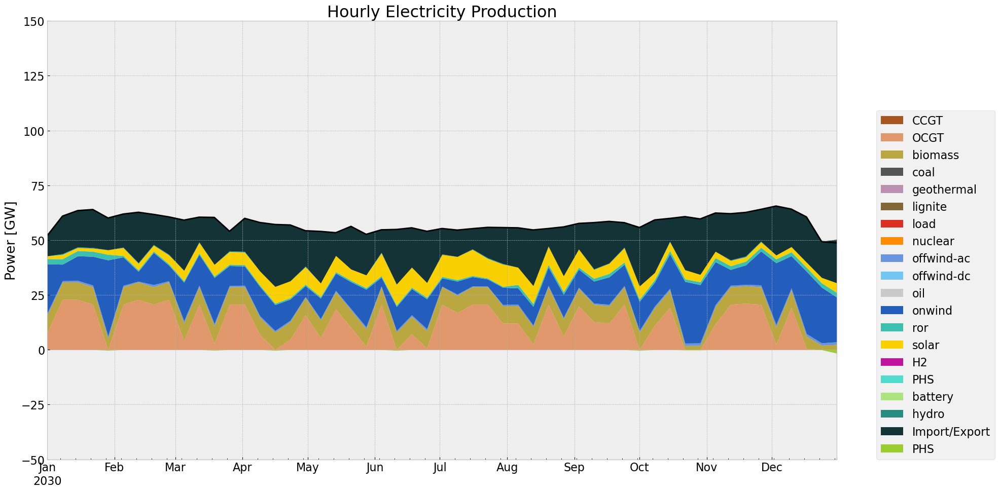

In [71]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq

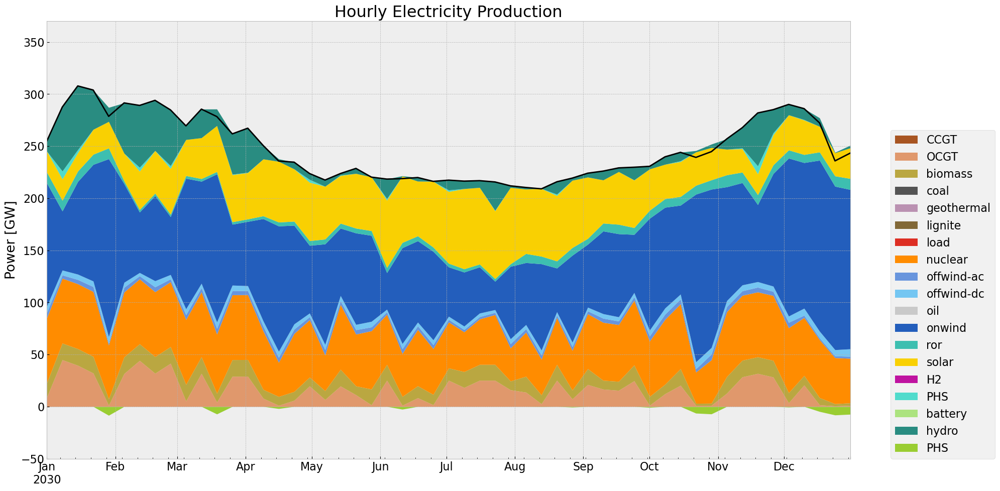

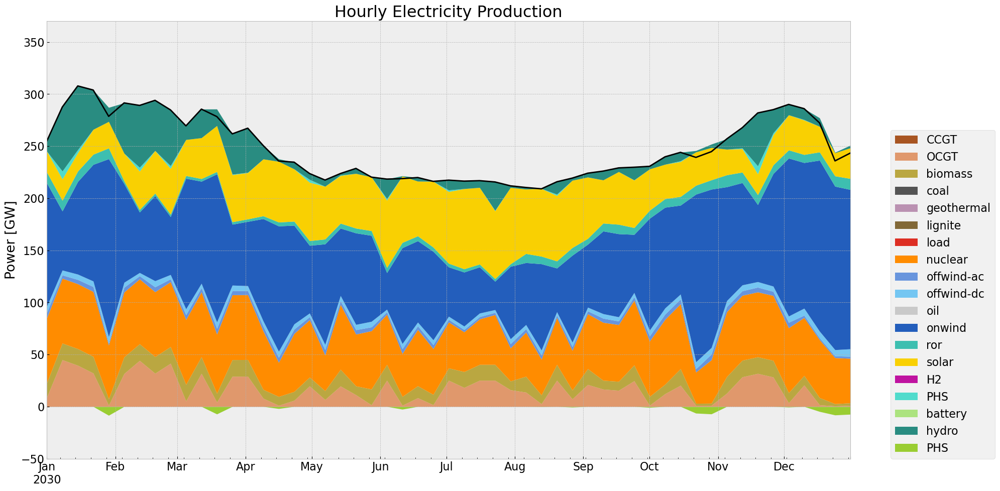

In [72]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)

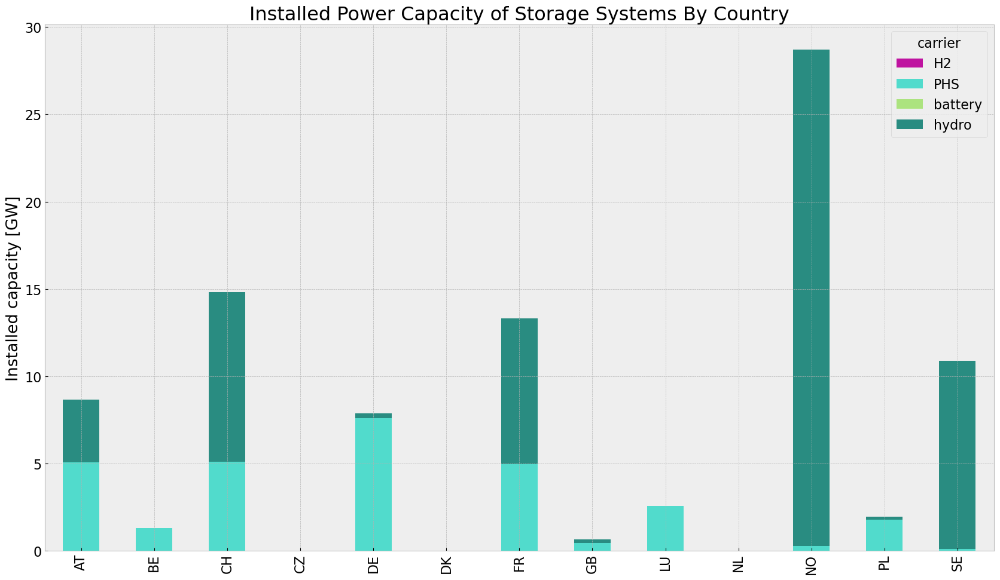

In [73]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3064997258.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, 

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,8.838377e+05,0.451621,0.1980,387492.914028
biomass,6.234764e+05,0.468000,0.0000,0.000000
coal,5.070653e+01,0.329908,0.3361,51.658232
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.323961e+02,0.337285,0.4069,159.722495
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.792859e+06,0.326600,0.0000,0.000000
offwind-ac,1.967836e+05,1.000000,0.0000,0.000000


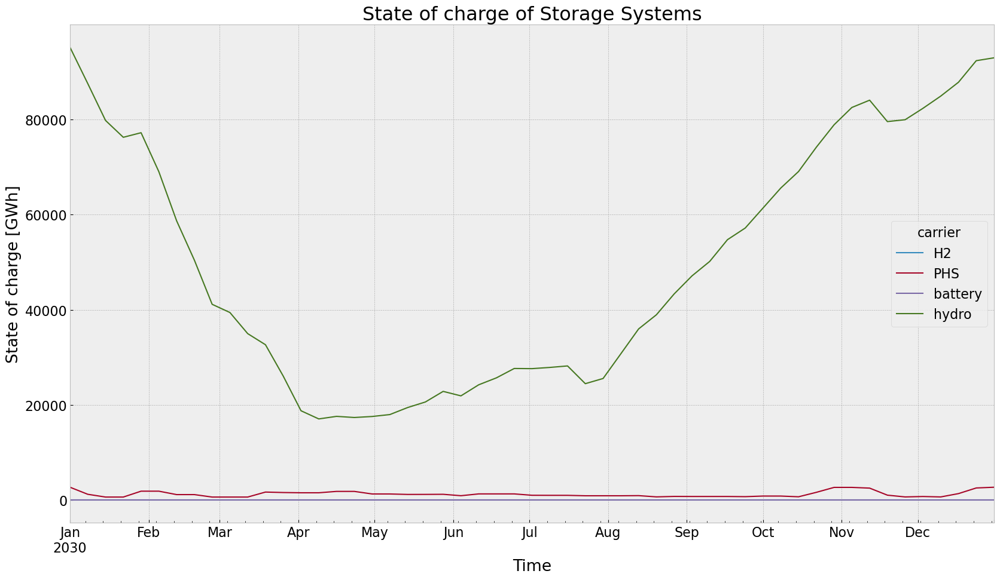

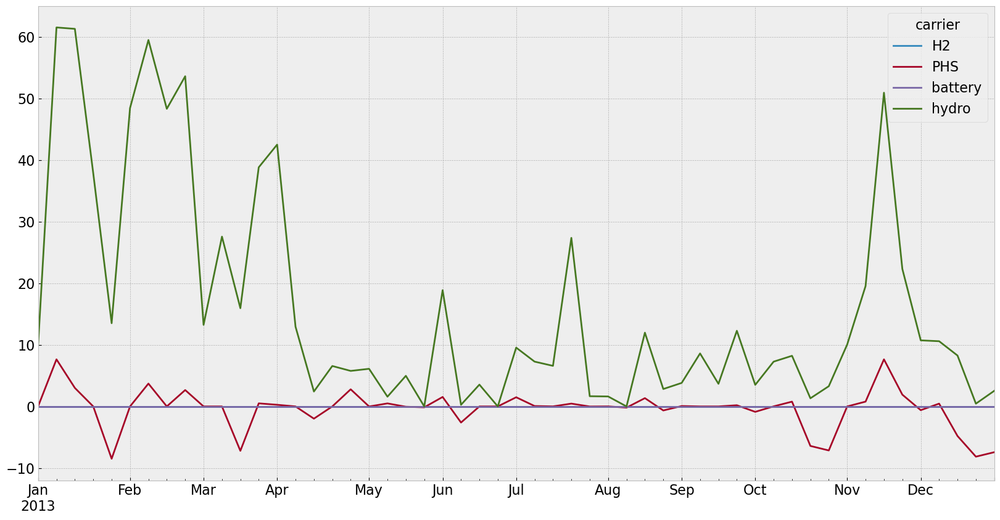

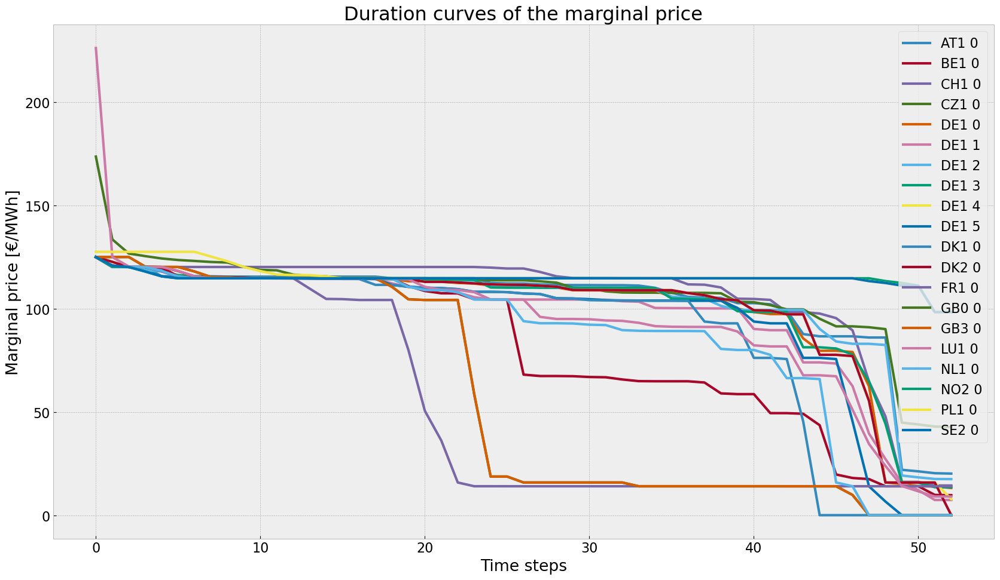

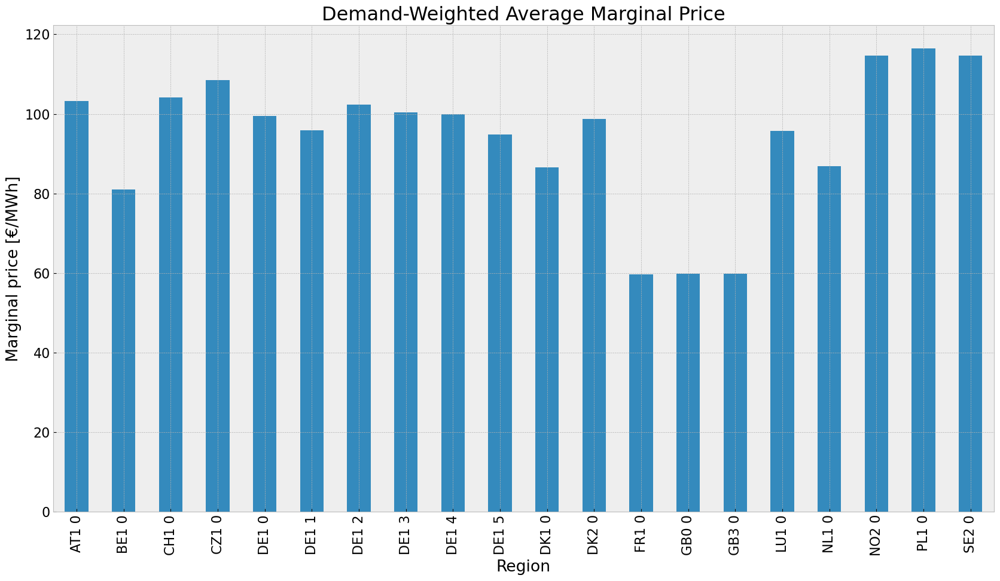

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


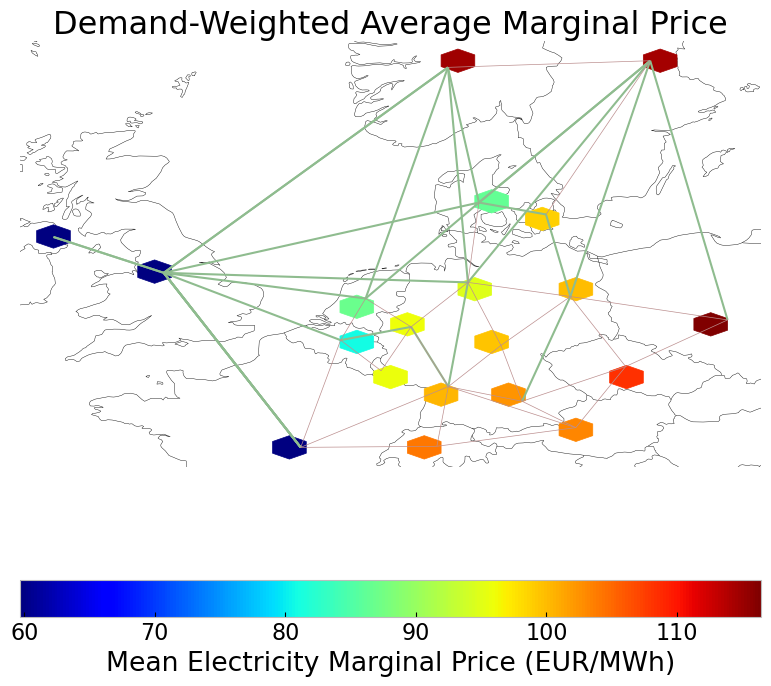

In [74]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-12-31 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [75]:
n3 = droughtscenario(n, cut_start, duration, reductionto)

no_inv(n3,n)
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l_2r1k84.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l_2r1k84.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc0189071


INFO:gurobipy:Model fingerprint: 0xc0189071


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1146 columns


INFO:gurobipy:Presolve removed 4248 rows and 1146 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 938 columns, 1533 nonzeros


INFO:gurobipy:Presolved: 224 rows, 938 columns, 1533 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5767799e+07   1.001295e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5767799e+07   1.001295e+06   0.000000e+00      0s


     283    5.2915342e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     283    5.2915342e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 283 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 283 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.291534175e+09


INFO:gurobipy:Optimal objective  5.291534175e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5d1tovrf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5d1tovrf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x53baa85b


INFO:gurobipy:Model fingerprint: 0x53baa85b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1149 columns


INFO:gurobipy:Presolve removed 4249 rows and 1149 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 935 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 223 rows, 935 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5725694e+07   9.844747e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5725694e+07   9.844747e+05   0.000000e+00      0s


     345    1.5116783e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     345    1.5116783e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 345 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 345 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.511678320e+10


INFO:gurobipy:Optimal objective  1.511678320e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.51e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbpj0ac8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbpj0ac8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xbd0bbdca


INFO:gurobipy:Model fingerprint: 0xbd0bbdca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+03]


INFO:gurobipy:  Bounds range     [2e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1160 columns


INFO:gurobipy:Presolve removed 4249 rows and 1160 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 223 rows, 924 columns, 1512 nonzeros


INFO:gurobipy:Presolved: 223 rows, 924 columns, 1512 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3030034e+08   9.962637e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3030034e+08   9.962637e+05   0.000000e+00      0s


     267    1.5900271e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    1.5900271e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.11 seconds (0.01 work units)


INFO:gurobipy:Solved in 267 iterations and 0.11 seconds (0.01 work units)


Optimal objective  1.590027126e+10


INFO:gurobipy:Optimal objective  1.590027126e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.59e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5lljabci.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5lljabci.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x243bac55


INFO:gurobipy:Model fingerprint: 0x243bac55


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+03]


INFO:gurobipy:  Bounds range     [2e+00, 2e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1145 columns


INFO:gurobipy:Presolve removed 4249 rows and 1145 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 939 columns, 1533 nonzeros


INFO:gurobipy:Presolved: 223 rows, 939 columns, 1533 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.3976581e+04   1.004121e+06   0.000000e+00      0s


INFO:gurobipy:       0   -6.3976581e+04   1.004121e+06   0.000000e+00      0s


     282    9.0237211e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    9.0237211e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 282 iterations and 0.03 seconds (0.01 work units)


Optimal objective  9.023721130e+09


INFO:gurobipy:Optimal objective  9.023721130e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4jrolv3y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4jrolv3y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7e9676dc


INFO:gurobipy:Model fingerprint: 0x7e9676dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 3e+03]


INFO:gurobipy:  Bounds range     [1e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4249 rows and 1141 columns


INFO:gurobipy:Presolve removed 4249 rows and 1141 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 943 columns, 1537 nonzeros


INFO:gurobipy:Presolved: 223 rows, 943 columns, 1537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7789240e+05   1.014749e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.7789240e+05   1.014749e+06   0.000000e+00      0s


     353    1.5272960e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     353    1.5272960e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 353 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 353 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.527295956e+09


INFO:gurobipy:Optimal objective  1.527295956e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y8naxvzr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y8naxvzr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdcf3af49


INFO:gurobipy:Model fingerprint: 0xdcf3af49


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 7e+03]


INFO:gurobipy:  Bounds range     [1e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1146 columns


INFO:gurobipy:Presolve removed 4249 rows and 1146 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 223 rows, 938 columns, 1532 nonzeros


INFO:gurobipy:Presolved: 223 rows, 938 columns, 1532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5504808e+07   1.011747e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5504808e+07   1.011747e+06   0.000000e+00      0s


     308    1.1143449e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     308    1.1143449e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 308 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 308 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.114344863e+09


INFO:gurobipy:Optimal objective  1.114344863e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-81h78mi0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-81h78mi0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xaaa7d08e


INFO:gurobipy:Model fingerprint: 0xaaa7d08e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e-01, 6e+03]


INFO:gurobipy:  Bounds range     [8e-01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4249 rows and 1144 columns


INFO:gurobipy:Presolve removed 4249 rows and 1144 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 940 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 223 rows, 940 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5435752e+07   1.012264e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5435752e+07   1.012264e+06   0.000000e+00      0s


     321    1.2500426e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     321    1.2500426e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 321 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 321 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.250042605e+09


INFO:gurobipy:Optimal objective  1.250042605e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9i8zbqf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9i8zbqf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf9d6dbf9


INFO:gurobipy:Model fingerprint: 0xf9d6dbf9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 2e+04]


INFO:gurobipy:  Bounds range     [7e-01, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1148 columns


INFO:gurobipy:Presolve removed 4249 rows and 1148 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 936 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 223 rows, 936 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3491283e+05   1.005962e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.3491283e+05   1.005962e+06   0.000000e+00      0s


     365    2.0086324e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     365    2.0086324e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 365 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 365 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.008632358e+09


INFO:gurobipy:Optimal objective  2.008632358e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n85efotq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n85efotq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf809da5d


INFO:gurobipy:Model fingerprint: 0xf809da5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1141 columns


INFO:gurobipy:Presolve removed 4249 rows and 1141 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 223 rows, 943 columns, 1537 nonzeros


INFO:gurobipy:Presolved: 223 rows, 943 columns, 1537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6241924e+05   9.854809e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6241924e+05   9.854809e+05   0.000000e+00      0s


     343    4.4933083e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     343    4.4933083e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 343 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 343 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.493308279e+08


INFO:gurobipy:Optimal objective  4.493308279e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2miu46w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2miu46w.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x4ff91a29


INFO:gurobipy:Model fingerprint: 0x4ff91a29


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4250 rows and 1136 columns


INFO:gurobipy:Presolve removed 4250 rows and 1136 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 948 columns, 1541 nonzeros


INFO:gurobipy:Presolved: 222 rows, 948 columns, 1541 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.5434087e+05   9.983844e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.5434087e+05   9.983844e+05   0.000000e+00      0s


     349    7.1698695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     349    7.1698695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 349 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 349 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.169869469e+08


INFO:gurobipy:Optimal objective  7.169869469e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-okw8ne2r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-okw8ne2r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xaab58296


INFO:gurobipy:Model fingerprint: 0xaab58296


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1149 columns


INFO:gurobipy:Presolve removed 4248 rows and 1149 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 935 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 224 rows, 935 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5487342e+05   9.875533e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.5487342e+05   9.875533e+05   0.000000e+00      0s


     349    3.9625813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     349    3.9625813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 349 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 349 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.962581259e+08


INFO:gurobipy:Optimal objective  3.962581259e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4lb8ll8u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4lb8ll8u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7be49f60


INFO:gurobipy:Model fingerprint: 0x7be49f60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4249 rows and 1132 columns


INFO:gurobipy:Presolve removed 4249 rows and 1132 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 952 columns, 1546 nonzeros


INFO:gurobipy:Presolved: 223 rows, 952 columns, 1546 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.3674611e+04   9.560147e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.3674611e+04   9.560147e+05   0.000000e+00      0s


     301    2.6627749e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     301    2.6627749e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 301 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 301 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.662774922e+09


INFO:gurobipy:Optimal objective  2.662774922e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xuuhcmld.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xuuhcmld.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa81b3cff


INFO:gurobipy:Model fingerprint: 0xa81b3cff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1184 columns


INFO:gurobipy:Presolve removed 4248 rows and 1184 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 900 columns, 1495 nonzeros


INFO:gurobipy:Presolved: 224 rows, 900 columns, 1495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.6412810e+04   9.901308e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.6412810e+04   9.901308e+05   0.000000e+00      0s


     359    5.2179310e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     359    5.2179310e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 359 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 359 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.217931008e+08


INFO:gurobipy:Optimal objective  5.217931008e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-atbw3e4m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-atbw3e4m.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x4657b672


INFO:gurobipy:Model fingerprint: 0x4657b672


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 319 columns


INFO:gurobipy:Presolve removed 1072 rows and 319 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 202 columns, 322 nonzeros


INFO:gurobipy:Presolved: 46 rows, 202 columns, 322 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0189587e+03   1.093440e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0189587e+03   1.093440e+05   0.000000e+00      0s


      45    6.7572934e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      45    6.7572934e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 45 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 45 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.757293423e+06


INFO:gurobipy:Optimal objective  6.757293423e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 6.76e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [76]:
filename = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_drought.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses


<xarray.Dataset> Size: 275kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      global_constraints_i: 1,
                                                      links_i: 28,
                                                      links_t_p0_i: 15,
                                                      links_t_p1_i: 15,
                                                      ...
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * global_constraints_i                             (global_constraints_i) object 8B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 120B ...
  * links_t_p1_i                                     (links_t_p1_i) object 120B ...
    ...                                               ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
Data variables: (12/101)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    buses_country                                    (buses_i) object 160B 'A...
    buses_control                                    (buses_i) object 160B 'S...
    buses_generator                                  (buses_i) object 160B 'A...
    buses_t_p                                        (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                                    (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                           (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_drought
    network_objective:       6757293.422799904
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [77]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

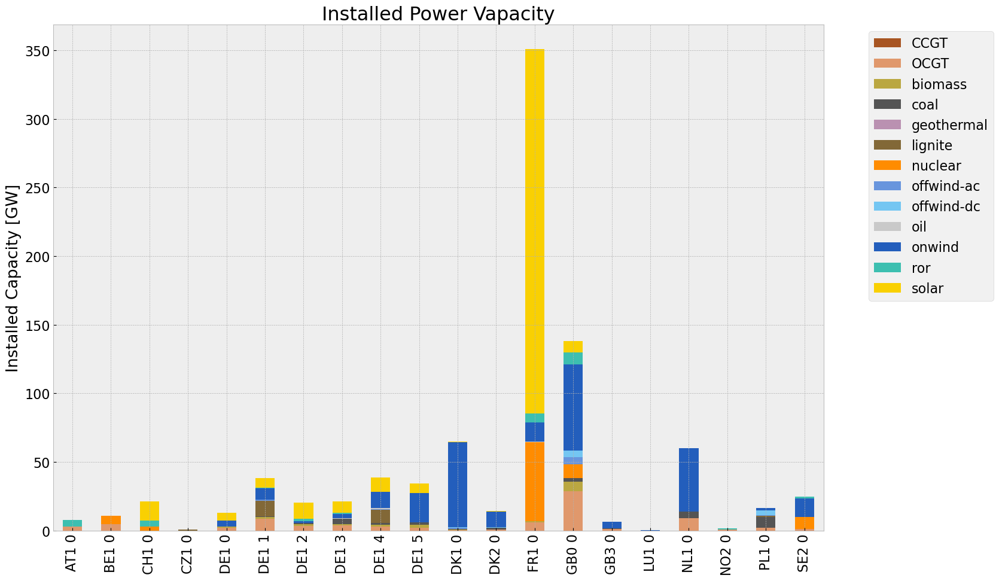

<Figure size 640x480 with 0 Axes>

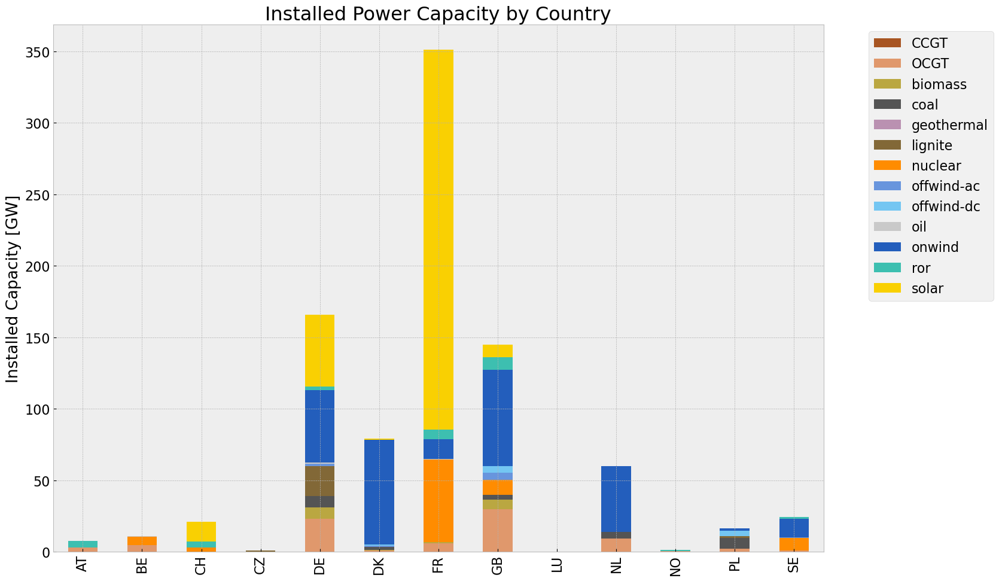

<Figure size 640x480 with 0 Axes>

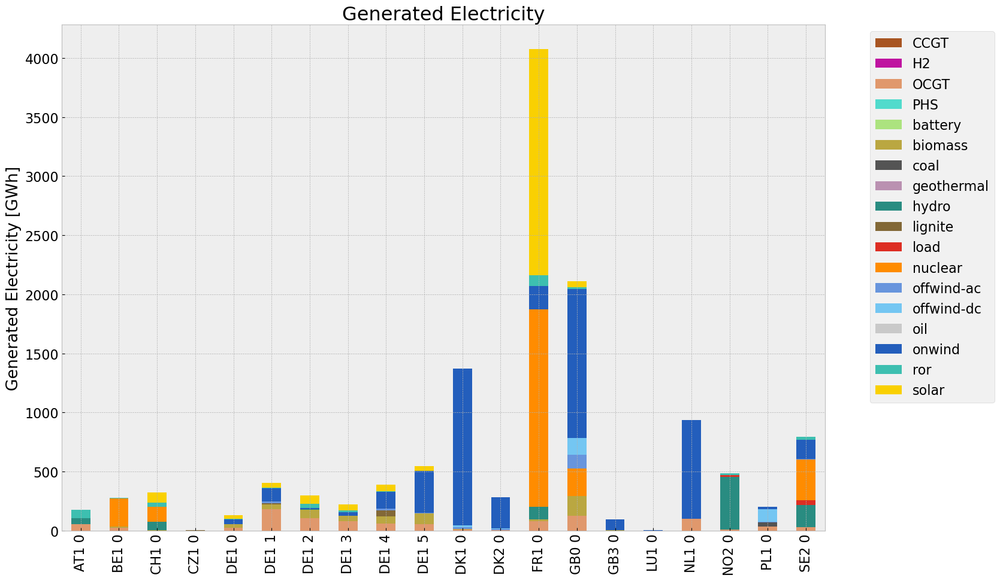

<Figure size 640x480 with 0 Axes>

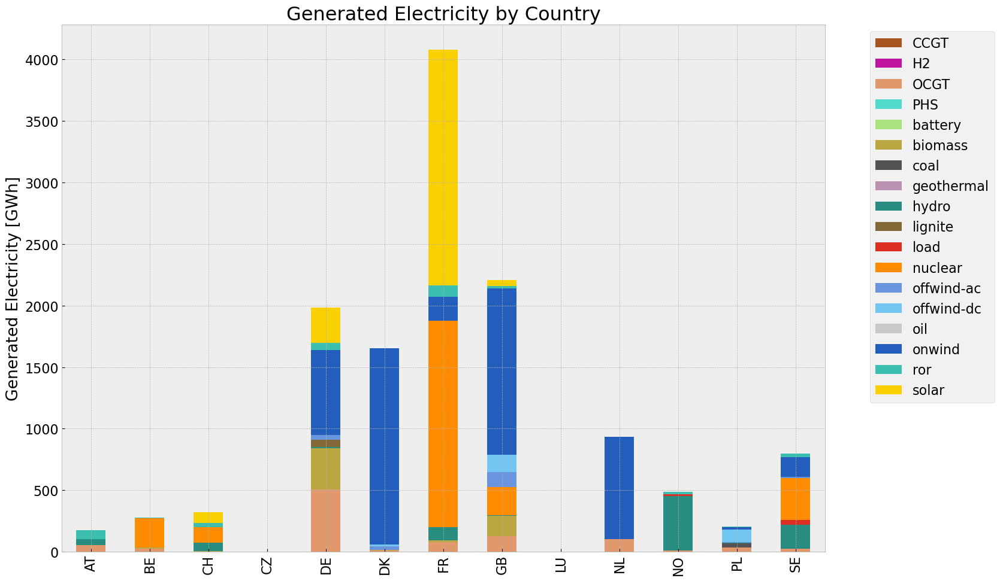

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,9.754503e+05,0.451621,0.1980,427657.759593
biomass,5.406788e+05,0.468000,0.0000,0.000000
coal,3.531553e+04,0.329908,0.3361,35978.363499
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,6.337199e+04,0.337285,0.4069,76451.908008
load,5.435933e+04,1.000000,0.0000,0.000000
nuclear,2.617761e+06,0.326600,0.0000,0.000000
offwind-ac,1.930274e+05,1.000000,0.0000,0.000000


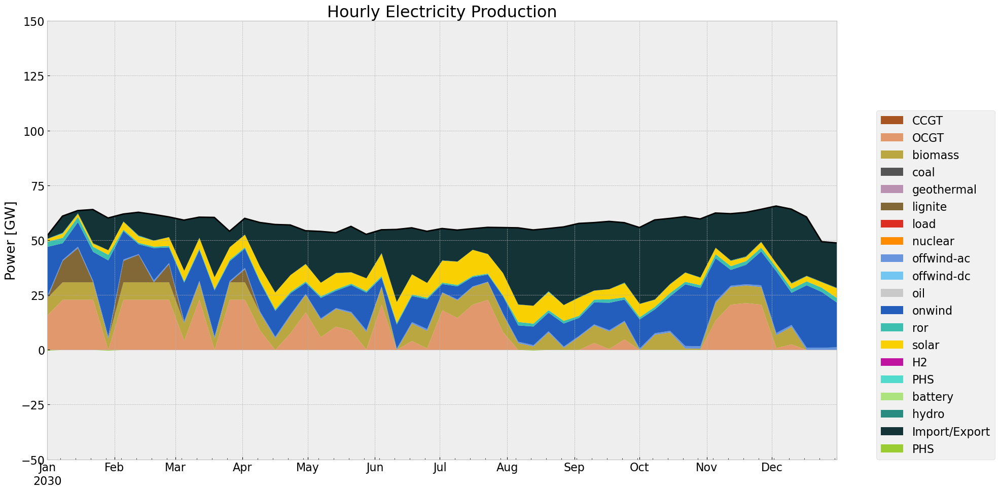

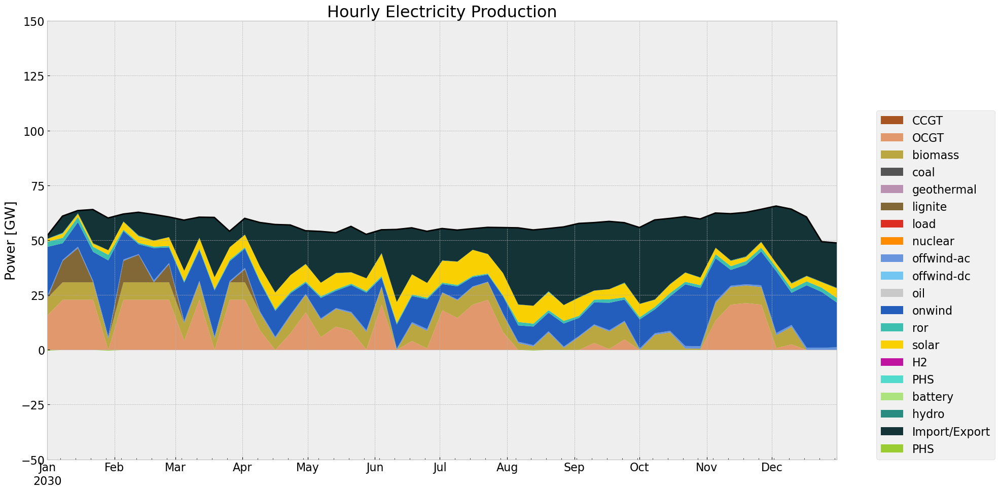

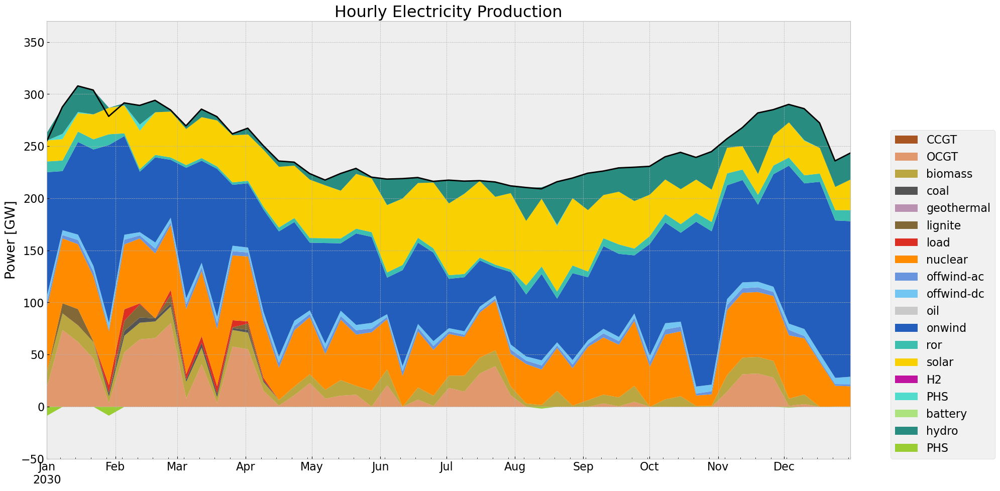

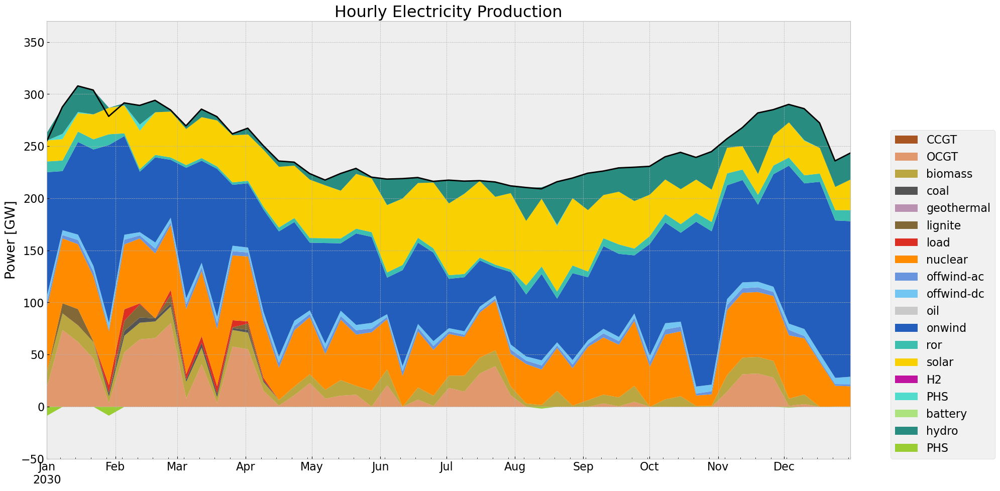

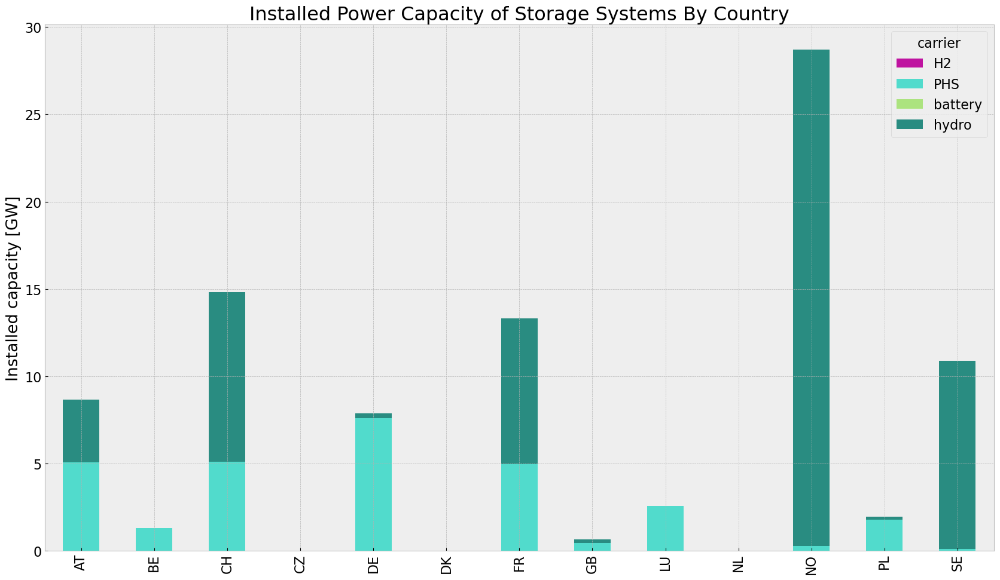

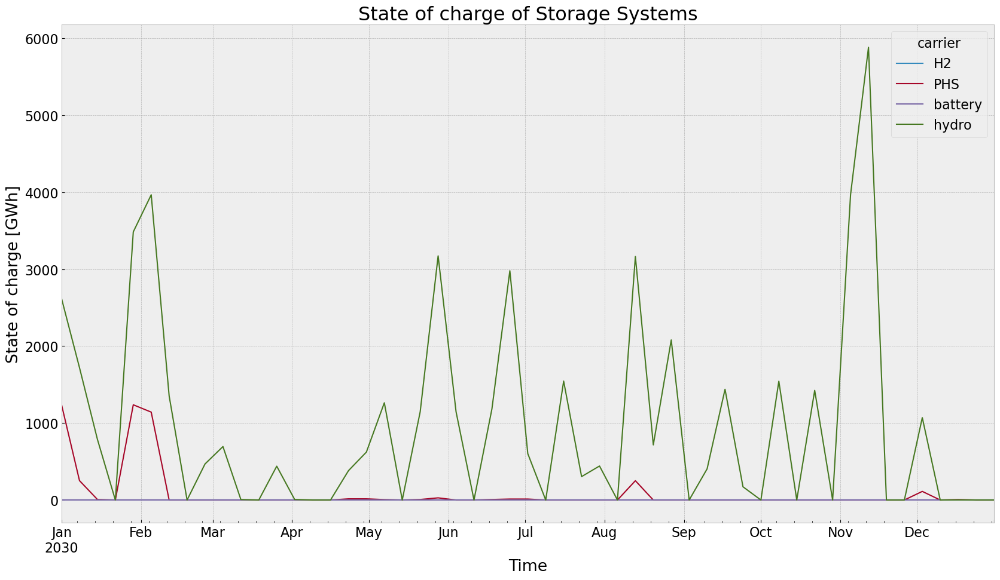

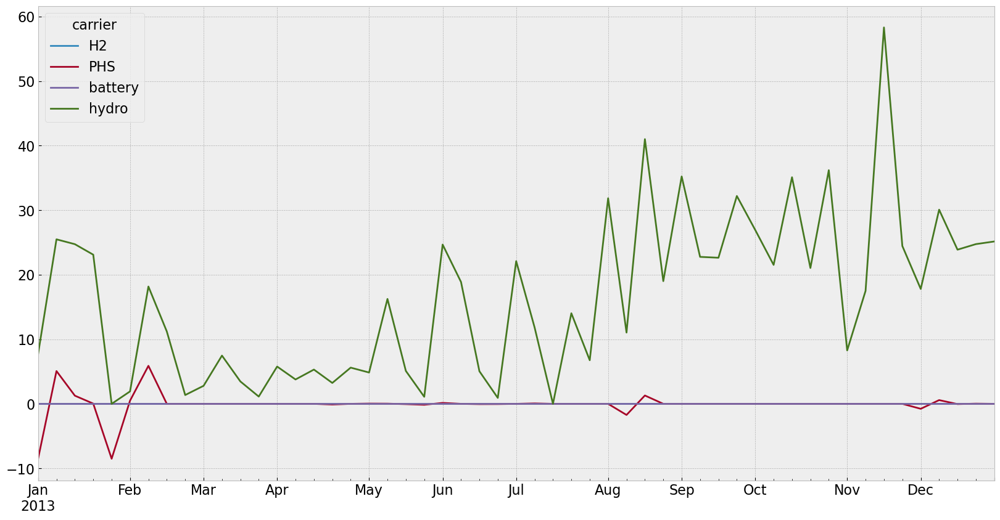

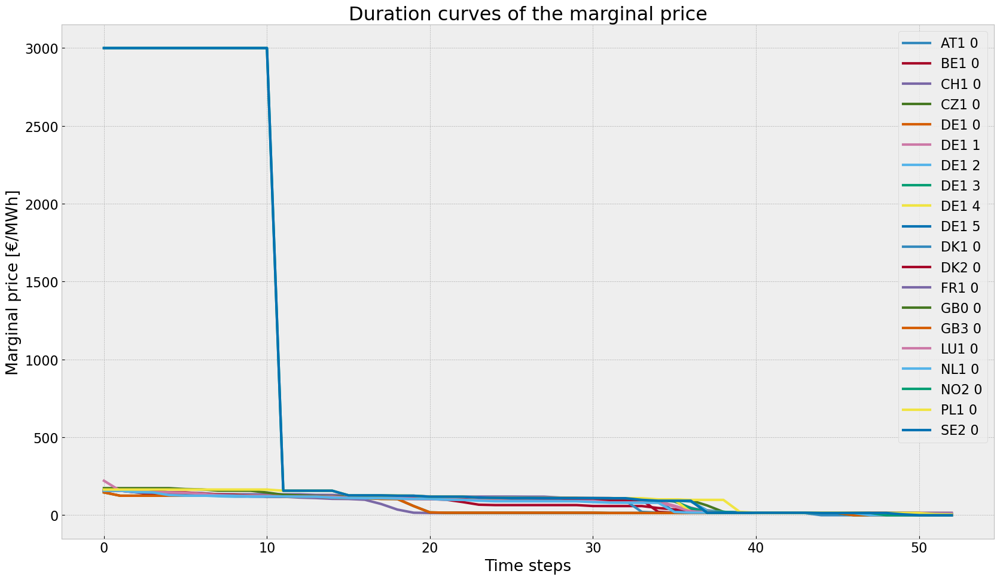

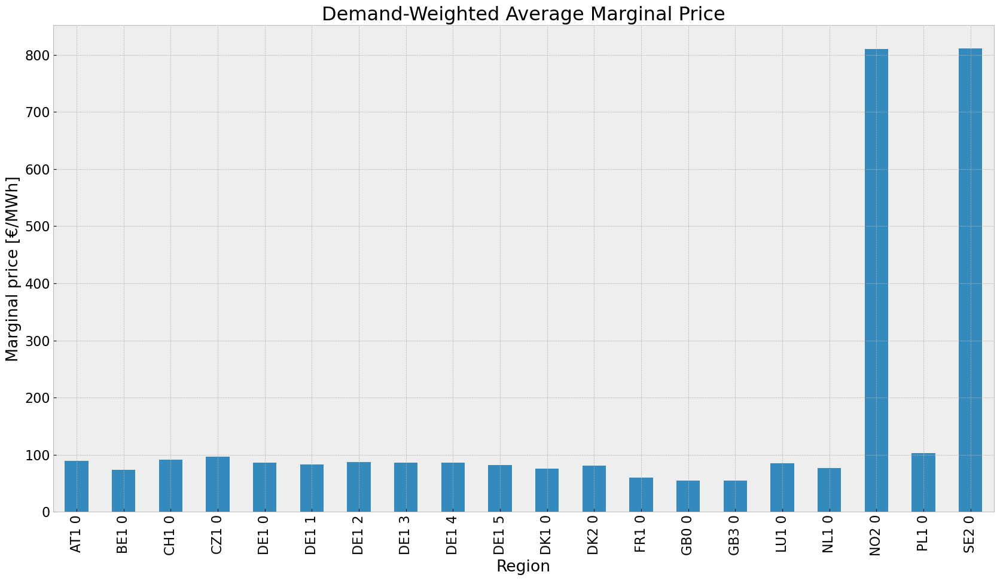

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


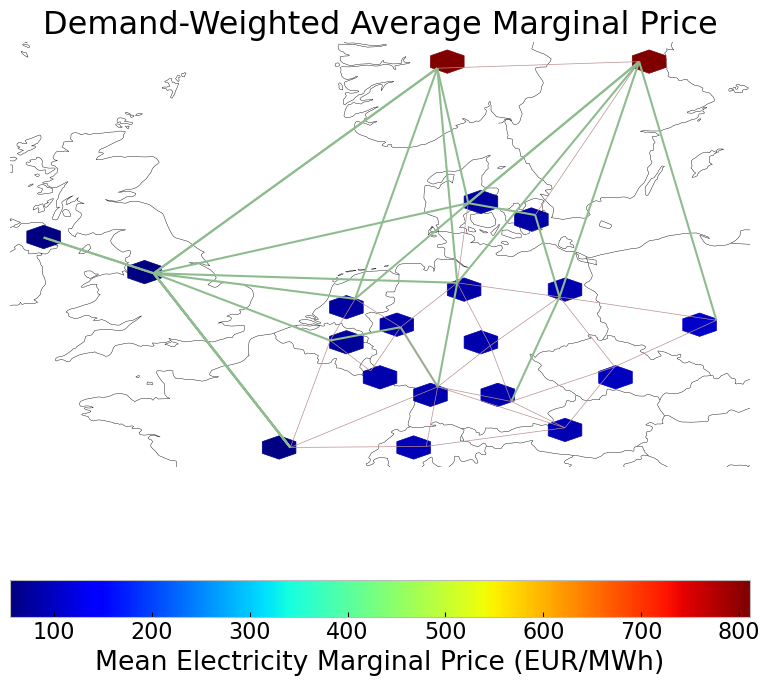

In [78]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-31 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [79]:
n4 = n1.copy()

horizon = 3

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m6mvynr1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m6mvynr1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x00400ab8


INFO:gurobipy:Model fingerprint: 0x00400ab8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5732678e+07   7.736147e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5732678e+07   7.736147e+05   0.000000e+00      0s


     217    3.3902762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    3.3902762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.390276224e+09


INFO:gurobipy:Optimal objective  3.390276224e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6cuyxsfo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6cuyxsfo.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3f474f14


INFO:gurobipy:Model fingerprint: 0x3f474f14


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 168 rows, 709 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.3650878e+04   7.608445e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.3650878e+04   7.608445e+05   0.000000e+00      0s


     239    2.0846729e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.0846729e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.07 seconds (0.00 work units)


Optimal objective  2.084672947e+09


INFO:gurobipy:Optimal objective  2.084672947e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oi8pbeq4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oi8pbeq4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4da7419b


INFO:gurobipy:Model fingerprint: 0x4da7419b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 857 columns


INFO:gurobipy:Presolve removed 3188 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 706 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 166 rows, 706 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2732359e+08   1.065126e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.2732359e+08   1.065126e+06   0.000000e+00      0s


     196    8.6814891e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    8.6814891e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.681489076e+09


INFO:gurobipy:Optimal objective  8.681489076e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zlmd5_7h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zlmd5_7h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6839d885


INFO:gurobipy:Model fingerprint: 0x6839d885


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 695 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4320939e+08   7.824158e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4320939e+08   7.824158e+05   0.000000e+00      0s


     196    5.1175232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    5.1175232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.117523194e+09


INFO:gurobipy:Optimal objective  5.117523194e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.12e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bd5e4493.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bd5e4493.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe9389130


INFO:gurobipy:Model fingerprint: 0xe9389130


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 847 columns


INFO:gurobipy:Presolve removed 3187 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 716 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 167 rows, 716 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.4174324e+04   7.767644e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.4174324e+04   7.767644e+05   0.000000e+00      0s


     250    2.6765848e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.6765848e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.676584762e+09


INFO:gurobipy:Optimal objective  2.676584762e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6fxm7v5f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6fxm7v5f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1c407531


INFO:gurobipy:Model fingerprint: 0x1c407531


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 167 rows, 709 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.0039249e+05   7.900402e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.0039249e+05   7.900402e+05   0.000000e+00      0s


     279    3.2521305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    3.2521305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 279 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.252130464e+08


INFO:gurobipy:Optimal objective  3.252130464e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pev3stb4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pev3stb4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x283cdc82


INFO:gurobipy:Model fingerprint: 0x283cdc82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 5e+03]


INFO:gurobipy:  Bounds range     [1e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4129236e+05   8.063490e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4129236e+05   8.063490e+05   0.000000e+00      0s


     272    3.5226743e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     272    3.5226743e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 272 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 272 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.522674309e+08


INFO:gurobipy:Optimal objective  3.522674309e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l1_dnx4s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l1_dnx4s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa1d6c25a


INFO:gurobipy:Model fingerprint: 0xa1d6c25a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 7e+03]


INFO:gurobipy:  Bounds range     [1e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5543048e+07   7.825750e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5543048e+07   7.825750e+05   0.000000e+00      0s


     258    2.9088680e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.9088680e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.908868047e+08


INFO:gurobipy:Optimal objective  2.908868047e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7w45xuxi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7w45xuxi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeae02633


INFO:gurobipy:Model fingerprint: 0xeae02633


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 6e+03]


INFO:gurobipy:  Bounds range     [1e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 852 columns


INFO:gurobipy:Presolve removed 3187 rows and 852 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 167 rows, 711 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 167 rows, 711 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1298819e+05   7.931884e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1298819e+05   7.931884e+05   0.000000e+00      0s


     267    2.8814197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    2.8814197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 267 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.881419735e+08


INFO:gurobipy:Optimal objective  2.881419735e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fef3_7f_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fef3_7f_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3a4a3fef


INFO:gurobipy:Model fingerprint: 0x3a4a3fef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 5e+03]


INFO:gurobipy:  Bounds range     [7e-01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1673437e+05   7.906697e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1673437e+05   7.906697e+05   0.000000e+00      0s


     262    6.9204471e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    6.9204471e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.920447079e+08


INFO:gurobipy:Optimal objective  6.920447079e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9wughup5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9wughup5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x88020ca6


INFO:gurobipy:Model fingerprint: 0x88020ca6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 2e+04]


INFO:gurobipy:  Bounds range     [7e-01, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5093982e+05   7.817337e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.5093982e+05   7.817337e+05   0.000000e+00      0s


     220    1.0801908e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.0801908e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.080190798e+08


INFO:gurobipy:Optimal objective  1.080190798e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqcry1ll.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqcry1ll.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc854a1d9


INFO:gurobipy:Model fingerprint: 0xc854a1d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 851 columns


INFO:gurobipy:Presolve removed 3187 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 712 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 167 rows, 712 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1826719e+05   7.722492e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1826719e+05   7.722492e+05   0.000000e+00      0s


     256    2.4207103e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.4207103e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.420710301e+08


INFO:gurobipy:Optimal objective  2.420710301e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gt8u0gr2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gt8u0gr2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6363dc65


INFO:gurobipy:Model fingerprint: 0x6363dc65


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 846 columns


INFO:gurobipy:Presolve removed 3188 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 717 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 166 rows, 717 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1142577e+05   7.629074e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1142577e+05   7.629074e+05   0.000000e+00      0s


     259    3.7591715e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    3.7591715e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.759171493e+08


INFO:gurobipy:Optimal objective  3.759171493e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p8xk0vaw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p8xk0vaw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x70854a8b


INFO:gurobipy:Model fingerprint: 0x70854a8b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 725 columns, 1174 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1174 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4171864e+05   7.724996e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4171864e+05   7.724996e+05   0.000000e+00      0s


     290    3.1675187e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     290    3.1675187e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 290 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 290 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.167518689e+08


INFO:gurobipy:Optimal objective  3.167518689e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mp_act73.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mp_act73.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2b343d4f


INFO:gurobipy:Model fingerprint: 0x2b343d4f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 702 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1750580e+05   7.723747e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1750580e+05   7.723747e+05   0.000000e+00      0s


     241    1.0062432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    1.0062432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.006243182e+08


INFO:gurobipy:Optimal objective  1.006243182e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7l0y461z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7l0y461z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77f72eee


INFO:gurobipy:Model fingerprint: 0x77f72eee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 840 columns


INFO:gurobipy:Presolve removed 3187 rows and 840 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 723 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 167 rows, 723 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.6764986e+04   7.594607e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.6764986e+04   7.594607e+05   0.000000e+00      0s


     230    2.0443217e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.0443217e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.044321748e+09


INFO:gurobipy:Optimal objective  2.044321748e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rzdzj7lv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rzdzj7lv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf13a5dda


INFO:gurobipy:Model fingerprint: 0xf13a5dda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 877 columns


INFO:gurobipy:Presolve removed 3186 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 686 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 686 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.3292540e+04   7.699546e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.3292540e+04   7.699546e+05   0.000000e+00      0s


     211    3.1510908e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    3.1510908e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.151090758e+08


INFO:gurobipy:Optimal objective  3.151090758e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qvhui1iw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qvhui1iw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xf8951a9d


INFO:gurobipy:Model fingerprint: 0xf8951a9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 594 columns


INFO:gurobipy:Presolve removed 2124 rows and 594 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 112 rows, 448 columns, 739 nonzeros


INFO:gurobipy:Presolved: 112 rows, 448 columns, 739 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.4677008e+04   1.806743e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.4677008e+04   1.806743e+05   0.000000e+00      0s


     126    4.2758509e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     126    4.2758509e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 126 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 126 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.275850893e+07


INFO:gurobipy:Optimal objective  4.275850893e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [80]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_drought.nc has links, storage_units, loads, generators, carriers, lines, buses


<xarray.Dataset> Size: 280kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      links_i: 28,
                                                      links_t_p0_i: 18,
                                                      links_t_p1_i: 18,
                                                      storage_units_i: 65,
                                                      ...
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20)
Coordinates: (12/26)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 144B ...
  * links_t_p1_i                                     (links_t_p1_i) object 144B ...
  * storage_units_i                                  (storage_units_i) object 520B ...
    ...                                               ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
Data variables: (12/96)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    buses_country                                    (buses_i) object 160B 'A...
    buses_control                                    (buses_i) object 160B 'S...
    buses_generator                                  (buses_i) object 160B 'A...
    buses_t_p                                        (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                                    (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                           (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_drought
    network_objective:       42758508.92674008
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [81]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

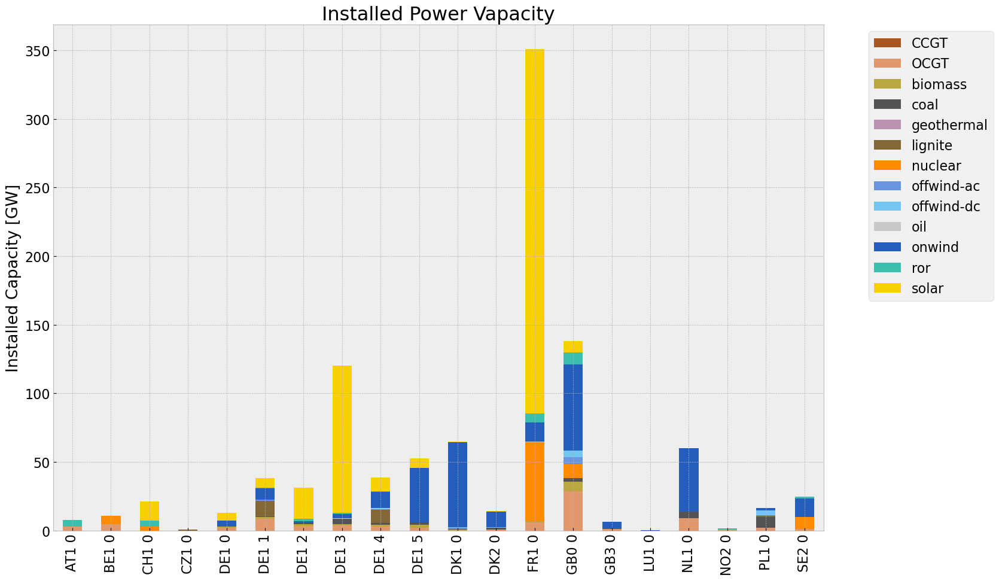

<Figure size 640x480 with 0 Axes>

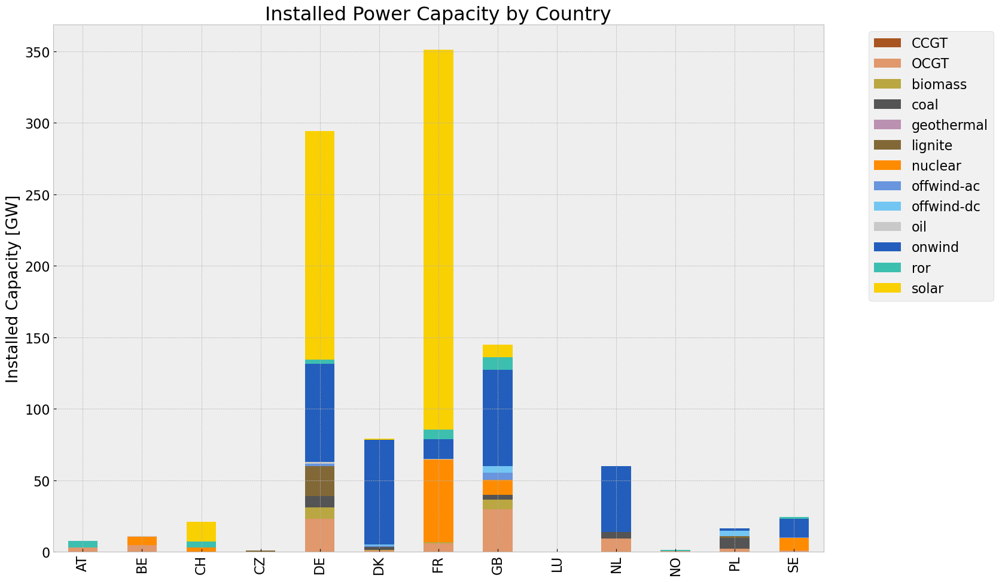

<Figure size 640x480 with 0 Axes>

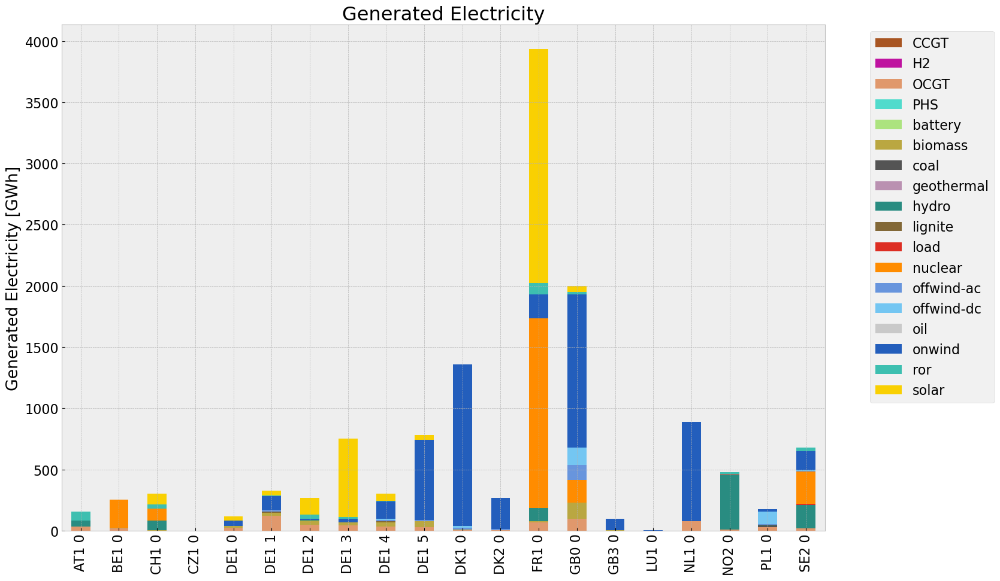

<Figure size 640x480 with 0 Axes>

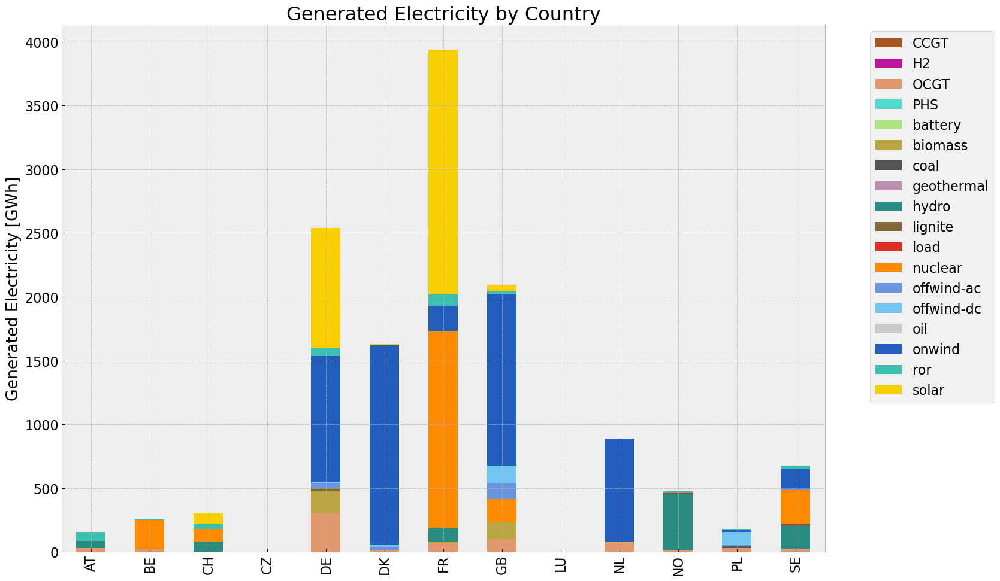

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,6.602461e+05,0.451621,0.1980,289465.662452
biomass,3.274881e+05,0.468000,0.0000,0.000000
coal,1.326979e+04,0.329908,0.3361,13518.852507
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.890850e+04,0.337285,0.4069,22811.194454
load,1.506706e+04,1.000000,0.0000,0.000000
nuclear,2.328907e+06,0.326600,0.0000,0.000000
offwind-ac,1.967699e+05,1.000000,0.0000,0.000000


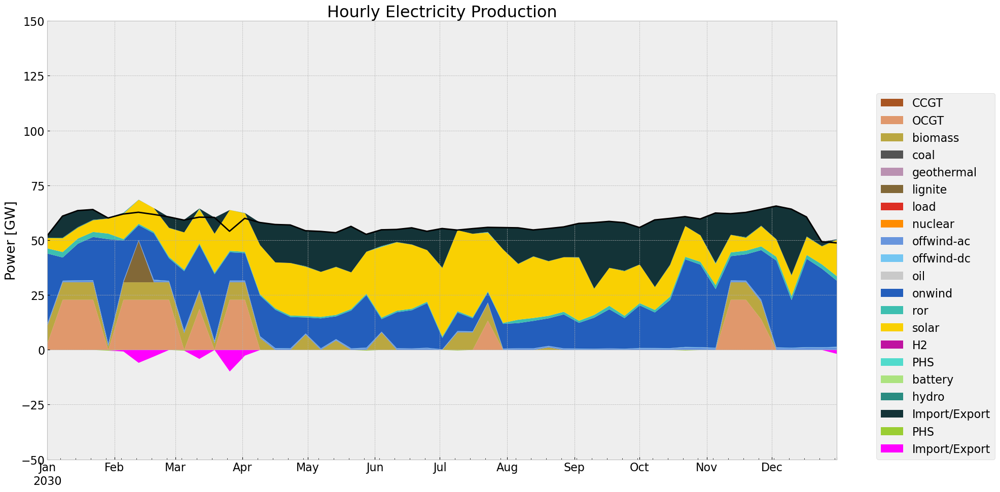

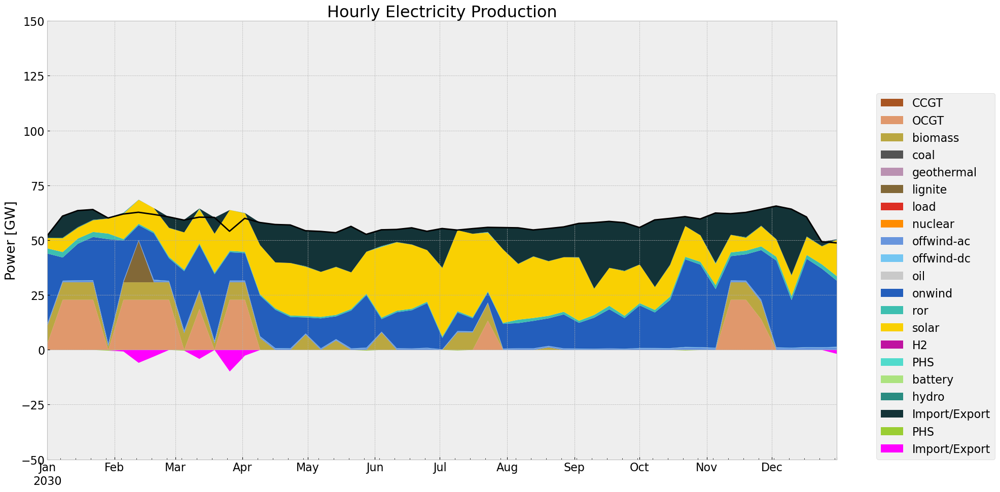

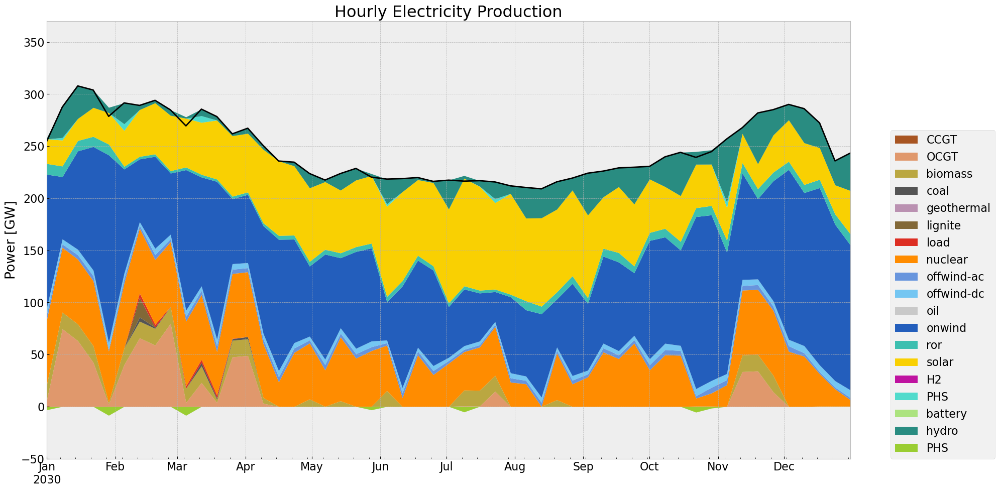

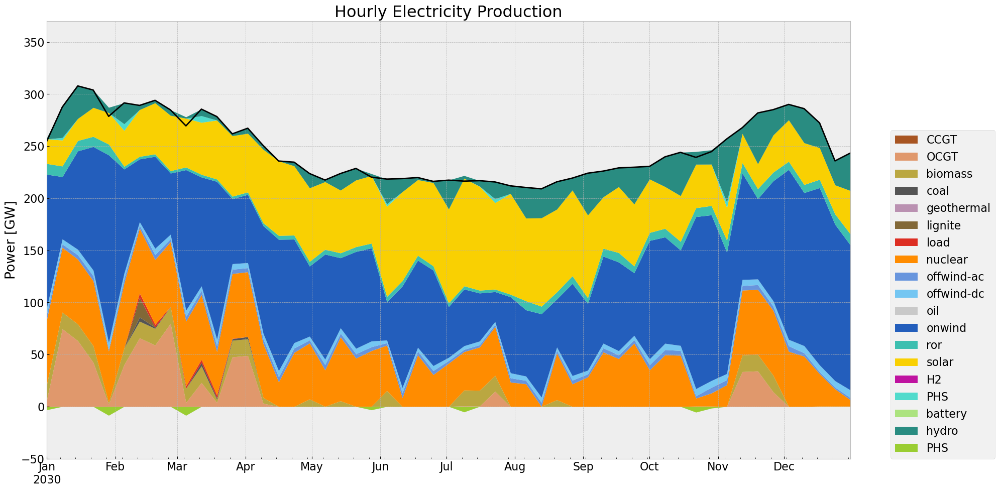

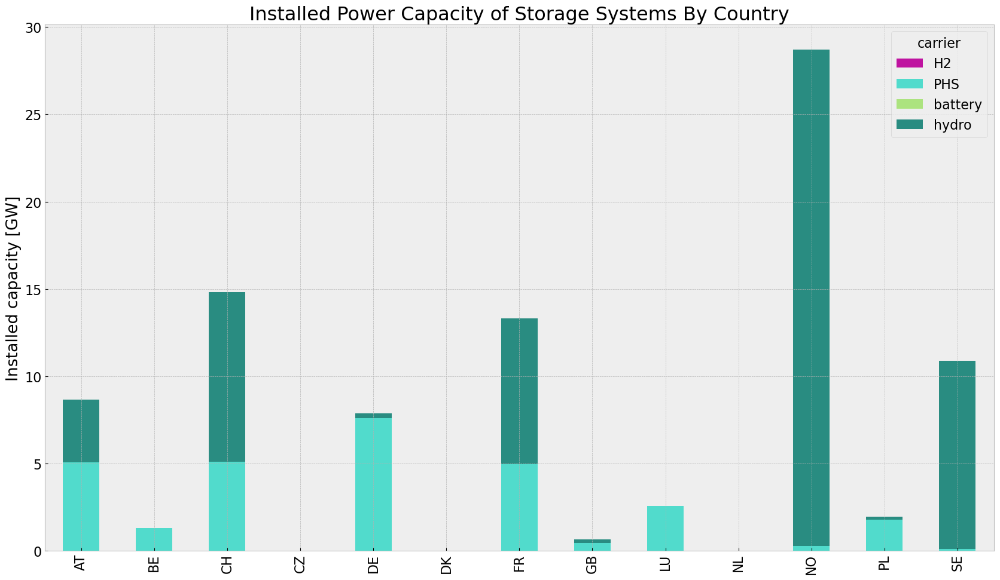

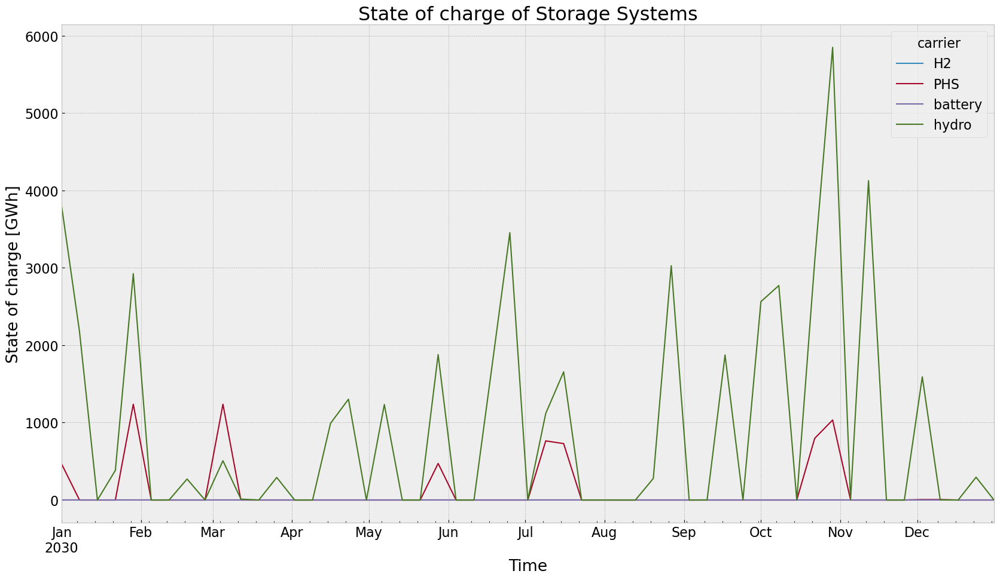

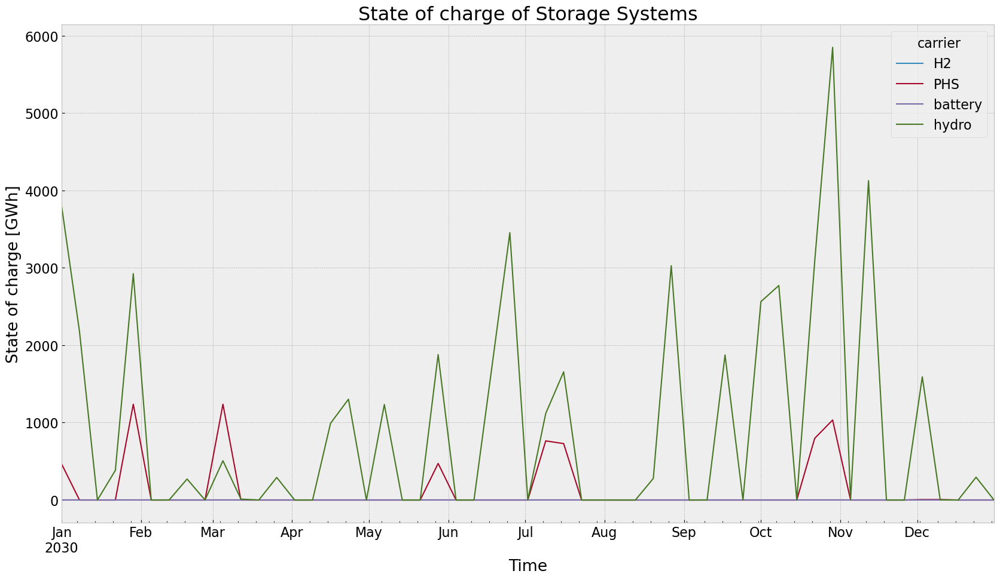

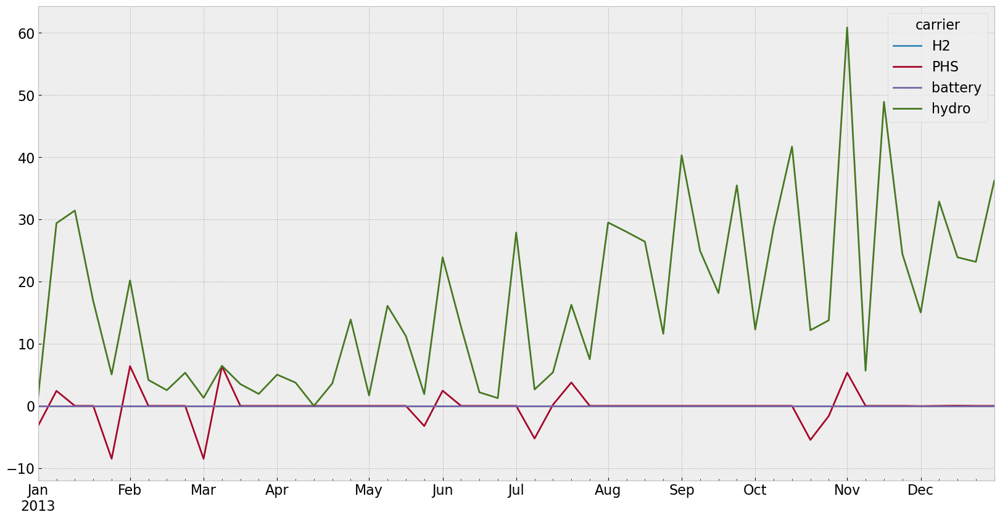

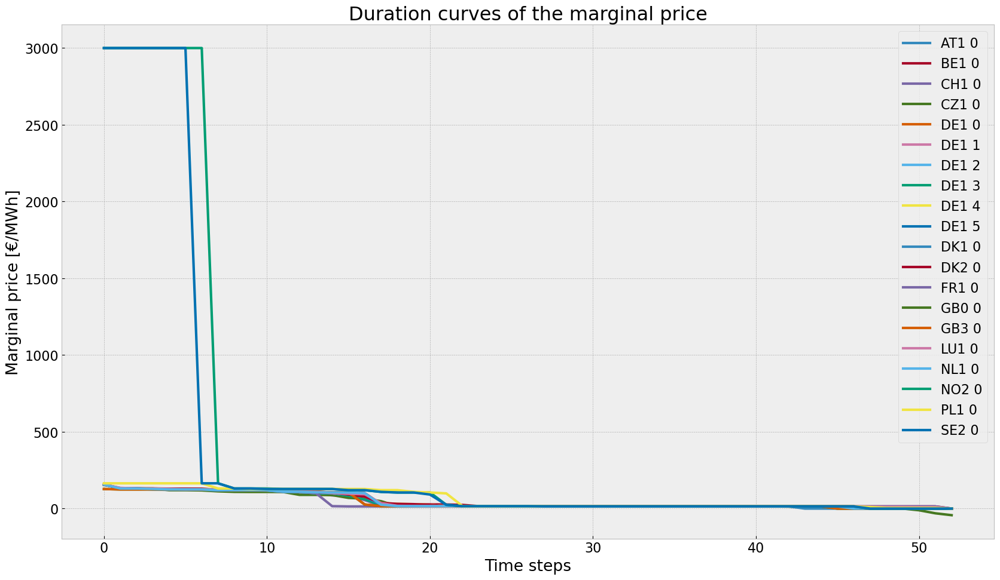

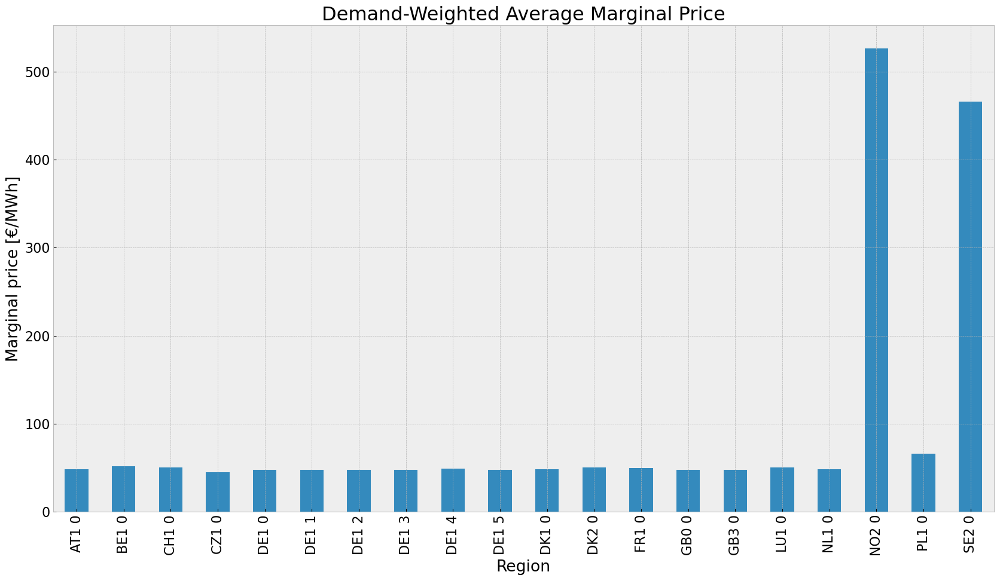

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


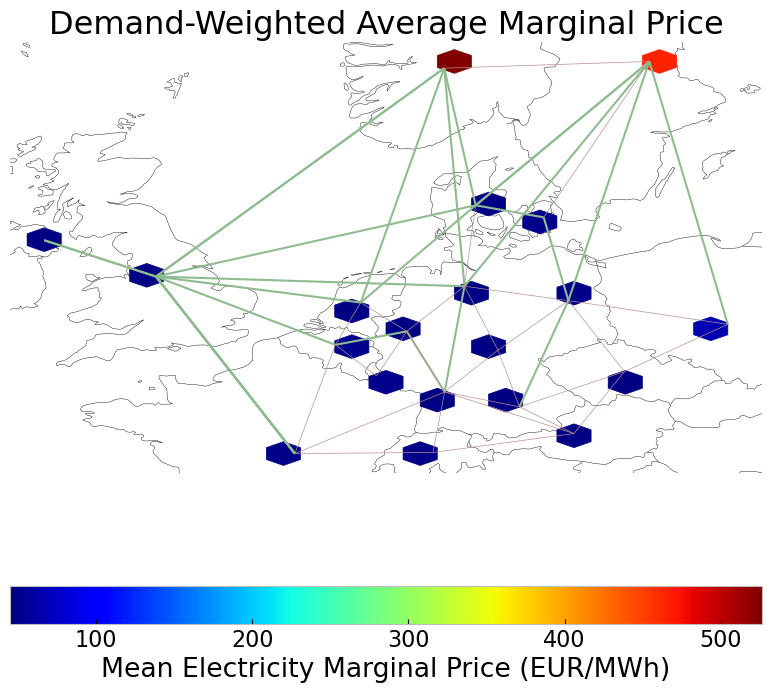

In [82]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [83]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

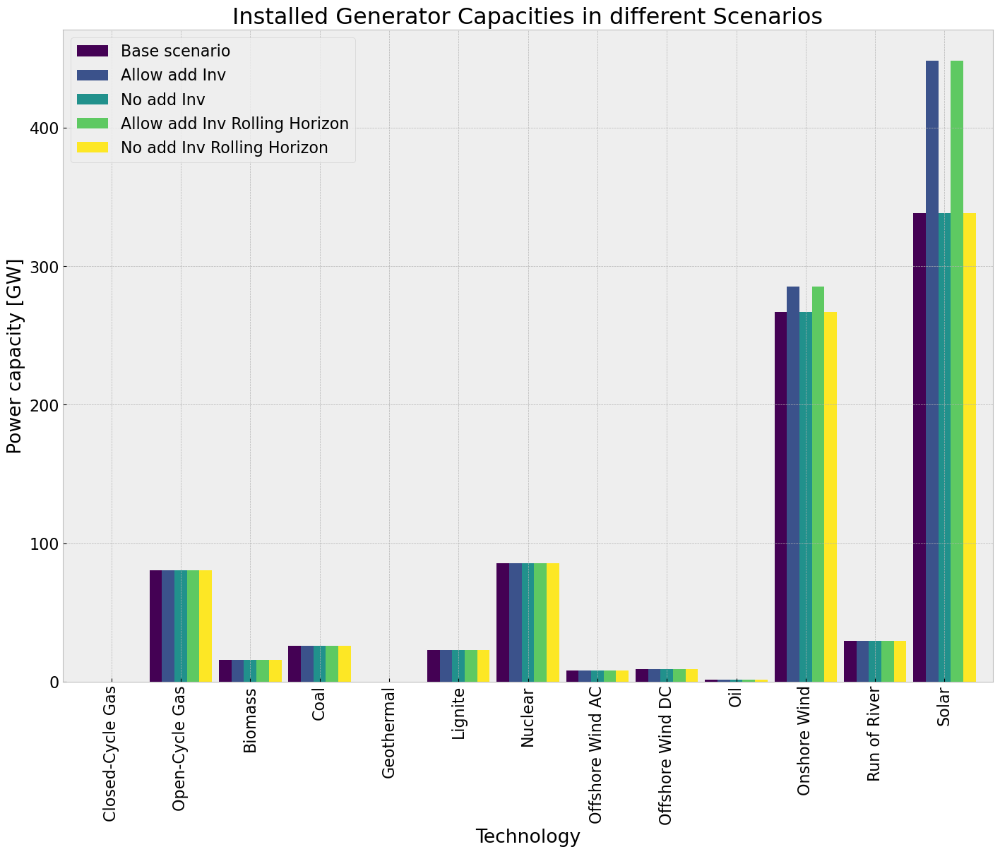

In [84]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'oil': '#c9c9c9', 'CCGT': '#a85522', 'solar': '#f9d002', 'geothermal': '#ba91b1', 'coal': '#545454', 'offwind-ac': '#6895dd', 'onwind': '#235ebc', 'OCGT': '#e0986c', 'nuclear': '#ff8c00', 'lignite': '#826837', 'offwind-dc': '#74c6f2', 'biomass': '#baa741', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


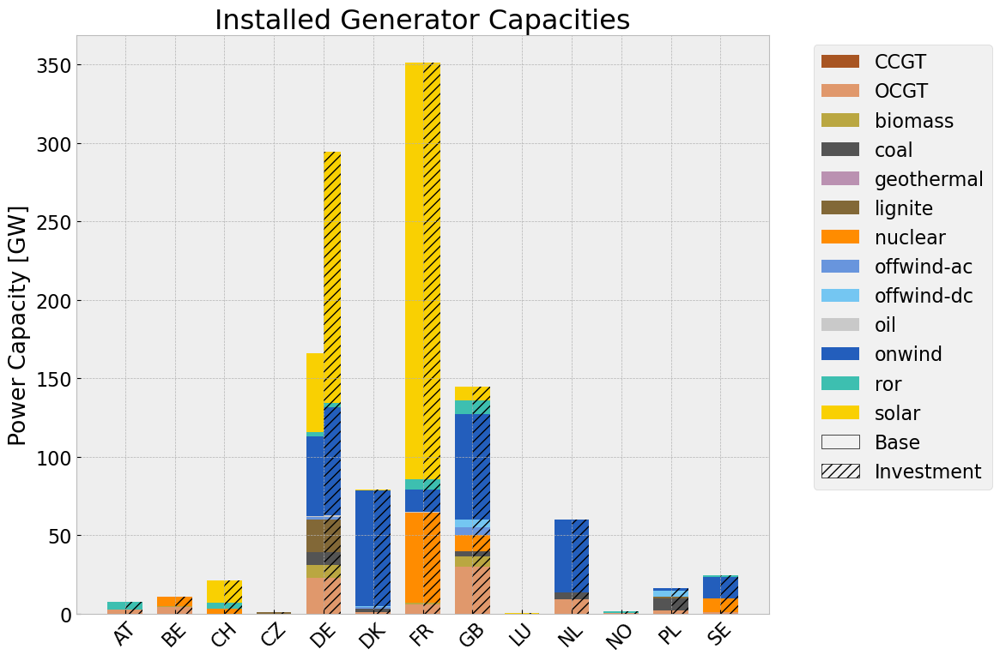

In [85]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2988850123.py:34: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  comp_gen_electr.fillna(0, inplace=True)


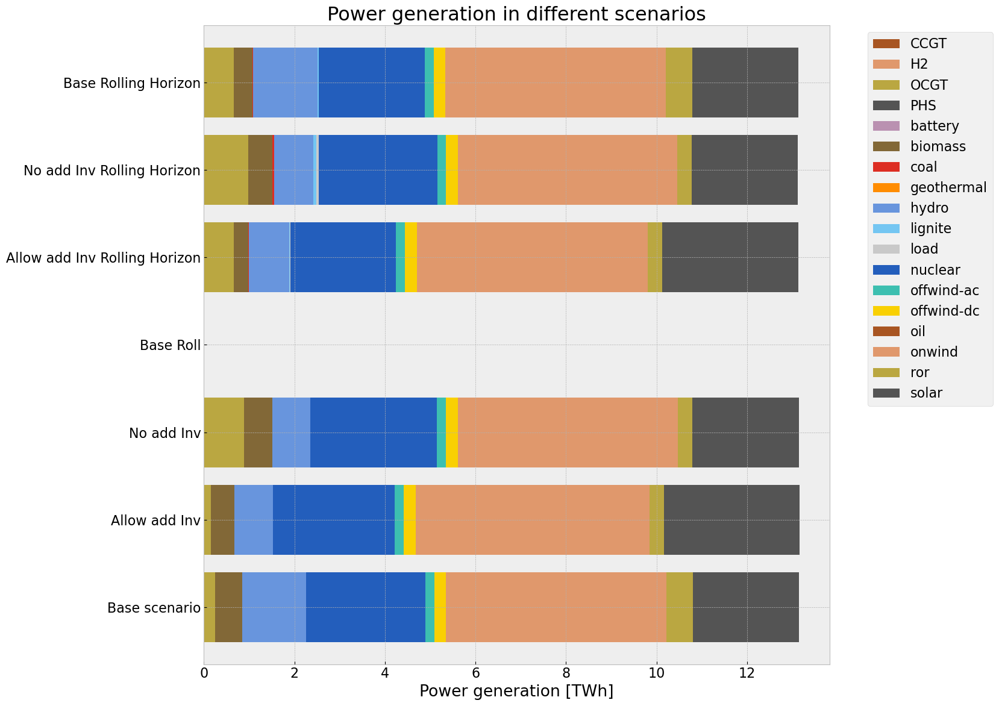

In [86]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Roll","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Base Rolling Horizon"] = gen_base_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

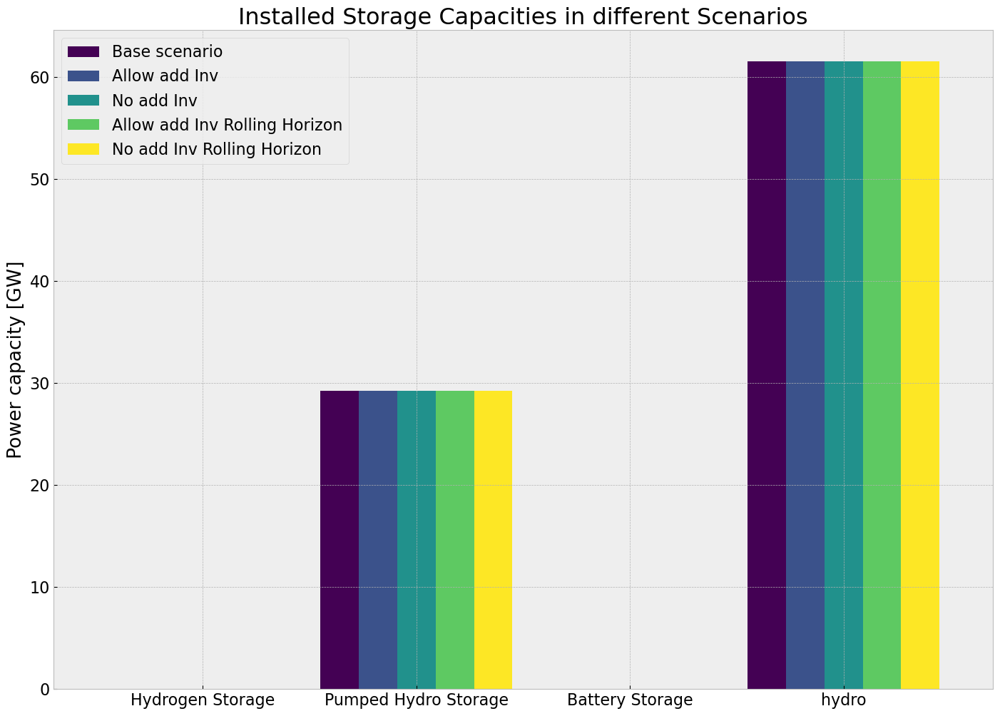

In [87]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

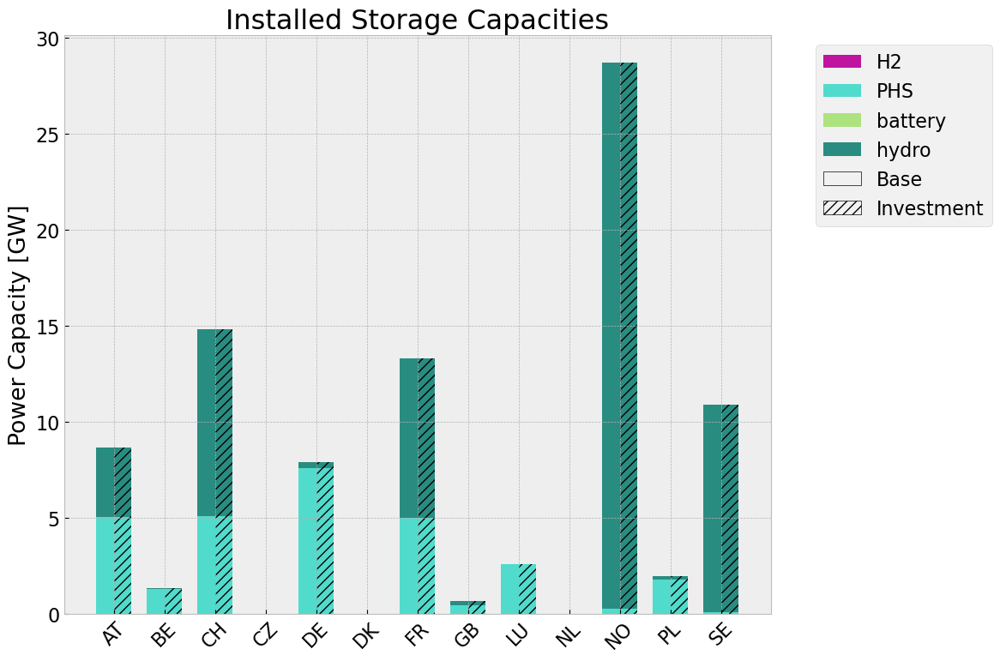

In [88]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [89]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Base Rolling Horizon"] = system_cost_base_roll # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


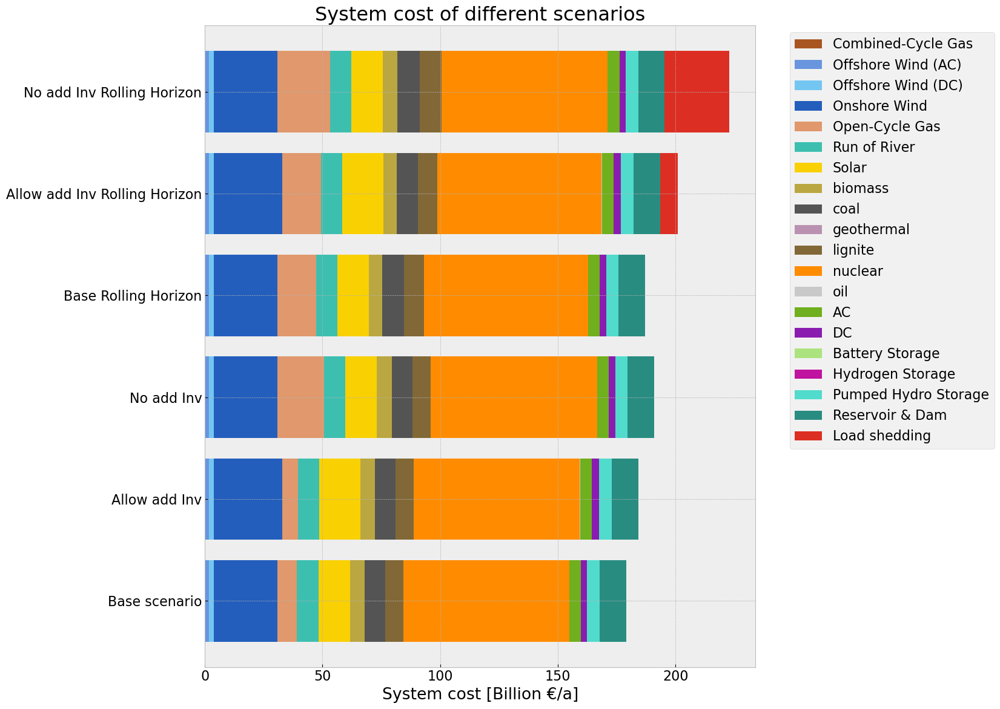

In [90]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [91]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Base Rolling Horizon"] = stat_base_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [92]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


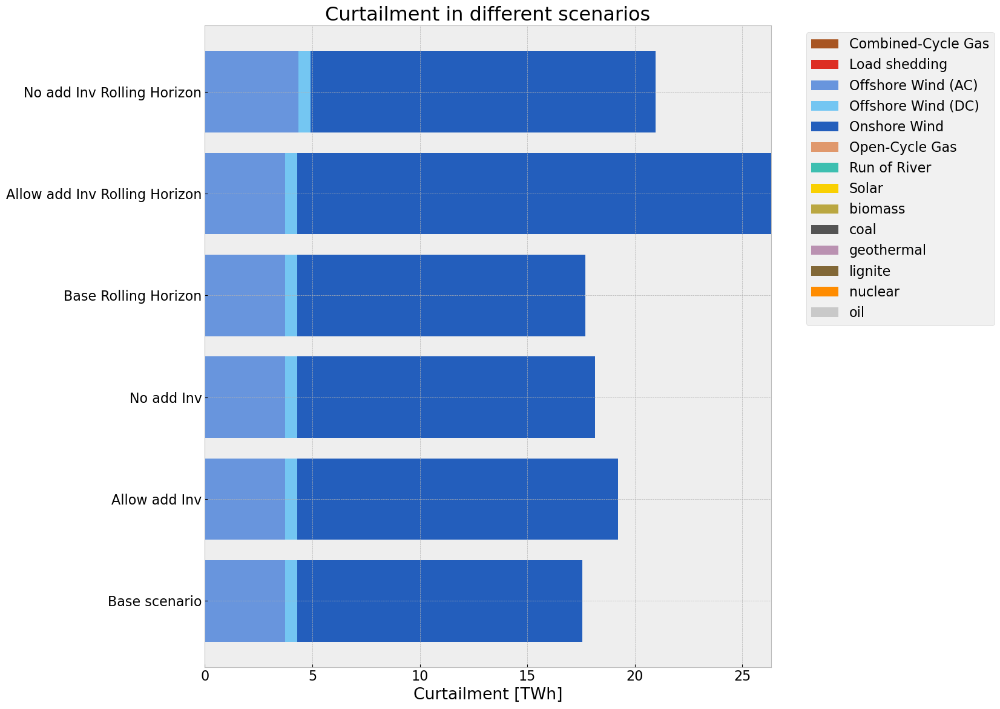

In [93]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3480178836.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


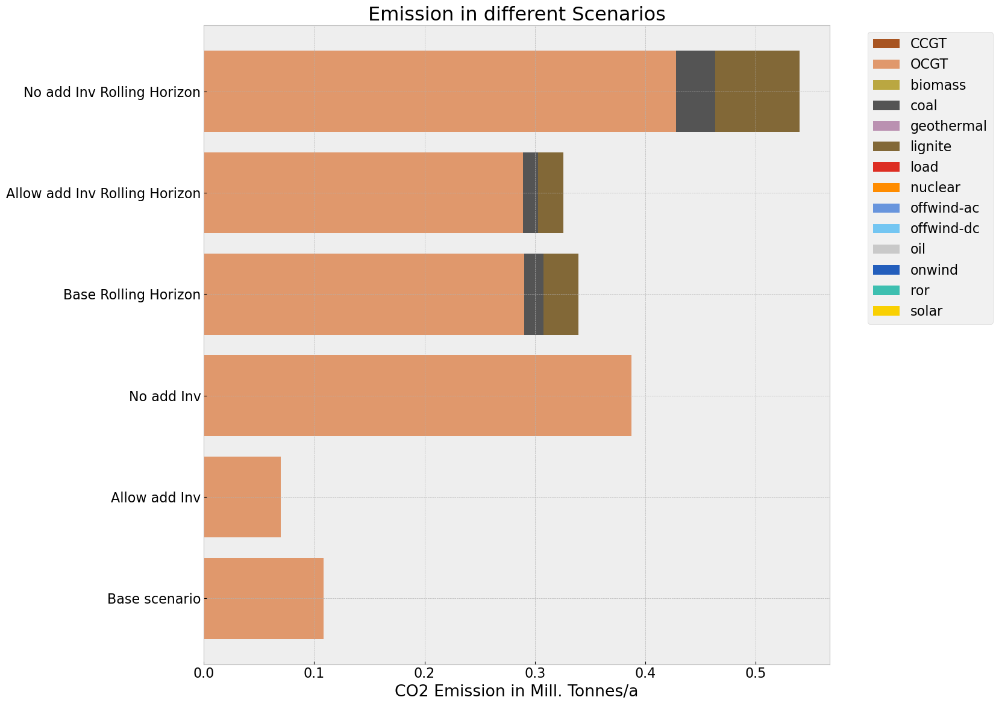

In [94]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Base Rolling Horizon"] = em_base_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [95]:
models = [n, n1, n2, n4]

In [96]:
model_trans = [n,n1]
for m in model_trans:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

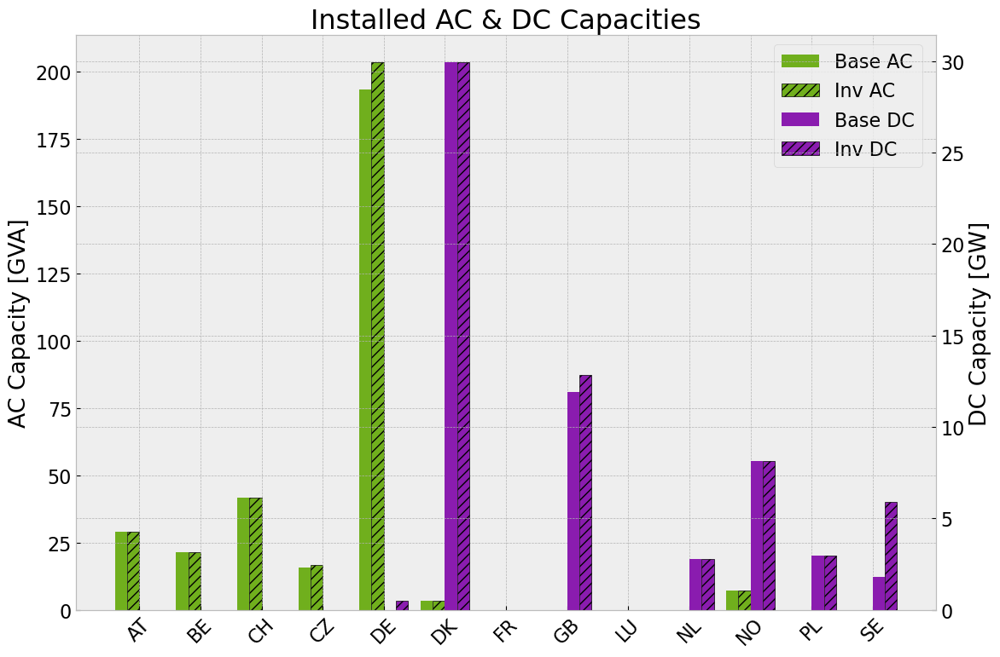

In [98]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_drought.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_drought.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_drought.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_drought.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_drought.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_drought.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

In [99]:
for index, row in n.links.iterrows():
    pnomoptn = n.links.at[index,'p_nom_opt']
    pnomoptn1 = n1.links.at[index,'p_nom_opt']
    bus0 = row['bus0']
    bus1 = row['bus1']
    if 'DE' in bus0 or 'DE' in bus1:
        print(f'{bus0},{bus1}: {index}, p_nom_opt: {pnomoptn}, {pnomoptn1}')

DE1 1,BE1 0: 14801, p_nom_opt: 0.0, 41.74993445200368
DK2 0,DE1 4: 14824, p_nom_opt: 18116.99304687361, 18116.9930469
SE2 0,DE1 5: 5601, p_nom_opt: 1249.4826412929, 5338.650262921555
DE1 5,NO2 0: 14848, p_nom_opt: 0.0, 449.17286955000054
DE1 4,DE1 2: T10, p_nom_opt: 0.0, 0.0
SE2 0,DE1 4: T16, p_nom_opt: 0.0, 0.0
DE1 5,DE1 3: T18, p_nom_opt: 0.0, 0.0
DE1 1,DE1 3: T20, p_nom_opt: 0.0, 0.0
GB0 0,DE1 5: T22, p_nom_opt: 0.0, 932.7595902037843


In [100]:
n1.links

,bus0,bus1,carrier,geometry,length,p_nom,tags,under_construction,underground,p_min_pu,underwater_fraction,capital_cost,p_nom_extendable,p_nom_min,p_nom_max,build_year,marginal_cost,min_up_time,min_down_time,up_time_before,down_time_before,p_nom_opt,reversed,type,efficiency,lifetime,p_nom_mod,p_set,p_max_pu,marginal_cost_quadratic,stand_by_cost,terrain_factor,committable,start_up_cost,shut_down_cost,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,country
Link,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
14801,DE1 1,BE1 0,DC,"LINESTRING(6.43068069229957 50.8136946409214,6...",239.848593,0.000000,,True,False,-1.0,0.000000,25854.398714,True,0.000000,30000.0,0,0.009745,0,0,1,0,41.749934,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DE
14814,GB0 0,NL1 0,DC,"LINESTRING(4.04528166772434 51.9611233898246,2...",645.936772,1117.111234,,False,False,-1.0,0.352490,51412.795403,False,1000.000000,31000.0,0,0.010714,0,0,1,0,1117.111234,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14826,GB0 0,FR1 0,DC,"LINESTRING(1.75051314494826 50.9186901861196,1...",1013.198189,6268.596086,,False,False,-1.0,0.049244,60275.254416,False,2000.000000,32000.0,0,0.009053,0,0,1,0,6268.596086,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14805,DK2 0,DK1 0,DC,"LINESTRING(11.2853515176222 55.5308076825323,1...",205.403041,11795.557715,,False,True,-1.0,0.134963,25432.524245,False,600.000000,30600.0,0,0.010840,0,0,1,0,11795.557715,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
14824,DK2 0,DE1 4,DC,"LINESTRING(11.9669051857726 55.421747727341,12...",432.140281,600.000000,,False,False,-1.0,0.163988,36579.446436,True,18116.993047,30600.0,0,0.010362,0,0,1,0,18116.993047,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
5601,SE2 0,DE1 5,DC,"LINESTRING(12.9299984288384 55.0630403498842,1...",1257.572542,600.000000,"""MW""=>""None"", ""TSO""=>""None"", ""oid""=>""32550"", ""...",False,False,-1.0,0.029686,70092.252666,True,1249.482641,30600.0,0,0.010808,0,0,1,0,5338.650263,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,SE
14823,PL1 0,SE2 0,DC,"LINESTRING(16.861267 54.533833,16.274872 55.09...",1362.362308,2962.731209,,False,False,-1.0,0.157706,81109.224571,False,600.000000,30600.0,0,0.010215,0,0,1,0,2962.731209,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,PL
14803,NL1 0,DK1 0,DC,"LINESTRING(6.75668661933496 53.437616158174,6....",604.737909,1417.485997,,True,False,-1.0,0.426199,50794.620717,False,0.000000,30000.0,0,0.010624,0,0,1,0,1417.485997,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL
14821,NL1 0,NO2 0,DC,"LINESTRING(6.83036734046461 53.4374933986115,6...",1221.169700,1385.424469,,False,False,-1.0,0.446703,87427.969265,False,700.000000,30700.0,0,0.009671,0,0,1,0,1385.424469,False,,1.0,inf,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL


# Sensitivity Analysis

In [101]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [102]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [103]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = droughtscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n, country)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = droughtscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

Index(['24'], dtype='object', name='Line')


n_0_5_90_inv


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 94.48it/s]
INFO:linopy.io: Writing time: 0.92s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8mtqh3e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8mtqh3e.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0x42249d74


INFO:gurobipy:Model fingerprint: 0x42249d74


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50362 rows and 12722 columns


INFO:gurobipy:Presolve removed 50362 rows and 12722 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 37


INFO:gurobipy: Dense cols : 37


 AA' NZ     : 6.961e+04


INFO:gurobipy: AA' NZ     : 6.961e+04


 Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


 Factor Ops : 4.736e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.736e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.02371485e+13 -1.67443798e+14  1.05e+06 3.13e+05  5.50e+10     0s


INFO:gurobipy:   0   3.02371485e+13 -1.67443798e+14  1.05e+06 3.13e+05  5.50e+10     0s


   1   2.11834746e+13 -9.73271278e+13  6.72e+05 1.12e+05  3.06e+10     0s


INFO:gurobipy:   1   2.11834746e+13 -9.73271278e+13  6.72e+05 1.12e+05  3.06e+10     0s


   2   9.17494437e+12 -5.47096411e+13  2.17e+05 2.50e+04  1.01e+10     0s


INFO:gurobipy:   2   9.17494437e+12 -5.47096411e+13  2.17e+05 2.50e+04  1.01e+10     0s


   3   2.33546237e+12 -2.10840676e+13  1.76e+04 1.50e+03  1.27e+09     0s


INFO:gurobipy:   3   2.33546237e+12 -2.10840676e+13  1.76e+04 1.50e+03  1.27e+09     0s


   4   6.94874637e+11 -5.16520245e+12  1.96e+03 2.30e+02  2.23e+08     0s


INFO:gurobipy:   4   6.94874637e+11 -5.16520245e+12  1.96e+03 2.30e+02  2.23e+08     0s


   5   3.78930635e+11 -1.30272567e+12  7.50e+02 5.16e+01  6.08e+07     0s


INFO:gurobipy:   5   3.78930635e+11 -1.30272567e+12  7.50e+02 5.16e+01  6.08e+07     0s


   6   2.56826976e+11 -9.34999146e+11  4.08e+02 3.61e+01  4.12e+07     0s


INFO:gurobipy:   6   2.56826976e+11 -9.34999146e+11  4.08e+02 3.61e+01  4.12e+07     0s


   7   1.33191177e+11 -2.17117691e+11  1.38e+02 7.01e+00  1.17e+07     0s


INFO:gurobipy:   7   1.33191177e+11 -2.17117691e+11  1.38e+02 7.01e+00  1.17e+07     0s


   8   6.73410185e+10 -1.28964460e+11  4.72e+01 4.21e+00  6.35e+06     0s


INFO:gurobipy:   8   6.73410185e+10 -1.28964460e+11  4.72e+01 4.21e+00  6.35e+06     0s


   9   4.64469345e+10 -5.66034704e+10  2.43e+01 1.94e+00  3.30e+06     0s


INFO:gurobipy:   9   4.64469345e+10 -5.66034704e+10  2.43e+01 1.94e+00  3.30e+06     0s


  10   4.28399124e+10 -2.86069006e+10  2.10e+01 1.08e+00  2.28e+06     0s


INFO:gurobipy:  10   4.28399124e+10 -2.86069006e+10  2.10e+01 1.08e+00  2.28e+06     0s


  11   3.15861746e+10 -4.93257100e+09  1.13e+01 5.01e-01  1.16e+06     0s


INFO:gurobipy:  11   3.15861746e+10 -4.93257100e+09  1.13e+01 5.01e-01  1.16e+06     0s


  12   2.30004068e+10  4.72992726e+09  4.65e+00 2.65e-01  5.78e+05     1s


INFO:gurobipy:  12   2.30004068e+10  4.72992726e+09  4.65e+00 2.65e-01  5.78e+05     1s


  13   2.11851476e+10  8.36167514e+09  3.44e+00 1.75e-01  4.05e+05     1s


INFO:gurobipy:  13   2.11851476e+10  8.36167514e+09  3.44e+00 1.75e-01  4.05e+05     1s


  14   1.92201740e+10  1.12341630e+10  2.12e+00 1.06e-01  2.52e+05     1s


INFO:gurobipy:  14   1.92201740e+10  1.12341630e+10  2.12e+00 1.06e-01  2.52e+05     1s


  15   1.75759504e+10  1.41124995e+10  1.03e+00 3.40e-02  1.09e+05     1s


INFO:gurobipy:  15   1.75759504e+10  1.41124995e+10  1.03e+00 3.40e-02  1.09e+05     1s


  16   1.68512987e+10  1.46241204e+10  6.36e-01 2.26e-02  7.03e+04     1s


INFO:gurobipy:  16   1.68512987e+10  1.46241204e+10  6.36e-01 2.26e-02  7.03e+04     1s


  17   1.66083554e+10  1.50205585e+10  4.90e-01 1.44e-02  5.01e+04     1s


INFO:gurobipy:  17   1.66083554e+10  1.50205585e+10  4.90e-01 1.44e-02  5.01e+04     1s


  18   1.63048957e+10  1.52322686e+10  3.11e-01 1.01e-02  3.38e+04     1s


INFO:gurobipy:  18   1.63048957e+10  1.52322686e+10  3.11e-01 1.01e-02  3.38e+04     1s


  19   1.60416657e+10  1.53726576e+10  1.59e-01 7.26e-03  2.11e+04     1s


INFO:gurobipy:  19   1.60416657e+10  1.53726576e+10  1.59e-01 7.26e-03  2.11e+04     1s


  20   1.59306607e+10  1.55302852e+10  9.84e-02 4.11e-03  1.26e+04     1s


INFO:gurobipy:  20   1.59306607e+10  1.55302852e+10  9.84e-02 4.11e-03  1.26e+04     1s


  21   1.58589023e+10  1.55537063e+10  6.13e-02 3.63e-03  9.62e+03     1s


INFO:gurobipy:  21   1.58589023e+10  1.55537063e+10  6.13e-02 3.63e-03  9.62e+03     1s


  22   1.58143988e+10  1.56526766e+10  3.77e-02 1.67e-03  5.10e+03     1s


INFO:gurobipy:  22   1.58143988e+10  1.56526766e+10  3.77e-02 1.67e-03  5.10e+03     1s


  23   1.57925608e+10  1.57067844e+10  2.63e-02 5.89e-04  2.70e+03     1s


INFO:gurobipy:  23   1.57925608e+10  1.57067844e+10  2.63e-02 5.89e-04  2.70e+03     1s


  24   1.57621537e+10  1.57238366e+10  1.08e-02 2.57e-04  1.21e+03     1s


INFO:gurobipy:  24   1.57621537e+10  1.57238366e+10  1.08e-02 2.57e-04  1.21e+03     1s


  25   1.57511633e+10  1.57324520e+10  5.48e-03 1.13e-04  5.90e+02     1s


INFO:gurobipy:  25   1.57511633e+10  1.57324520e+10  5.48e-03 1.13e-04  5.90e+02     1s


  26   1.57429274e+10  1.57354222e+10  1.61e-03 6.06e-05  2.37e+02     1s


INFO:gurobipy:  26   1.57429274e+10  1.57354222e+10  1.61e-03 6.06e-05  2.37e+02     1s


  27   1.57411278e+10  1.57374150e+10  8.21e-04 2.67e-05  1.17e+02     1s


INFO:gurobipy:  27   1.57411278e+10  1.57374150e+10  8.21e-04 2.67e-05  1.17e+02     1s


  28   1.57400915e+10  1.57381468e+10  3.85e-04 1.46e-05  6.13e+01     1s


INFO:gurobipy:  28   1.57400915e+10  1.57381468e+10  3.85e-04 1.46e-05  6.13e+01     1s


  29   1.57397732e+10  1.57388841e+10  2.53e-04 2.82e-06  2.80e+01     1s


INFO:gurobipy:  29   1.57397732e+10  1.57388841e+10  2.53e-04 2.82e-06  2.80e+01     1s


  30   1.57391967e+10  1.57390327e+10  2.59e-05 9.89e-07  5.17e+00     1s


INFO:gurobipy:  30   1.57391967e+10  1.57390327e+10  2.59e-05 9.89e-07  5.17e+00     1s


  31   1.57391424e+10  1.57390949e+10  5.12e-06 3.26e-07  1.50e+00     1s


INFO:gurobipy:  31   1.57391424e+10  1.57390949e+10  5.12e-06 3.26e-07  1.50e+00     1s


  32   1.57391288e+10  1.57391252e+10  7.33e-07 1.46e-08  1.16e-01     1s


INFO:gurobipy:  32   1.57391288e+10  1.57391252e+10  7.33e-07 1.46e-08  1.16e-01     1s


  33   1.57391276e+10  1.57391275e+10  2.19e-07 1.66e-10  8.17e-04     1s


INFO:gurobipy:  33   1.57391276e+10  1.57391275e+10  2.19e-07 1.66e-10  8.17e-04     1s


  34   1.57391276e+10  1.57391276e+10  3.22e-09 8.73e-11  1.55e-06     1s


INFO:gurobipy:  34   1.57391276e+10  1.57391276e+10  3.22e-09 8.73e-11  1.55e-06     1s


  35   1.57391276e+10  1.57391276e+10  2.86e-09 2.55e-10  4.90e-08     1s


INFO:gurobipy:  35   1.57391276e+10  1.57391276e+10  2.86e-09 2.55e-10  4.90e-08     1s


  36   1.57391276e+10  1.57391276e+10  3.49e-10 2.40e-10  7.75e-10     1s


INFO:gurobipy:  36   1.57391276e+10  1.57391276e+10  3.49e-10 2.40e-10  7.75e-10     1s


INFO:gurobipy:


Barrier solved model in 36 iterations and 1.14 seconds (0.32 work units)


INFO:gurobipy:Barrier solved model in 36 iterations and 1.14 seconds (0.32 work units)


Optimal objective 1.57391276e+10


INFO:gurobipy:Optimal objective 1.57391276e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3294 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    3294 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     210 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     210 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.5463018e-10      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.5463018e-10      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1880    1.5739128e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1880    1.5739128e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1880 iterations and 1.28 seconds (0.38 work units)


INFO:gurobipy:Solved in 1880 iterations and 1.28 seconds (0.38 work units)


Optimal objective  1.573912755e+10


INFO:gurobipy:Optimal objective  1.573912755e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.57e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv.nc has links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['24'], dtype='object', name='Line')


n_0_5_90_inv_roll


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t9cz8gbm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t9cz8gbm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa72c157f


INFO:gurobipy:Model fingerprint: 0xa72c157f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 709 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5756567e+07   7.634084e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5756567e+07   7.634084e+05   0.000000e+00      0s


     221    3.8608349e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    3.8608349e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.860834901e+09


INFO:gurobipy:Optimal objective  3.860834901e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_i3ithhf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_i3ithhf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7549e115


INFO:gurobipy:Model fingerprint: 0x7549e115


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 860 columns


INFO:gurobipy:Presolve removed 3187 rows and 860 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 167 rows, 703 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 167 rows, 703 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4510453e+04   7.586946e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4510453e+04   7.586946e+05   0.000000e+00      0s


     201    2.5083942e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    2.5083942e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.06 seconds (0.00 work units)


Optimal objective  2.508394205e+09


INFO:gurobipy:Optimal objective  2.508394205e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.51e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfieagsm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfieagsm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8f67f65e


INFO:gurobipy:Model fingerprint: 0x8f67f65e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 864 columns


INFO:gurobipy:Presolve removed 3189 rows and 864 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 165 rows, 699 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 165 rows, 699 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7312316e+08   1.105609e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.7312316e+08   1.105609e+06   0.000000e+00      0s


     224    9.8747121e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    9.8747121e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.10 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.10 seconds (0.00 work units)


Optimal objective  9.874712106e+09


INFO:gurobipy:Optimal objective  9.874712106e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eapuxvlw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eapuxvlw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe6e24e2f


INFO:gurobipy:Model fingerprint: 0xe6e24e2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0021009e+05   7.705996e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.0021009e+05   7.705996e+05   0.000000e+00      0s


     210    7.6582153e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6582153e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.658215301e+09


INFO:gurobipy:Optimal objective  7.658215301e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ijdxigty.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ijdxigty.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d4d104e


INFO:gurobipy:Model fingerprint: 0x6d4d104e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 854 columns


INFO:gurobipy:Presolve removed 3188 rows and 854 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 166 rows, 709 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 166 rows, 709 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4930363e+04   7.734255e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4930363e+04   7.734255e+05   0.000000e+00      0s


     221    4.6909035e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    4.6909035e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.12 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.12 seconds (0.00 work units)


Optimal objective  4.690903532e+09


INFO:gurobipy:Optimal objective  4.690903532e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2z0v9rc4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2z0v9rc4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x446fa3ee


INFO:gurobipy:Model fingerprint: 0x446fa3ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 857 columns


INFO:gurobipy:Presolve removed 3187 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 706 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 167 rows, 706 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.5212429e+05   7.756234e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.5212429e+05   7.756234e+05   0.000000e+00      0s


     259    4.6334687e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    4.6334687e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.633468673e+08


INFO:gurobipy:Optimal objective  4.633468673e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6v5m0ae0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6v5m0ae0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd299c101


INFO:gurobipy:Model fingerprint: 0xd299c101


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3193 rows and 865 columns


INFO:gurobipy:Presolve removed 3193 rows and 865 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 161 rows, 698 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 161 rows, 698 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.5767321e+05   7.816324e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.5767321e+05   7.816324e+05   0.000000e+00      0s


     221    1.6484204e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    1.6484204e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.07 seconds (0.00 work units)


Optimal objective  1.648420374e+08


INFO:gurobipy:Optimal objective  1.648420374e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o3yon_zd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o3yon_zd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xacbe315d


INFO:gurobipy:Model fingerprint: 0xacbe315d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3202 rows and 874 columns


INFO:gurobipy:Presolve removed 3202 rows and 874 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 152 rows, 689 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 152 rows, 689 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5574526e+07   7.806530e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5574526e+07   7.806530e+05   0.000000e+00      0s


     195    1.1542421e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    1.1542421e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.154242137e+08


INFO:gurobipy:Optimal objective  1.154242137e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8ntvgzf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8ntvgzf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3af0b5a0


INFO:gurobipy:Model fingerprint: 0x3af0b5a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3194 rows and 858 columns


INFO:gurobipy:Presolve removed 3194 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 160 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 160 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4849090e+05   7.839047e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4849090e+05   7.839047e+05   0.000000e+00      0s


     235    1.2799698e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.2799698e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.279969840e+08


INFO:gurobipy:Optimal objective  1.279969840e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u5avr6ob.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u5avr6ob.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x62f8bfd7


INFO:gurobipy:Model fingerprint: 0x62f8bfd7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 860 columns


INFO:gurobipy:Presolve removed 3189 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 703 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 165 rows, 703 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5615407e+07   7.732046e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5615407e+07   7.732046e+05   0.000000e+00      0s


     261    4.5104758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    4.5104758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.510475825e+08


INFO:gurobipy:Optimal objective  4.510475825e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bg3mv9rs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bg3mv9rs.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x591b453b


INFO:gurobipy:Model fingerprint: 0x591b453b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8726909e+05   7.653218e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8726909e+05   7.653218e+05   0.000000e+00      0s


     283    1.7746344e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     283    1.7746344e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 283 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 283 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.774634405e+08


INFO:gurobipy:Optimal objective  1.774634405e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d25hzp0x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d25hzp0x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x15dc7f72


INFO:gurobipy:Model fingerprint: 0x15dc7f72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 167 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.6014193e+04   7.600529e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.6014193e+04   7.600529e+05   0.000000e+00      0s


     250    5.3408622e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    5.3408622e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.340862181e+08


INFO:gurobipy:Optimal objective  5.340862181e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4vcyiu60.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4vcyiu60.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x06d68bfe


INFO:gurobipy:Model fingerprint: 0x06d68bfe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 849 columns


INFO:gurobipy:Presolve removed 3188 rows and 849 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 166 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 166 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.9172774e+04   7.505266e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.9172774e+04   7.505266e+05   0.000000e+00      0s


     271    4.8454895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     271    4.8454895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 271 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 271 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.845489455e+08


INFO:gurobipy:Optimal objective  4.845489455e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b5qkujq_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b5qkujq_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x97f81049


INFO:gurobipy:Model fingerprint: 0x97f81049


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 841 columns


INFO:gurobipy:Presolve removed 3187 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 722 columns, 1167 nonzeros


INFO:gurobipy:Presolved: 167 rows, 722 columns, 1167 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7837178e+05   7.580541e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7837178e+05   7.580541e+05   0.000000e+00      0s


     308    4.0463152e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     308    4.0463152e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 308 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 308 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.046315185e+08


INFO:gurobipy:Optimal objective  4.046315185e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3l_ls3ih.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3l_ls3ih.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeeec4c13


INFO:gurobipy:Model fingerprint: 0xeeec4c13


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.9382460e+05   7.588332e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.9382460e+05   7.588332e+05   0.000000e+00      0s


     246    1.5647606e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    1.5647606e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.564760626e+08


INFO:gurobipy:Optimal objective  1.564760626e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qvm35uyl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qvm35uyl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6cd3f5cb


INFO:gurobipy:Model fingerprint: 0x6cd3f5cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 844 columns


INFO:gurobipy:Presolve removed 3187 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 719 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 167 rows, 719 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.4365338e+04   7.472063e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.4365338e+04   7.472063e+05   0.000000e+00      0s


     250    2.4890200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.4890200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.489019981e+09


INFO:gurobipy:Optimal objective  2.489019981e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6hinrgt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6hinrgt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc600b7b3


INFO:gurobipy:Model fingerprint: 0xc600b7b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 882 columns


INFO:gurobipy:Presolve removed 3186 rows and 882 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 681 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 681 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.5316907e+04   7.574620e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.5316907e+04   7.574620e+05   0.000000e+00      0s


     248    3.7978586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    3.7978586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.797858581e+08


INFO:gurobipy:Optimal objective  3.797858581e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oukpvcoj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oukpvcoj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x3dead456


INFO:gurobipy:Model fingerprint: 0x3dead456


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 596 columns


INFO:gurobipy:Presolve removed 2124 rows and 596 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 446 columns, 735 nonzeros


INFO:gurobipy:Presolved: 112 rows, 446 columns, 735 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4567449e+04   1.798102e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4567449e+04   1.798102e+05   0.000000e+00      0s


     119    5.3098555e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     119    5.3098555e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 119 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 119 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.309855459e+07


INFO:gurobipy:Optimal objective  5.309855459e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv_roll.nc has links, storage_units, loads, generators, carriers, lines, buses


n_0_5_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 60.34it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j3dahrub.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j3dahrub.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xed92914b


INFO:gurobipy:Model fingerprint: 0xed92914b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56296 rows and 14869 columns


INFO:gurobipy:Presolve removed 56296 rows and 14869 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 2958 rows, 12744 columns, 20949 nonzeros


INFO:gurobipy:Presolved: 2958 rows, 12744 columns, 20949 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.629e+03


INFO:gurobipy: AA' NZ     : 8.629e+03


 Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


 Factor Ops : 6.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.519e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92977723e+13 -3.24932150e+13  6.67e+05 1.46e-11  8.88e+09     0s


INFO:gurobipy:   0   1.92977723e+13 -3.24932150e+13  6.67e+05 1.46e-11  8.88e+09     0s


   1   1.82692200e+12 -1.00702262e+13  5.11e+04 8.73e-11  9.35e+08     0s


INFO:gurobipy:   1   1.82692200e+12 -1.00702262e+13  5.11e+04 8.73e-11  9.35e+08     0s


   2   3.20953089e+11 -2.95789979e+12  4.39e+03 1.31e-10  1.57e+08     0s


INFO:gurobipy:   2   3.20953089e+11 -2.95789979e+12  4.39e+03 1.31e-10  1.57e+08     0s


   3   9.62206701e+10 -4.59388779e+11  3.08e+02 3.06e-10  2.28e+07     0s


INFO:gurobipy:   3   9.62206701e+10 -4.59388779e+11  3.08e+02 3.06e-10  2.28e+07     0s


   4   4.72248802e+10 -1.29538489e+11  1.37e+01 1.24e-10  6.96e+06     0s


INFO:gurobipy:   4   4.72248802e+10 -1.29538489e+11  1.37e+01 1.24e-10  6.96e+06     0s


   5   3.64600413e+10 -3.95670291e+10  6.74e+00 5.82e-11  2.99e+06     0s


INFO:gurobipy:   5   3.64600413e+10 -3.95670291e+10  6.74e+00 5.82e-11  2.99e+06     0s


   6   2.63863453e+10 -9.89918549e+09  2.83e+00 5.82e-11  1.42e+06     0s


INFO:gurobipy:   6   2.63863453e+10 -9.89918549e+09  2.83e+00 5.82e-11  1.42e+06     0s


   7   2.02934231e+10  4.48253969e+09  1.21e+00 5.82e-11  6.21e+05     0s


INFO:gurobipy:   7   2.02934231e+10  4.48253969e+09  1.21e+00 5.82e-11  6.21e+05     0s


   8   1.67557508e+10  1.03909136e+10  3.82e-01 5.82e-11  2.50e+05     0s


INFO:gurobipy:   8   1.67557508e+10  1.03909136e+10  3.82e-01 5.82e-11  2.50e+05     0s


   9   1.57485098e+10  1.25605893e+10  1.84e-01 5.82e-11  1.25e+05     0s


INFO:gurobipy:   9   1.57485098e+10  1.25605893e+10  1.84e-01 5.82e-11  1.25e+05     0s


  10   1.49859273e+10  1.36416039e+10  4.46e-02 5.82e-11  5.27e+04     0s


INFO:gurobipy:  10   1.49859273e+10  1.36416039e+10  4.46e-02 5.82e-11  5.27e+04     0s


  11   1.48536008e+10  1.41901488e+10  2.42e-02 5.82e-11  2.60e+04     0s


INFO:gurobipy:  11   1.48536008e+10  1.41901488e+10  2.42e-02 5.82e-11  2.60e+04     0s


  12   1.47497760e+10  1.45357238e+10  9.21e-03 5.82e-11  8.40e+03     0s


INFO:gurobipy:  12   1.47497760e+10  1.45357238e+10  9.21e-03 5.82e-11  8.40e+03     0s


  13   1.46873311e+10  1.46391844e+10  9.92e-04 5.82e-11  1.89e+03     0s


INFO:gurobipy:  13   1.46873311e+10  1.46391844e+10  9.92e-04 5.82e-11  1.89e+03     0s


  14   1.46820507e+10  1.46653503e+10  4.63e-04 5.82e-11  6.55e+02     0s


INFO:gurobipy:  14   1.46820507e+10  1.46653503e+10  4.63e-04 5.82e-11  6.55e+02     0s


  15   1.46791037e+10  1.46721743e+10  2.00e-04 5.82e-11  2.72e+02     0s


INFO:gurobipy:  15   1.46791037e+10  1.46721743e+10  2.00e-04 5.82e-11  2.72e+02     0s


  16   1.46775217e+10  1.46748639e+10  6.64e-05 5.82e-11  1.04e+02     0s


INFO:gurobipy:  16   1.46775217e+10  1.46748639e+10  6.64e-05 5.82e-11  1.04e+02     0s


  17   1.46769685e+10  1.46759968e+10  2.23e-05 5.82e-11  3.81e+01     0s


INFO:gurobipy:  17   1.46769685e+10  1.46759968e+10  2.23e-05 5.82e-11  3.81e+01     0s


  18   1.46767843e+10  1.46765140e+10  8.67e-06 5.82e-11  1.06e+01     1s


INFO:gurobipy:  18   1.46767843e+10  1.46765140e+10  8.67e-06 5.82e-11  1.06e+01     1s


  19   1.46766769e+10  1.46766293e+10  1.02e-06 5.82e-11  1.87e+00     1s


INFO:gurobipy:  19   1.46766769e+10  1.46766293e+10  1.02e-06 5.82e-11  1.87e+00     1s


  20   1.46766651e+10  1.46766497e+10  3.40e-07 5.82e-11  6.06e-01     1s


INFO:gurobipy:  20   1.46766651e+10  1.46766497e+10  3.40e-07 5.82e-11  6.06e-01     1s


  21   1.46766594e+10  1.46766584e+10  7.03e-08 1.49e-10  4.04e-02     1s


INFO:gurobipy:  21   1.46766594e+10  1.46766584e+10  7.03e-08 1.49e-10  4.04e-02     1s


  22   1.46766591e+10  1.46766591e+10  8.37e-10 8.73e-11  3.01e-04     1s


INFO:gurobipy:  22   1.46766591e+10  1.46766591e+10  8.37e-10 8.73e-11  3.01e-04     1s


INFO:gurobipy:


Barrier performed 22 iterations in 0.56 seconds (0.11 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.56 seconds (0.11 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5206    1.4676659e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    5206    1.4676659e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 5206 iterations and 0.61 seconds (0.15 work units)


INFO:gurobipy:Solved in 5206 iterations and 0.61 seconds (0.15 work units)


Optimal objective  1.467665908e+10


INFO:gurobipy:Optimal objective  1.467665908e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.47e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x16cnljh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x16cnljh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd33d44bb


INFO:gurobipy:Model fingerprint: 0xd33d44bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.101414182e+09


INFO:gurobipy:Optimal objective  4.101414182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3tctk05u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3tctk05u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71b93002


INFO:gurobipy:Model fingerprint: 0x71b93002


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1572763e+04   7.078969e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1572763e+04   7.078969e+05   0.000000e+00      0s


     255    2.7110400e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    2.7110400e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.11 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.11 seconds (0.00 work units)


Optimal objective  2.711040040e+09


INFO:gurobipy:Optimal objective  2.711040040e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.71e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s2x4srmo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s2x4srmo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9e124057


INFO:gurobipy:Model fingerprint: 0x9e124057


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 873 columns


INFO:gurobipy:Presolve removed 3188 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 690 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 166 rows, 690 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7308963e+08   1.067193e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.7308963e+08   1.067193e+06   0.000000e+00      0s


     236    1.0786027e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    1.0786027e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.078602669e+10


INFO:gurobipy:Optimal objective  1.078602669e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4391s76.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4391s76.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0fb5ec6f


INFO:gurobipy:Model fingerprint: 0x0fb5ec6f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 692 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.9991177e+04   7.186735e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.9991177e+04   7.186735e+05   0.000000e+00      0s


     234    8.9817535e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    8.9817535e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.981753476e+09


INFO:gurobipy:Optimal objective  8.981753476e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.98e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndjbzn3k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndjbzn3k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4dfac8d0


INFO:gurobipy:Model fingerprint: 0x4dfac8d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 167 rows, 701 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8606955e+04   7.227669e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8606955e+04   7.227669e+05   0.000000e+00      0s


     209    5.7876631e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    5.7876631e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.07 seconds (0.00 work units)


Optimal objective  5.787663149e+09


INFO:gurobipy:Optimal objective  5.787663149e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7eh4nn7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7eh4nn7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7ec3fc45


INFO:gurobipy:Model fingerprint: 0x7ec3fc45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4205659e+05   7.107372e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4205659e+05   7.107372e+05   0.000000e+00      0s


     268    6.0365226e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    6.0365226e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 268 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.036522621e+08


INFO:gurobipy:Optimal objective  6.036522621e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kqtamjdw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kqtamjdw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2dffdc1f


INFO:gurobipy:Model fingerprint: 0x2dffdc1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 874 columns


INFO:gurobipy:Presolve removed 3192 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 689 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 162 rows, 689 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2323541e+05   7.306336e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.2323541e+05   7.306336e+05   0.000000e+00      0s


     240    1.8082905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.8082905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.808290485e+08


INFO:gurobipy:Optimal objective  1.808290485e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ywoxjsbs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ywoxjsbs.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa67a37c


INFO:gurobipy:Model fingerprint: 0xaa67a37c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3202 rows and 883 columns


INFO:gurobipy:Presolve removed 3202 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 152 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 152 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5582083e+07   7.281151e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5582083e+07   7.281151e+05   0.000000e+00      0s


     199    1.2740560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.2740560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.07 seconds (0.00 work units)


Optimal objective  1.274056015e+08


INFO:gurobipy:Optimal objective  1.274056015e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-chd00w4t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-chd00w4t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3272b5f8


INFO:gurobipy:Model fingerprint: 0x3272b5f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 867 columns


INFO:gurobipy:Presolve removed 3193 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 696 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 161 rows, 696 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8202814e+05   7.297945e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8202814e+05   7.297945e+05   0.000000e+00      0s


     267    1.4656873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    1.4656873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 267 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.465687338e+08


INFO:gurobipy:Optimal objective  1.465687338e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qnx3m7yh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qnx3m7yh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x546ac4a7


INFO:gurobipy:Model fingerprint: 0x546ac4a7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 868 columns


INFO:gurobipy:Presolve removed 3188 rows and 868 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 166 rows, 695 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 166 rows, 695 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5581870e+07   7.249081e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5581870e+07   7.249081e+05   0.000000e+00      0s


     274    5.0518452e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     274    5.0518452e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 274 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 274 iterations and 0.08 seconds (0.00 work units)


Optimal objective  5.051845228e+08


INFO:gurobipy:Optimal objective  5.051845228e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xnsdgpgq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xnsdgpgq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d722112


INFO:gurobipy:Model fingerprint: 0x1d722112


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7059890e+05   7.143888e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7059890e+05   7.143888e+05   0.000000e+00      0s


     278    1.9298774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    1.9298774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 278 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.929877448e+08


INFO:gurobipy:Optimal objective  1.929877448e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ejdl0idl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ejdl0idl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90ea9ff3


INFO:gurobipy:Model fingerprint: 0x90ea9ff3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.882602192e+08


INFO:gurobipy:Optimal objective  5.882602192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nyes8u4e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nyes8u4e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4ab73183


INFO:gurobipy:Model fingerprint: 0x4ab73183


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.07 seconds (0.00 work units)


Optimal objective  6.237419667e+08


INFO:gurobipy:Optimal objective  6.237419667e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dief582l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dief582l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfb386ace


INFO:gurobipy:Model fingerprint: 0xfb386ace


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 314 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.291592975e+08


INFO:gurobipy:Optimal objective  4.291592975e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s10io6pa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s10io6pa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3bcbb471


INFO:gurobipy:Model fingerprint: 0x3bcbb471


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 874 columns


INFO:gurobipy:Presolve removed 3186 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 282 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.980142914e+08


INFO:gurobipy:Optimal objective  1.980142914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-se4u6pi1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-se4u6pi1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f6e2cd5


INFO:gurobipy:Model fingerprint: 0x1f6e2cd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.647922808e+09


INFO:gurobipy:Optimal objective  2.647922808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cxy1ah9i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cxy1ah9i.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2abba660


INFO:gurobipy:Model fingerprint: 0x2abba660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.733762816e+08


INFO:gurobipy:Optimal objective  4.733762816e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9watz1d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9watz1d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x9d2e3dfc


INFO:gurobipy:Model fingerprint: 0x9d2e3dfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 603 columns


INFO:gurobipy:Presolve removed 2124 rows and 603 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 116 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 116 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.503289652e+07


INFO:gurobipy:Optimal objective  5.503289652e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv_roll.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
Index(['24'], dtype='object', name='Line')


n_0_5_180_inv


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 97.55it/s]
INFO:linopy.io: Writing time: 0.89s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x292yaog.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x292yaog.lp


Reading time = 0.22 seconds


INFO:gurobipy:Reading time = 0.22 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0xcb958881


INFO:gurobipy:Model fingerprint: 0xcb958881


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50362 rows and 12722 columns


INFO:gurobipy:Presolve removed 50362 rows and 12722 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.06s


INFO:gurobipy:Ordering time: 0.06s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 37


INFO:gurobipy: Dense cols : 37


 AA' NZ     : 6.961e+04


INFO:gurobipy: AA' NZ     : 6.961e+04


 Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


 Factor Ops : 4.736e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.736e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.02679369e+13 -1.67011837e+14  1.05e+06 3.13e+05  5.50e+10     0s


INFO:gurobipy:   0   3.02679369e+13 -1.67011837e+14  1.05e+06 3.13e+05  5.50e+10     0s


   1   2.12102904e+13 -9.69782849e+13  6.72e+05 1.12e+05  3.06e+10     0s


INFO:gurobipy:   1   2.12102904e+13 -9.69782849e+13  6.72e+05 1.12e+05  3.06e+10     0s


   2   9.19935968e+12 -5.43976622e+13  2.17e+05 2.50e+04  1.01e+10     0s


INFO:gurobipy:   2   9.19935968e+12 -5.43976622e+13  2.17e+05 2.50e+04  1.01e+10     0s


   3   2.33987938e+12 -2.10295251e+13  1.76e+04 1.55e+03  1.27e+09     1s


INFO:gurobipy:   3   2.33987938e+12 -2.10295251e+13  1.76e+04 1.55e+03  1.27e+09     1s


   4   6.71929683e+11 -4.98136578e+12  1.71e+03 2.24e+02  2.12e+08     1s


INFO:gurobipy:   4   6.71929683e+11 -4.98136578e+12  1.71e+03 2.24e+02  2.12e+08     1s


   5   3.69790352e+11 -1.28127558e+12  6.57e+02 5.24e+01  5.89e+07     1s


INFO:gurobipy:   5   3.69790352e+11 -1.28127558e+12  6.57e+02 5.24e+01  5.89e+07     1s


   6   2.50686385e+11 -9.12078316e+11  3.54e+02 3.65e+01  3.98e+07     1s


INFO:gurobipy:   6   2.50686385e+11 -9.12078316e+11  3.54e+02 3.65e+01  3.98e+07     1s


   7   1.16493430e+11 -2.78454932e+11  8.45e+01 9.75e+00  1.29e+07     1s


INFO:gurobipy:   7   1.16493430e+11 -2.78454932e+11  8.45e+01 9.75e+00  1.29e+07     1s


   8   6.13535871e+10 -1.19597038e+11  2.66e+01 4.27e+00  5.78e+06     1s


INFO:gurobipy:   8   6.13535871e+10 -1.19597038e+11  2.66e+01 4.27e+00  5.78e+06     1s


   9   4.26096346e+10 -5.57811250e+10  1.22e+01 2.12e+00  3.12e+06     1s


INFO:gurobipy:   9   4.26096346e+10 -5.57811250e+10  1.22e+01 2.12e+00  3.12e+06     1s


  10   3.98452623e+10 -3.02401936e+10  1.06e+01 1.29e+00  2.22e+06     1s


INFO:gurobipy:  10   3.98452623e+10 -3.02401936e+10  1.06e+01 1.29e+00  2.22e+06     1s


  11   3.23570842e+10 -5.03636198e+09  6.34e+00 6.12e-01  1.18e+06     1s


INFO:gurobipy:  11   3.23570842e+10 -5.03636198e+09  6.34e+00 6.12e-01  1.18e+06     1s


  12   2.39058964e+10  7.73143867e+09  2.41e+00 2.42e-01  5.11e+05     1s


INFO:gurobipy:  12   2.39058964e+10  7.73143867e+09  2.41e+00 2.42e-01  5.11e+05     1s


  13   2.16380223e+10  1.26314863e+10  1.52e+00 1.17e-01  2.84e+05     1s


INFO:gurobipy:  13   2.16380223e+10  1.26314863e+10  1.52e+00 1.17e-01  2.84e+05     1s


  14   1.99446387e+10  1.48491446e+10  8.87e-01 6.08e-02  1.61e+05     1s


INFO:gurobipy:  14   1.99446387e+10  1.48491446e+10  8.87e-01 6.08e-02  1.61e+05     1s


  15   1.86685211e+10  1.56879564e+10  4.26e-01 4.02e-02  9.40e+04     1s


INFO:gurobipy:  15   1.86685211e+10  1.56879564e+10  4.26e-01 4.02e-02  9.40e+04     1s


  16   1.80392317e+10  1.66127781e+10  1.98e-01 1.81e-02  4.50e+04     1s


INFO:gurobipy:  16   1.80392317e+10  1.66127781e+10  1.98e-01 1.81e-02  4.50e+04     1s


  17   1.77699641e+10  1.69629304e+10  1.10e-01 9.92e-03  2.54e+04     1s


INFO:gurobipy:  17   1.77699641e+10  1.69629304e+10  1.10e-01 9.92e-03  2.54e+04     1s


  18   1.76122142e+10  1.71055049e+10  5.89e-02 6.67e-03  1.60e+04     1s


INFO:gurobipy:  18   1.76122142e+10  1.71055049e+10  5.89e-02 6.67e-03  1.60e+04     1s


  19   1.74779005e+10  1.72454438e+10  1.71e-02 3.57e-03  7.33e+03     1s


INFO:gurobipy:  19   1.74779005e+10  1.72454438e+10  1.71e-02 3.57e-03  7.33e+03     1s


  20   1.74335134e+10  1.73673562e+10  4.61e-03 8.72e-04  2.09e+03     1s


INFO:gurobipy:  20   1.74335134e+10  1.73673562e+10  4.61e-03 8.72e-04  2.09e+03     1s


  21   1.74242397e+10  1.73818024e+10  2.36e-03 5.92e-04  1.34e+03     1s


INFO:gurobipy:  21   1.74242397e+10  1.73818024e+10  2.36e-03 5.92e-04  1.34e+03     1s


  22   1.74187823e+10  1.73973947e+10  1.10e-03 3.00e-04  6.74e+02     1s


INFO:gurobipy:  22   1.74187823e+10  1.73973947e+10  1.10e-03 3.00e-04  6.74e+02     1s


  23   1.74162053e+10  1.74051390e+10  5.39e-04 1.54e-04  3.49e+02     1s


INFO:gurobipy:  23   1.74162053e+10  1.74051390e+10  5.39e-04 1.54e-04  3.49e+02     1s


  24   1.74150349e+10  1.74098741e+10  3.21e-04 6.42e-05  1.63e+02     1s


INFO:gurobipy:  24   1.74150349e+10  1.74098741e+10  3.21e-04 6.42e-05  1.63e+02     1s


  25   1.74139406e+10  1.74123462e+10  1.11e-04 1.64e-05  5.03e+01     1s


INFO:gurobipy:  25   1.74139406e+10  1.74123462e+10  1.11e-04 1.64e-05  5.03e+01     1s


  26   1.74133524e+10  1.74130881e+10  2.12e-05 2.56e-06  8.33e+00     1s


INFO:gurobipy:  26   1.74133524e+10  1.74130881e+10  2.12e-05 2.56e-06  8.33e+00     1s


  27   1.74132864e+10  1.74132246e+10  7.48e-06 6.25e-07  1.95e+00     1s


INFO:gurobipy:  27   1.74132864e+10  1.74132246e+10  7.48e-06 6.25e-07  1.95e+00     1s


  28   1.74132757e+10  1.74132575e+10  1.35e-06 1.94e-07  5.74e-01     1s


INFO:gurobipy:  28   1.74132757e+10  1.74132575e+10  1.35e-06 1.94e-07  5.74e-01     1s


  29   1.74132733e+10  1.74132637e+10  1.51e-08 1.14e-07  3.01e-01     1s


INFO:gurobipy:  29   1.74132733e+10  1.74132637e+10  1.51e-08 1.14e-07  3.01e-01     1s


  30   1.74132731e+10  1.74132722e+10  6.57e-07 6.77e-09  2.75e-02     2s


INFO:gurobipy:  30   1.74132731e+10  1.74132722e+10  6.57e-07 6.77e-09  2.75e-02     2s


  31   1.74132730e+10  1.74132730e+10  2.88e-05 1.31e-10  6.19e-04     2s


INFO:gurobipy:  31   1.74132730e+10  1.74132730e+10  2.88e-05 1.31e-10  6.19e-04     2s


  32   1.74132730e+10  1.74132730e+10  4.20e-06 8.46e-11  1.18e-05     2s


INFO:gurobipy:  32   1.74132730e+10  1.74132730e+10  4.20e-06 8.46e-11  1.18e-05     2s


  33   1.74132730e+10  1.74132730e+10  7.59e-07 2.38e-10  1.29e-06     2s


INFO:gurobipy:  33   1.74132730e+10  1.74132730e+10  7.59e-07 2.38e-10  1.29e-06     2s


  34   1.74132730e+10  1.74132730e+10  1.16e-08 2.55e-10  4.50e-08     2s


INFO:gurobipy:  34   1.74132730e+10  1.74132730e+10  1.16e-08 2.55e-10  4.50e-08     2s


  35   1.74132730e+10  1.74132730e+10  6.40e-10 2.42e-10  1.76e-09     2s


INFO:gurobipy:  35   1.74132730e+10  1.74132730e+10  6.40e-10 2.42e-10  1.76e-09     2s


INFO:gurobipy:


Barrier solved model in 35 iterations and 1.92 seconds (0.34 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 1.92 seconds (0.34 work units)


Optimal objective 1.74132730e+10


INFO:gurobipy:Optimal objective 1.74132730e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3238 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3238 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     178 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     178 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1450896e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1450896e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1825    1.7413273e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1825    1.7413273e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1825 iterations and 2.08 seconds (0.40 work units)


INFO:gurobipy:Solved in 1825 iterations and 2.08 seconds (0.40 work units)


Optimal objective  1.741327304e+10


INFO:gurobipy:Optimal objective  1.741327304e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv.nc has links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['24'], dtype='object', name='Line')


n_0_5_180_inv_roll


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k6sd1_vv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k6sd1_vv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf13d5cfb


INFO:gurobipy:Model fingerprint: 0xf13d5cfb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5747475e+07   7.191541e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5747475e+07   7.191541e+05   0.000000e+00      0s


     244    3.7497724e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    3.7497724e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.749772444e+09


INFO:gurobipy:Optimal objective  3.749772444e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.75e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y1igd18b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y1igd18b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee6c8d38


INFO:gurobipy:Model fingerprint: 0xee6c8d38


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.6650092e+04   7.176958e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.6650092e+04   7.176958e+05   0.000000e+00      0s


     246    2.3281519e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.3281519e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.328151876e+09


INFO:gurobipy:Optimal objective  2.328151876e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4uo9ns5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4uo9ns5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa54961f6


INFO:gurobipy:Model fingerprint: 0xa54961f6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 861 columns


INFO:gurobipy:Presolve removed 3188 rows and 861 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 166 rows, 702 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 166 rows, 702 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5740671e+08   1.046709e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.5740671e+08   1.046709e+06   0.000000e+00      0s


     270    8.5307208e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     270    8.5307208e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 270 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 270 iterations and 0.06 seconds (0.00 work units)


Optimal objective  8.530720823e+09


INFO:gurobipy:Optimal objective  8.530720823e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bjpuei98.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bjpuei98.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd7c787a4


INFO:gurobipy:Model fingerprint: 0xd7c787a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 702 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0897758e+05   7.276133e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.0897758e+05   7.276133e+05   0.000000e+00      0s


     213    5.8932757e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    5.8932757e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.893275660e+09


INFO:gurobipy:Optimal objective  5.893275660e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-va2cjfr7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-va2cjfr7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x934f76dd


INFO:gurobipy:Model fingerprint: 0x934f76dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.3618664e+04   7.322578e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.3618664e+04   7.322578e+05   0.000000e+00      0s


     209    3.2122974e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    3.2122974e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.212297394e+09


INFO:gurobipy:Optimal objective  3.212297394e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-43e3qro4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-43e3qro4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x40a4da0b


INFO:gurobipy:Model fingerprint: 0x40a4da0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 857 columns


INFO:gurobipy:Presolve removed 3187 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 706 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 167 rows, 706 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8512616e+05   7.402041e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8512616e+05   7.402041e+05   0.000000e+00      0s


     257    3.0896741e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     257    3.0896741e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 257 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 257 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.089674077e+08


INFO:gurobipy:Optimal objective  3.089674077e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-53z1yze1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-53z1yze1.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ad16b20


INFO:gurobipy:Model fingerprint: 0x3ad16b20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.2329750e+05   7.502685e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.2329750e+05   7.502685e+05   0.000000e+00      0s


     262    2.9936329e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    2.9936329e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.993632863e+08


INFO:gurobipy:Optimal objective  2.993632863e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3g2d5odj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3g2d5odj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ad19a13


INFO:gurobipy:Model fingerprint: 0x2ad19a13


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 857 columns


INFO:gurobipy:Presolve removed 3187 rows and 857 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 167 rows, 706 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 167 rows, 706 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5555740e+07   7.392145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5555740e+07   7.392145e+05   0.000000e+00      0s


     217    2.2591582e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    2.2591582e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.09 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.09 seconds (0.00 work units)


Optimal objective  2.259158172e+08


INFO:gurobipy:Optimal objective  2.259158172e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gr7tl6re.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gr7tl6re.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x70401e45


INFO:gurobipy:Model fingerprint: 0x70401e45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 852 columns


INFO:gurobipy:Presolve removed 3187 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 711 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 167 rows, 711 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.9780699e+05   7.251148e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.9780699e+05   7.251148e+05   0.000000e+00      0s


     264    2.5134033e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    2.5134033e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.513403278e+08


INFO:gurobipy:Optimal objective  2.513403278e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s31xp03g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s31xp03g.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2eeea4d


INFO:gurobipy:Model fingerprint: 0xb2eeea4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 856 columns


INFO:gurobipy:Presolve removed 3187 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 707 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 167 rows, 707 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0164001e+05   7.226023e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.0164001e+05   7.226023e+05   0.000000e+00      0s


     292    6.1353141e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     292    6.1353141e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 292 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 292 iterations and 0.03 seconds (0.01 work units)


Optimal objective  6.135314136e+08


INFO:gurobipy:Optimal objective  6.135314136e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyk5czkn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyk5czkn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3f411739


INFO:gurobipy:Model fingerprint: 0x3f411739


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.3603414e+05   7.260581e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.3603414e+05   7.260581e+05   0.000000e+00      0s


     240    1.3296325e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.3296325e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.329632519e+08


INFO:gurobipy:Optimal objective  1.329632519e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-47mrqrb0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-47mrqrb0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x97726672


INFO:gurobipy:Model fingerprint: 0x97726672


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0346956e+05   7.164468e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.0346956e+05   7.164468e+05   0.000000e+00      0s


     285    3.0629270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     285    3.0629270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 285 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 285 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.062927027e+08


INFO:gurobipy:Optimal objective  3.062927027e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x7dfxduc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x7dfxduc.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x38351f89


INFO:gurobipy:Model fingerprint: 0x38351f89


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 849 columns


INFO:gurobipy:Presolve removed 3188 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 166 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.6628140e+04   7.068616e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.6628140e+04   7.068616e+05   0.000000e+00      0s


     312    4.2673315e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     312    4.2673315e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 312 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 312 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.267331456e+08


INFO:gurobipy:Optimal objective  4.267331456e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82ll3kve.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82ll3kve.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5cfce2dc


INFO:gurobipy:Model fingerprint: 0x5cfce2dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.2692101e+05   7.166631e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.2692101e+05   7.166631e+05   0.000000e+00      0s


     270    3.6755435e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     270    3.6755435e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 270 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 270 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.675543511e+08


INFO:gurobipy:Optimal objective  3.675543511e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gwg_ngs9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gwg_ngs9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbac4deba


INFO:gurobipy:Model fingerprint: 0xbac4deba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.0259209e+05   7.165348e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.0259209e+05   7.165348e+05   0.000000e+00      0s


     228    1.3474019e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    1.3474019e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.347401882e+08


INFO:gurobipy:Optimal objective  1.347401882e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-04irs6h2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-04irs6h2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x858057cf


INFO:gurobipy:Model fingerprint: 0x858057cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 843 columns


INFO:gurobipy:Presolve removed 3187 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 720 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 167 rows, 720 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.1967355e+04   7.039685e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.1967355e+04   7.039685e+05   0.000000e+00      0s


     223    2.3316349e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.3316349e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.331634873e+09


INFO:gurobipy:Optimal objective  2.331634873e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gynmb6bj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gynmb6bj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x48a3b2a0


INFO:gurobipy:Model fingerprint: 0x48a3b2a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 880 columns


INFO:gurobipy:Presolve removed 3186 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 683 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 683 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.8146678e+04   7.152584e+05   0.000000e+00      0s


INFO:gurobipy:       0   -7.8146678e+04   7.152584e+05   0.000000e+00      0s


     235    3.6323162e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    3.6323162e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.632316232e+08


INFO:gurobipy:Optimal objective  3.632316232e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tah60y15.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tah60y15.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xbc7f7542


INFO:gurobipy:Model fingerprint: 0xbc7f7542


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 596 columns


INFO:gurobipy:Presolve removed 2124 rows and 596 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 446 columns, 735 nonzeros


INFO:gurobipy:Presolved: 112 rows, 446 columns, 735 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.8907156e+04   1.742248e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.8907156e+04   1.742248e+05   0.000000e+00      0s


     122    4.9364040e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     122    4.9364040e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 122 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 122 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.936403967e+07


INFO:gurobipy:Optimal objective  4.936403967e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv_roll.nc has links, storage_units, loads, generators, carriers, lines, buses


n_0_5_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 58.82it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7h3jyfx2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7h3jyfx2.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xe48a88be


INFO:gurobipy:Model fingerprint: 0xe48a88be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56296 rows and 14867 columns


INFO:gurobipy:Presolve removed 56296 rows and 14867 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 2958 rows, 12746 columns, 20951 nonzeros


INFO:gurobipy:Presolved: 2958 rows, 12746 columns, 20951 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.629e+03


INFO:gurobipy: AA' NZ     : 8.629e+03


 Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


 Factor Ops : 6.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.519e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93300558e+13 -3.23833368e+13  6.67e+05 1.46e-11  8.88e+09     0s


INFO:gurobipy:   0   1.93300558e+13 -3.23833368e+13  6.67e+05 1.46e-11  8.88e+09     0s


   1   1.93065618e+12 -9.99010597e+12  5.43e+04 8.73e-11  9.66e+08     0s


INFO:gurobipy:   1   1.93065618e+12 -9.99010597e+12  5.43e+04 8.73e-11  9.66e+08     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.45 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.45 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4750    1.9803851e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4750    1.9803851e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4750 iterations and 0.49 seconds (0.14 work units)


INFO:gurobipy:Solved in 4750 iterations and 0.49 seconds (0.14 work units)


Optimal objective  1.980385126e+10


INFO:gurobipy:Optimal objective  1.980385126e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.98e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3dmcxv5_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3dmcxv5_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd33d44bb


INFO:gurobipy:Model fingerprint: 0xd33d44bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.101414182e+09


INFO:gurobipy:Optimal objective  4.101414182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-shne_bnn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-shne_bnn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71b93002


INFO:gurobipy:Model fingerprint: 0x71b93002


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1572763e+04   7.078969e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1572763e+04   7.078969e+05   0.000000e+00      0s


     255    2.7110400e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    2.7110400e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.711040040e+09


INFO:gurobipy:Optimal objective  2.711040040e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.71e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6z9bi0dw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6z9bi0dw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9e124057


INFO:gurobipy:Model fingerprint: 0x9e124057


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 873 columns


INFO:gurobipy:Presolve removed 3188 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 690 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 166 rows, 690 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7308963e+08   1.067193e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.7308963e+08   1.067193e+06   0.000000e+00      0s


     236    1.0786027e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    1.0786027e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.078602669e+10


INFO:gurobipy:Optimal objective  1.078602669e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6otiznt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6otiznt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0fb5ec6f


INFO:gurobipy:Model fingerprint: 0x0fb5ec6f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 692 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.9991177e+04   7.186735e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.9991177e+04   7.186735e+05   0.000000e+00      0s


     234    8.9817535e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    8.9817535e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.981753476e+09


INFO:gurobipy:Optimal objective  8.981753476e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.98e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-md21abbh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-md21abbh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4dfac8d0


INFO:gurobipy:Model fingerprint: 0x4dfac8d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 701 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8606955e+04   7.227669e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8606955e+04   7.227669e+05   0.000000e+00      0s


     209    5.7876631e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    5.7876631e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.787663149e+09


INFO:gurobipy:Optimal objective  5.787663149e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tb337lkf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tb337lkf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7ec3fc45


INFO:gurobipy:Model fingerprint: 0x7ec3fc45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4205659e+05   7.107372e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4205659e+05   7.107372e+05   0.000000e+00      0s


     268    6.0365226e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    6.0365226e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 268 iterations and 0.06 seconds (0.00 work units)


Optimal objective  6.036522621e+08


INFO:gurobipy:Optimal objective  6.036522621e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bw0jen70.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bw0jen70.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0741d62


INFO:gurobipy:Model fingerprint: 0xc0741d62


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 702 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4031113e+05   7.319520e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4031113e+05   7.319520e+05   0.000000e+00      0s


     256    3.9432542e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    3.9432542e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.943254168e+08


INFO:gurobipy:Optimal objective  3.943254168e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cqfswuvw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cqfswuvw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x841807fb


INFO:gurobipy:Model fingerprint: 0x841807fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5570752e+07   7.289883e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5570752e+07   7.289883e+05   0.000000e+00      0s


     251    3.3801928e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    3.3801928e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.380192790e+08


INFO:gurobipy:Optimal objective  3.380192790e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_frfevbi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_frfevbi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x62b50ad9


INFO:gurobipy:Model fingerprint: 0x62b50ad9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8279528e+05   7.148886e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8279528e+05   7.148886e+05   0.000000e+00      0s


     287    3.6071130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    3.6071130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 287 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.607112952e+08


INFO:gurobipy:Optimal objective  3.607112952e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qy83owrk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qy83owrk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfde9c636


INFO:gurobipy:Model fingerprint: 0xfde9c636


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5581276e+07   7.115447e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5581276e+07   7.115447e+05   0.000000e+00      0s


     285    1.4836458e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     285    1.4836458e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 285 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 285 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.483645829e+09


INFO:gurobipy:Optimal objective  1.483645829e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh13msez.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh13msez.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfaab6e12


INFO:gurobipy:Model fingerprint: 0xfaab6e12


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7081500e+05   7.144039e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7081500e+05   7.144039e+05   0.000000e+00      0s


     227    2.8316534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.8316534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.831653401e+08


INFO:gurobipy:Optimal objective  2.831653401e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-to3ie4zr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-to3ie4zr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90ea9ff3


INFO:gurobipy:Model fingerprint: 0x90ea9ff3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.882602192e+08


INFO:gurobipy:Optimal objective  5.882602192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1kbe87yq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1kbe87yq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4ab73183


INFO:gurobipy:Model fingerprint: 0x4ab73183


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.237419667e+08


INFO:gurobipy:Optimal objective  6.237419667e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t281uf5d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t281uf5d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfb386ace


INFO:gurobipy:Model fingerprint: 0xfb386ace


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 314 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.291592975e+08


INFO:gurobipy:Optimal objective  4.291592975e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-snn9k19u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-snn9k19u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3bcbb471


INFO:gurobipy:Model fingerprint: 0x3bcbb471


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 874 columns


INFO:gurobipy:Presolve removed 3186 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 282 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.980142914e+08


INFO:gurobipy:Optimal objective  1.980142914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-26hpw9q3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-26hpw9q3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f6e2cd5


INFO:gurobipy:Model fingerprint: 0x1f6e2cd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.647922808e+09


INFO:gurobipy:Optimal objective  2.647922808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpx3by33.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpx3by33.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2abba660


INFO:gurobipy:Model fingerprint: 0x2abba660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.733762816e+08


INFO:gurobipy:Optimal objective  4.733762816e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xg_kb0oa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xg_kb0oa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x9d2e3dfc


INFO:gurobipy:Model fingerprint: 0x9d2e3dfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 603 columns


INFO:gurobipy:Presolve removed 2124 rows and 603 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 116 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 116 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.503289652e+07


INFO:gurobipy:Optimal objective  5.503289652e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv_roll.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
Index(['24'], dtype='object', name='Line')


n_0_5_270_inv


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 92.30it/s]
INFO:linopy.io: Writing time: 0.94s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7o9n1w6b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7o9n1w6b.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0xa406b7ad


INFO:gurobipy:Model fingerprint: 0xa406b7ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e-01, 1e+10]


INFO:gurobipy:  Bounds range     [7e-01, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50362 rows and 12722 columns


INFO:gurobipy:Presolve removed 50362 rows and 12722 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 37


INFO:gurobipy: Dense cols : 37


 AA' NZ     : 6.961e+04


INFO:gurobipy: AA' NZ     : 6.961e+04


 Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


 Factor Ops : 4.736e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.736e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.02786511e+13 -1.66710440e+14  1.05e+06 3.13e+05  5.50e+10     0s


INFO:gurobipy:   0   3.02786511e+13 -1.66710440e+14  1.05e+06 3.13e+05  5.50e+10     0s


   1   2.12206798e+13 -9.67170230e+13  6.72e+05 1.12e+05  3.06e+10     0s


INFO:gurobipy:   1   2.12206798e+13 -9.67170230e+13  6.72e+05 1.12e+05  3.06e+10     0s


   2   9.21112645e+12 -5.41763802e+13  2.17e+05 2.50e+04  1.01e+10     1s


INFO:gurobipy:   2   9.21112645e+12 -5.41763802e+13  2.17e+05 2.50e+04  1.01e+10     1s


   3   2.34260005e+12 -2.09673336e+13  1.76e+04 1.59e+03  1.27e+09     1s


INFO:gurobipy:   3   2.34260005e+12 -2.09673336e+13  1.76e+04 1.59e+03  1.27e+09     1s


   4   6.69577463e+11 -5.01407699e+12  1.19e+03 2.35e+02  2.04e+08     1s


INFO:gurobipy:   4   6.69577463e+11 -5.01407699e+12  1.19e+03 2.35e+02  2.04e+08     1s


   5   3.62965087e+11 -1.19173636e+12  4.40e+02 5.28e+01  5.35e+07     1s


INFO:gurobipy:   5   3.62965087e+11 -1.19173636e+12  4.40e+02 5.28e+01  5.35e+07     1s


   6   2.47696929e+11 -8.70801393e+11  2.38e+02 3.80e+01  3.73e+07     1s


INFO:gurobipy:   6   2.47696929e+11 -8.70801393e+11  2.38e+02 3.80e+01  3.73e+07     1s


   7   1.04164405e+11 -2.12930087e+11  3.96e+01 7.83e+00  1.02e+07     1s


INFO:gurobipy:   7   1.04164405e+11 -2.12930087e+11  3.96e+01 7.83e+00  1.02e+07     1s


   8   6.05229964e+10 -1.06122649e+11  1.34e+01 4.08e+00  5.29e+06     1s


INFO:gurobipy:   8   6.05229964e+10 -1.06122649e+11  1.34e+01 4.08e+00  5.29e+06     1s


   9   4.08475277e+10 -5.07965553e+10  5.29e+00 2.13e+00  2.90e+06     1s


INFO:gurobipy:   9   4.08475277e+10 -5.07965553e+10  5.29e+00 2.13e+00  2.90e+06     1s


  10   3.87035665e+10 -2.45575417e+10  4.70e+00 1.23e+00  2.00e+06     1s


INFO:gurobipy:  10   3.87035665e+10 -2.45575417e+10  4.70e+00 1.23e+00  2.00e+06     1s


  11   3.19461703e+10  9.51886673e+08  2.79e+00 5.12e-01  9.79e+05     1s


INFO:gurobipy:  11   3.19461703e+10  9.51886673e+08  2.79e+00 5.12e-01  9.79e+05     1s


  12   2.42447001e+10  1.03907262e+10  9.85e-01 2.39e-01  4.37e+05     1s


INFO:gurobipy:  12   2.42447001e+10  1.03907262e+10  9.85e-01 2.39e-01  4.37e+05     1s


  13   2.28215063e+10  1.42079956e+10  6.85e-01 1.33e-01  2.72e+05     1s


INFO:gurobipy:  13   2.28215063e+10  1.42079956e+10  6.85e-01 1.33e-01  2.72e+05     1s


  14   2.14997837e+10  1.70057187e+10  4.24e-01 5.57e-02  1.42e+05     1s


INFO:gurobipy:  14   2.14997837e+10  1.70057187e+10  4.24e-01 5.57e-02  1.42e+05     1s


  15   2.02564154e+10  1.82368896e+10  1.87e-01 2.27e-02  6.37e+04     1s


INFO:gurobipy:  15   2.02564154e+10  1.82368896e+10  1.87e-01 2.27e-02  6.37e+04     1s


  16   1.97295665e+10  1.86612910e+10  8.91e-02 1.25e-02  3.37e+04     1s


INFO:gurobipy:  16   1.97295665e+10  1.86612910e+10  8.91e-02 1.25e-02  3.37e+04     1s


  17   1.95237217e+10  1.88568852e+10  5.26e-02 7.87e-03  2.10e+04     1s


INFO:gurobipy:  17   1.95237217e+10  1.88568852e+10  5.26e-02 7.87e-03  2.10e+04     1s


  18   1.94040111e+10  1.90160792e+10  3.16e-02 4.28e-03  1.22e+04     1s


INFO:gurobipy:  18   1.94040111e+10  1.90160792e+10  3.16e-02 4.28e-03  1.22e+04     1s


  19   1.93443751e+10  1.91152221e+10  2.13e-02 2.08e-03  7.22e+03     1s


INFO:gurobipy:  19   1.93443751e+10  1.91152221e+10  2.13e-02 2.08e-03  7.22e+03     1s


  20   1.92567587e+10  1.91669940e+10  6.42e-03 9.43e-04  2.83e+03     1s


INFO:gurobipy:  20   1.92567587e+10  1.91669940e+10  6.42e-03 9.43e-04  2.83e+03     1s


  21   1.92427821e+10  1.92012930e+10  4.21e-03 2.30e-04  1.31e+03     1s


INFO:gurobipy:  21   1.92427821e+10  1.92012930e+10  4.21e-03 2.30e-04  1.31e+03     1s


  22   1.92249676e+10  1.92082711e+10  1.49e-03 1.05e-04  5.26e+02     1s


INFO:gurobipy:  22   1.92249676e+10  1.92082711e+10  1.49e-03 1.05e-04  5.26e+02     1s


  23   1.92202543e+10  1.92118349e+10  7.70e-04 4.62e-05  2.65e+02     1s


INFO:gurobipy:  23   1.92202543e+10  1.92118349e+10  7.70e-04 4.62e-05  2.65e+02     1s


  24   1.92175442e+10  1.92130136e+10  3.70e-04 2.73e-05  1.43e+02     1s


INFO:gurobipy:  24   1.92175442e+10  1.92130136e+10  3.70e-04 2.73e-05  1.43e+02     1s


  25   1.92156714e+10  1.92141947e+10  1.04e-04 8.13e-06  4.65e+01     2s


INFO:gurobipy:  25   1.92156714e+10  1.92141947e+10  1.04e-04 8.13e-06  4.65e+01     2s


  26   1.92149871e+10  1.92147281e+10  1.84e-05 1.07e-06  8.16e+00     2s


INFO:gurobipy:  26   1.92149871e+10  1.92147281e+10  1.84e-05 1.07e-06  8.16e+00     2s


  27   1.92148341e+10  1.92147930e+10  4.03e-06 2.78e-07  1.30e+00     2s


INFO:gurobipy:  27   1.92148341e+10  1.92147930e+10  4.03e-06 2.78e-07  1.30e+00     2s


  28   1.92148251e+10  1.92148148e+10  1.10e-06 6.10e-08  3.25e-01     2s


INFO:gurobipy:  28   1.92148251e+10  1.92148148e+10  1.10e-06 6.10e-08  3.25e-01     2s


  29   1.92148223e+10  1.92148178e+10  1.34e-07 3.40e-08  1.43e-01     2s


INFO:gurobipy:  29   1.92148223e+10  1.92148178e+10  1.34e-07 3.40e-08  1.43e-01     2s


  30   1.92148218e+10  1.92148207e+10  4.39e-08 6.94e-09  3.42e-02     2s


INFO:gurobipy:  30   1.92148218e+10  1.92148207e+10  4.39e-08 6.94e-09  3.42e-02     2s


  31   1.92148216e+10  1.92148214e+10  3.06e-06 1.48e-09  6.33e-03     2s


INFO:gurobipy:  31   1.92148216e+10  1.92148214e+10  3.06e-06 1.48e-09  6.33e-03     2s


  32   1.92148216e+10  1.92148216e+10  3.34e-05 9.62e-11  2.41e-04     2s


INFO:gurobipy:  32   1.92148216e+10  1.92148216e+10  3.34e-05 9.62e-11  2.41e-04     2s


  33   1.92148216e+10  1.92148216e+10  1.08e-06 1.04e-10  3.03e-06     2s


INFO:gurobipy:  33   1.92148216e+10  1.92148216e+10  1.08e-06 1.04e-10  3.03e-06     2s


  34   1.92148216e+10  1.92148216e+10  7.79e-08 2.69e-10  2.46e-07     2s


INFO:gurobipy:  34   1.92148216e+10  1.92148216e+10  7.79e-08 2.69e-10  2.46e-07     2s


  35   1.92148216e+10  1.92148216e+10  5.63e-10 2.66e-10  6.65e-10     2s


INFO:gurobipy:  35   1.92148216e+10  1.92148216e+10  5.63e-10 2.66e-10  6.65e-10     2s


INFO:gurobipy:


Barrier solved model in 35 iterations and 1.79 seconds (0.33 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 1.79 seconds (0.33 work units)


Optimal objective 1.92148216e+10


INFO:gurobipy:Optimal objective 1.92148216e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3185 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3185 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     140 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     140 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.5895936e-10      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.5895936e-10      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1828    1.9214822e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1828    1.9214822e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1828 iterations and 1.95 seconds (0.37 work units)


INFO:gurobipy:Solved in 1828 iterations and 1.95 seconds (0.37 work units)


Optimal objective  1.921482159e+10


INFO:gurobipy:Optimal objective  1.921482159e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv.nc has links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_270_inv_roll


Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uftqef9a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uftqef9a.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd24f583f


INFO:gurobipy:Model fingerprint: 0xd24f583f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5726212e+07   7.867810e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5726212e+07   7.867810e+05   0.000000e+00      0s


     224    3.3538997e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.3538997e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.353899661e+09


INFO:gurobipy:Optimal objective  3.353899661e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k4nlxzcl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k4nlxzcl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcffa49f9


INFO:gurobipy:Model fingerprint: 0xcffa49f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 709 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.7518650e+04   7.852459e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.7518650e+04   7.852459e+05   0.000000e+00      0s


     228    1.8982025e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    1.8982025e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.898202535e+09


INFO:gurobipy:Optimal objective  1.898202535e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.90e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jsjpw3_j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jsjpw3_j.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xef973d6c


INFO:gurobipy:Model fingerprint: 0xef973d6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 848 columns


INFO:gurobipy:Presolve removed 3187 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 715 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 167 rows, 715 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9107773e+07   7.896992e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9107773e+07   7.896992e+05   0.000000e+00      0s


     230    5.0822786e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    5.0822786e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.082278586e+09


INFO:gurobipy:Optimal objective  5.082278586e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y_rvr85d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y_rvr85d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5769340b


INFO:gurobipy:Model fingerprint: 0x5769340b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2966326e+05   7.951498e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.2966326e+05   7.951498e+05   0.000000e+00      0s


     234    1.0240092e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.0240092e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.024009214e+09


INFO:gurobipy:Optimal objective  1.024009214e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0lqkp72w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0lqkp72w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xef818a3b


INFO:gurobipy:Model fingerprint: 0xef818a3b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 850 columns


INFO:gurobipy:Presolve removed 3187 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 713 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 167 rows, 713 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.4882470e+04   8.013245e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.4882470e+04   8.013245e+05   0.000000e+00      0s


     226    2.1868547e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    2.1868547e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.186854651e+09


INFO:gurobipy:Optimal objective  2.186854651e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ygt9mo76.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ygt9mo76.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0841e1d


INFO:gurobipy:Model fingerprint: 0xc0841e1d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 855 columns


INFO:gurobipy:Presolve removed 3187 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 708 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 167 rows, 708 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8157746e+05   8.087148e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8157746e+05   8.087148e+05   0.000000e+00      0s


     253    2.5609925e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    2.5609925e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.560992540e+08


INFO:gurobipy:Optimal objective  2.560992540e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eu7hwvna.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eu7hwvna.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x20a7eaca


INFO:gurobipy:Model fingerprint: 0x20a7eaca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4456131e+05   8.194701e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4456131e+05   8.194701e+05   0.000000e+00      0s


     225    2.5175867e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.5175867e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.517586686e+08


INFO:gurobipy:Optimal objective  2.517586686e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgdp43k6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgdp43k6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdbd8bbb7


INFO:gurobipy:Model fingerprint: 0xdbd8bbb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5534476e+07   8.083136e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5534476e+07   8.083136e+05   0.000000e+00      0s


     212    1.8509550e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    1.8509550e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.850954991e+08


INFO:gurobipy:Optimal objective  1.850954991e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q3mwtyy5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q3mwtyy5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x37a54ef1


INFO:gurobipy:Model fingerprint: 0x37a54ef1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 849 columns


INFO:gurobipy:Presolve removed 3187 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 714 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 167 rows, 714 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1907080e+05   7.941033e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1907080e+05   7.941033e+05   0.000000e+00      0s


     286    1.8990929e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     286    1.8990929e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 286 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 286 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.899092864e+08


INFO:gurobipy:Optimal objective  1.899092864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr9uxtpe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr9uxtpe.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4aabfa73


INFO:gurobipy:Model fingerprint: 0x4aabfa73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5545001e+07   7.907410e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5545001e+07   7.907410e+05   0.000000e+00      0s


     288    3.8067496e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     288    3.8067496e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 288 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 288 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.806749619e+08


INFO:gurobipy:Optimal objective  3.806749619e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6j82jun2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6j82jun2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf69fe294


INFO:gurobipy:Model fingerprint: 0xf69fe294


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5766780e+05   8.134223e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.5766780e+05   8.134223e+05   0.000000e+00      0s


     242    1.6048758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.6048758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.604875810e+08


INFO:gurobipy:Optimal objective  1.604875810e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ez4rtyhz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ez4rtyhz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc90bc19


INFO:gurobipy:Model fingerprint: 0xcc90bc19


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e-01, 1e+04]


INFO:gurobipy:  Bounds range     [9e-01, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 852 columns


INFO:gurobipy:Presolve removed 3187 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 711 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 167 rows, 711 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2523939e+05   7.978411e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.2523939e+05   7.978411e+05   0.000000e+00      0s


     230    4.8120525e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    4.8120525e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.812052512e+08


INFO:gurobipy:Optimal objective  4.812052512e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-55x42v6o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-55x42v6o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7b9eb7e7


INFO:gurobipy:Model fingerprint: 0x7b9eb7e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e-01, 9e+03]


INFO:gurobipy:  Bounds range     [8e-01, 9e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 849 columns


INFO:gurobipy:Presolve removed 3188 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 714 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 166 rows, 714 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1846337e+05   7.884341e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1846337e+05   7.884341e+05   0.000000e+00      0s


     291    5.7660683e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    5.7660683e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 291 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.766068336e+08


INFO:gurobipy:Optimal objective  5.766068336e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-np8vfypx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-np8vfypx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb295ead8


INFO:gurobipy:Model fingerprint: 0xb295ead8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 9e+03]


INFO:gurobipy:  Bounds range     [7e-01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5192282e+05   8.043515e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.5192282e+05   8.043515e+05   0.000000e+00      0s


     244    4.4447497e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    4.4447497e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.444749704e+08


INFO:gurobipy:Optimal objective  4.444749704e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m2svqtqu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m2svqtqu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd132991e


INFO:gurobipy:Model fingerprint: 0xd132991e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.2470205e+05   7.858593e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.2470205e+05   7.858593e+05   0.000000e+00      0s


     254    1.5460364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    1.5460364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.546036367e+08


INFO:gurobipy:Optimal objective  1.546036367e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ncz3z460.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ncz3z460.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x934a2f5b


INFO:gurobipy:Model fingerprint: 0x934a2f5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 840 columns


INFO:gurobipy:Presolve removed 3187 rows and 840 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 723 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 167 rows, 723 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.3231161e+04   7.727640e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.3231161e+04   7.727640e+05   0.000000e+00      0s


     263    2.0263830e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    2.0263830e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.026383041e+09


INFO:gurobipy:Optimal objective  2.026383041e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0r3n0x1h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0r3n0x1h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc16d9a0e


INFO:gurobipy:Model fingerprint: 0xc16d9a0e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 877 columns


INFO:gurobipy:Presolve removed 3186 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 686 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 686 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.7676124e+04   7.831674e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.7676124e+04   7.831674e+05   0.000000e+00      0s


     206    3.0940295e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    3.0940295e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.094029545e+08


INFO:gurobipy:Optimal objective  3.094029545e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-snm89pfw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-snm89pfw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6cbeea6a


INFO:gurobipy:Model fingerprint: 0x6cbeea6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 594 columns


INFO:gurobipy:Presolve removed 2124 rows and 594 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 448 columns, 739 nonzeros


INFO:gurobipy:Presolved: 112 rows, 448 columns, 739 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.6346945e+04   1.826082e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.6346945e+04   1.826082e+05   0.000000e+00      0s


     126    4.0865376e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     126    4.0865376e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 126 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 126 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.086537604e+07


INFO:gurobipy:Optimal objective  4.086537604e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv_roll.nc has links, storage_units, loads, generators, carriers, lines, buses


n_0_5_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 54.68it/s]
INFO:linopy.io: Writing time: 0.8s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-103g8qnu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-103g8qnu.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x6e053f9d


INFO:gurobipy:Model fingerprint: 0x6e053f9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e-01, 2e+04]


INFO:gurobipy:  Bounds range     [7e-01, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56296 rows and 14866 columns


INFO:gurobipy:Presolve removed 56296 rows and 14866 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2958 rows, 12747 columns, 20952 nonzeros


INFO:gurobipy:Presolved: 2958 rows, 12747 columns, 20952 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.629e+03


INFO:gurobipy: AA' NZ     : 8.629e+03


 Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


 Factor Ops : 6.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.519e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93428423e+13 -3.23181498e+13  6.67e+05 1.46e-11  8.88e+09     0s


INFO:gurobipy:   0   1.93428423e+13 -3.23181498e+13  6.67e+05 1.46e-11  8.88e+09     0s


   1   1.93911461e+12 -9.93560581e+12  5.43e+04 8.73e-11  9.65e+08     0s


INFO:gurobipy:   1   1.93911461e+12 -9.93560581e+12  5.43e+04 8.73e-11  9.65e+08     0s


   2   3.52402706e+11 -2.91527800e+12  4.75e+03 1.46e-10  1.60e+08     0s


INFO:gurobipy:   2   3.52402706e+11 -2.91527800e+12  4.75e+03 1.46e-10  1.60e+08     0s


   3   9.88042429e+10 -3.82737129e+11  2.76e+02 1.03e-09  1.97e+07     0s


INFO:gurobipy:   3   9.88042429e+10 -3.82737129e+11  2.76e+02 1.03e-09  1.97e+07     0s


   4   5.59859239e+10 -8.21966814e+10  5.21e+01 2.47e-10  5.49e+06     0s


INFO:gurobipy:   4   5.59859239e+10 -8.21966814e+10  5.21e+01 2.47e-10  5.49e+06     0s


   5   4.32048910e+10 -2.36895375e+10  2.43e+01 1.06e-10  2.64e+06     0s


INFO:gurobipy:   5   4.32048910e+10 -2.36895375e+10  2.43e+01 1.06e-10  2.64e+06     0s


   6   3.43238016e+10  2.90611931e+09  1.07e+01 5.82e-11  1.24e+06     0s


INFO:gurobipy:   6   3.43238016e+10  2.90611931e+09  1.07e+01 5.82e-11  1.24e+06     0s


   7   2.93554506e+10  1.45489074e+10  5.25e+00 5.82e-11  5.82e+05     1s


INFO:gurobipy:   7   2.93554506e+10  1.45489074e+10  5.25e+00 5.82e-11  5.82e+05     1s


INFO:gurobipy:


Barrier performed 7 iterations in 0.56 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.56 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5202    2.3623153e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    5202    2.3623153e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 5202 iterations and 0.60 seconds (0.17 work units)


INFO:gurobipy:Solved in 5202 iterations and 0.60 seconds (0.17 work units)


Optimal objective  2.362315285e+10


INFO:gurobipy:Optimal objective  2.362315285e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.36e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twokytsc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twokytsc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd33d44bb


INFO:gurobipy:Model fingerprint: 0xd33d44bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.101414182e+09


INFO:gurobipy:Optimal objective  4.101414182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-449waslj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-449waslj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71b93002


INFO:gurobipy:Model fingerprint: 0x71b93002


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1572763e+04   7.078969e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1572763e+04   7.078969e+05   0.000000e+00      0s


     255    2.7110400e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    2.7110400e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.711040040e+09


INFO:gurobipy:Optimal objective  2.711040040e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.71e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4_sc3whm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4_sc3whm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9e124057


INFO:gurobipy:Model fingerprint: 0x9e124057


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 873 columns


INFO:gurobipy:Presolve removed 3188 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 690 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 166 rows, 690 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7308963e+08   1.067193e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.7308963e+08   1.067193e+06   0.000000e+00      0s


     236    1.0786027e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    1.0786027e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.078602669e+10


INFO:gurobipy:Optimal objective  1.078602669e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88l9ugj5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88l9ugj5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0fb5ec6f


INFO:gurobipy:Model fingerprint: 0x0fb5ec6f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 692 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.9991177e+04   7.186735e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.9991177e+04   7.186735e+05   0.000000e+00      0s


     234    8.9817535e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    8.9817535e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.981753476e+09


INFO:gurobipy:Optimal objective  8.981753476e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.98e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7h4bxthy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7h4bxthy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4dfac8d0


INFO:gurobipy:Model fingerprint: 0x4dfac8d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 701 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8606955e+04   7.227669e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8606955e+04   7.227669e+05   0.000000e+00      0s


     209    5.7876631e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    5.7876631e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.787663149e+09


INFO:gurobipy:Optimal objective  5.787663149e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aebm8aea.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aebm8aea.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7ec3fc45


INFO:gurobipy:Model fingerprint: 0x7ec3fc45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4205659e+05   7.107372e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4205659e+05   7.107372e+05   0.000000e+00      0s


     268    6.0365226e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    6.0365226e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 268 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.036522621e+08


INFO:gurobipy:Optimal objective  6.036522621e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a8_bomxp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a8_bomxp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0741d62


INFO:gurobipy:Model fingerprint: 0xc0741d62


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 702 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4031113e+05   7.319520e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4031113e+05   7.319520e+05   0.000000e+00      0s


     256    3.9432542e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    3.9432542e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.943254168e+08


INFO:gurobipy:Optimal objective  3.943254168e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9yx1sd9n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9yx1sd9n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x841807fb


INFO:gurobipy:Model fingerprint: 0x841807fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5570752e+07   7.289883e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5570752e+07   7.289883e+05   0.000000e+00      0s


     251    3.3801928e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    3.3801928e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.380192790e+08


INFO:gurobipy:Optimal objective  3.380192790e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6mjhbfuj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6mjhbfuj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x62b50ad9


INFO:gurobipy:Model fingerprint: 0x62b50ad9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8279528e+05   7.148886e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8279528e+05   7.148886e+05   0.000000e+00      0s


     287    3.6071130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    3.6071130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 287 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.607112952e+08


INFO:gurobipy:Optimal objective  3.607112952e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qei7vetn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qei7vetn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfde9c636


INFO:gurobipy:Model fingerprint: 0xfde9c636


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5581276e+07   7.115447e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5581276e+07   7.115447e+05   0.000000e+00      0s


     285    1.4836458e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     285    1.4836458e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 285 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 285 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.483645829e+09


INFO:gurobipy:Optimal objective  1.483645829e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7igl_5o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7igl_5o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8876547e


INFO:gurobipy:Model fingerprint: 0x8876547e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7118485e+05   7.328409e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7118485e+05   7.328409e+05   0.000000e+00      0s


     240    4.5077977e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    4.5077977e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.507797716e+08


INFO:gurobipy:Optimal objective  4.507797716e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-svpgfsa4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-svpgfsa4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x083e3599


INFO:gurobipy:Model fingerprint: 0x083e3599


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e-01, 1e+04]


INFO:gurobipy:  Bounds range     [9e-01, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 864 columns


INFO:gurobipy:Presolve removed 3187 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 699 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 167 rows, 699 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.8963873e+04   7.185211e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.8963873e+04   7.185211e+05   0.000000e+00      0s


     263    1.2254805e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    1.2254805e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.225480486e+09


INFO:gurobipy:Optimal objective  1.225480486e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o46yk6av.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o46yk6av.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6f9c51a3


INFO:gurobipy:Model fingerprint: 0x6f9c51a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e-01, 9e+03]


INFO:gurobipy:  Bounds range     [8e-01, 9e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 861 columns


INFO:gurobipy:Presolve removed 3188 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 702 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 166 rows, 702 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.2187851e+04   7.088642e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.2187851e+04   7.088642e+05   0.000000e+00      0s


     252    1.4870256e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    1.4870256e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.487025622e+09


INFO:gurobipy:Optimal objective  1.487025622e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8w4_jnm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8w4_jnm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xab983df8


INFO:gurobipy:Model fingerprint: 0xab983df8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 9e+03]


INFO:gurobipy:  Bounds range     [7e-01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1564730e+05   7.249802e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1564730e+05   7.249802e+05   0.000000e+00      0s


     255    9.0990359e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    9.0990359e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.099035897e+08


INFO:gurobipy:Optimal objective  9.099035897e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1g4s12b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1g4s12b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6bbb5f62


INFO:gurobipy:Model fingerprint: 0x6bbb5f62


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 877 columns


INFO:gurobipy:Presolve removed 3186 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 686 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 686 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8299390e+05   7.066058e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8299390e+05   7.066058e+05   0.000000e+00      0s


     273    2.8549525e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     273    2.8549525e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 273 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 273 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.854952525e+08


INFO:gurobipy:Optimal objective  2.854952525e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnkynmzf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnkynmzf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f6e2cd5


INFO:gurobipy:Model fingerprint: 0x1f6e2cd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.647922808e+09


INFO:gurobipy:Optimal objective  2.647922808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5j5_2ilm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5j5_2ilm.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2abba660


INFO:gurobipy:Model fingerprint: 0x2abba660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.733762816e+08


INFO:gurobipy:Optimal objective  4.733762816e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlw7vfif.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlw7vfif.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x9d2e3dfc


INFO:gurobipy:Model fingerprint: 0x9d2e3dfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 603 columns


INFO:gurobipy:Presolve removed 2124 rows and 603 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 116 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 116 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.503289652e+07


INFO:gurobipy:Optimal objective  5.503289652e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv_roll.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
Index(['24'], dtype='object', name='Line')


n_0_25_90_inv


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 90.22it/s]
INFO:linopy.io: Writing time: 1.06s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dw27b1em.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dw27b1em.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0xa29aadef


INFO:gurobipy:Model fingerprint: 0xa29aadef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50362 rows and 12722 columns


INFO:gurobipy:Presolve removed 50362 rows and 12722 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 37


INFO:gurobipy: Dense cols : 37


 AA' NZ     : 6.961e+04


INFO:gurobipy: AA' NZ     : 6.961e+04


 Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


 Factor Ops : 4.736e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.736e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.02388198e+13 -1.67325648e+14  1.05e+06 3.13e+05  5.50e+10     0s


INFO:gurobipy:   0   3.02388198e+13 -1.67325648e+14  1.05e+06 3.13e+05  5.50e+10     0s


   1   2.11859407e+13 -9.72100490e+13  6.72e+05 1.12e+05  3.06e+10     0s


INFO:gurobipy:   1   2.11859407e+13 -9.72100490e+13  6.72e+05 1.12e+05  3.06e+10     0s


   2   9.18010179e+12 -5.45912496e+13  2.17e+05 2.50e+04  1.01e+10     1s


INFO:gurobipy:   2   9.18010179e+12 -5.45912496e+13  2.17e+05 2.50e+04  1.01e+10     1s


   3   2.33632558e+12 -2.10220064e+13  1.76e+04 1.52e+03  1.27e+09     1s


INFO:gurobipy:   3   2.33632558e+12 -2.10220064e+13  1.76e+04 1.52e+03  1.27e+09     1s


   4   6.88543556e+11 -5.13258007e+12  1.89e+03 2.32e+02  2.21e+08     1s


INFO:gurobipy:   4   6.88543556e+11 -5.13258007e+12  1.89e+03 2.32e+02  2.21e+08     1s


   5   3.80294780e+11 -1.28806547e+12  7.36e+02 5.21e+01  6.03e+07     1s


INFO:gurobipy:   5   3.80294780e+11 -1.28806547e+12  7.36e+02 5.21e+01  6.03e+07     1s


   6   2.58499913e+11 -9.24681853e+11  4.03e+02 3.65e+01  4.09e+07     1s


INFO:gurobipy:   6   2.58499913e+11 -9.24681853e+11  4.03e+02 3.65e+01  4.09e+07     1s


   7   1.33509487e+11 -2.19641264e+11  1.35e+02 7.31e+00  1.18e+07     1s


INFO:gurobipy:   7   1.33509487e+11 -2.19641264e+11  1.35e+02 7.31e+00  1.18e+07     1s


   8   6.54664200e+10 -1.25840385e+11  4.26e+01 4.26e+00  6.18e+06     1s


INFO:gurobipy:   8   6.54664200e+10 -1.25840385e+11  4.26e+01 4.26e+00  6.18e+06     1s


   9   4.67011996e+10 -5.58766349e+10  2.29e+01 2.01e+00  3.28e+06     1s


INFO:gurobipy:   9   4.67011996e+10 -5.58766349e+10  2.29e+01 2.01e+00  3.28e+06     1s


  10   4.26971846e+10 -2.76363546e+10  1.94e+01 1.12e+00  2.24e+06     1s


INFO:gurobipy:  10   4.26971846e+10 -2.76363546e+10  1.94e+01 1.12e+00  2.24e+06     1s


  11   3.21661069e+10 -3.89507674e+09  1.06e+01 5.16e-01  1.14e+06     1s


INFO:gurobipy:  11   3.21661069e+10 -3.89507674e+09  1.06e+01 5.16e-01  1.14e+06     1s


  12   2.43794823e+10  2.91983751e+09  4.91e+00 3.52e-01  6.79e+05     1s


INFO:gurobipy:  12   2.43794823e+10  2.91983751e+09  4.91e+00 3.52e-01  6.79e+05     1s


  13   2.25649221e+10  8.86420917e+09  3.66e+00 1.97e-01  4.33e+05     1s


INFO:gurobipy:  13   2.25649221e+10  8.86420917e+09  3.66e+00 1.97e-01  4.33e+05     1s


  14   2.01852898e+10  1.08618102e+10  2.12e+00 1.45e-01  2.95e+05     1s


INFO:gurobipy:  14   2.01852898e+10  1.08618102e+10  2.12e+00 1.45e-01  2.95e+05     1s


  15   1.84558896e+10  1.47297497e+10  1.04e+00 4.28e-02  1.18e+05     1s


INFO:gurobipy:  15   1.84558896e+10  1.47297497e+10  1.04e+00 4.28e-02  1.18e+05     1s


  16   1.77150993e+10  1.52665655e+10  6.17e-01 2.91e-02  7.73e+04     1s


INFO:gurobipy:  16   1.77150993e+10  1.52665655e+10  6.17e-01 2.91e-02  7.73e+04     1s


  17   1.71885022e+10  1.55704505e+10  3.19e-01 2.19e-02  5.10e+04     1s


INFO:gurobipy:  17   1.71885022e+10  1.55704505e+10  3.19e-01 2.19e-02  5.10e+04     1s


  18   1.69762105e+10  1.60975780e+10  2.11e-01 9.65e-03  2.77e+04     1s


INFO:gurobipy:  18   1.69762105e+10  1.60975780e+10  2.11e-01 9.65e-03  2.77e+04     1s


  19   1.67119129e+10  1.64071412e+10  7.85e-02 2.72e-03  9.61e+03     1s


INFO:gurobipy:  19   1.67119129e+10  1.64071412e+10  7.85e-02 2.72e-03  9.61e+03     1s


  20   1.66025401e+10  1.64694524e+10  2.68e-02 1.37e-03  4.20e+03     1s


INFO:gurobipy:  20   1.66025401e+10  1.64694524e+10  2.68e-02 1.37e-03  4.20e+03     1s


  21   1.65748424e+10  1.65221309e+10  1.45e-02 3.35e-04  1.66e+03     1s


INFO:gurobipy:  21   1.65748424e+10  1.65221309e+10  1.45e-02 3.35e-04  1.66e+03     1s


  22   1.65590664e+10  1.65292984e+10  7.79e-03 2.03e-04  9.39e+02     2s


INFO:gurobipy:  22   1.65590664e+10  1.65292984e+10  7.79e-03 2.03e-04  9.39e+02     2s


  23   1.65548800e+10  1.65331694e+10  6.01e-03 1.27e-04  6.85e+02     2s


INFO:gurobipy:  23   1.65548800e+10  1.65331694e+10  6.01e-03 1.27e-04  6.85e+02     2s


  24   1.65518751e+10  1.65365806e+10  4.72e-03 6.14e-05  4.82e+02     2s


INFO:gurobipy:  24   1.65518751e+10  1.65365806e+10  4.72e-03 6.14e-05  4.82e+02     2s


  25   1.65465958e+10  1.65381074e+10  2.53e-03 3.37e-05  2.68e+02     2s


INFO:gurobipy:  25   1.65465958e+10  1.65381074e+10  2.53e-03 3.37e-05  2.68e+02     2s


  26   1.65438720e+10  1.65394676e+10  1.41e-03 8.90e-06  1.39e+02     2s


INFO:gurobipy:  26   1.65438720e+10  1.65394676e+10  1.41e-03 8.90e-06  1.39e+02     2s


  27   1.65412885e+10  1.65397361e+10  4.81e-04 4.99e-06  4.89e+01     2s


INFO:gurobipy:  27   1.65412885e+10  1.65397361e+10  4.81e-04 4.99e-06  4.89e+01     2s


  28   1.65404507e+10  1.65400370e+10  9.93e-05 1.89e-06  1.30e+01     2s


INFO:gurobipy:  28   1.65404507e+10  1.65400370e+10  9.93e-05 1.89e-06  1.30e+01     2s


  29   1.65402899e+10  1.65401766e+10  9.78e-05 4.80e-07  3.57e+00     2s


INFO:gurobipy:  29   1.65402899e+10  1.65401766e+10  9.78e-05 4.80e-07  3.57e+00     2s


  30   1.65402394e+10  1.65402234e+10  1.25e-05 4.13e-08  5.06e-01     2s


INFO:gurobipy:  30   1.65402394e+10  1.65402234e+10  1.25e-05 4.13e-08  5.06e-01     2s


  31   1.65402300e+10  1.65402292e+10  2.56e-06 3.84e-10  2.73e-02     2s


INFO:gurobipy:  31   1.65402300e+10  1.65402292e+10  2.56e-06 3.84e-10  2.73e-02     2s


  32   1.65402294e+10  1.65402294e+10  1.91e-05 2.30e-10  9.65e-04     2s


INFO:gurobipy:  32   1.65402294e+10  1.65402294e+10  1.91e-05 2.30e-10  9.65e-04     2s


  33   1.65402294e+10  1.65402294e+10  4.61e-07 9.30e-11  1.89e-06     2s


INFO:gurobipy:  33   1.65402294e+10  1.65402294e+10  4.61e-07 9.30e-11  1.89e-06     2s


  34   1.65402294e+10  1.65402294e+10  1.94e-08 2.65e-10  9.44e-08     2s


INFO:gurobipy:  34   1.65402294e+10  1.65402294e+10  1.94e-08 2.65e-10  9.44e-08     2s


  35   1.65402294e+10  1.65402294e+10  3.49e-10 2.66e-10  3.37e-09     2s


INFO:gurobipy:  35   1.65402294e+10  1.65402294e+10  3.49e-10 2.66e-10  3.37e-09     2s


INFO:gurobipy:


Barrier solved model in 35 iterations and 1.93 seconds (0.31 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 1.93 seconds (0.31 work units)


Optimal objective 1.65402294e+10


INFO:gurobipy:Optimal objective 1.65402294e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3258 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3258 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     209 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     209 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.0560502e-10      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.0560502e-10      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1860    1.6540229e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1860    1.6540229e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1860 iterations and 2.08 seconds (0.37 work units)


INFO:gurobipy:Solved in 1860 iterations and 2.08 seconds (0.37 work units)


Optimal objective  1.654022942e+10


INFO:gurobipy:Optimal objective  1.654022942e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.65e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv.nc has links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['24'], dtype='object', name='Line')


n_0_25_90_inv_roll


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aspu6yt3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aspu6yt3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5d4fbc43


INFO:gurobipy:Model fingerprint: 0x5d4fbc43


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5751678e+07   7.682142e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5751678e+07   7.682142e+05   0.000000e+00      0s


     259    3.7283579e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    3.7283579e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.728357877e+09


INFO:gurobipy:Optimal objective  3.728357877e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9c347wf3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9c347wf3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3a9eb8fd


INFO:gurobipy:Model fingerprint: 0x3a9eb8fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.3919534e+04   7.554216e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.3919534e+04   7.554216e+05   0.000000e+00      0s


     235    2.5668763e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.5668763e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.566876290e+09


INFO:gurobipy:Optimal objective  2.566876290e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4qoq1lom.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4qoq1lom.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6633bf77


INFO:gurobipy:Model fingerprint: 0x6633bf77


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 860 columns


INFO:gurobipy:Presolve removed 3188 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 703 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 166 rows, 703 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0537232e+09   1.109177e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.0537232e+09   1.109177e+06   0.000000e+00      0s


     216    1.3189371e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.3189371e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.318937142e+10


INFO:gurobipy:Optimal objective  1.318937142e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.32e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qa22mwpw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qa22mwpw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0a9d8aef


INFO:gurobipy:Model fingerprint: 0x0a9d8aef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 884 columns


INFO:gurobipy:Presolve removed 3188 rows and 884 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 679 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 166 rows, 679 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4280340e+08   7.874195e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4280340e+08   7.874195e+05   0.000000e+00      0s


     248    1.0630452e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    1.0630452e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.063045191e+10


INFO:gurobipy:Optimal objective  1.063045191e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.06e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozl_skkr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozl_skkr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7990b28e


INFO:gurobipy:Model fingerprint: 0x7990b28e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 850 columns


INFO:gurobipy:Presolve removed 3187 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 713 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 167 rows, 713 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.6249945e+04   7.698114e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.6249945e+04   7.698114e+05   0.000000e+00      0s


     220    7.0094273e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    7.0094273e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.009427311e+09


INFO:gurobipy:Optimal objective  7.009427311e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4r0i502.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4r0i502.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x573ea9fc


INFO:gurobipy:Model fingerprint: 0x573ea9fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 857 columns


INFO:gurobipy:Presolve removed 3187 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 706 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 167 rows, 706 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8246811e+05   7.827424e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8246811e+05   7.827424e+05   0.000000e+00      0s


     254    7.4296686e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    7.4296686e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.429668615e+08


INFO:gurobipy:Optimal objective  7.429668615e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rrs_5psy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rrs_5psy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27226e17


INFO:gurobipy:Model fingerprint: 0x27226e17


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 864 columns


INFO:gurobipy:Presolve removed 3192 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 699 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 162 rows, 699 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.0309504e+05   7.914120e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.0309504e+05   7.914120e+05   0.000000e+00      0s


     265    1.5554236e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     265    1.5554236e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 265 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 265 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.555423602e+08


INFO:gurobipy:Optimal objective  1.555423602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r0wgvj1h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r0wgvj1h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb984b412


INFO:gurobipy:Model fingerprint: 0xb984b412


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3202 rows and 873 columns


INFO:gurobipy:Presolve removed 3202 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 152 rows, 690 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 152 rows, 690 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5561799e+07   7.872294e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5561799e+07   7.872294e+05   0.000000e+00      0s


     195    1.0858536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    1.0858536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.085853643e+08


INFO:gurobipy:Optimal objective  1.085853643e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eq34abxu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eq34abxu.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4a962d34


INFO:gurobipy:Model fingerprint: 0x4a962d34


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 858 columns


INFO:gurobipy:Presolve removed 3193 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 705 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 161 rows, 705 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.9391310e+05   7.886639e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.9391310e+05   7.886639e+05   0.000000e+00      0s


     250    1.1733427e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    1.1733427e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.173342744e+08


INFO:gurobipy:Optimal objective  1.173342744e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xfnxqsns.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xfnxqsns.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5b4901f7


INFO:gurobipy:Model fingerprint: 0x5b4901f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 705 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.7919795e+04   7.846089e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.7919795e+04   7.846089e+05   0.000000e+00      0s


     254    4.2242979e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.2242979e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.224297863e+08


INFO:gurobipy:Optimal objective  4.224297863e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-loc9nyp9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-loc9nyp9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53e1305c


INFO:gurobipy:Model fingerprint: 0x53e1305c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.3269131e+05   7.746419e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.3269131e+05   7.746419e+05   0.000000e+00      0s


     240    1.6847699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.6847699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.684769940e+08


INFO:gurobipy:Optimal objective  1.684769940e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e5m6lxk_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e5m6lxk_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x82dc0797


INFO:gurobipy:Model fingerprint: 0x82dc0797


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0034281e+05   7.650901e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.0034281e+05   7.650901e+05   0.000000e+00      0s


     277    5.0248288e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     277    5.0248288e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 277 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 277 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.024828760e+08


INFO:gurobipy:Optimal objective  5.024828760e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2hlwbm86.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2hlwbm86.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x106bf9e9


INFO:gurobipy:Model fingerprint: 0x106bf9e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 849 columns


INFO:gurobipy:Presolve removed 3188 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 166 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.3501392e+04   7.555492e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.3501392e+04   7.555492e+05   0.000000e+00      0s


     239    4.6916113e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    4.6916113e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.691611298e+08


INFO:gurobipy:Optimal objective  4.691611298e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-46ordyv8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-46ordyv8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x428cba91


INFO:gurobipy:Model fingerprint: 0x428cba91


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.2379426e+05   7.652621e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.2379426e+05   7.652621e+05   0.000000e+00      0s


     314    3.9072761e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    3.9072761e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 314 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.907276054e+08


INFO:gurobipy:Optimal objective  3.907276054e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-akpaljmu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-akpaljmu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5bd85404


INFO:gurobipy:Model fingerprint: 0x5bd85404


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.9885493e+05   7.651157e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.9885493e+05   7.651157e+05   0.000000e+00      0s


     244    1.4316448e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    1.4316448e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.431644798e+08


INFO:gurobipy:Optimal objective  1.431644798e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sj4gef_1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sj4gef_1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x99699d4b


INFO:gurobipy:Model fingerprint: 0x99699d4b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 843 columns


INFO:gurobipy:Presolve removed 3187 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 720 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 167 rows, 720 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.8840607e+04   7.527790e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.8840607e+04   7.527790e+05   0.000000e+00      0s


     279    2.3974833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    2.3974833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 279 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.397483324e+09


INFO:gurobipy:Optimal objective  2.397483324e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6khoqyc3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6khoqyc3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7aa87d29


INFO:gurobipy:Model fingerprint: 0x7aa87d29


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 882 columns


INFO:gurobipy:Presolve removed 3186 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 681 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 681 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.2880277e+04   7.642817e+05   0.000000e+00      0s


INFO:gurobipy:       0   -7.2880277e+04   7.642817e+05   0.000000e+00      0s


     249    3.6131085e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    3.6131085e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.613108463e+08


INFO:gurobipy:Optimal objective  3.613108463e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-682bddze.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-682bddze.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x456147fe


INFO:gurobipy:Model fingerprint: 0x456147fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 596 columns


INFO:gurobipy:Presolve removed 2124 rows and 596 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 446 columns, 735 nonzeros


INFO:gurobipy:Presolved: 112 rows, 446 columns, 735 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.7018400e+04   1.809120e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.7018400e+04   1.809120e+05   0.000000e+00      0s


     129    5.0419835e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     129    5.0419835e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 129 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 129 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.041983458e+07


INFO:gurobipy:Optimal objective  5.041983458e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.04e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv_roll.nc has links, storage_units, loads, generators, carriers, lines, buses


n_0_25_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 59.83it/s]
INFO:linopy.io: Writing time: 0.77s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hgzqtsv0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hgzqtsv0.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x7c87d7d3


INFO:gurobipy:Model fingerprint: 0x7c87d7d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56296 rows and 14868 columns


INFO:gurobipy:Presolve removed 56296 rows and 14868 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 2958 rows, 12745 columns, 20950 nonzeros


INFO:gurobipy:Presolved: 2958 rows, 12745 columns, 20950 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.629e+03


INFO:gurobipy: AA' NZ     : 8.629e+03


 Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


 Factor Ops : 6.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.519e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05985286e+13 -3.25264790e+13  7.13e+05 1.46e-11  9.42e+09     0s


INFO:gurobipy:   0   2.05985286e+13 -3.25264790e+13  7.13e+05 1.46e-11  9.42e+09     0s


   1   2.36138359e+12 -1.03162724e+13  6.96e+04 1.16e-10  1.14e+09     0s


INFO:gurobipy:   1   2.36138359e+12 -1.03162724e+13  6.96e+04 1.16e-10  1.14e+09     0s


   2   4.05117744e+11 -3.55670165e+12  6.41e+03 1.16e-10  2.00e+08     0s


INFO:gurobipy:   2   4.05117744e+11 -3.55670165e+12  6.41e+03 1.16e-10  2.00e+08     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.47 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.47 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5073    1.6081601e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    5073    1.6081601e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 5073 iterations and 0.51 seconds (0.15 work units)


INFO:gurobipy:Solved in 5073 iterations and 0.51 seconds (0.15 work units)


Optimal objective  1.608160110e+10


INFO:gurobipy:Optimal objective  1.608160110e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.61e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o0v9snfy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o0v9snfy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd33d44bb


INFO:gurobipy:Model fingerprint: 0xd33d44bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.101414182e+09


INFO:gurobipy:Optimal objective  4.101414182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4x021mpc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4x021mpc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x944a97e8


INFO:gurobipy:Model fingerprint: 0x944a97e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.6685570e+03   6.965678e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.6685570e+03   6.965678e+05   0.000000e+00      0s


     245    4.3264710e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3264710e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.326470979e+09


INFO:gurobipy:Optimal objective  4.326470979e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozx04laf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozx04laf.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4163a6ee


INFO:gurobipy:Model fingerprint: 0x4163a6ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 870 columns


INFO:gurobipy:Presolve removed 3188 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 693 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 166 rows, 693 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0537351e+09   1.070165e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.0537351e+09   1.070165e+06   0.000000e+00      0s


     234    1.5085585e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.5085585e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.508558478e+10


INFO:gurobipy:Optimal objective  1.508558478e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.51e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmqrqqy3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmqrqqy3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaf32ed03


INFO:gurobipy:Model fingerprint: 0xaf32ed03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 669 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4281857e+08   7.288344e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4281857e+08   7.288344e+05   0.000000e+00      0s


     189    1.2602955e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    1.2602955e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.260295529e+10


INFO:gurobipy:Optimal objective  1.260295529e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.26e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uibtzqir.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uibtzqir.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x09ea5929


INFO:gurobipy:Model fingerprint: 0x09ea5929


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 859 columns


INFO:gurobipy:Presolve removed 3187 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 704 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 167 rows, 704 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4364984e+04   7.115100e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4364984e+04   7.115100e+05   0.000000e+00      0s


     221    8.9159169e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.9159169e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.915916930e+09


INFO:gurobipy:Optimal objective  8.915916930e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8cytt6ni.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8cytt6ni.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdd42f934


INFO:gurobipy:Model fingerprint: 0xdd42f934


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 867 columns


INFO:gurobipy:Presolve removed 3187 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 696 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 167 rows, 696 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4204517e+05   7.230291e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4204517e+05   7.230291e+05   0.000000e+00      0s


     254    9.7732425e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    9.7732425e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.773242525e+08


INFO:gurobipy:Optimal objective  9.773242525e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oi9z06qz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oi9z06qz.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2dffdc1f


INFO:gurobipy:Model fingerprint: 0x2dffdc1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 874 columns


INFO:gurobipy:Presolve removed 3192 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 689 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 162 rows, 689 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2323541e+05   7.306336e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.2323541e+05   7.306336e+05   0.000000e+00      0s


     240    1.8082905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.8082905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.808290485e+08


INFO:gurobipy:Optimal objective  1.808290485e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7g59hvu6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7g59hvu6.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa67a37c


INFO:gurobipy:Model fingerprint: 0xaa67a37c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3202 rows and 883 columns


INFO:gurobipy:Presolve removed 3202 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 152 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 152 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5582083e+07   7.281151e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5582083e+07   7.281151e+05   0.000000e+00      0s


     199    1.2740560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.2740560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.274056015e+08


INFO:gurobipy:Optimal objective  1.274056015e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lgifs2pt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lgifs2pt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3272b5f8


INFO:gurobipy:Model fingerprint: 0x3272b5f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 867 columns


INFO:gurobipy:Presolve removed 3193 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 696 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 161 rows, 696 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8202814e+05   7.297945e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8202814e+05   7.297945e+05   0.000000e+00      0s


     267    1.4656873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    1.4656873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 267 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.465687338e+08


INFO:gurobipy:Optimal objective  1.465687338e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tnty86w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tnty86w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x546ac4a7


INFO:gurobipy:Model fingerprint: 0x546ac4a7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 868 columns


INFO:gurobipy:Presolve removed 3188 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 695 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 166 rows, 695 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5581870e+07   7.249081e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5581870e+07   7.249081e+05   0.000000e+00      0s


     274    5.0518452e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     274    5.0518452e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 274 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 274 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.051845228e+08


INFO:gurobipy:Optimal objective  5.051845228e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-km_0fq43.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-km_0fq43.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d722112


INFO:gurobipy:Model fingerprint: 0x1d722112


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7059890e+05   7.143888e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7059890e+05   7.143888e+05   0.000000e+00      0s


     278    1.9298774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    1.9298774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 278 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.929877448e+08


INFO:gurobipy:Optimal objective  1.929877448e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y0wlnq60.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y0wlnq60.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90ea9ff3


INFO:gurobipy:Model fingerprint: 0x90ea9ff3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.882602192e+08


INFO:gurobipy:Optimal objective  5.882602192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8p_zyvnf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8p_zyvnf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4ab73183


INFO:gurobipy:Model fingerprint: 0x4ab73183


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.237419667e+08


INFO:gurobipy:Optimal objective  6.237419667e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h2qeduy8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h2qeduy8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfb386ace


INFO:gurobipy:Model fingerprint: 0xfb386ace


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 314 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.291592975e+08


INFO:gurobipy:Optimal objective  4.291592975e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxt7t66p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxt7t66p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3bcbb471


INFO:gurobipy:Model fingerprint: 0x3bcbb471


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 874 columns


INFO:gurobipy:Presolve removed 3186 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 282 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.980142914e+08


INFO:gurobipy:Optimal objective  1.980142914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p8lws71r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p8lws71r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f6e2cd5


INFO:gurobipy:Model fingerprint: 0x1f6e2cd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.647922808e+09


INFO:gurobipy:Optimal objective  2.647922808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h5khhiha.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h5khhiha.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2abba660


INFO:gurobipy:Model fingerprint: 0x2abba660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.733762816e+08


INFO:gurobipy:Optimal objective  4.733762816e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gq90jcch.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gq90jcch.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x9d2e3dfc


INFO:gurobipy:Model fingerprint: 0x9d2e3dfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 603 columns


INFO:gurobipy:Presolve removed 2124 rows and 603 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 116 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 116 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.503289652e+07


INFO:gurobipy:Optimal objective  5.503289652e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv_roll.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses


n_0_25_270_inv


Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 98.36it/s]
INFO:linopy.io: Writing time: 0.9s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ul6kzzsn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ul6kzzsn.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0xaef78fb6


INFO:gurobipy:Model fingerprint: 0xaef78fb6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [4e-01, 1e+10]


INFO:gurobipy:  Bounds range     [4e-01, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50362 rows and 12722 columns


INFO:gurobipy:Presolve removed 50362 rows and 12722 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:Presolved: 9000 rows, 14955 columns, 37911 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 37


INFO:gurobipy: Dense cols : 37


 AA' NZ     : 6.961e+04


INFO:gurobipy: AA' NZ     : 6.961e+04


 Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+05 (roughly 13 MB of memory)


 Factor Ops : 4.736e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.736e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.02913181e+13 -1.66202684e+14  1.05e+06 3.13e+05  5.50e+10     1s


INFO:gurobipy:   0   3.02913181e+13 -1.66202684e+14  1.05e+06 3.13e+05  5.50e+10     1s


   1   2.12350078e+13 -9.62317987e+13  6.72e+05 1.12e+05  3.06e+10     1s


INFO:gurobipy:   1   2.12350078e+13 -9.62317987e+13  6.72e+05 1.12e+05  3.06e+10     1s


   2   9.23253290e+12 -5.36951148e+13  2.17e+05 2.49e+04  1.01e+10     1s


INFO:gurobipy:   2   9.23253290e+12 -5.36951148e+13  2.17e+05 2.49e+04  1.01e+10     1s


   3   2.34726886e+12 -2.08033047e+13  1.75e+04 1.68e+03  1.27e+09     1s


INFO:gurobipy:   3   2.34726886e+12 -2.08033047e+13  1.75e+04 1.68e+03  1.27e+09     1s


   4   6.73963136e+11 -4.96331445e+12  1.19e+03 2.51e+02  2.03e+08     1s


INFO:gurobipy:   4   6.73963136e+11 -4.96331445e+12  1.19e+03 2.51e+02  2.03e+08     1s


   5   3.64697804e+11 -1.15262178e+12  4.37e+02 5.51e+01  5.24e+07     1s


INFO:gurobipy:   5   3.64697804e+11 -1.15262178e+12  4.37e+02 5.51e+01  5.24e+07     1s


   6   2.48225211e+11 -8.45820560e+11  2.34e+02 3.99e+01  3.66e+07     1s


INFO:gurobipy:   6   2.48225211e+11 -8.45820560e+11  2.34e+02 3.99e+01  3.66e+07     1s


   7   1.08896047e+11 -2.13045114e+11  4.25e+01 8.96e+00  1.04e+07     1s


INFO:gurobipy:   7   1.08896047e+11 -2.13045114e+11  4.25e+01 8.96e+00  1.04e+07     1s


   8   6.28526321e+10 -1.00829856e+11  1.39e+01 4.52e+00  5.21e+06     1s


INFO:gurobipy:   8   6.28526321e+10 -1.00829856e+11  1.39e+01 4.52e+00  5.21e+06     1s


   9   4.75397071e+10 -4.57313550e+10  7.28e+00 2.37e+00  2.96e+06     1s


INFO:gurobipy:   9   4.75397071e+10 -4.57313550e+10  7.28e+00 2.37e+00  2.96e+06     1s


  10   4.38882593e+10 -1.13470745e+10  6.04e+00 1.06e+00  1.75e+06     1s


INFO:gurobipy:  10   4.38882593e+10 -1.13470745e+10  6.04e+00 1.06e+00  1.75e+06     1s


  11   3.58081175e+10  8.01741393e+09  3.40e+00 4.68e-01  8.78e+05     1s


INFO:gurobipy:  11   3.58081175e+10  8.01741393e+09  3.40e+00 4.68e-01  8.78e+05     1s


  12   2.99922845e+10  1.74073636e+10  1.74e+00 1.86e-01  3.97e+05     1s


INFO:gurobipy:  12   2.99922845e+10  1.74073636e+10  1.74e+00 1.86e-01  3.97e+05     1s


  13   2.78420700e+10  1.94955514e+10  1.14e+00 1.20e-01  2.63e+05     1s


INFO:gurobipy:  13   2.78420700e+10  1.94955514e+10  1.14e+00 1.20e-01  2.63e+05     1s


  14   2.60465801e+10  2.20266139e+10  6.26e-01 4.32e-02  1.27e+05     1s


INFO:gurobipy:  14   2.60465801e+10  2.20266139e+10  6.26e-01 4.32e-02  1.27e+05     1s


  15   2.47059224e+10  2.28126190e+10  2.75e-01 2.05e-02  5.97e+04     1s


INFO:gurobipy:  15   2.47059224e+10  2.28126190e+10  2.75e-01 2.05e-02  5.97e+04     1s


  16   2.42185771e+10  2.31784135e+10  1.50e-01 1.04e-02  3.28e+04     1s


INFO:gurobipy:  16   2.42185771e+10  2.31784135e+10  1.50e-01 1.04e-02  3.28e+04     1s


  17   2.40784459e+10  2.33148552e+10  1.16e-01 6.78e-03  2.41e+04     1s


INFO:gurobipy:  17   2.40784459e+10  2.33148552e+10  1.16e-01 6.78e-03  2.41e+04     1s


  18   2.38925945e+10  2.34335574e+10  7.04e-02 3.76e-03  1.45e+04     1s


INFO:gurobipy:  18   2.38925945e+10  2.34335574e+10  7.04e-02 3.76e-03  1.45e+04     1s


  19   2.37223319e+10  2.34998241e+10  2.93e-02 2.15e-03  7.02e+03     1s


INFO:gurobipy:  19   2.37223319e+10  2.34998241e+10  2.93e-02 2.15e-03  7.02e+03     1s


  20   2.36687194e+10  2.35438845e+10  1.68e-02 1.10e-03  3.94e+03     1s


INFO:gurobipy:  20   2.36687194e+10  2.35438845e+10  1.68e-02 1.10e-03  3.94e+03     1s


  21   2.36352534e+10  2.35719188e+10  9.34e-03 4.73e-04  2.00e+03     1s


INFO:gurobipy:  21   2.36352534e+10  2.35719188e+10  9.34e-03 4.73e-04  2.00e+03     1s


  22   2.36155501e+10  2.35827311e+10  4.84e-03 2.13e-04  1.03e+03     1s


INFO:gurobipy:  22   2.36155501e+10  2.35827311e+10  4.84e-03 2.13e-04  1.03e+03     1s


  23   2.36040373e+10  2.35876151e+10  2.23e-03 1.10e-04  5.18e+02     1s


INFO:gurobipy:  23   2.36040373e+10  2.35876151e+10  2.23e-03 1.10e-04  5.18e+02     1s


  24   2.35984105e+10  2.35908204e+10  1.03e-03 4.60e-05  2.39e+02     1s


INFO:gurobipy:  24   2.35984105e+10  2.35908204e+10  1.03e-03 4.60e-05  2.39e+02     1s


  25   2.35958340e+10  2.35916371e+10  4.93e-04 3.12e-05  1.32e+02     1s


INFO:gurobipy:  25   2.35958340e+10  2.35916371e+10  4.93e-04 3.12e-05  1.32e+02     1s


  26   2.35940522e+10  2.35929036e+10  1.21e-04 5.66e-06  3.62e+01     1s


INFO:gurobipy:  26   2.35940522e+10  2.35929036e+10  1.21e-04 5.66e-06  3.62e+01     1s


  27   2.35933973e+10  2.35931704e+10  2.46e-05 1.87e-06  7.15e+00     1s


INFO:gurobipy:  27   2.35933973e+10  2.35931704e+10  2.46e-05 1.87e-06  7.15e+00     1s


  28   2.35933683e+10  2.35932910e+10  1.11e-05 4.40e-07  2.44e+00     1s


INFO:gurobipy:  28   2.35933683e+10  2.35932910e+10  1.11e-05 4.40e-07  2.44e+00     1s


  29   2.35933442e+10  2.35933233e+10  2.76e-06 1.17e-07  6.59e-01     1s


INFO:gurobipy:  29   2.35933442e+10  2.35933233e+10  2.76e-06 1.17e-07  6.59e-01     1s


  30   2.35933364e+10  2.35933346e+10  2.94e-07 8.94e-09  5.69e-02     2s


INFO:gurobipy:  30   2.35933364e+10  2.35933346e+10  2.94e-07 8.94e-09  5.69e-02     2s


  31   2.35933357e+10  2.35933357e+10  4.16e-07 7.05e-11  1.36e-03     2s


INFO:gurobipy:  31   2.35933357e+10  2.35933357e+10  4.16e-07 7.05e-11  1.36e-03     2s


  32   2.35933357e+10  2.35933357e+10  6.87e-07 6.57e-11  1.33e-05     2s


INFO:gurobipy:  32   2.35933357e+10  2.35933357e+10  6.87e-07 6.57e-11  1.33e-05     2s


  33   2.35933357e+10  2.35933357e+10  1.44e-07 3.26e-10  2.36e-06     2s


INFO:gurobipy:  33   2.35933357e+10  2.35933357e+10  1.44e-07 3.26e-10  2.36e-06     2s


  34   2.35933357e+10  2.35933357e+10  1.48e-08 2.63e-10  1.42e-07     2s


INFO:gurobipy:  34   2.35933357e+10  2.35933357e+10  1.48e-08 2.63e-10  1.42e-07     2s


  35   2.35933357e+10  2.35933357e+10  8.73e-10 2.64e-10  1.07e-09     2s


INFO:gurobipy:  35   2.35933357e+10  2.35933357e+10  8.73e-10 2.64e-10  1.07e-09     2s


INFO:gurobipy:


Barrier solved model in 35 iterations and 1.63 seconds (0.33 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 1.63 seconds (0.33 work units)


Optimal objective 2.35933357e+10


INFO:gurobipy:Optimal objective 2.35933357e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3192 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3192 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


      86 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:      86 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4477100e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4477100e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1795    2.3593336e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1795    2.3593336e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1795 iterations and 1.75 seconds (0.37 work units)


INFO:gurobipy:Solved in 1795 iterations and 1.75 seconds (0.37 work units)


Optimal objective  2.359333569e+10


INFO:gurobipy:Optimal objective  2.359333569e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 2.36e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv.nc has links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['24'], dtype='object', name='Line')


n_0_25_270_inv_roll


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hj8jxwqh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hj8jxwqh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x215a8c47


INFO:gurobipy:Model fingerprint: 0x215a8c47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 854 columns


INFO:gurobipy:Presolve removed 3189 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 165 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5702160e+07   7.736210e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5702160e+07   7.736210e+05   0.000000e+00      0s


     222    2.8953171e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    2.8953171e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.895317125e+09


INFO:gurobipy:Optimal objective  2.895317125e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-je2mvy7d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-je2mvy7d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x54d9832f


INFO:gurobipy:Model fingerprint: 0x54d9832f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 861 columns


INFO:gurobipy:Presolve removed 3189 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 702 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 165 rows, 702 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.2140514e+04   7.595731e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.2140514e+04   7.595731e+05   0.000000e+00      0s


     234    1.5601969e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.5601969e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.560196873e+09


INFO:gurobipy:Optimal objective  1.560196873e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tnfiv2x0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tnfiv2x0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x79f75da7


INFO:gurobipy:Model fingerprint: 0x79f75da7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3190 rows and 852 columns


INFO:gurobipy:Presolve removed 3190 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 711 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 164 rows, 711 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9078653e+07   7.597364e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9078653e+07   7.597364e+05   0.000000e+00      0s


     218    4.7730541e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    4.7730541e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.773054128e+09


INFO:gurobipy:Optimal objective  4.773054128e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ijfquh1e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ijfquh1e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x35befe0f


INFO:gurobipy:Model fingerprint: 0x35befe0f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 863 columns


INFO:gurobipy:Presolve removed 3189 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 700 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 165 rows, 700 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.5517829e+05   7.705858e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.5517829e+05   7.705858e+05   0.000000e+00      0s


     224    7.6662914e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    7.6662914e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.666291424e+08


INFO:gurobipy:Optimal objective  7.666291424e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfzj_ckq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfzj_ckq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x060f7f20


INFO:gurobipy:Model fingerprint: 0x060f7f20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 853 columns


INFO:gurobipy:Presolve removed 3190 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 710 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 164 rows, 710 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.4692352e+04   7.776077e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.4692352e+04   7.776077e+05   0.000000e+00      0s


     229    1.9144320e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    1.9144320e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.914432038e+09


INFO:gurobipy:Optimal objective  1.914432038e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.91e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7jcx0g3t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7jcx0g3t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf7fc4634


INFO:gurobipy:Model fingerprint: 0xf7fc4634


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3190 rows and 861 columns


INFO:gurobipy:Presolve removed 3190 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 702 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 164 rows, 702 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.0237254e+05   7.784802e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.0237254e+05   7.784802e+05   0.000000e+00      0s


     249    2.2859265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.2859265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.285926459e+08


INFO:gurobipy:Optimal objective  2.285926459e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bi6d6uhg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bi6d6uhg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc5b8a99


INFO:gurobipy:Model fingerprint: 0xcc5b8a99


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 5e+03]


INFO:gurobipy:  Bounds range     [1e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 855 columns


INFO:gurobipy:Presolve removed 3189 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 708 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 165 rows, 708 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.0383573e+05   7.873422e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.0383573e+05   7.873422e+05   0.000000e+00      0s


     237    2.7023565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.7023565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.702356549e+08


INFO:gurobipy:Optimal objective  2.702356549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1jz27kvg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1jz27kvg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x319f2cfe


INFO:gurobipy:Model fingerprint: 0x319f2cfe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 7e+03]


INFO:gurobipy:  Bounds range     [1e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 859 columns


INFO:gurobipy:Presolve removed 3190 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 704 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 164 rows, 704 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5512530e+07   7.841266e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5512530e+07   7.841266e+05   0.000000e+00      0s


     212    1.9727918e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    1.9727918e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.972791792e+08


INFO:gurobipy:Optimal objective  1.972791792e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.97e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xljo5j_m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xljo5j_m.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x823c1d4f


INFO:gurobipy:Model fingerprint: 0x823c1d4f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 6e+03]


INFO:gurobipy:  Bounds range     [1e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3190 rows and 858 columns


INFO:gurobipy:Presolve removed 3190 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 705 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 164 rows, 705 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4350622e+05   7.823776e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4350622e+05   7.823776e+05   0.000000e+00      0s


     309    1.8292923e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     309    1.8292923e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 309 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 309 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.829292250e+08


INFO:gurobipy:Optimal objective  1.829292250e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz2mhi8q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz2mhi8q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x94b5671c


INFO:gurobipy:Model fingerprint: 0x94b5671c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 5e+03]


INFO:gurobipy:  Bounds range     [7e-01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 861 columns


INFO:gurobipy:Presolve removed 3190 rows and 861 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 164 rows, 702 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 164 rows, 702 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5520652e+07   7.788044e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5520652e+07   7.788044e+05   0.000000e+00      0s


     250    3.5624879e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.5624879e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.562487903e+08


INFO:gurobipy:Optimal objective  3.562487903e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wmlu3sf_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wmlu3sf_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf661c617


INFO:gurobipy:Model fingerprint: 0xf661c617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e-01, 5e+03]


INFO:gurobipy:  Bounds range     [6e-01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 854 columns


INFO:gurobipy:Presolve removed 3189 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 165 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.3180519e+05   7.814709e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.3180519e+05   7.814709e+05   0.000000e+00      0s


     226    1.1950229e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.1950229e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.195022946e+08


INFO:gurobipy:Optimal objective  1.195022946e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j5rs6wrz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j5rs6wrz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2b0202f3


INFO:gurobipy:Model fingerprint: 0x2b0202f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 5e+03]


INFO:gurobipy:  Bounds range     [4e-01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3190 rows and 858 columns


INFO:gurobipy:Presolve removed 3190 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 705 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 164 rows, 705 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4954425e+05   7.737898e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4954425e+05   7.737898e+05   0.000000e+00      0s


     241    3.4618713e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    3.4618713e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.461871342e+08


INFO:gurobipy:Optimal objective  3.461871342e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9crasena.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9crasena.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ce045df


INFO:gurobipy:Model fingerprint: 0x3ce045df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 4e+03]


INFO:gurobipy:  Bounds range     [4e-01, 4e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3191 rows and 855 columns


INFO:gurobipy:Presolve removed 3191 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 163 rows, 708 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 163 rows, 708 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4280093e+05   7.646278e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4280093e+05   7.646278e+05   0.000000e+00      0s


     235    5.2687339e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    5.2687339e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.268733908e+08


INFO:gurobipy:Optimal objective  5.268733908e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k_tth0yk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k_tth0yk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65d97e48


INFO:gurobipy:Model fingerprint: 0x65d97e48


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 5e+03]


INFO:gurobipy:  Bounds range     [4e-01, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 847 columns


INFO:gurobipy:Presolve removed 3189 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 716 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 165 rows, 716 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.7784368e+05   7.741321e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.7784368e+05   7.741321e+05   0.000000e+00      0s


     230    4.2528454e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    4.2528454e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.252845372e+08


INFO:gurobipy:Optimal objective  4.252845372e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5zf5s8li.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5zf5s8li.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x148aef13


INFO:gurobipy:Model fingerprint: 0x148aef13


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e-01, 2e+04]


INFO:gurobipy:  Bounds range     [5e-01, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3189 rows and 871 columns


INFO:gurobipy:Presolve removed 3189 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 692 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 165 rows, 692 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4354112e+05   7.614484e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4354112e+05   7.614484e+05   0.000000e+00      0s


     250    1.3432716e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    1.3432716e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.343271586e+08


INFO:gurobipy:Optimal objective  1.343271586e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6u4l3hm3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6u4l3hm3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d9df9b9


INFO:gurobipy:Model fingerprint: 0x1d9df9b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3190 rows and 846 columns


INFO:gurobipy:Presolve removed 3190 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 717 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 164 rows, 717 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.7283014e+04   7.542013e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.7283014e+04   7.542013e+05   0.000000e+00      0s


     240    1.6968742e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.6968742e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.696874182e+09


INFO:gurobipy:Optimal objective  1.696874182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__4dm1kq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__4dm1kq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0d4c5d58


INFO:gurobipy:Model fingerprint: 0x0d4c5d58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 883 columns


INFO:gurobipy:Presolve removed 3189 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 680 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 165 rows, 680 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1199190e+05   7.524217e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1199190e+05   7.524217e+05   0.000000e+00      0s


     224    2.7155223e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    2.7155223e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.715522345e+08


INFO:gurobipy:Optimal objective  2.715522345e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lp2gx1t9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lp2gx1t9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x855a0cf3


INFO:gurobipy:Model fingerprint: 0x855a0cf3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2126 rows and 599 columns


INFO:gurobipy:Presolve removed 2126 rows and 599 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 110 rows, 443 columns, 730 nonzeros


INFO:gurobipy:Presolved: 110 rows, 443 columns, 730 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.9164447e+04   1.945580e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.9164447e+04   1.945580e+05   0.000000e+00      0s


     111    3.7613921e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     111    3.7613921e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 111 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 111 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.761392069e+07


INFO:gurobipy:Optimal objective  3.761392069e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 3.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv_roll.nc has links, storage_units, loads, generators, carriers, lines, buses


n_0_25_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 58.82it/s]
INFO:linopy.io: Writing time: 0.79s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ydrubg0e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ydrubg0e.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xb2cd5868


INFO:gurobipy:Model fingerprint: 0xb2cd5868


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [4e-01, 2e+04]


INFO:gurobipy:  Bounds range     [4e-01, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56296 rows and 14864 columns


INFO:gurobipy:Presolve removed 56296 rows and 14864 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2958 rows, 12749 columns, 20954 nonzeros


INFO:gurobipy:Presolved: 2958 rows, 12749 columns, 20954 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.629e+03


INFO:gurobipy: AA' NZ     : 8.629e+03


 Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.907e+04 (roughly 7 MB of memory)


 Factor Ops : 6.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.519e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06601120e+13 -3.22618894e+13  7.13e+05 1.46e-11  9.41e+09     0s


INFO:gurobipy:   0   2.06601120e+13 -3.22618894e+13  7.13e+05 1.46e-11  9.41e+09     0s


   1   2.53317033e+12 -1.00874597e+13  7.45e+04 8.73e-11  1.19e+09     0s


INFO:gurobipy:   1   2.53317033e+12 -1.00874597e+13  7.45e+04 8.73e-11  1.19e+09     0s


   2   5.19978997e+11 -2.63960486e+12  9.22e+03 1.16e-10  1.86e+08     0s


INFO:gurobipy:   2   5.19978997e+11 -2.63960486e+12  9.22e+03 1.16e-10  1.86e+08     0s


   3   1.04812755e+11 -4.39923114e+11  3.57e+02 1.67e-10  2.27e+07     0s


INFO:gurobipy:   3   1.04812755e+11 -4.39923114e+11  3.57e+02 1.67e-10  2.27e+07     0s


   4   6.15145859e+10 -9.94775950e+10  2.60e+01 5.82e-11  6.36e+06     0s


INFO:gurobipy:   4   6.15145859e+10 -9.94775950e+10  2.60e+01 5.82e-11  6.36e+06     0s


   5   5.03740828e+10 -2.39406001e+10  1.29e+01 5.82e-11  2.93e+06     0s


INFO:gurobipy:   5   5.03740828e+10 -2.39406001e+10  1.29e+01 5.82e-11  2.93e+06     0s


   6   4.29898201e+10 -7.97318014e+07  6.53e+00 5.82e-11  1.69e+06     0s


INFO:gurobipy:   6   4.29898201e+10 -7.97318014e+07  6.53e+00 5.82e-11  1.69e+06     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.32 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.32 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4572    3.0637966e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4572    3.0637966e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4572 iterations and 0.36 seconds (0.13 work units)


INFO:gurobipy:Solved in 4572 iterations and 0.36 seconds (0.13 work units)


Optimal objective  3.063796578e+10


INFO:gurobipy:Optimal objective  3.063796578e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 3.06e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hmxsebmg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hmxsebmg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd33d44bb


INFO:gurobipy:Model fingerprint: 0xd33d44bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.101414182e+09


INFO:gurobipy:Optimal objective  4.101414182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-csmqygwg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-csmqygwg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x944a97e8


INFO:gurobipy:Model fingerprint: 0x944a97e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.6685570e+03   6.965678e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.6685570e+03   6.965678e+05   0.000000e+00      0s


     245    4.3264710e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3264710e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.326470979e+09


INFO:gurobipy:Optimal objective  4.326470979e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-us8vk6cf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-us8vk6cf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4163a6ee


INFO:gurobipy:Model fingerprint: 0x4163a6ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 870 columns


INFO:gurobipy:Presolve removed 3188 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 693 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 166 rows, 693 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0537351e+09   1.070165e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.0537351e+09   1.070165e+06   0.000000e+00      0s


     234    1.5085585e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.5085585e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.508558478e+10


INFO:gurobipy:Optimal objective  1.508558478e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.51e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3k5rvwza.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3k5rvwza.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaf32ed03


INFO:gurobipy:Model fingerprint: 0xaf32ed03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 669 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4281857e+08   7.288344e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4281857e+08   7.288344e+05   0.000000e+00      0s


     189    1.2602955e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    1.2602955e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.260295529e+10


INFO:gurobipy:Optimal objective  1.260295529e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.26e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tei8ac48.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tei8ac48.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x09ea5929


INFO:gurobipy:Model fingerprint: 0x09ea5929


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 859 columns


INFO:gurobipy:Presolve removed 3187 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 704 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 167 rows, 704 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4364984e+04   7.115100e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4364984e+04   7.115100e+05   0.000000e+00      0s


     221    8.9159169e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.9159169e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.915916930e+09


INFO:gurobipy:Optimal objective  8.915916930e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-am1d6x31.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-am1d6x31.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdd42f934


INFO:gurobipy:Model fingerprint: 0xdd42f934


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 867 columns


INFO:gurobipy:Presolve removed 3187 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 696 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 167 rows, 696 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4204517e+05   7.230291e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4204517e+05   7.230291e+05   0.000000e+00      0s


     254    9.7732425e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    9.7732425e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.773242525e+08


INFO:gurobipy:Optimal objective  9.773242525e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r2znip9q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r2znip9q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8c369844


INFO:gurobipy:Model fingerprint: 0x8c369844


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 5e+03]


INFO:gurobipy:  Bounds range     [1e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 702 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4350836e+05   7.383331e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4350836e+05   7.383331e+05   0.000000e+00      0s


     258    8.8903978e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    8.8903978e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.890397786e+08


INFO:gurobipy:Optimal objective  8.890397786e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kia8ej5z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kia8ej5z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x67539881


INFO:gurobipy:Model fingerprint: 0x67539881


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 7e+03]


INFO:gurobipy:  Bounds range     [1e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 698 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5572858e+07   7.165468e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5572858e+07   7.165468e+05   0.000000e+00      0s


     235    8.4885103e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    8.4885103e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.488510279e+08


INFO:gurobipy:Optimal objective  8.488510279e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b4w_z8at.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b4w_z8at.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf20eb536


INFO:gurobipy:Model fingerprint: 0xf20eb536


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 6e+03]


INFO:gurobipy:  Bounds range     [1e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 864 columns


INFO:gurobipy:Presolve removed 3187 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 699 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 167 rows, 699 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8317885e+05   7.271895e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8317885e+05   7.271895e+05   0.000000e+00      0s


     245    8.0781966e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    8.0781966e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.078196650e+08


INFO:gurobipy:Optimal objective  8.078196650e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7z0r4q_7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7z0r4q_7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd5c37932


INFO:gurobipy:Model fingerprint: 0xd5c37932


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 5e+03]


INFO:gurobipy:  Bounds range     [7e-01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 867 columns


INFO:gurobipy:Presolve removed 3187 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 696 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 167 rows, 696 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5580979e+07   7.238395e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5580979e+07   7.238395e+05   0.000000e+00      0s


     288    2.0501660e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     288    2.0501660e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 288 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 288 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.050165972e+09


INFO:gurobipy:Optimal objective  2.050165972e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4meiww9p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4meiww9p.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcb97551b


INFO:gurobipy:Model fingerprint: 0xcb97551b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e-01, 5e+03]


INFO:gurobipy:  Bounds range     [6e-01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7147782e+05   7.144503e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7147782e+05   7.144503e+05   0.000000e+00      0s


     238    7.8898121e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    7.8898121e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.889812087e+08


INFO:gurobipy:Optimal objective  7.889812087e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7e8rcvj1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7e8rcvj1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x30a56443


INFO:gurobipy:Model fingerprint: 0x30a56443


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 5e+03]


INFO:gurobipy:  Bounds range     [4e-01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 864 columns


INFO:gurobipy:Presolve removed 3187 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 699 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 167 rows, 699 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.9216885e+04   7.185388e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.9216885e+04   7.185388e+05   0.000000e+00      0s


     237    1.6646337e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.6646337e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.664633701e+09


INFO:gurobipy:Optimal objective  1.664633701e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cq6re3hq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cq6re3hq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x260f8270


INFO:gurobipy:Model fingerprint: 0x260f8270


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 4e+03]


INFO:gurobipy:  Bounds range     [4e-01, 4e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 861 columns


INFO:gurobipy:Presolve removed 3188 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 702 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 166 rows, 702 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.2473561e+04   6.966389e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.2473561e+04   6.966389e+05   0.000000e+00      0s


     237    1.9587197e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.9587197e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.958719750e+09


INFO:gurobipy:Optimal objective  1.958719750e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.96e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ioyg76iy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ioyg76iy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2bb6f7db


INFO:gurobipy:Model fingerprint: 0x2bb6f7db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 5e+03]


INFO:gurobipy:  Bounds range     [4e-01, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1751631e+05   7.251230e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1751631e+05   7.251230e+05   0.000000e+00      0s


     235    1.3751071e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.3751071e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.375107085e+09


INFO:gurobipy:Optimal objective  1.375107085e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-he6i_zs0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-he6i_zs0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3af9b311


INFO:gurobipy:Model fingerprint: 0x3af9b311


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e-01, 2e+04]


INFO:gurobipy:  Bounds range     [5e-01, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 877 columns


INFO:gurobipy:Presolve removed 3186 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 686 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 686 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8321375e+05   7.066612e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8321375e+05   7.066612e+05   0.000000e+00      0s


     265    3.3044378e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     265    3.3044378e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 265 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 265 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.304437767e+08


INFO:gurobipy:Optimal objective  3.304437767e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s66xttr5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s66xttr5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f6e2cd5


INFO:gurobipy:Model fingerprint: 0x1f6e2cd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.647922808e+09


INFO:gurobipy:Optimal objective  2.647922808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fqck9who.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fqck9who.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2abba660


INFO:gurobipy:Model fingerprint: 0x2abba660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.733762816e+08


INFO:gurobipy:Optimal objective  4.733762816e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kxc9ngas.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kxc9ngas.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x9d2e3dfc


INFO:gurobipy:Model fingerprint: 0x9d2e3dfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 603 columns


INFO:gurobipy:Presolve removed 2124 rows and 603 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 116 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 116 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.503289652e+07


INFO:gurobipy:Optimal objective  5.503289652e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv_roll.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
Index(['24'], dtype='object', name='Line')


n_0_90_inv


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.24it/s]
INFO:linopy.io: Writing time: 0.91s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pn6ggjjp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pn6ggjjp.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59362 rows, 27547 columns, 103116 nonzeros


INFO:gurobipy:obj: 59362 rows, 27547 columns, 103116 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27547 columns and 103116 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27547 columns and 103116 nonzeros


Model fingerprint: 0x7e2cb4ce


INFO:gurobipy:Model fingerprint: 0x7e2cb4ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50482 rows and 13037 columns


INFO:gurobipy:Presolve removed 50482 rows and 13037 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 8880 rows, 14510 columns, 37346 nonzeros


INFO:gurobipy:Presolved: 8880 rows, 14510 columns, 37346 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 37


INFO:gurobipy: Dense cols : 37


 AA' NZ     : 6.949e+04


INFO:gurobipy: AA' NZ     : 6.949e+04


 Factor NZ  : 3.725e+05 (roughly 12 MB of memory)


INFO:gurobipy: Factor NZ  : 3.725e+05 (roughly 12 MB of memory)


 Factor Ops : 5.405e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.405e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.03029941e+13 -1.50727813e+14  1.53e+06 3.13e+05  5.47e+10     0s


INFO:gurobipy:   0   3.03029941e+13 -1.50727813e+14  1.53e+06 3.13e+05  5.47e+10     0s


   1   2.12072681e+13 -9.00064414e+13  9.81e+05 1.13e+05  3.05e+10     1s


INFO:gurobipy:   1   2.12072681e+13 -9.00064414e+13  9.81e+05 1.13e+05  3.05e+10     1s


   2   9.94284654e+12 -5.23445717e+13  3.63e+05 2.50e+04  1.12e+10     1s


INFO:gurobipy:   2   9.94284654e+12 -5.23445717e+13  3.63e+05 2.50e+04  1.12e+10     1s


   3   2.44649007e+12 -2.04990649e+13  2.83e+04 1.86e+03  1.33e+09     1s


INFO:gurobipy:   3   2.44649007e+12 -2.04990649e+13  2.83e+04 1.86e+03  1.33e+09     1s


   4   6.78658721e+11 -4.80164224e+12  2.19e+03 2.31e+02  2.08e+08     1s


INFO:gurobipy:   4   6.78658721e+11 -4.80164224e+12  2.19e+03 2.31e+02  2.08e+08     1s


   5   4.27336016e+11 -1.06348259e+12  1.09e+03 4.63e+01  5.54e+07     1s


INFO:gurobipy:   5   4.27336016e+11 -1.06348259e+12  1.09e+03 4.63e+01  5.54e+07     1s


   6   3.06798318e+11 -7.27439106e+11  7.00e+02 3.06e+01  3.72e+07     1s


INFO:gurobipy:   6   3.06798318e+11 -7.27439106e+11  7.00e+02 3.06e+01  3.72e+07     1s


   7   1.21385245e+11 -1.93522670e+11  1.35e+02 7.19e+00  1.06e+07     1s


INFO:gurobipy:   7   1.21385245e+11 -1.93522670e+11  1.35e+02 7.19e+00  1.06e+07     1s


   8   6.31435718e+10 -1.02354901e+11  4.48e+01 3.96e+00  5.46e+06     1s


INFO:gurobipy:   8   6.31435718e+10 -1.02354901e+11  4.48e+01 3.96e+00  5.46e+06     1s


   9   3.94926283e+10 -4.67878976e+10  1.70e+01 2.04e+00  2.82e+06     1s


INFO:gurobipy:   9   3.94926283e+10 -4.67878976e+10  1.70e+01 2.04e+00  2.82e+06     1s


  10   3.29715842e+10 -2.11428493e+10  1.11e+01 1.19e+00  1.76e+06     1s


INFO:gurobipy:  10   3.29715842e+10 -2.11428493e+10  1.11e+01 1.19e+00  1.76e+06     1s


  11   2.94225425e+10 -1.04979366e+10  8.23e+00 8.38e-01  1.30e+06     1s


INFO:gurobipy:  11   2.94225425e+10 -1.04979366e+10  8.23e+00 8.38e-01  1.30e+06     1s


  12   2.43621881e+10 -4.94911550e+08  4.30e+00 5.35e-01  8.08e+05     1s


INFO:gurobipy:  12   2.43621881e+10 -4.94911550e+08  4.30e+00 5.35e-01  8.08e+05     1s


  13   2.14409464e+10  9.74667977e+09  2.20e+00 2.29e-01  3.80e+05     1s


INFO:gurobipy:  13   2.14409464e+10  9.74667977e+09  2.20e+00 2.29e-01  3.80e+05     1s


  14   2.02968622e+10  1.02600755e+10  1.51e+00 2.13e-01  3.26e+05     1s


INFO:gurobipy:  14   2.02968622e+10  1.02600755e+10  1.51e+00 2.13e-01  3.26e+05     1s


  15   1.94136054e+10  1.38083539e+10  9.96e-01 1.04e-01  1.82e+05     1s


INFO:gurobipy:  15   1.94136054e+10  1.38083539e+10  9.96e-01 1.04e-01  1.82e+05     1s


  16   1.87377288e+10  1.51102601e+10  6.36e-01 6.59e-02  1.18e+05     1s


INFO:gurobipy:  16   1.87377288e+10  1.51102601e+10  6.36e-01 6.59e-02  1.18e+05     1s


  17   1.83518060e+10  1.53930186e+10  4.38e-01 5.76e-02  9.60e+04     1s


INFO:gurobipy:  17   1.83518060e+10  1.53930186e+10  4.38e-01 5.76e-02  9.60e+04     1s


  18   1.81028929e+10  1.62716891e+10  3.13e-01 3.19e-02  5.94e+04     1s


INFO:gurobipy:  18   1.81028929e+10  1.62716891e+10  3.13e-01 3.19e-02  5.94e+04     1s


  19   1.77816140e+10  1.68980540e+10  1.59e-01 1.39e-02  2.87e+04     1s


INFO:gurobipy:  19   1.77816140e+10  1.68980540e+10  1.59e-01 1.39e-02  2.87e+04     1s


  20   1.75164505e+10  1.71262340e+10  4.57e-02 7.17e-03  1.27e+04     1s


INFO:gurobipy:  20   1.75164505e+10  1.71262340e+10  4.57e-02 7.17e-03  1.27e+04     1s


  21   1.74637305e+10  1.72728322e+10  2.52e-02 3.22e-03  6.19e+03     1s


INFO:gurobipy:  21   1.74637305e+10  1.72728322e+10  2.52e-02 3.22e-03  6.19e+03     1s


  22   1.74239367e+10  1.73415185e+10  9.88e-03 1.34e-03  2.67e+03     1s


INFO:gurobipy:  22   1.74239367e+10  1.73415185e+10  9.88e-03 1.34e-03  2.67e+03     1s


  23   1.74065917e+10  1.73827164e+10  3.61e-03 3.10e-04  7.75e+02     1s


INFO:gurobipy:  23   1.74065917e+10  1.73827164e+10  3.61e-03 3.10e-04  7.75e+02     1s


  24   1.73990639e+10  1.73915416e+10  1.05e-03 8.90e-05  2.44e+02     1s


INFO:gurobipy:  24   1.73990639e+10  1.73915416e+10  1.05e-03 8.90e-05  2.44e+02     1s


  25   1.73963624e+10  1.73940798e+10  2.01e-04 3.11e-05  7.40e+01     1s


INFO:gurobipy:  25   1.73963624e+10  1.73940798e+10  2.01e-04 3.11e-05  7.40e+01     1s


  26   1.73960446e+10  1.73945136e+10  1.11e-04 2.23e-05  4.97e+01     1s


INFO:gurobipy:  26   1.73960446e+10  1.73945136e+10  1.11e-04 2.23e-05  4.97e+01     1s


  27   1.73957527e+10  1.73953089e+10  3.12e-05 5.74e-06  1.44e+01     1s


INFO:gurobipy:  27   1.73957527e+10  1.73953089e+10  3.12e-05 5.74e-06  1.44e+01     1s


  28   1.73956197e+10  1.73955523e+10  7.14e-06 1.07e-06  2.18e+00     1s


INFO:gurobipy:  28   1.73956197e+10  1.73955523e+10  7.14e-06 1.07e-06  2.18e+00     1s


  29   1.73956143e+10  1.73955944e+10  5.86e-06 3.09e-07  6.46e-01     2s


INFO:gurobipy:  29   1.73956143e+10  1.73955944e+10  5.86e-06 3.09e-07  6.46e-01     2s


  30   1.73956130e+10  1.73956097e+10  2.49e-06 4.61e-08  1.05e-01     2s


INFO:gurobipy:  30   1.73956130e+10  1.73956097e+10  2.49e-06 4.61e-08  1.05e-01     2s


  31   1.73956125e+10  1.73956124e+10  2.19e-07 9.96e-10  3.82e-03     2s


INFO:gurobipy:  31   1.73956125e+10  1.73956124e+10  2.19e-07 9.96e-10  3.82e-03     2s


  32   1.73956125e+10  1.73956125e+10  6.86e-08 1.51e-10  4.85e-06     2s


INFO:gurobipy:  32   1.73956125e+10  1.73956125e+10  6.86e-08 1.51e-10  4.85e-06     2s


  33   1.73956125e+10  1.73956125e+10  1.91e-09 3.43e-10  3.10e-08     2s


INFO:gurobipy:  33   1.73956125e+10  1.73956125e+10  1.91e-09 3.43e-10  3.10e-08     2s


  34   1.73956125e+10  1.73956125e+10  2.22e-10 2.46e-10  2.20e-10     2s


INFO:gurobipy:  34   1.73956125e+10  1.73956125e+10  2.22e-10 2.46e-10  2.20e-10     2s


INFO:gurobipy:


Barrier solved model in 34 iterations and 1.81 seconds (0.33 work units)


INFO:gurobipy:Barrier solved model in 34 iterations and 1.81 seconds (0.33 work units)


Optimal objective 1.73956125e+10


INFO:gurobipy:Optimal objective 1.73956125e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3246 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3246 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     214 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     214 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2176156e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2176156e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1845    1.7395613e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1845    1.7395613e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1845 iterations and 1.93 seconds (0.38 work units)


INFO:gurobipy:Solved in 1845 iterations and 1.93 seconds (0.38 work units)


Optimal objective  1.739561251e+10


INFO:gurobipy:Optimal objective  1.739561251e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27547 primals, 59362 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv.nc has links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['24'], dtype='object', name='Line')


n_0_90_inv_roll


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mwqdhg17.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mwqdhg17.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9e2fd279


INFO:gurobipy:Model fingerprint: 0x9e2fd279


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5753084e+07   7.576890e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5753084e+07   7.576890e+05   0.000000e+00      0s


     221    3.7032924e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    3.7032924e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.703292446e+09


INFO:gurobipy:Optimal objective  3.703292446e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lnucpgi0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lnucpgi0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1553 columns, 5421 nonzeros


INFO:gurobipy:obj: 3354 rows, 1553 columns, 5421 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


Model fingerprint: 0xd1d9db26


INFO:gurobipy:Model fingerprint: 0xd1d9db26


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 690 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.4444854e+04   7.561190e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.4444854e+04   7.561190e+05   0.000000e+00      0s


     234    4.3442929e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    4.3442929e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.344292939e+09


INFO:gurobipy:Optimal objective  4.344292939e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1553 primals, 3354 duals
Objective: 4.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ou9rdukv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ou9rdukv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x140f37a9


INFO:gurobipy:Model fingerprint: 0x140f37a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3224 rows and 990 columns


INFO:gurobipy:Presolve removed 3224 rows and 990 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 130 rows, 543 columns, 898 nonzeros


INFO:gurobipy:Presolved: 130 rows, 543 columns, 898 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2093475e+10   7.326368e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2093475e+10   7.326368e+05   0.000000e+00      0s


     164    1.7877211e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     164    1.7877211e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 164 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 164 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.787721073e+10


INFO:gurobipy:Optimal objective  1.787721073e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.79e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xxrr6wsa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xxrr6wsa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x1a548a89


INFO:gurobipy:Model fingerprint: 0x1a548a89


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3223 rows and 1001 columns


INFO:gurobipy:Presolve removed 3223 rows and 1001 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 131 rows, 532 columns, 888 nonzeros


INFO:gurobipy:Presolved: 131 rows, 532 columns, 888 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2939517e+10   7.556200e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2939517e+10   7.556200e+05   0.000000e+00      0s


     185    1.4557495e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    1.4557495e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.455749456e+10


INFO:gurobipy:Optimal objective  1.455749456e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-unmmafo6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-unmmafo6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x3ac912fe


INFO:gurobipy:Model fingerprint: 0x3ac912fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3224 rows and 989 columns


INFO:gurobipy:Presolve removed 3224 rows and 989 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 130 rows, 544 columns, 899 nonzeros


INFO:gurobipy:Presolved: 130 rows, 544 columns, 899 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1561584e+09   7.600376e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1561584e+09   7.600376e+05   0.000000e+00      0s


     153    1.0393710e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     153    1.0393710e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 153 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 153 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.039371040e+10


INFO:gurobipy:Optimal objective  1.039371040e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.04e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4o0ybv0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4o0ybv0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x68c68f1b


INFO:gurobipy:Model fingerprint: 0x68c68f1b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3217 rows and 934 columns


INFO:gurobipy:Presolve removed 3217 rows and 934 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 137 rows, 599 columns, 994 nonzeros


INFO:gurobipy:Presolved: 137 rows, 599 columns, 994 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8357673e+05   7.699246e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8357673e+05   7.699246e+05   0.000000e+00      0s


     164    1.0455734e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     164    1.0455734e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 164 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 164 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.045573440e+09


INFO:gurobipy:Optimal objective  1.045573440e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gz0o8h1u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gz0o8h1u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb0792873


INFO:gurobipy:Model fingerprint: 0xb0792873


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 864 columns


INFO:gurobipy:Presolve removed 3192 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 699 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 162 rows, 699 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.0061286e+05   7.806548e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.0061286e+05   7.806548e+05   0.000000e+00      0s


     210    1.4303256e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    1.4303256e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.430325563e+08


INFO:gurobipy:Optimal objective  1.430325563e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dvk26coa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dvk26coa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x86bccd78


INFO:gurobipy:Model fingerprint: 0x86bccd78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3202 rows and 873 columns


INFO:gurobipy:Presolve removed 3202 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 152 rows, 690 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 152 rows, 690 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5564281e+07   7.766594e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5564281e+07   7.766594e+05   0.000000e+00      0s


     193    9.6924697e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    9.6924697e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.692469713e+07


INFO:gurobipy:Optimal objective  9.692469713e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b5hquu5z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b5hquu5z.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5cfcd605


INFO:gurobipy:Model fingerprint: 0x5cfcd605


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 858 columns


INFO:gurobipy:Presolve removed 3193 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 705 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 161 rows, 705 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.9143092e+05   7.780940e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.9143092e+05   7.780940e+05   0.000000e+00      0s


     266    9.8858130e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     266    9.8858130e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 266 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 266 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.885813000e+07


INFO:gurobipy:Optimal objective  9.885813000e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96qi6tv0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96qi6tv0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5e7bdd3


INFO:gurobipy:Model fingerprint: 0xb5e7bdd3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 705 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.5437615e+04   7.740389e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.5437615e+04   7.740389e+05   0.000000e+00      0s


     242    3.7020522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    3.7020522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.702052196e+08


INFO:gurobipy:Optimal objective  3.702052196e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p7d467tg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p7d467tg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x262b4dde


INFO:gurobipy:Model fingerprint: 0x262b4dde


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.3020913e+05   7.638847e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.3020913e+05   7.638847e+05   0.000000e+00      0s


     241    1.4895002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    1.4895002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.489500243e+08


INFO:gurobipy:Optimal objective  1.489500243e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ag44pua.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ag44pua.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6f34345a


INFO:gurobipy:Model fingerprint: 0x6f34345a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.7860630e+04   7.545201e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.7860630e+04   7.545201e+05   0.000000e+00      0s


     251    4.5039585e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.5039585e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.503958546e+08


INFO:gurobipy:Optimal objective  4.503958546e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-50zwaz7u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-50zwaz7u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90e3cc05


INFO:gurobipy:Model fingerprint: 0x90e3cc05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 849 columns


INFO:gurobipy:Presolve removed 3188 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 166 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.1019212e+04   7.451664e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.1019212e+04   7.451664e+05   0.000000e+00      0s


     274    4.5720622e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     274    4.5720622e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 274 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 274 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.572062214e+08


INFO:gurobipy:Optimal objective  4.572062214e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-otwxbn3f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-otwxbn3f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf9585a52


INFO:gurobipy:Model fingerprint: 0xf9585a52


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.2131208e+05   7.545049e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.2131208e+05   7.545049e+05   0.000000e+00      0s


     282    3.8255353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    3.8255353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 282 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.825535308e+08


INFO:gurobipy:Optimal objective  3.825535308e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kh6bc89h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kh6bc89h.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x588c0bdc


INFO:gurobipy:Model fingerprint: 0x588c0bdc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.9657844e+05   7.544227e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.9657844e+05   7.544227e+05   0.000000e+00      0s


     243    1.3926333e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    1.3926333e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.392633308e+08


INFO:gurobipy:Optimal objective  1.392633308e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0an335ue.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0an335ue.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x88da7872


INFO:gurobipy:Model fingerprint: 0x88da7872


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 843 columns


INFO:gurobipy:Presolve removed 3187 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 720 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 167 rows, 720 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.6358427e+04   7.422790e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.6358427e+04   7.422790e+05   0.000000e+00      0s


     255    2.3617439e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    2.3617439e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.361743908e+09


INFO:gurobipy:Optimal objective  2.361743908e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xf5dimmb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xf5dimmb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33a4a732


INFO:gurobipy:Model fingerprint: 0x33a4a732


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 880 columns


INFO:gurobipy:Presolve removed 3186 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 683 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 683 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.1323584e+04   7.537575e+05   0.000000e+00      0s


INFO:gurobipy:       0   -7.1323584e+04   7.537575e+05   0.000000e+00      0s


     229    3.5717308e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    3.5717308e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.571730802e+08


INFO:gurobipy:Optimal objective  3.571730802e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cz7zr9mr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cz7zr9mr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x48d57b5a


INFO:gurobipy:Model fingerprint: 0x48d57b5a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 596 columns


INFO:gurobipy:Presolve removed 2124 rows and 596 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 446 columns, 735 nonzeros


INFO:gurobipy:Presolved: 112 rows, 446 columns, 735 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6307882e+04   1.802941e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6307882e+04   1.802941e+05   0.000000e+00      0s


     119    5.1010806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     119    5.1010806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 119 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 119 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.101080594e+07


INFO:gurobipy:Optimal objective  5.101080594e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv_roll.nc has links, storage_units, loads, generators, carriers, lines, buses


n_0_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 59.32it/s]
INFO:linopy.io: Writing time: 0.8s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nkf6zl1v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nkf6zl1v.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27483 columns, 96966 nonzeros


INFO:gurobipy:obj: 59254 rows, 27483 columns, 96966 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27483 columns and 96966 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27483 columns and 96966 nonzeros


Model fingerprint: 0xbd59213d


INFO:gurobipy:Model fingerprint: 0xbd59213d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56416 rows and 15155 columns


INFO:gurobipy:Presolve removed 56416 rows and 15155 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2838 rows, 12328 columns, 20413 nonzeros


INFO:gurobipy:Presolved: 2838 rows, 12328 columns, 20413 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.509e+03


INFO:gurobipy: AA' NZ     : 8.509e+03


 Factor NZ  : 1.019e+05 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 1.019e+05 (roughly 7 MB of memory)


 Factor Ops : 7.771e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 7.771e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.53687607e+13 -7.47346980e+13  6.86e+05 3.53e+04  1.81e+10     0s


INFO:gurobipy:   0   1.53687607e+13 -7.47346980e+13  6.86e+05 3.53e+04  1.81e+10     0s


   1   2.86114634e+12 -2.43504479e+13  5.18e+04 2.04e-10  2.05e+09     0s


INFO:gurobipy:   1   2.86114634e+12 -2.43504479e+13  5.18e+04 2.04e-10  2.05e+09     0s


   2   6.47855770e+11 -7.07132930e+12  2.77e+03 2.04e-10  3.48e+08     0s


INFO:gurobipy:   2   6.47855770e+11 -7.07132930e+12  2.77e+03 2.04e-10  3.48e+08     0s


   3   2.03671881e+11 -1.57554301e+12  4.99e+02 4.07e-10  7.52e+07     0s


INFO:gurobipy:   3   2.03671881e+11 -1.57554301e+12  4.99e+02 4.07e-10  7.52e+07     0s


   4   9.77502988e+10 -2.36420591e+11  9.43e+01 1.75e-10  1.38e+07     0s


INFO:gurobipy:   4   9.77502988e+10 -2.36420591e+11  9.43e+01 1.75e-10  1.38e+07     0s


   5   5.97847449e+10 -1.10149093e+11  3.00e+01 1.16e-10  6.94e+06     0s


INFO:gurobipy:   5   5.97847449e+10 -1.10149093e+11  3.00e+01 1.16e-10  6.94e+06     0s


   6   4.19880265e+10 -3.61867841e+10  1.33e+01 1.16e-10  3.18e+06     0s


INFO:gurobipy:   6   4.19880265e+10 -3.61867841e+10  1.33e+01 1.16e-10  3.18e+06     0s


   7   2.95613432e+10 -1.03843877e+10  5.34e+00 8.73e-11  1.62e+06     0s


INFO:gurobipy:   7   2.95613432e+10 -1.03843877e+10  5.34e+00 8.73e-11  1.62e+06     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.39 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.39 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4976    1.7527019e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4976    1.7527019e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4976 iterations and 0.44 seconds (0.15 work units)


INFO:gurobipy:Solved in 4976 iterations and 0.44 seconds (0.15 work units)


Optimal objective  1.752701926e+10


INFO:gurobipy:Optimal objective  1.752701926e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27483 primals, 59254 duals
Objective: 1.75e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxq23fm5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxq23fm5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd33d44bb


INFO:gurobipy:Model fingerprint: 0xd33d44bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.101414182e+09


INFO:gurobipy:Optimal objective  4.101414182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7jp7cms9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7jp7cms9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1553 columns, 5421 nonzeros


INFO:gurobipy:obj: 3354 rows, 1553 columns, 5421 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


Model fingerprint: 0xf534982a


INFO:gurobipy:Model fingerprint: 0xf534982a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 875 columns


INFO:gurobipy:Presolve removed 3186 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 678 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 168 rows, 678 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7643511e+03   7.076806e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7643511e+03   7.076806e+05   0.000000e+00      0s


     244    5.9438658e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    5.9438658e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.943865789e+09


INFO:gurobipy:Optimal objective  5.943865789e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1553 primals, 3354 duals
Objective: 5.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j8o3b06q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j8o3b06q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x3f8d155a


INFO:gurobipy:Model fingerprint: 0x3f8d155a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3224 rows and 1002 columns


INFO:gurobipy:Presolve removed 3224 rows and 1002 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 130 rows, 531 columns, 880 nonzeros


INFO:gurobipy:Presolved: 130 rows, 531 columns, 880 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3593955e+10   6.841690e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3593955e+10   6.841690e+05   0.000000e+00      0s


     167    1.9491191e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     167    1.9491191e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 167 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 167 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.949119092e+10


INFO:gurobipy:Optimal objective  1.949119092e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.95e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yerwk4t1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yerwk4t1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x473ead94


INFO:gurobipy:Model fingerprint: 0x473ead94


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3223 rows and 1011 columns


INFO:gurobipy:Presolve removed 3223 rows and 1011 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 131 rows, 522 columns, 872 nonzeros


INFO:gurobipy:Presolved: 131 rows, 522 columns, 872 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4317701e+10   7.082824e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4317701e+10   7.082824e+05   0.000000e+00      0s


     174    1.6231703e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    1.6231703e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.623170325e+10


INFO:gurobipy:Optimal objective  1.623170325e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.62e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ams4ctw5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ams4ctw5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x9dc7ab26


INFO:gurobipy:Model fingerprint: 0x9dc7ab26


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3224 rows and 999 columns


INFO:gurobipy:Presolve removed 3224 rows and 999 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 130 rows, 534 columns, 883 nonzeros


INFO:gurobipy:Presolved: 130 rows, 534 columns, 883 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5343390e+09   7.123754e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5343390e+09   7.123754e+05   0.000000e+00      0s


     166    1.2047978e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     166    1.2047978e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 166 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 166 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.204797771e+10


INFO:gurobipy:Optimal objective  1.204797771e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.20e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjwrven5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjwrven5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xd34ccf36


INFO:gurobipy:Model fingerprint: 0xd34ccf36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3217 rows and 944 columns


INFO:gurobipy:Presolve removed 3217 rows and 944 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 137 rows, 589 columns, 978 nonzeros


INFO:gurobipy:Presolved: 137 rows, 589 columns, 978 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4419162e+05   7.232945e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4419162e+05   7.232945e+05   0.000000e+00      0s


     191    1.3996500e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    1.3996500e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.399649965e+09


INFO:gurobipy:Optimal objective  1.399649965e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fm93peef.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fm93peef.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2dffdc1f


INFO:gurobipy:Model fingerprint: 0x2dffdc1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 874 columns


INFO:gurobipy:Presolve removed 3192 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 689 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 162 rows, 689 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2323541e+05   7.306336e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.2323541e+05   7.306336e+05   0.000000e+00      0s


     240    1.8082905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.8082905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.808290485e+08


INFO:gurobipy:Optimal objective  1.808290485e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-41r9z12x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-41r9z12x.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa67a37c


INFO:gurobipy:Model fingerprint: 0xaa67a37c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3202 rows and 883 columns


INFO:gurobipy:Presolve removed 3202 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 152 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 152 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5582083e+07   7.281151e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5582083e+07   7.281151e+05   0.000000e+00      0s


     199    1.2740560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.2740560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.274056015e+08


INFO:gurobipy:Optimal objective  1.274056015e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpqrqa34.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpqrqa34.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3272b5f8


INFO:gurobipy:Model fingerprint: 0x3272b5f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 867 columns


INFO:gurobipy:Presolve removed 3193 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 696 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 161 rows, 696 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8202814e+05   7.297945e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8202814e+05   7.297945e+05   0.000000e+00      0s


     267    1.4656873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    1.4656873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 267 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.465687338e+08


INFO:gurobipy:Optimal objective  1.465687338e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yqz53bms.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yqz53bms.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x546ac4a7


INFO:gurobipy:Model fingerprint: 0x546ac4a7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 868 columns


INFO:gurobipy:Presolve removed 3188 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 695 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 166 rows, 695 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5581870e+07   7.249081e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5581870e+07   7.249081e+05   0.000000e+00      0s


     274    5.0518452e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     274    5.0518452e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 274 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 274 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.051845228e+08


INFO:gurobipy:Optimal objective  5.051845228e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gy9qmk_3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gy9qmk_3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d722112


INFO:gurobipy:Model fingerprint: 0x1d722112


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7059890e+05   7.143888e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7059890e+05   7.143888e+05   0.000000e+00      0s


     278    1.9298774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    1.9298774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 278 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.929877448e+08


INFO:gurobipy:Optimal objective  1.929877448e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k2r7d74x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k2r7d74x.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90ea9ff3


INFO:gurobipy:Model fingerprint: 0x90ea9ff3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.882602192e+08


INFO:gurobipy:Optimal objective  5.882602192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fid62cy0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fid62cy0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4ab73183


INFO:gurobipy:Model fingerprint: 0x4ab73183


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.237419667e+08


INFO:gurobipy:Optimal objective  6.237419667e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t92lcsoq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t92lcsoq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfb386ace


INFO:gurobipy:Model fingerprint: 0xfb386ace


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 314 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.291592975e+08


INFO:gurobipy:Optimal objective  4.291592975e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7px8w3xb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7px8w3xb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3bcbb471


INFO:gurobipy:Model fingerprint: 0x3bcbb471


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 874 columns


INFO:gurobipy:Presolve removed 3186 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 282 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.980142914e+08


INFO:gurobipy:Optimal objective  1.980142914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdybb1hr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdybb1hr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f6e2cd5


INFO:gurobipy:Model fingerprint: 0x1f6e2cd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.647922808e+09


INFO:gurobipy:Optimal objective  2.647922808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ym9vwr4c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ym9vwr4c.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2abba660


INFO:gurobipy:Model fingerprint: 0x2abba660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.733762816e+08


INFO:gurobipy:Optimal objective  4.733762816e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qfqw5l22.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qfqw5l22.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x9d2e3dfc


INFO:gurobipy:Model fingerprint: 0x9d2e3dfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 603 columns


INFO:gurobipy:Presolve removed 2124 rows and 603 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 116 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 116 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.503289652e+07


INFO:gurobipy:Optimal objective  5.503289652e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv_roll.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
Index(['24'], dtype='object', name='Line')


n_0_180_inv


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 91.60it/s]
INFO:linopy.io: Writing time: 0.96s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ba7s8rut.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ba7s8rut.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59362 rows, 27417 columns, 102986 nonzeros


INFO:gurobipy:obj: 59362 rows, 27417 columns, 102986 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27417 columns and 102986 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27417 columns and 102986 nonzeros


Model fingerprint: 0x6d7d1dfe


INFO:gurobipy:Model fingerprint: 0x6d7d1dfe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50612 rows and 13362 columns


INFO:gurobipy:Presolve removed 50612 rows and 13362 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 8750 rows, 14055 columns, 36761 nonzeros


INFO:gurobipy:Presolved: 8750 rows, 14055 columns, 36761 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 37


INFO:gurobipy: Dense cols : 37


 AA' NZ     : 6.936e+04


INFO:gurobipy: AA' NZ     : 6.936e+04


 Factor NZ  : 3.905e+05 (roughly 12 MB of memory)


INFO:gurobipy: Factor NZ  : 3.905e+05 (roughly 12 MB of memory)


 Factor Ops : 6.454e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.454e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.02962645e+13 -1.31884273e+14  3.06e+06 3.13e+05  5.41e+10     0s


INFO:gurobipy:   0   3.02962645e+13 -1.31884273e+14  3.06e+06 3.13e+05  5.41e+10     0s


   1   2.11885396e+13 -8.12840569e+13  1.96e+06 1.14e+05  3.02e+10     0s


INFO:gurobipy:   1   2.11885396e+13 -8.12840569e+13  1.96e+06 1.14e+05  3.02e+10     0s


   2   9.49671555e+12 -4.92392341e+13  6.63e+05 2.52e+04  1.04e+10     0s


INFO:gurobipy:   2   9.49671555e+12 -4.92392341e+13  6.63e+05 2.52e+04  1.04e+10     0s


   3   2.32096987e+12 -1.88924327e+13  5.08e+04 1.77e+03  1.23e+09     1s


INFO:gurobipy:   3   2.32096987e+12 -1.88924327e+13  5.08e+04 1.77e+03  1.23e+09     1s


   4   6.47419900e+11 -4.24341963e+12  3.54e+03 2.10e+02  1.87e+08     1s


INFO:gurobipy:   4   6.47419900e+11 -4.24341963e+12  3.54e+03 2.10e+02  1.87e+08     1s


   5   4.16905021e+11 -9.62061243e+11  1.82e+03 4.48e+01  5.18e+07     1s


INFO:gurobipy:   5   4.16905021e+11 -9.62061243e+11  1.82e+03 4.48e+01  5.18e+07     1s


   6   2.47020807e+11 -6.55910310e+11  7.90e+02 2.98e+01  3.22e+07     1s


INFO:gurobipy:   6   2.47020807e+11 -6.55910310e+11  7.90e+02 2.98e+01  3.22e+07     1s


   7   1.82109633e+11 -4.06662678e+11  4.73e+02 1.85e+01  2.06e+07     1s


INFO:gurobipy:   7   1.82109633e+11 -4.06662678e+11  4.73e+02 1.85e+01  2.06e+07     1s


   8   1.04219956e+11 -1.16917334e+11  1.94e+02 5.91e+00  7.60e+06     1s


INFO:gurobipy:   8   1.04219956e+11 -1.16917334e+11  1.94e+02 5.91e+00  7.60e+06     1s


   9   6.48256229e+10 -3.73184173e+10  8.81e+01 2.19e+00  3.46e+06     1s


INFO:gurobipy:   9   6.48256229e+10 -3.73184173e+10  8.81e+01 2.19e+00  3.46e+06     1s


  10   4.55902949e+10 -1.36890050e+10  4.35e+01 1.19e+00  2.00e+06     1s


INFO:gurobipy:  10   4.55902949e+10 -1.36890050e+10  4.35e+01 1.19e+00  2.00e+06     1s


  11   3.75081668e+10  7.82876039e+09  2.72e+01 4.71e-01  9.97e+05     1s


INFO:gurobipy:  11   3.75081668e+10  7.82876039e+09  2.72e+01 4.71e-01  9.97e+05     1s


  12   3.06146077e+10  1.52411709e+10  1.45e+01 2.12e-01  5.15e+05     1s


INFO:gurobipy:  12   3.06146077e+10  1.52411709e+10  1.45e+01 2.12e-01  5.15e+05     1s


  13   2.73421775e+10  1.84051330e+10  8.60e+00 1.14e-01  2.99e+05     1s


INFO:gurobipy:  13   2.73421775e+10  1.84051330e+10  8.60e+00 1.14e-01  2.99e+05     1s


  14   2.48544429e+10  2.00621929e+10  4.07e+00 6.51e-02  1.60e+05     1s


INFO:gurobipy:  14   2.48544429e+10  2.00621929e+10  4.07e+00 6.51e-02  1.60e+05     1s


  15   2.36679411e+10  2.12365857e+10  2.03e+00 3.09e-02  8.13e+04     1s


INFO:gurobipy:  15   2.36679411e+10  2.12365857e+10  2.03e+00 3.09e-02  8.13e+04     1s


  16   2.32136839e+10  2.16781658e+10  1.28e+00 1.87e-02  5.14e+04     1s


INFO:gurobipy:  16   2.32136839e+10  2.16781658e+10  1.28e+00 1.87e-02  5.14e+04     1s


  17   2.28957241e+10  2.18416900e+10  7.73e-01 1.44e-02  3.53e+04     1s


INFO:gurobipy:  17   2.28957241e+10  2.18416900e+10  7.73e-01 1.44e-02  3.53e+04     1s


  18   2.26439963e+10  2.20880846e+10  3.64e-01 7.64e-03  1.86e+04     1s


INFO:gurobipy:  18   2.26439963e+10  2.20880846e+10  3.64e-01 7.64e-03  1.86e+04     1s


  19   2.25232693e+10  2.22108364e+10  1.88e-01 4.47e-03  1.04e+04     1s


INFO:gurobipy:  19   2.25232693e+10  2.22108364e+10  1.88e-01 4.47e-03  1.04e+04     1s


  20   2.24498041e+10  2.22901015e+10  8.61e-02 2.37e-03  5.34e+03     1s


INFO:gurobipy:  20   2.24498041e+10  2.22901015e+10  8.61e-02 2.37e-03  5.34e+03     1s


  21   2.24186939e+10  2.23488675e+10  4.33e-02 8.09e-04  2.33e+03     1s


INFO:gurobipy:  21   2.24186939e+10  2.23488675e+10  4.33e-02 8.09e-04  2.33e+03     1s


  22   2.24002779e+10  2.23705281e+10  1.93e-02 2.84e-04  9.95e+02     1s


INFO:gurobipy:  22   2.24002779e+10  2.23705281e+10  1.93e-02 2.84e-04  9.95e+02     1s


  23   2.23908024e+10  2.23785754e+10  8.34e-03 8.84e-05  4.09e+02     1s


INFO:gurobipy:  23   2.23908024e+10  2.23785754e+10  8.34e-03 8.84e-05  4.09e+02     1s


  24   2.23883689e+10  2.23811238e+10  5.57e-03 3.44e-05  2.42e+02     1s


INFO:gurobipy:  24   2.23883689e+10  2.23811238e+10  5.57e-03 3.44e-05  2.42e+02     1s


  25   2.23856506e+10  2.23821052e+10  2.60e-03 1.59e-05  1.18e+02     1s


INFO:gurobipy:  25   2.23856506e+10  2.23821052e+10  2.60e-03 1.59e-05  1.18e+02     1s


  26   2.23834382e+10  2.23829576e+10  2.32e-04 2.95e-06  1.61e+01     1s


INFO:gurobipy:  26   2.23834382e+10  2.23829576e+10  2.32e-04 2.95e-06  1.61e+01     1s


  27   2.23832011e+10  2.23831077e+10  2.84e-05 7.35e-07  3.12e+00     1s


INFO:gurobipy:  27   2.23832011e+10  2.23831077e+10  2.84e-05 7.35e-07  3.12e+00     1s


  28   2.23831722e+10  2.23831513e+10  5.38e-06 1.65e-07  6.98e-01     1s


INFO:gurobipy:  28   2.23831722e+10  2.23831513e+10  5.38e-06 1.65e-07  6.98e-01     1s


  29   2.23831666e+10  2.23831630e+10  8.95e-07 2.29e-08  1.21e-01     1s


INFO:gurobipy:  29   2.23831666e+10  2.23831630e+10  8.95e-07 2.29e-08  1.21e-01     1s


  30   2.23831652e+10  2.23831651e+10  1.29e-07 1.12e-09  5.21e-03     1s


INFO:gurobipy:  30   2.23831652e+10  2.23831651e+10  1.29e-07 1.12e-09  5.21e-03     1s


  31   2.23831652e+10  2.23831652e+10  3.38e-06 1.69e-10  3.00e-05     1s


INFO:gurobipy:  31   2.23831652e+10  2.23831652e+10  3.38e-06 1.69e-10  3.00e-05     1s


  32   2.23831652e+10  2.23831652e+10  5.47e-08 1.48e-10  2.54e-07     2s


INFO:gurobipy:  32   2.23831652e+10  2.23831652e+10  5.47e-08 1.48e-10  2.54e-07     2s


  33   2.23831652e+10  2.23831652e+10  6.02e-10 2.84e-10  1.40e-09     2s


INFO:gurobipy:  33   2.23831652e+10  2.23831652e+10  6.02e-10 2.84e-10  1.40e-09     2s


INFO:gurobipy:


Barrier solved model in 33 iterations and 1.54 seconds (0.32 work units)


INFO:gurobipy:Barrier solved model in 33 iterations and 1.54 seconds (0.32 work units)


Optimal objective 2.23831652e+10


INFO:gurobipy:Optimal objective 2.23831652e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3149 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3149 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


      98 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:      98 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1936388e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1936388e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    2.2383165e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1774    2.2383165e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1774 iterations and 1.67 seconds (0.37 work units)


INFO:gurobipy:Solved in 1774 iterations and 1.67 seconds (0.37 work units)


Optimal objective  2.238316522e+10


INFO:gurobipy:Optimal objective  2.238316522e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27417 primals, 59362 duals
Objective: 2.24e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv.nc has links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['24'], dtype='object', name='Line')


n_0_180_inv_roll


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v9kong59.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v9kong59.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x76ed9da9


INFO:gurobipy:Model fingerprint: 0x76ed9da9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 851 columns


INFO:gurobipy:Presolve removed 3189 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 712 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 165 rows, 712 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5707356e+07   7.963784e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5707356e+07   7.963784e+05   0.000000e+00      0s


     236    3.0573411e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    3.0573411e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.057341071e+09


INFO:gurobipy:Optimal objective  3.057341071e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8i349pk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8i349pk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1553 columns, 5421 nonzeros


INFO:gurobipy:obj: 3354 rows, 1553 columns, 5421 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


Model fingerprint: 0xc7a07881


INFO:gurobipy:Model fingerprint: 0xc7a07881


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 863 columns


INFO:gurobipy:Presolve removed 3189 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 690 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 165 rows, 690 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9000356e+04   7.820638e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.9000356e+04   7.820638e+05   0.000000e+00      0s


     227    1.8620165e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.8620165e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.862016454e+09


INFO:gurobipy:Optimal objective  1.862016454e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1553 primals, 3354 duals
Objective: 1.86e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y0gwyrsl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y0gwyrsl.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x47d401b7


INFO:gurobipy:Model fingerprint: 0x47d401b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3224 rows and 962 columns


INFO:gurobipy:Presolve removed 3224 rows and 962 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 130 rows, 571 columns, 944 nonzeros


INFO:gurobipy:Presolved: 130 rows, 571 columns, 944 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7410092e+09   7.701911e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7410092e+09   7.701911e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 2


INFO:gurobipy:Extra simplex iterations after uncrush: 2


     170    6.8498893e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     170    6.8498893e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 170 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 170 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.849889259e+09


INFO:gurobipy:Optimal objective  6.849889259e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 6.85e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ruokwo3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ruokwo3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xe743ab06


INFO:gurobipy:Model fingerprint: 0xe743ab06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3224 rows and 979 columns


INFO:gurobipy:Presolve removed 3224 rows and 979 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 130 rows, 554 columns, 921 nonzeros


INFO:gurobipy:Presolved: 130 rows, 554 columns, 921 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0950640e+09   7.962693e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0950640e+09   7.962693e+05   0.000000e+00      0s


     173    2.2562940e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     173    2.2562940e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 173 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 173 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.256294005e+09


INFO:gurobipy:Optimal objective  2.256294005e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 2.26e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8bveodm8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8bveodm8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xe6140c44


INFO:gurobipy:Model fingerprint: 0xe6140c44


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3220 rows and 924 columns


INFO:gurobipy:Presolve removed 3220 rows and 924 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 134 rows, 609 columns, 1004 nonzeros


INFO:gurobipy:Presolved: 134 rows, 609 columns, 1004 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.5253613e+04   8.029516e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.5253613e+04   8.029516e+05   0.000000e+00      0s


     186    2.3899165e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    2.3899165e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.389916457e+09


INFO:gurobipy:Optimal objective  2.389916457e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 2.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ilzt3nfx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ilzt3nfx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xa2b11c32


INFO:gurobipy:Model fingerprint: 0xa2b11c32


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3220 rows and 929 columns


INFO:gurobipy:Presolve removed 3220 rows and 929 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 134 rows, 604 columns, 999 nonzeros


INFO:gurobipy:Presolved: 134 rows, 604 columns, 999 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.0126220e+05   8.044870e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.0126220e+05   8.044870e+05   0.000000e+00      0s


     214    3.4533669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    3.4533669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.453366853e+08


INFO:gurobipy:Optimal objective  3.453366853e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 3.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1lv_v7_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1lv_v7_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x926f4402


INFO:gurobipy:Model fingerprint: 0x926f4402


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3219 rows and 927 columns


INFO:gurobipy:Presolve removed 3219 rows and 927 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 135 rows, 606 columns, 1002 nonzeros


INFO:gurobipy:Presolved: 135 rows, 606 columns, 1002 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.0183619e+05   8.139660e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.0183619e+05   8.139660e+05   0.000000e+00      0s


     205    4.1556072e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    4.1556072e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.155607187e+08


INFO:gurobipy:Optimal objective  4.155607187e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 4.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y5k3jbju.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y5k3jbju.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x4bac6ca3


INFO:gurobipy:Model fingerprint: 0x4bac6ca3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3220 rows and 932 columns


INFO:gurobipy:Presolve removed 3220 rows and 932 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 134 rows, 601 columns, 996 nonzeros


INFO:gurobipy:Presolved: 134 rows, 601 columns, 996 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5514652e+07   8.100970e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5514652e+07   8.100970e+05   0.000000e+00      0s


     176    5.4236958e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     176    5.4236958e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 176 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 176 iterations and 0.06 seconds (0.00 work units)


Optimal objective  5.423695803e+08


INFO:gurobipy:Optimal objective  5.423695803e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 5.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpcajyiq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpcajyiq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xcb16ab19


INFO:gurobipy:Model fingerprint: 0xcb16ab19


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3220 rows and 928 columns


INFO:gurobipy:Presolve removed 3220 rows and 928 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 134 rows, 605 columns, 1000 nonzeros


INFO:gurobipy:Presolved: 134 rows, 605 columns, 1000 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.3869302e+05   8.080109e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.3869302e+05   8.080109e+05   0.000000e+00      0s


     214    3.7291373e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    3.7291373e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.729137316e+08


INFO:gurobipy:Optimal objective  3.729137316e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ssznrq99.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ssznrq99.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xd3693889


INFO:gurobipy:Model fingerprint: 0xd3693889


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3220 rows and 937 columns


INFO:gurobipy:Presolve removed 3220 rows and 937 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 134 rows, 596 columns, 991 nonzeros


INFO:gurobipy:Presolved: 134 rows, 596 columns, 991 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1193456e+07   8.037319e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1193456e+07   8.037319e+05   0.000000e+00      0s


     185    8.6021289e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    8.6021289e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.602128925e+08


INFO:gurobipy:Optimal objective  8.602128925e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 8.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6npv51ge.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6npv51ge.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1553 columns, 5421 nonzeros


INFO:gurobipy:obj: 3354 rows, 1553 columns, 5421 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


Model fingerprint: 0x205c4e15


INFO:gurobipy:Model fingerprint: 0x205c4e15


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3199 rows and 885 columns


INFO:gurobipy:Presolve removed 3199 rows and 885 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 668 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 155 rows, 668 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.2616169e+05   8.063018e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.2616169e+05   8.063018e+05   0.000000e+00      0s


     181    9.3181506e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    9.3181506e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.318150639e+07


INFO:gurobipy:Optimal objective  9.318150639e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1553 primals, 3354 duals
Objective: 9.32e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oruzg7fd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oruzg7fd.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa40cc88a


INFO:gurobipy:Model fingerprint: 0xa40cc88a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3190 rows and 854 columns


INFO:gurobipy:Presolve removed 3190 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 164 rows, 709 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4358845e+05   7.962696e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4358845e+05   7.962696e+05   0.000000e+00      0s


     224    1.8471997e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.8471997e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.847199662e+08


INFO:gurobipy:Optimal objective  1.847199662e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qcl98e3q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qcl98e3q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x12f7c804


INFO:gurobipy:Model fingerprint: 0x12f7c804


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3191 rows and 849 columns


INFO:gurobipy:Presolve removed 3191 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 163 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 163 rows, 714 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3674703e+05   7.867064e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.3674703e+05   7.867064e+05   0.000000e+00      0s


     273    3.2855690e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     273    3.2855690e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 273 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 273 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.285569014e+08


INFO:gurobipy:Optimal objective  3.285569014e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ib2qyvez.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ib2qyvez.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ad9cb2f


INFO:gurobipy:Model fingerprint: 0x8ad9cb2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 842 columns


INFO:gurobipy:Presolve removed 3189 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 721 columns, 1167 nonzeros


INFO:gurobipy:Presolved: 165 rows, 721 columns, 1167 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6703990e+05   7.966309e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6703990e+05   7.966309e+05   0.000000e+00      0s


     256    2.6554757e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.6554757e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.655475670e+08


INFO:gurobipy:Optimal objective  2.655475670e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ypro4yq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ypro4yq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3a5c1f26


INFO:gurobipy:Model fingerprint: 0x3a5c1f26


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3189 rows and 864 columns


INFO:gurobipy:Presolve removed 3189 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 699 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 165 rows, 699 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.3798960e+05   7.842184e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.3798960e+05   7.842184e+05   0.000000e+00      0s


     246    7.3828149e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    7.3828149e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.382814945e+07


INFO:gurobipy:Optimal objective  7.382814945e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.38e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbbmoto_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbbmoto_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0fb875ba


INFO:gurobipy:Model fingerprint: 0x0fb875ba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3190 rows and 843 columns


INFO:gurobipy:Presolve removed 3190 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 720 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 164 rows, 720 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.2086246e+04   7.767343e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.2086246e+04   7.767343e+05   0.000000e+00      0s


     235    1.7977860e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.7977860e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.797786019e+09


INFO:gurobipy:Optimal objective  1.797786019e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.80e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fox73l7k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fox73l7k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x63bfe87a


INFO:gurobipy:Model fingerprint: 0x63bfe87a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 880 columns


INFO:gurobipy:Presolve removed 3189 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 683 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 165 rows, 683 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0725234e+05   7.752775e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.0725234e+05   7.752775e+05   0.000000e+00      0s


     232    2.7735457e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.7735457e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.773545674e+08


INFO:gurobipy:Optimal objective  2.773545674e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lo512yc8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lo512yc8.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x92750194


INFO:gurobipy:Model fingerprint: 0x92750194


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2126 rows and 597 columns


INFO:gurobipy:Presolve removed 2126 rows and 597 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 110 rows, 445 columns, 734 nonzeros


INFO:gurobipy:Presolved: 110 rows, 445 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.7358902e+04   1.984056e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.7358902e+04   1.984056e+05   0.000000e+00      0s


     121    3.8617237e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     121    3.8617237e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 121 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 121 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.861723684e+07


INFO:gurobipy:Optimal objective  3.861723684e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv_roll.nc has links, storage_units, loads, generators, carriers, lines, buses


n_0_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 57.37it/s]
INFO:linopy.io: Writing time: 0.79s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4mz5dbvs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4mz5dbvs.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27353 columns, 96836 nonzeros


INFO:gurobipy:obj: 59254 rows, 27353 columns, 96836 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27353 columns and 96836 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27353 columns and 96836 nonzeros


Model fingerprint: 0x08577da2


INFO:gurobipy:Model fingerprint: 0x08577da2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56546 rows and 15460 columns


INFO:gurobipy:Presolve removed 56546 rows and 15460 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 2708 rows, 11893 columns, 19848 nonzeros


INFO:gurobipy:Presolved: 2708 rows, 11893 columns, 19848 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.379e+03


INFO:gurobipy: AA' NZ     : 8.379e+03


 Factor NZ  : 1.008e+05 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 1.008e+05 (roughly 7 MB of memory)


 Factor Ops : 8.718e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 8.718e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.42308592e+13 -2.39288152e+13  2.19e+06 1.46e-11  1.07e+10     0s


INFO:gurobipy:   0   2.42308592e+13 -2.39288152e+13  2.19e+06 1.46e-11  1.07e+10     0s


   1   1.93817153e+12 -1.03181774e+13  1.35e+05 8.73e-11  1.00e+09     0s


INFO:gurobipy:   1   1.93817153e+12 -1.03181774e+13  1.35e+05 8.73e-11  1.00e+09     0s


   2   4.84421258e+11 -3.52692806e+12  1.94e+04 3.78e-10  2.21e+08     1s


INFO:gurobipy:   2   4.84421258e+11 -3.52692806e+12  1.94e+04 3.78e-10  2.21e+08     1s


INFO:gurobipy:


Barrier performed 2 iterations in 0.64 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.64 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4713    2.9231012e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    4713    2.9231012e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 4713 iterations and 0.68 seconds (0.14 work units)


INFO:gurobipy:Solved in 4713 iterations and 0.68 seconds (0.14 work units)


Optimal objective  2.923101224e+10


INFO:gurobipy:Optimal objective  2.923101224e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27353 primals, 59254 duals
Objective: 2.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p19vvk6c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p19vvk6c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd33d44bb


INFO:gurobipy:Model fingerprint: 0xd33d44bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.101414182e+09


INFO:gurobipy:Optimal objective  4.101414182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kr1iss7u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kr1iss7u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1553 columns, 5421 nonzeros


INFO:gurobipy:obj: 3354 rows, 1553 columns, 5421 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


Model fingerprint: 0xf534982a


INFO:gurobipy:Model fingerprint: 0xf534982a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 875 columns


INFO:gurobipy:Presolve removed 3186 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 678 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 168 rows, 678 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7643511e+03   7.076806e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7643511e+03   7.076806e+05   0.000000e+00      0s


     244    5.9438658e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    5.9438658e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.943865789e+09


INFO:gurobipy:Optimal objective  5.943865789e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1553 primals, 3354 duals
Objective: 5.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdkvpf90.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdkvpf90.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x3f8d155a


INFO:gurobipy:Model fingerprint: 0x3f8d155a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3224 rows and 1002 columns


INFO:gurobipy:Presolve removed 3224 rows and 1002 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 130 rows, 531 columns, 880 nonzeros


INFO:gurobipy:Presolved: 130 rows, 531 columns, 880 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3593955e+10   6.841690e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3593955e+10   6.841690e+05   0.000000e+00      0s


     167    1.9491191e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     167    1.9491191e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 167 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 167 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.949119092e+10


INFO:gurobipy:Optimal objective  1.949119092e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.95e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irjigksb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irjigksb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x473ead94


INFO:gurobipy:Model fingerprint: 0x473ead94


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3223 rows and 1011 columns


INFO:gurobipy:Presolve removed 3223 rows and 1011 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 131 rows, 522 columns, 872 nonzeros


INFO:gurobipy:Presolved: 131 rows, 522 columns, 872 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4317701e+10   7.082824e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4317701e+10   7.082824e+05   0.000000e+00      0s


     174    1.6231703e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    1.6231703e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.623170325e+10


INFO:gurobipy:Optimal objective  1.623170325e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.62e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pljyw3py.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pljyw3py.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x9dc7ab26


INFO:gurobipy:Model fingerprint: 0x9dc7ab26


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3224 rows and 999 columns


INFO:gurobipy:Presolve removed 3224 rows and 999 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 130 rows, 534 columns, 883 nonzeros


INFO:gurobipy:Presolved: 130 rows, 534 columns, 883 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5343390e+09   7.123754e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5343390e+09   7.123754e+05   0.000000e+00      0s


     166    1.2047978e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     166    1.2047978e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 166 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 166 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.204797771e+10


INFO:gurobipy:Optimal objective  1.204797771e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.20e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kf2u0e6g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kf2u0e6g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xd34ccf36


INFO:gurobipy:Model fingerprint: 0xd34ccf36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3217 rows and 944 columns


INFO:gurobipy:Presolve removed 3217 rows and 944 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 137 rows, 589 columns, 978 nonzeros


INFO:gurobipy:Presolved: 137 rows, 589 columns, 978 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4419162e+05   7.232945e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4419162e+05   7.232945e+05   0.000000e+00      0s


     191    1.3996500e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    1.3996500e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.399649965e+09


INFO:gurobipy:Optimal objective  1.399649965e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-horsnq48.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-horsnq48.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xfc88fa6e


INFO:gurobipy:Model fingerprint: 0xfc88fa6e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3216 rows and 942 columns


INFO:gurobipy:Presolve removed 3216 rows and 942 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 138 rows, 591 columns, 981 nonzeros


INFO:gurobipy:Presolved: 138 rows, 591 columns, 981 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4520643e+05   7.332387e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4520643e+05   7.332387e+05   0.000000e+00      0s


     177    1.5921112e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    1.5921112e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.592111180e+09


INFO:gurobipy:Optimal objective  1.592111180e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vrxynkvm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vrxynkvm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xb43af034


INFO:gurobipy:Model fingerprint: 0xb43af034


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3217 rows and 947 columns


INFO:gurobipy:Presolve removed 3217 rows and 947 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 137 rows, 586 columns, 975 nonzeros


INFO:gurobipy:Presolved: 137 rows, 586 columns, 975 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5571070e+07   7.290474e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5571070e+07   7.290474e+05   0.000000e+00      0s


     190    1.5535238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    1.5535238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.553523760e+09


INFO:gurobipy:Optimal objective  1.553523760e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfqp1yd2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfqp1yd2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xd299696f


INFO:gurobipy:Model fingerprint: 0xd299696f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3217 rows and 941 columns


INFO:gurobipy:Presolve removed 3217 rows and 941 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 137 rows, 592 columns, 981 nonzeros


INFO:gurobipy:Presolved: 137 rows, 592 columns, 981 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8274397e+05   7.265360e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8274397e+05   7.265360e+05   0.000000e+00      0s


     198    1.5700878e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    1.5700878e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.570087765e+09


INFO:gurobipy:Optimal objective  1.570087765e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i36f2wkq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i36f2wkq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x93bca198


INFO:gurobipy:Model fingerprint: 0x93bca198


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3217 rows and 946 columns


INFO:gurobipy:Presolve removed 3217 rows and 946 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 137 rows, 587 columns, 976 nonzeros


INFO:gurobipy:Presolved: 137 rows, 587 columns, 976 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1248587e+07   7.230182e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1248587e+07   7.230182e+05   0.000000e+00      0s


     189    2.6901743e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    2.6901743e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.690174307e+09


INFO:gurobipy:Optimal objective  2.690174307e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 2.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k1qz_9ew.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k1qz_9ew.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1553 columns, 5421 nonzeros


INFO:gurobipy:obj: 3354 rows, 1553 columns, 5421 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


Model fingerprint: 0x5ca7f0b1


INFO:gurobipy:Model fingerprint: 0x5ca7f0b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3196 rows and 895 columns


INFO:gurobipy:Presolve removed 3196 rows and 895 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 658 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 158 rows, 658 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7103109e+05   7.303524e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7103109e+05   7.303524e+05   0.000000e+00      0s


     213    6.0254215e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    6.0254215e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.025421474e+08


INFO:gurobipy:Optimal objective  6.025421474e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1553 primals, 3354 duals
Objective: 6.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_j84qpzc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_j84qpzc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90ea9ff3


INFO:gurobipy:Model fingerprint: 0x90ea9ff3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.8457849e+04   7.062206e+05   0.000000e+00      0s


     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    5.8826022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.882602192e+08


INFO:gurobipy:Optimal objective  5.882602192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fewl4apw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fewl4apw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4ab73183


INFO:gurobipy:Model fingerprint: 0x4ab73183


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.1616430e+04   6.965789e+05   0.000000e+00      0s


     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    6.2374197e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.237419667e+08


INFO:gurobipy:Optimal objective  6.237419667e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cfoaynpx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cfoaynpx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfb386ace


INFO:gurobipy:Model fingerprint: 0xfb386ace


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1190930e+05   7.064934e+05   0.000000e+00      0s


     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    4.2915930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 314 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.291592975e+08


INFO:gurobipy:Optimal objective  4.291592975e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dge9iyik.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dge9iyik.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3bcbb471


INFO:gurobipy:Model fingerprint: 0x3bcbb471


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 874 columns


INFO:gurobipy:Presolve removed 3186 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 689 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8255419e+05   7.064949e+05   0.000000e+00      0s


     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    1.9801429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 282 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.980142914e+08


INFO:gurobipy:Optimal objective  1.980142914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1joh9w4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1joh9w4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f6e2cd5


INFO:gurobipy:Model fingerprint: 0x1f6e2cd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.647922808e+09


INFO:gurobipy:Optimal objective  2.647922808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hapdtrod.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hapdtrod.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2abba660


INFO:gurobipy:Model fingerprint: 0x2abba660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.733762816e+08


INFO:gurobipy:Optimal objective  4.733762816e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4plkumc8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4plkumc8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x9d2e3dfc


INFO:gurobipy:Model fingerprint: 0x9d2e3dfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 603 columns


INFO:gurobipy:Presolve removed 2124 rows and 603 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 116 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 116 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.503289652e+07


INFO:gurobipy:Optimal objective  5.503289652e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv_roll.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
Index(['24'], dtype='object', name='Line')


n_0_270_inv


Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.99it/s]
INFO:linopy.io: Writing time: 0.95s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oyon9s4p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oyon9s4p.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59362 rows, 27287 columns, 102856 nonzeros


INFO:gurobipy:obj: 59362 rows, 27287 columns, 102856 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27287 columns and 102856 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27287 columns and 102856 nonzeros


Model fingerprint: 0x2213a090


INFO:gurobipy:Model fingerprint: 0x2213a090


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [4e+00, 1e+10]


INFO:gurobipy:  Bounds range     [4e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50732 rows and 13677 columns


INFO:gurobipy:Presolve removed 50732 rows and 13677 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 8630 rows, 13610 columns, 36196 nonzeros


INFO:gurobipy:Presolved: 8630 rows, 13610 columns, 36196 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 37


INFO:gurobipy: Dense cols : 37


 AA' NZ     : 6.924e+04


INFO:gurobipy: AA' NZ     : 6.924e+04


 Factor NZ  : 3.573e+05 (roughly 12 MB of memory)


INFO:gurobipy: Factor NZ  : 3.573e+05 (roughly 12 MB of memory)


 Factor Ops : 4.727e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.727e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.01318327e+13 -1.15589574e+14  3.75e+06 3.16e+05  5.39e+10     0s


INFO:gurobipy:   0   3.01318327e+13 -1.15589574e+14  3.75e+06 3.16e+05  5.39e+10     0s


   1   2.10657508e+13 -7.39280265e+13  2.40e+06 1.17e+05  3.01e+10     0s


INFO:gurobipy:   1   2.10657508e+13 -7.39280265e+13  2.40e+06 1.17e+05  3.01e+10     0s


   2   9.28723220e+12 -4.67215575e+13  7.85e+05 2.50e+04  1.01e+10     0s


INFO:gurobipy:   2   9.28723220e+12 -4.67215575e+13  7.85e+05 2.50e+04  1.01e+10     0s


   3   2.31819321e+12 -1.89347663e+13  6.05e+04 1.84e+03  1.25e+09     1s


INFO:gurobipy:   3   2.31819321e+12 -1.89347663e+13  6.05e+04 1.84e+03  1.25e+09     1s


   4   6.67687425e+11 -4.40453699e+12  4.37e+03 2.35e+02  1.99e+08     1s


INFO:gurobipy:   4   6.67687425e+11 -4.40453699e+12  4.37e+03 2.35e+02  1.99e+08     1s


   5   3.98004696e+11 -9.13432309e+11  1.95e+03 4.61e+01  5.01e+07     1s


INFO:gurobipy:   5   3.98004696e+11 -9.13432309e+11  1.95e+03 4.61e+01  5.01e+07     1s


   6   2.82342261e+11 -6.47061158e+11  1.16e+03 3.25e+01  3.45e+07     1s


INFO:gurobipy:   6   2.82342261e+11 -6.47061158e+11  1.16e+03 3.25e+01  3.45e+07     1s


   7   1.48991454e+11 -2.84401485e+11  3.56e+02 1.43e+01  1.54e+07     1s


INFO:gurobipy:   7   1.48991454e+11 -2.84401485e+11  3.56e+02 1.43e+01  1.54e+07     1s


   8   1.00672081e+11 -1.34333873e+11  1.89e+02 7.52e+00  8.28e+06     2s


INFO:gurobipy:   8   1.00672081e+11 -1.34333873e+11  1.89e+02 7.52e+00  8.28e+06     2s


   9   7.15348794e+10 -8.63961687e+10  9.59e+01 5.22e+00  5.52e+06     2s


INFO:gurobipy:   9   7.15348794e+10 -8.63961687e+10  9.59e+01 5.22e+00  5.52e+06     2s


  10   5.55017541e+10 -4.44330691e+10  5.26e+01 3.23e+00  3.47e+06     2s


INFO:gurobipy:  10   5.55017541e+10 -4.44330691e+10  5.26e+01 3.23e+00  3.47e+06     2s


  11   4.65327623e+10 -2.25337102e+10  3.10e+01 2.23e+00  2.39e+06     2s


INFO:gurobipy:  11   4.65327623e+10 -2.25337102e+10  3.10e+01 2.23e+00  2.39e+06     2s


  12   3.82467325e+10  1.02907579e+09  1.37e+01 1.17e+00  1.29e+06     2s


INFO:gurobipy:  12   3.82467325e+10  1.02907579e+09  1.37e+01 1.17e+00  1.29e+06     2s


  13   3.32157178e+10  1.90652111e+10  4.57e+00 4.19e-01  4.88e+05     2s


INFO:gurobipy:  13   3.32157178e+10  1.90652111e+10  4.57e+00 4.19e-01  4.88e+05     2s


  14   3.17833299e+10  2.46268600e+10  2.59e+00 1.94e-01  2.47e+05     2s


INFO:gurobipy:  14   3.17833299e+10  2.46268600e+10  2.59e+00 1.94e-01  2.47e+05     2s


  15   3.10211222e+10  2.66599457e+10  1.71e+00 1.07e-01  1.50e+05     2s


INFO:gurobipy:  15   3.10211222e+10  2.66599457e+10  1.71e+00 1.07e-01  1.50e+05     2s


  16   3.03952122e+10  2.77713721e+10  1.01e+00 6.33e-02  9.05e+04     2s


INFO:gurobipy:  16   3.03952122e+10  2.77713721e+10  1.01e+00 6.33e-02  9.05e+04     2s


  17   2.99890891e+10  2.83811085e+10  5.62e-01 4.00e-02  5.54e+04     2s


INFO:gurobipy:  17   2.99890891e+10  2.83811085e+10  5.62e-01 4.00e-02  5.54e+04     2s


  18   2.97691322e+10  2.88310774e+10  3.39e-01 2.26e-02  3.23e+04     2s


INFO:gurobipy:  18   2.97691322e+10  2.88310774e+10  3.39e-01 2.26e-02  3.23e+04     2s


  19   2.95137018e+10  2.91437690e+10  9.39e-02 9.59e-03  1.28e+04     2s


INFO:gurobipy:  19   2.95137018e+10  2.91437690e+10  9.39e-02 9.59e-03  1.28e+04     2s


  20   2.94563342e+10  2.92912747e+10  4.20e-02 3.98e-03  5.69e+03     2s


INFO:gurobipy:  20   2.94563342e+10  2.92912747e+10  4.20e-02 3.98e-03  5.69e+03     2s


  21   2.94238450e+10  2.93567150e+10  1.53e-02 1.59e-03  2.31e+03     3s


INFO:gurobipy:  21   2.94238450e+10  2.93567150e+10  1.53e-02 1.59e-03  2.31e+03     3s


  22   2.94120360e+10  2.93839224e+10  6.66e-03 6.18e-04  9.69e+02     3s


INFO:gurobipy:  22   2.94120360e+10  2.93839224e+10  6.66e-03 6.18e-04  9.69e+02     3s


  23   2.94042909e+10  2.93952591e+10  1.19e-03 2.25e-04  3.11e+02     3s


INFO:gurobipy:  23   2.94042909e+10  2.93952591e+10  1.19e-03 2.25e-04  3.11e+02     3s


  24   2.94029879e+10  2.94007537e+10  3.45e-04 4.56e-05  7.70e+01     3s


INFO:gurobipy:  24   2.94029879e+10  2.94007537e+10  3.45e-04 4.56e-05  7.70e+01     3s


  25   2.94024977e+10  2.94018834e+10  7.80e-05 1.14e-05  2.12e+01     3s


INFO:gurobipy:  25   2.94024977e+10  2.94018834e+10  7.80e-05 1.14e-05  2.12e+01     3s


  26   2.94023934e+10  2.94021603e+10  3.15e-05 4.00e-06  8.03e+00     3s


INFO:gurobipy:  26   2.94023934e+10  2.94021603e+10  3.15e-05 4.00e-06  8.03e+00     3s


  27   2.94023464e+10  2.94022437e+10  1.08e-05 1.84e-06  3.54e+00     3s


INFO:gurobipy:  27   2.94023464e+10  2.94022437e+10  1.08e-05 1.84e-06  3.54e+00     3s


  28   2.94023296e+10  2.94022992e+10  3.87e-06 4.46e-07  1.05e+00     3s


INFO:gurobipy:  28   2.94023296e+10  2.94022992e+10  3.87e-06 4.46e-07  1.05e+00     3s


  29   2.94023197e+10  2.94023156e+10  4.39e-07 4.83e-08  1.41e-01     3s


INFO:gurobipy:  29   2.94023197e+10  2.94023156e+10  4.39e-07 4.83e-08  1.41e-01     3s


  30   2.94023182e+10  2.94023180e+10  8.87e-07 4.41e-10  6.67e-03     3s


INFO:gurobipy:  30   2.94023182e+10  2.94023180e+10  8.87e-07 4.41e-10  6.67e-03     3s


  31   2.94023181e+10  2.94023181e+10  4.93e-06 9.20e-11  6.75e-04     3s


INFO:gurobipy:  31   2.94023181e+10  2.94023181e+10  4.93e-06 9.20e-11  6.75e-04     3s


  32   2.94023181e+10  2.94023181e+10  1.26e-06 7.26e-11  4.00e-05     4s


INFO:gurobipy:  32   2.94023181e+10  2.94023181e+10  1.26e-06 7.26e-11  4.00e-05     4s


  33   2.94023181e+10  2.94023181e+10  3.49e-08 1.36e-10  6.02e-07     4s


INFO:gurobipy:  33   2.94023181e+10  2.94023181e+10  3.49e-08 1.36e-10  6.02e-07     4s


  34   2.94023181e+10  2.94023181e+10  1.51e-09 3.35e-10  1.84e-08     4s


INFO:gurobipy:  34   2.94023181e+10  2.94023181e+10  1.51e-09 3.35e-10  1.84e-08     4s


  35   2.94023181e+10  2.94023181e+10  2.22e-10 3.39e-10  1.04e-10     4s


INFO:gurobipy:  35   2.94023181e+10  2.94023181e+10  2.22e-10 3.39e-10  1.04e-10     4s


INFO:gurobipy:


Barrier solved model in 35 iterations and 3.88 seconds (0.31 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 3.88 seconds (0.31 work units)


Optimal objective 2.94023181e+10


INFO:gurobipy:Optimal objective 2.94023181e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3146 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:    3146 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


     130 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:     130 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.8342576e-10      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.8342576e-10      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1810    2.9402318e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    1810    2.9402318e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 1810 iterations and 4.01 seconds (0.35 work units)


INFO:gurobipy:Solved in 1810 iterations and 4.01 seconds (0.35 work units)


Optimal objective  2.940231807e+10


INFO:gurobipy:Optimal objective  2.940231807e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27287 primals, 59362 duals
Objective: 2.94e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv.nc has links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_270_inv_roll


Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fog16nlj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fog16nlj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee33bb31


INFO:gurobipy:Model fingerprint: 0xee33bb31


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 854 columns


INFO:gurobipy:Presolve removed 3189 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 165 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5695362e+07   7.942779e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5695362e+07   7.942779e+05   0.000000e+00      0s


     240    2.7955694e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    2.7955694e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.795569409e+09


INFO:gurobipy:Optimal objective  2.795569409e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.80e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gz3qubtc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gz3qubtc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1553 columns, 5421 nonzeros


INFO:gurobipy:obj: 3354 rows, 1553 columns, 5421 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


Model fingerprint: 0x336a778e


INFO:gurobipy:Model fingerprint: 0x336a778e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 866 columns


INFO:gurobipy:Presolve removed 3189 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 687 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 165 rows, 687 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.0842339e+04   7.803087e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.0842339e+04   7.803087e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


     245    1.5856602e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.5856602e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.585660200e+09


INFO:gurobipy:Optimal objective  1.585660200e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1553 primals, 3354 duals
Objective: 1.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t7zf4h_l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t7zf4h_l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x01af245a


INFO:gurobipy:Model fingerprint: 0x01af245a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3222 rows and 951 columns


INFO:gurobipy:Presolve removed 3222 rows and 951 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 132 rows, 582 columns, 960 nonzeros


INFO:gurobipy:Presolved: 132 rows, 582 columns, 960 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6170419e+08   7.710048e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6170419e+08   7.710048e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 2


INFO:gurobipy:Extra simplex iterations after uncrush: 2


     189    5.2750966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    5.2750966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.275096592e+09


INFO:gurobipy:Optimal objective  5.275096592e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 5.28e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qy40ek0k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qy40ek0k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x52855a45


INFO:gurobipy:Model fingerprint: 0x52855a45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3219 rows and 941 columns


INFO:gurobipy:Presolve removed 3219 rows and 941 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 135 rows, 592 columns, 985 nonzeros


INFO:gurobipy:Presolved: 135 rows, 592 columns, 985 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6460588e+05   7.941380e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6460588e+05   7.941380e+05   0.000000e+00      0s


     182    9.3703747e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     182    9.3703747e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 182 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 182 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.370374682e+08


INFO:gurobipy:Optimal objective  9.370374682e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 9.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gjtmbm16.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gjtmbm16.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xf6b30a60


INFO:gurobipy:Model fingerprint: 0xf6b30a60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3220 rows and 927 columns


INFO:gurobipy:Presolve removed 3220 rows and 927 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 134 rows, 606 columns, 998 nonzeros


INFO:gurobipy:Presolved: 134 rows, 606 columns, 998 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.7248000e+04   8.018470e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.7248000e+04   8.018470e+05   0.000000e+00      0s


     181    2.0713743e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    2.0713743e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.071374303e+09


INFO:gurobipy:Optimal objective  2.071374303e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 2.07e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ug5x916m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ug5x916m.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x9a3185ce


INFO:gurobipy:Model fingerprint: 0x9a3185ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3220 rows and 932 columns


INFO:gurobipy:Presolve removed 3220 rows and 932 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 134 rows, 601 columns, 993 nonzeros


INFO:gurobipy:Presolved: 134 rows, 601 columns, 993 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1310418e+05   8.033779e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1310418e+05   8.033779e+05   0.000000e+00      0s


     184    2.8121040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    2.8121040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.812103996e+08


INFO:gurobipy:Optimal objective  2.812103996e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 2.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aiva_xc8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aiva_xc8.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x1ef87d20


INFO:gurobipy:Model fingerprint: 0x1ef87d20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3219 rows and 930 columns


INFO:gurobipy:Presolve removed 3219 rows and 930 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 135 rows, 603 columns, 996 nonzeros


INFO:gurobipy:Presolved: 135 rows, 603 columns, 996 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.1383057e+05   8.120931e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.1383057e+05   8.120931e+05   0.000000e+00      0s


     173    3.5720214e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     173    3.5720214e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 173 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 173 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.572021402e+08


INFO:gurobipy:Optimal objective  3.572021402e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 3.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uqcb46b_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uqcb46b_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x116871a1


INFO:gurobipy:Model fingerprint: 0x116871a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3220 rows and 935 columns


INFO:gurobipy:Presolve removed 3220 rows and 935 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 134 rows, 598 columns, 990 nonzeros


INFO:gurobipy:Presolved: 134 rows, 598 columns, 990 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5502658e+07   8.089924e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5502658e+07   8.089924e+05   0.000000e+00      0s


     187    3.5836321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    3.5836321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.583632133e+08


INFO:gurobipy:Optimal objective  3.583632133e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 3.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8l9_j8yv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8l9_j8yv.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xe0100a2c


INFO:gurobipy:Model fingerprint: 0xe0100a2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3220 rows and 931 columns


INFO:gurobipy:Presolve removed 3220 rows and 931 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 134 rows, 602 columns, 994 nonzeros


INFO:gurobipy:Presolved: 134 rows, 602 columns, 994 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5068741e+05   8.069063e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.5068741e+05   8.069063e+05   0.000000e+00      0s


     214    2.6856284e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    2.6856284e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.685628365e+08


INFO:gurobipy:Optimal objective  2.685628365e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 2.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y1my9sbo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y1my9sbo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xab9b1e5d


INFO:gurobipy:Model fingerprint: 0xab9b1e5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3220 rows and 940 columns


INFO:gurobipy:Presolve removed 3220 rows and 940 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 134 rows, 593 columns, 985 nonzeros


INFO:gurobipy:Presolved: 134 rows, 593 columns, 985 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1181462e+07   8.026273e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1181462e+07   8.026273e+05   0.000000e+00      0s


     175    6.4542996e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     175    6.4542996e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 175 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 175 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.454299615e+08


INFO:gurobipy:Optimal objective  6.454299615e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 6.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-223ax5jt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-223ax5jt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x5708c446


INFO:gurobipy:Model fingerprint: 0x5708c446


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3219 rows and 934 columns


INFO:gurobipy:Presolve removed 3219 rows and 934 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 135 rows, 599 columns, 992 nonzeros


INFO:gurobipy:Presolved: 135 rows, 599 columns, 992 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.3889578e+05   8.058160e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.3889578e+05   8.058160e+05   0.000000e+00      0s


     188    1.6328598e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    1.6328598e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.632859818e+08


INFO:gurobipy:Optimal objective  1.632859818e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9plutoa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9plutoa.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x9a0b1688


INFO:gurobipy:Model fingerprint: 0x9a0b1688


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3220 rows and 936 columns


INFO:gurobipy:Presolve removed 3220 rows and 936 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 134 rows, 597 columns, 989 nonzeros


INFO:gurobipy:Presolved: 134 rows, 597 columns, 989 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4984256e+05   7.982664e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4984256e+05   7.982664e+05   0.000000e+00      0s


     190    4.5923863e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    4.5923863e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.592386290e+08


INFO:gurobipy:Optimal objective  4.592386290e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8157wop.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8157wop.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xb45afa91


INFO:gurobipy:Model fingerprint: 0xb45afa91


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3221 rows and 930 columns


INFO:gurobipy:Presolve removed 3221 rows and 930 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 133 rows, 603 columns, 994 nonzeros


INFO:gurobipy:Presolved: 133 rows, 603 columns, 994 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4988426e+05   7.894814e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4988426e+05   7.894814e+05   0.000000e+00      0s


     215    7.2653953e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    7.2653953e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.265395292e+08


INFO:gurobipy:Optimal objective  7.265395292e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 7.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-brmj3_sl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-brmj3_sl.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x27be4b1a


INFO:gurobipy:Model fingerprint: 0x27be4b1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3219 rows and 921 columns


INFO:gurobipy:Presolve removed 3219 rows and 921 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 135 rows, 612 columns, 1005 nonzeros


INFO:gurobipy:Presolved: 135 rows, 612 columns, 1005 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.8651030e+05   7.980993e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.8651030e+05   7.980993e+05   0.000000e+00      0s


     220    4.8279877e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    4.8279877e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.827987664e+08


INFO:gurobipy:Optimal objective  4.827987664e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 4.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmk_f7ge.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmk_f7ge.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1543 columns, 5411 nonzeros


INFO:gurobipy:obj: 3354 rows, 1543 columns, 5411 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1543 columns and 5411 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1543 columns and 5411 nonzeros


Model fingerprint: 0xb27dbb8d


INFO:gurobipy:Model fingerprint: 0xb27dbb8d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3219 rows and 932 columns


INFO:gurobipy:Presolve removed 3219 rows and 932 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 135 rows, 611 columns, 1004 nonzeros


INFO:gurobipy:Presolved: 135 rows, 611 columns, 1004 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4142057e+05   7.854176e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4142057e+05   7.854176e+05   0.000000e+00      0s


     176    1.6056494e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     176    1.6056494e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 176 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 176 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.605649444e+08


INFO:gurobipy:Optimal objective  1.605649444e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1543 primals, 3354 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t59nq070.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t59nq070.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xafe3d926


INFO:gurobipy:Model fingerprint: 0xafe3d926


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3190 rows and 846 columns


INFO:gurobipy:Presolve removed 3190 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 717 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 164 rows, 717 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.4080633e+04   7.753645e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.4080633e+04   7.753645e+05   0.000000e+00      0s


     235    1.6118351e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.6118351e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.611835059e+09


INFO:gurobipy:Optimal objective  1.611835059e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xi0e0lyu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xi0e0lyu.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x35948691


INFO:gurobipy:Model fingerprint: 0x35948691


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 883 columns


INFO:gurobipy:Presolve removed 3189 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 680 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 165 rows, 680 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1878952e+05   7.731447e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1878952e+05   7.731447e+05   0.000000e+00      0s


     223    2.5953105e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.5953105e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.595310511e+08


INFO:gurobipy:Optimal objective  2.595310511e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['24'], dtype='object', name='Line')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rb1_lzp8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rb1_lzp8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x00fa5e8b


INFO:gurobipy:Model fingerprint: 0x00fa5e8b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2126 rows and 599 columns


INFO:gurobipy:Presolve removed 2126 rows and 599 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 110 rows, 443 columns, 730 nonzeros


INFO:gurobipy:Presolved: 110 rows, 443 columns, 730 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.1754016e+04   1.950736e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.1754016e+04   1.950736e+05   0.000000e+00      0s


     115    3.3644348e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     115    3.3644348e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 115 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 115 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.364434825e+07


INFO:gurobipy:Optimal objective  3.364434825e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 3.36e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv_roll.nc has links, storage_units, loads, generators, carriers, lines, buses


n_0_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 59.32it/s]
INFO:linopy.io: Writing time: 0.96s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1fzj9okc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1fzj9okc.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27223 columns, 96706 nonzeros


INFO:gurobipy:obj: 59254 rows, 27223 columns, 96706 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27223 columns and 96706 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27223 columns and 96706 nonzeros


Model fingerprint: 0xf51ec4e4


INFO:gurobipy:Model fingerprint: 0xf51ec4e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56666 rows and 15757 columns


INFO:gurobipy:Presolve removed 56666 rows and 15757 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 2588 rows, 11466 columns, 19301 nonzeros


INFO:gurobipy:Presolved: 2588 rows, 11466 columns, 19301 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.259e+03


INFO:gurobipy: AA' NZ     : 8.259e+03


 Factor NZ  : 8.426e+04 (roughly 6 MB of memory)


INFO:gurobipy: Factor NZ  : 8.426e+04 (roughly 6 MB of memory)


 Factor Ops : 4.963e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.963e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.21910431e+13 -5.08150856e+13  2.45e+06 3.74e+04  2.40e+10     0s


INFO:gurobipy:   0   2.21910431e+13 -5.08150856e+13  2.45e+06 3.74e+04  2.40e+10     0s


   1   3.46584259e+12 -2.49964793e+13  1.97e+05 2.04e-10  2.76e+09     0s


INFO:gurobipy:   1   3.46584259e+12 -2.49964793e+13  1.97e+05 2.04e-10  2.76e+09     0s


   2   8.59308403e+11 -5.02074471e+12  1.14e+04 1.75e-10  3.14e+08     0s


INFO:gurobipy:   2   8.59308403e+11 -5.02074471e+12  1.14e+04 1.75e-10  3.14e+08     0s


   3   2.26164463e+11 -1.17397460e+12  1.95e+03 1.05e-09  6.59e+07     0s


INFO:gurobipy:   3   2.26164463e+11 -1.17397460e+12  1.95e+03 1.05e-09  6.59e+07     0s


   4   1.24442227e+11 -1.92395608e+11  6.21e+02 4.07e-10  1.45e+07     0s


INFO:gurobipy:   4   1.24442227e+11 -1.92395608e+11  6.21e+02 4.07e-10  1.45e+07     0s


   5   7.72091173e+10 -5.09587830e+10  1.86e+02 1.67e-10  5.70e+06     0s


INFO:gurobipy:   5   7.72091173e+10 -5.09587830e+10  1.86e+02 1.67e-10  5.70e+06     0s


   6   5.90116071e+10  2.38390393e+09  7.43e+01 8.73e-11  2.49e+06     0s


INFO:gurobipy:   6   5.90116071e+10  2.38390393e+09  7.43e+01 8.73e-11  2.49e+06     0s


   7   4.96770715e+10  2.36332307e+10  3.64e+01 5.82e-11  1.14e+06     0s


INFO:gurobipy:   7   4.96770715e+10  2.36332307e+10  3.64e+01 5.82e-11  1.14e+06     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.48 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.48 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 2


INFO:gurobipy:Extra simplex iterations after uncrush: 2


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4096    3.8591611e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    4096    3.8591611e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 4096 iterations and 0.58 seconds (0.13 work units)


INFO:gurobipy:Solved in 4096 iterations and 0.58 seconds (0.13 work units)


Optimal objective  3.859161058e+10


INFO:gurobipy:Optimal objective  3.859161058e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27223 primals, 59254 duals
Objective: 3.86e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5uo7os6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5uo7os6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd33d44bb


INFO:gurobipy:Model fingerprint: 0xd33d44bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5764123e+07   7.102735e+05   0.000000e+00      0s


     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.1014142e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.101414182e+09


INFO:gurobipy:Optimal objective  4.101414182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wwnam_a2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wwnam_a2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1553 columns, 5421 nonzeros


INFO:gurobipy:obj: 3354 rows, 1553 columns, 5421 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1553 columns and 5421 nonzeros


Model fingerprint: 0xf534982a


INFO:gurobipy:Model fingerprint: 0xf534982a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 875 columns


INFO:gurobipy:Presolve removed 3186 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 678 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 168 rows, 678 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7643511e+03   7.076806e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7643511e+03   7.076806e+05   0.000000e+00      0s


     244    5.9438658e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    5.9438658e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.943865789e+09


INFO:gurobipy:Optimal objective  5.943865789e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1553 primals, 3354 duals
Objective: 5.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ifdyv5_e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ifdyv5_e.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x3f8d155a


INFO:gurobipy:Model fingerprint: 0x3f8d155a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3224 rows and 1002 columns


INFO:gurobipy:Presolve removed 3224 rows and 1002 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 130 rows, 531 columns, 880 nonzeros


INFO:gurobipy:Presolved: 130 rows, 531 columns, 880 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3593955e+10   6.841690e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3593955e+10   6.841690e+05   0.000000e+00      0s


     167    1.9491191e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     167    1.9491191e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 167 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 167 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.949119092e+10


INFO:gurobipy:Optimal objective  1.949119092e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.95e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qqnocja.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qqnocja.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x473ead94


INFO:gurobipy:Model fingerprint: 0x473ead94


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3223 rows and 1011 columns


INFO:gurobipy:Presolve removed 3223 rows and 1011 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 131 rows, 522 columns, 872 nonzeros


INFO:gurobipy:Presolved: 131 rows, 522 columns, 872 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4317701e+10   7.082824e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4317701e+10   7.082824e+05   0.000000e+00      0s


     174    1.6231703e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    1.6231703e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.623170325e+10


INFO:gurobipy:Optimal objective  1.623170325e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.62e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdicgb3j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdicgb3j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x9dc7ab26


INFO:gurobipy:Model fingerprint: 0x9dc7ab26


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3224 rows and 999 columns


INFO:gurobipy:Presolve removed 3224 rows and 999 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 130 rows, 534 columns, 883 nonzeros


INFO:gurobipy:Presolved: 130 rows, 534 columns, 883 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5343390e+09   7.123754e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5343390e+09   7.123754e+05   0.000000e+00      0s


     166    1.2047978e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     166    1.2047978e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 166 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 166 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.204797771e+10


INFO:gurobipy:Optimal objective  1.204797771e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.20e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojbv5bjm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojbv5bjm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xd34ccf36


INFO:gurobipy:Model fingerprint: 0xd34ccf36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3217 rows and 944 columns


INFO:gurobipy:Presolve removed 3217 rows and 944 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 137 rows, 589 columns, 978 nonzeros


INFO:gurobipy:Presolved: 137 rows, 589 columns, 978 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4419162e+05   7.232945e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4419162e+05   7.232945e+05   0.000000e+00      0s


     191    1.3996500e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    1.3996500e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.08 seconds (0.00 work units)


Optimal objective  1.399649965e+09


INFO:gurobipy:Optimal objective  1.399649965e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7s2rvzdj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7s2rvzdj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xfc88fa6e


INFO:gurobipy:Model fingerprint: 0xfc88fa6e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3216 rows and 942 columns


INFO:gurobipy:Presolve removed 3216 rows and 942 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 138 rows, 591 columns, 981 nonzeros


INFO:gurobipy:Presolved: 138 rows, 591 columns, 981 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4520643e+05   7.332387e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4520643e+05   7.332387e+05   0.000000e+00      0s


     177    1.5921112e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    1.5921112e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.592111180e+09


INFO:gurobipy:Optimal objective  1.592111180e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q2z59v9a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q2z59v9a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xb43af034


INFO:gurobipy:Model fingerprint: 0xb43af034


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3217 rows and 947 columns


INFO:gurobipy:Presolve removed 3217 rows and 947 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 137 rows, 586 columns, 975 nonzeros


INFO:gurobipy:Presolved: 137 rows, 586 columns, 975 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5571070e+07   7.290474e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5571070e+07   7.290474e+05   0.000000e+00      0s


     190    1.5535238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    1.5535238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.553523760e+09


INFO:gurobipy:Optimal objective  1.553523760e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwmhtjbw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwmhtjbw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xd299696f


INFO:gurobipy:Model fingerprint: 0xd299696f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3217 rows and 941 columns


INFO:gurobipy:Presolve removed 3217 rows and 941 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 137 rows, 592 columns, 981 nonzeros


INFO:gurobipy:Presolved: 137 rows, 592 columns, 981 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.8274397e+05   7.265360e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.8274397e+05   7.265360e+05   0.000000e+00      0s


     198    1.5700878e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    1.5700878e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.570087765e+09


INFO:gurobipy:Optimal objective  1.570087765e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8pjvx_a6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8pjvx_a6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x93bca198


INFO:gurobipy:Model fingerprint: 0x93bca198


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3217 rows and 946 columns


INFO:gurobipy:Presolve removed 3217 rows and 946 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 137 rows, 587 columns, 976 nonzeros


INFO:gurobipy:Presolved: 137 rows, 587 columns, 976 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1248587e+07   7.230182e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1248587e+07   7.230182e+05   0.000000e+00      0s


     189    2.6901743e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    2.6901743e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.690174307e+09


INFO:gurobipy:Optimal objective  2.690174307e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 2.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gzo3lfzh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gzo3lfzh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x373b18d2


INFO:gurobipy:Model fingerprint: 0x373b18d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3216 rows and 944 columns


INFO:gurobipy:Presolve removed 3216 rows and 944 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 138 rows, 589 columns, 979 nonzeros


INFO:gurobipy:Presolved: 138 rows, 589 columns, 979 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7076402e+05   7.278096e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7076402e+05   7.278096e+05   0.000000e+00      0s


     177    1.2654831e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    1.2654831e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.265483086e+09


INFO:gurobipy:Optimal objective  1.265483086e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 1.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npnkc16p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npnkc16p.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0xa65b65ed


INFO:gurobipy:Model fingerprint: 0xa65b65ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3217 rows and 948 columns


INFO:gurobipy:Presolve removed 3217 rows and 948 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 137 rows, 585 columns, 974 nonzeros


INFO:gurobipy:Presolved: 137 rows, 585 columns, 974 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.1564387e+04   7.183917e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.1564387e+04   7.183917e+05   0.000000e+00      0s


     188    2.1430731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    2.1430731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.143073088e+09


INFO:gurobipy:Optimal objective  2.143073088e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 2.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czd0881b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czd0881b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x8cc88c69


INFO:gurobipy:Model fingerprint: 0x8cc88c69


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3218 rows and 943 columns


INFO:gurobipy:Presolve removed 3218 rows and 943 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 136 rows, 590 columns, 978 nonzeros


INFO:gurobipy:Presolved: 136 rows, 590 columns, 978 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.2691809e+04   7.075686e+05   0.000000e+00      0s


INFO:gurobipy:       0   -7.2691809e+04   7.075686e+05   0.000000e+00      0s


     170    2.6835912e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     170    2.6835912e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 170 iterations and 0.09 seconds (0.00 work units)


INFO:gurobipy:Solved in 170 iterations and 0.09 seconds (0.00 work units)


Optimal objective  2.683591179e+09


INFO:gurobipy:Optimal objective  2.683591179e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 2.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fk4qlgr2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fk4qlgr2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1533 columns, 5401 nonzeros


INFO:gurobipy:obj: 3354 rows, 1533 columns, 5401 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1533 columns and 5401 nonzeros


Model fingerprint: 0x1ba665f7


INFO:gurobipy:Model fingerprint: 0x1ba665f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3216 rows and 934 columns


INFO:gurobipy:Presolve removed 3216 rows and 934 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 138 rows, 599 columns, 989 nonzeros


INFO:gurobipy:Presolved: 138 rows, 599 columns, 989 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.0791443e+05   7.173172e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.0791443e+05   7.173172e+05   0.000000e+00      0s


     205    3.2087542e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    3.2087542e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.208754242e+09


INFO:gurobipy:Optimal objective  3.208754242e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1533 primals, 3354 duals
Objective: 3.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-30qvahmi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-30qvahmi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1543 columns, 5411 nonzeros


INFO:gurobipy:obj: 3354 rows, 1543 columns, 5411 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1543 columns and 5411 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1543 columns and 5411 nonzeros


Model fingerprint: 0x92efad4e


INFO:gurobipy:Model fingerprint: 0x92efad4e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3216 rows and 943 columns


INFO:gurobipy:Presolve removed 3216 rows and 943 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 138 rows, 600 columns, 990 nonzeros


INFO:gurobipy:Presolved: 138 rows, 600 columns, 990 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7122460e+05   7.050969e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7122460e+05   7.050969e+05   0.000000e+00      0s


     189    7.5278665e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    7.5278665e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.527866492e+08


INFO:gurobipy:Optimal objective  7.527866492e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1543 primals, 3354 duals
Objective: 7.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bnnqbwgx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bnnqbwgx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f6e2cd5


INFO:gurobipy:Model fingerprint: 0x1f6e2cd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6808995e+04   6.944091e+05   0.000000e+00      0s


     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.6479228e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.647922808e+09


INFO:gurobipy:Optimal objective  2.647922808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f2vlcas0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f2vlcas0.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2abba660


INFO:gurobipy:Model fingerprint: 0x2abba660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.9512607e+04   7.060175e+05   0.000000e+00      0s


     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7337628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.733762816e+08


INFO:gurobipy:Optimal objective  4.733762816e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qehlx75y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qehlx75y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x9d2e3dfc


INFO:gurobipy:Model fingerprint: 0x9d2e3dfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 603 columns


INFO:gurobipy:Presolve removed 2124 rows and 603 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:Presolved: 112 rows, 439 columns, 724 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6182592e+04   1.679726e+05   0.000000e+00      0s


     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     116    5.5032897e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 116 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 116 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.503289652e+07


INFO:gurobipy:Optimal objective  5.503289652e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv_roll.nc has global_constraints, links, storage_units, loads, generators, carriers, lines, buses


In [104]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_drought.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_drought.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_drought.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_drought.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_drought.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_drought.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_drought.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_drought.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [105]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [106]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base_roll.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

KeyError: 'system_cost_n_0_5_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_270_noinv_roll' not found in globals()


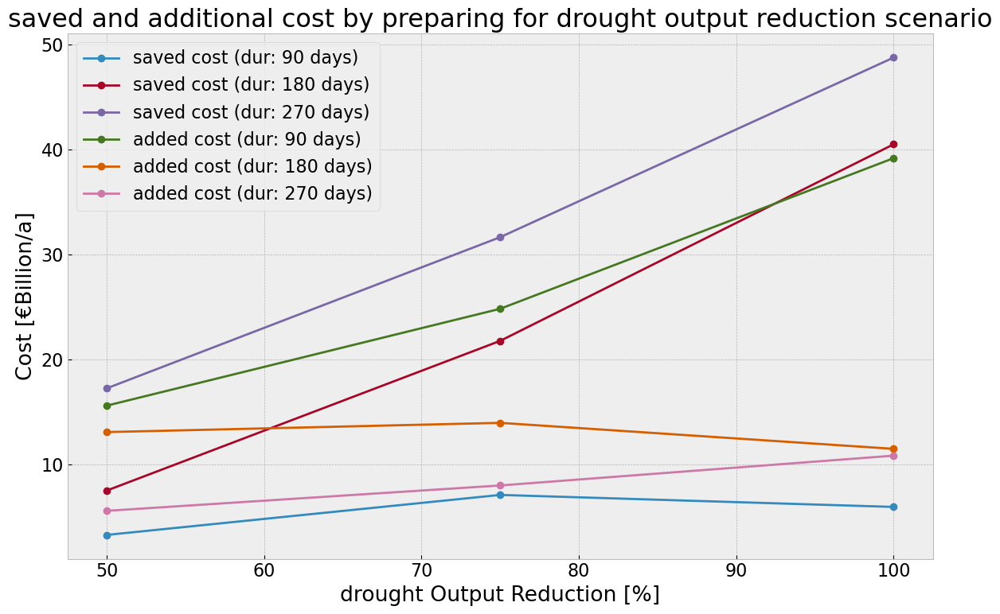

In [107]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [108]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [109]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [110]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base Roll'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base Roll':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '22.8885365' has dtype incompatible with 

In [111]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'OCGT': 0, 'solar': 1, 'onwind': 2, 'offwind': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

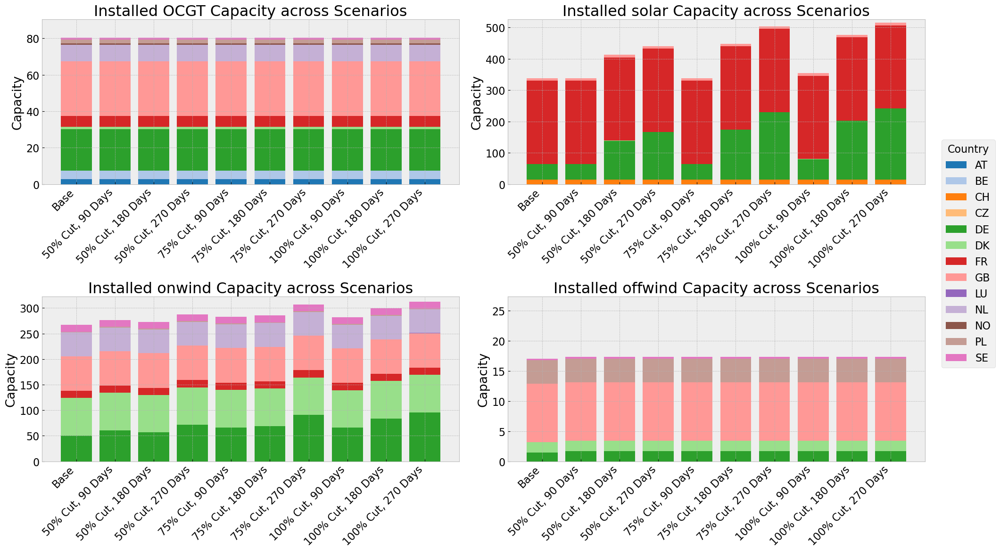

In [112]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [113]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly cast

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

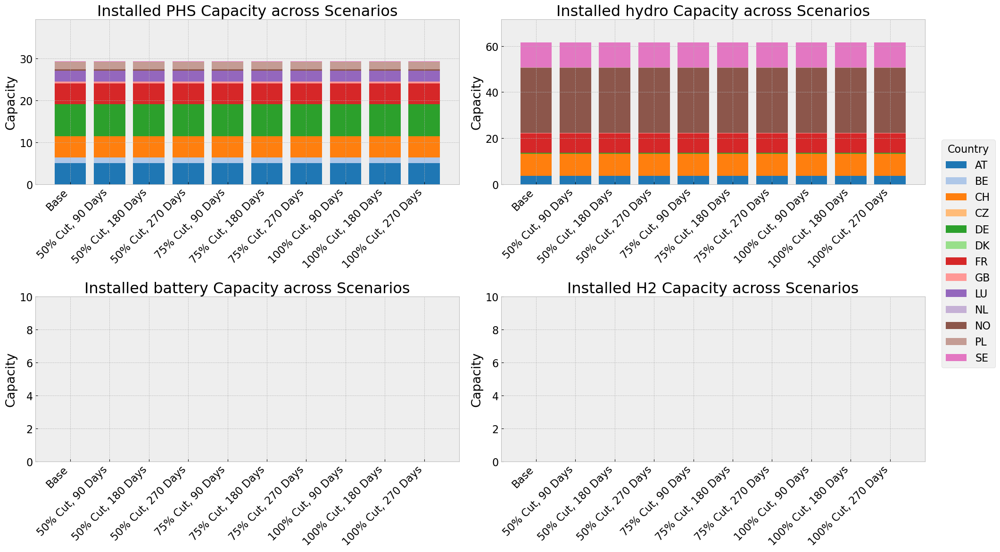

In [114]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [115]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_drought.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\794349181.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '29.022506910057025' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_drought.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\794349181.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '21.36581418985776' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_drought.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\794349181.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '41.77435568306775' has dtype in

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3284\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


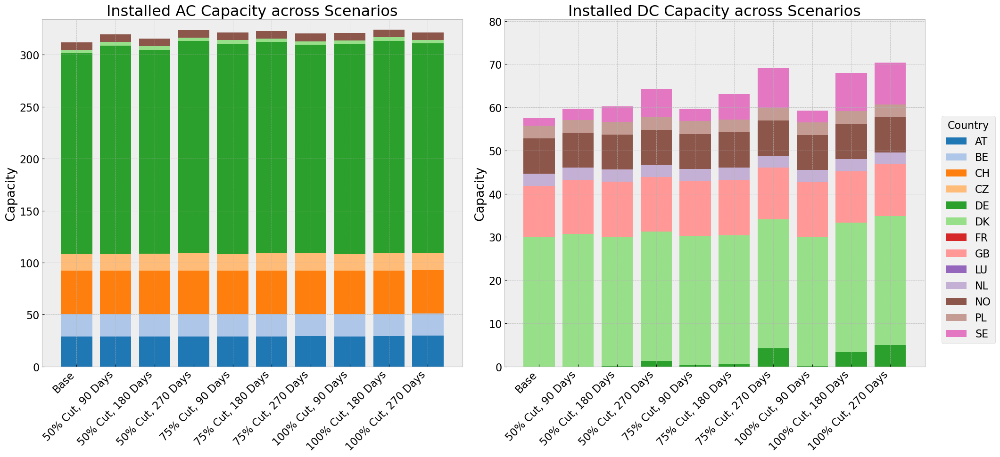

In [116]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()